# <font color='red'>7.1 Importing libraries</font>

In [1]:
# Math, image processing and other useful libraries
from __future__ import print_function, unicode_literals, absolute_import, division
import os
import pandas as pd
import numpy as np
import cv2
from collections import OrderedDict
import copy
import math
import pickle
from matplotlib.ticker import MaxNLocator
from itertools import combinations

# Image processing
from skimage.measure import regionprops
from skimage.filters import meijering, sato, frangi, hessian, threshold_otsu
from skimage.morphology import extrema, skeletonize
from skimage.transform import probabilistic_hough_line
from skimage.draw import disk, circle_perimeter
from scipy.ndimage import gaussian_filter, grey_closing
from scipy.spatial import distance_matrix
from skimage import data, restoration, util
from roipoly import RoiPoly
from matplotlib_scalebar.scalebar import ScaleBar
from biosppy.signals import tools
from biosppy.stats import pearson_correlation
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# Plotting
import matplotlib.pyplot as plt
import matplotlib.cm as pltc
import matplotlib.colors as colors
import seaborn as sns

# Widgets
import ipywidgets as widgets
from ipywidgets import interact, interactive, fixed, interact_manual
from IPython.display import display

# Feature Extraction (.py files by Teresa Parreira)
# from CytoSkeletonPropsMorph import CytoSkeletonPropsMorph
# from CytoSkeletonRegionPropsInt import RegionPropsInt
# from FreqAnalysis import FreqAnalysis
# from GLCM import GLCM

# Graph
import sknw
import networkx as nx
from scipy.signal import argrelextrema

# 
from skan import Skeleton, summarize,draw
from skan.csr import skeleton_to_csgraph, sholl_analysis,make_degree_image
import scipy as sp
import scipy.sparse
from matplotlib.patches import Circle
from ImageFeatures import ImageFeatures
from analyze_cell import analyze_cell
from line_segment_features import line_segment_features
from Functions import label_image, FeaturesFromCentroid, cv2toski,pylsdtoski,init_import,polar_to_cartesian, truncate_colormap, plot_hist, plot_pie, remove_not1D, quantitative_analysis,hist_bin,hist_lim,create_separate_DFs,getAAI,Others,branch,graphAnalysis,sholl,init_import
from fractal_dimension import fractal_dimension
from fractal_analysis_fxns import boxcount,boxcount_grayscale,fractal_dimension,fractal_dimension_grayscale,fractal_dimension_grayscale_DBC

print('📚')

C:\Users\diogo\AppData\Roaming\Python\Python37\site-packages\nose\importer.py:12: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import find_module, load_module, acquire_lock, release_lock


📚


# <font color='red'>7.2 Import and Create DataFrame with available images</font>

In [2]:
global OriginalDF,DeconvDF,DenoisedDF,NoiseDF,NucleiDeconvDF,SyntheticDF
OriginalDF,DeconvDF,DenoisedDF,NoiseDF,NucleiDeconvDF,SyntheticDF = init_import()  # Import Images, add to DataFrame
Centroids = pickle.load(open('Centroids_Original.p', 'rb'))
TextureDF = pd.read_pickle(os.getcwd() + "\\TextureDF_sub.pkl")   
dir_masks = os.getcwd() + str("//nuclei_masks")
ResultsDF = pd.read_pickle(".//ResultsSubsetSofia_desc.pkl") # pd.read_excel(os.getcwd() + '\\res20maio.xlsx')   

#maximos = pickle.load(open('maximos.p', 'rb')) 
#maximos

# # IMPORT CELL VECTOR
# temp = pd.read_excel(os.getcwd() + '\\res_Last2.xlsx')  
# classes = temp['Cell desc.']

# ResultsDF['Cell desc.'] = classes

print('🌠')

🌠


In [3]:
#OriginalDF
#DeconvDF
#DenoisedDF
#NoiseDF
#NucleiDeconvDF
#Centroids
#TextureDF
ResultsDF

,Name,Index,Label,Skeleton
11,10_6IF_CHO_L_w3_(DAPI+Alexa 568)_PS.tif,11,WT,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
16,15_IF6_CHO_L-W1_(DAPI+Alexa 568)_PS.tif,16,Mock,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
18,17_IF6_CHO_L-W1_(DAPI+Alexa 568)_PS.tif,18,Mock,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
20,19_IF6_CHO_L-W1_(DAPI+Alexa 568)_PS.tif,20,Mock,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
34,33_IF6_CHO_L-W5_(DAPI+Alexa 568)_PS.tif,34,No transfection,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
36,35_IF6_CHO_L-W5_(DAPI+Alexa 568)_PS.tif,36,No transfection,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
38,37_IF6_CHO_L-W5_(DAPI+Alexa 568)_PS.tif,38,No transfection,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
40,39_IF6_CHO_L-W6_(DAPI+Alexa 568)_PS.tif,40,Del38_46,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
42,41_IF6_CHO_L-W6_(DAPI+Alexa 568)_PS.tif,42,Del38_46,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
44,43_IF6_CHO_L-W6_(DAPI+Alexa 568)_PS.tif,44,Del38_46,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."


## Dump

In [15]:
ResultsDF['Cell desc.'] = pd.Series([])
ResultsDF.to_excel(os.getcwd() + '\\res20maio.xlsx',na_rep='NaN')  

ipykernel_launcher.py (1): The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.


# <font color='red'>7.3 Observe separated dataset by cell type</font>

## <font color='red'>7.3.1 - See cell patches and decide category</font>

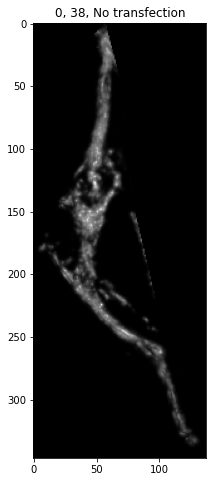

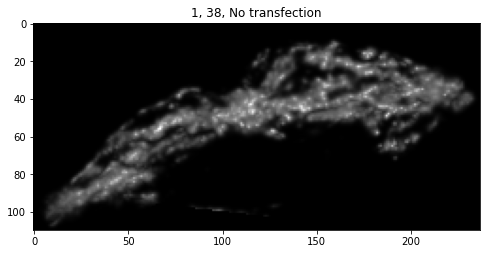

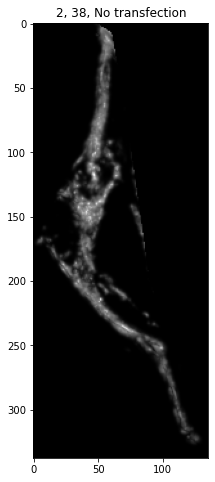

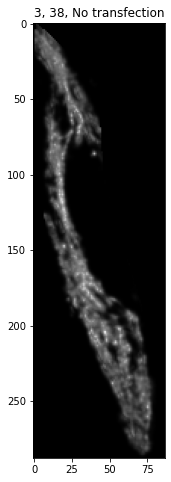

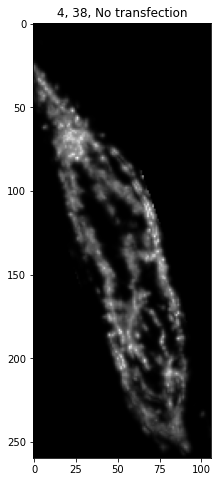

...

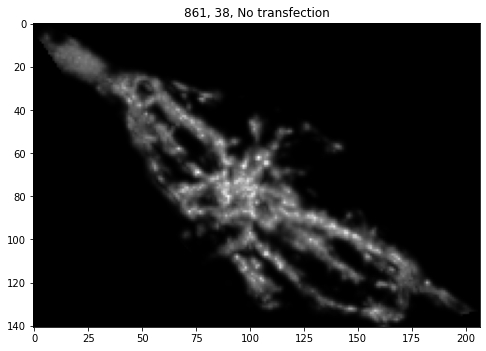

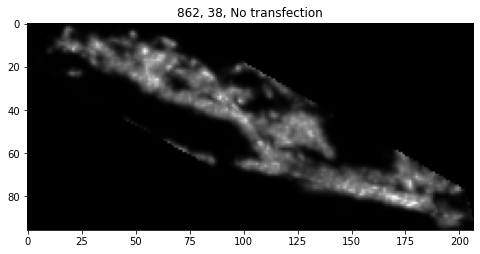

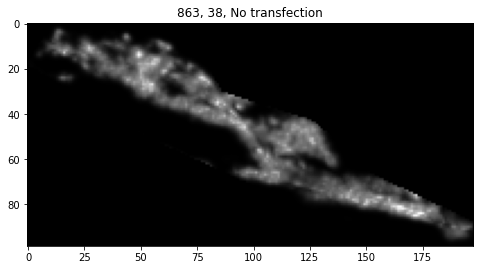

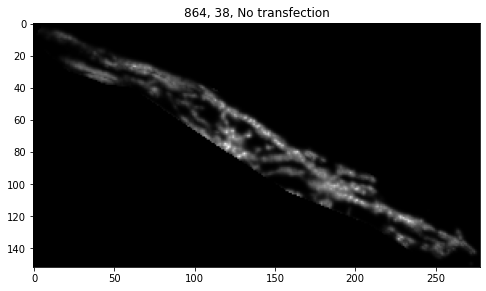

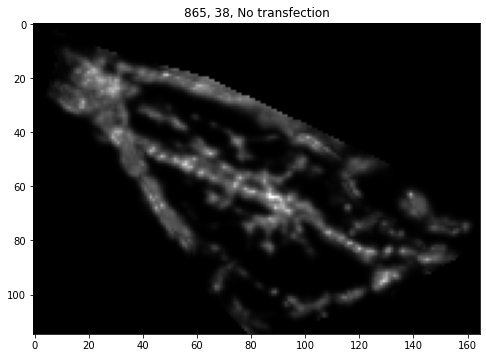

In [12]:
for index,row in ResultsDF.iterrows():
    if row['Img Index'] == 38:
        plt.figure(figsize=(8,8))
        plt.imshow(row['Patches'][1],cmap='gray')
        plt.title(str(index) + str(', ') + str(row['Img Index']) + str(', ') + str(row['Label']))
        plt.show()

## <font color='red'>7.3.2 - See Subdataset classified by Cell Type</font>

In [4]:
SAVE = False

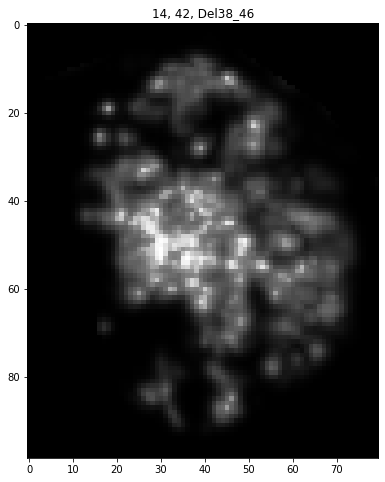

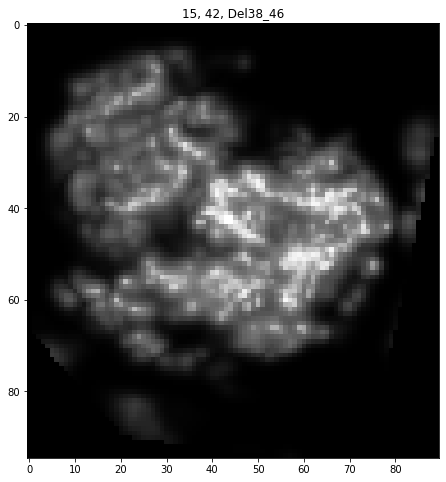

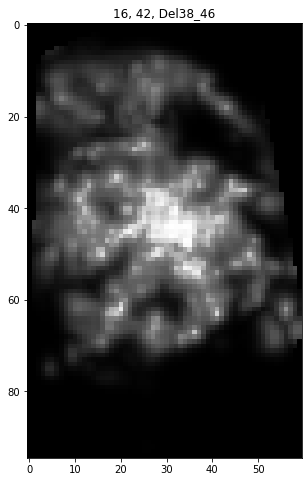

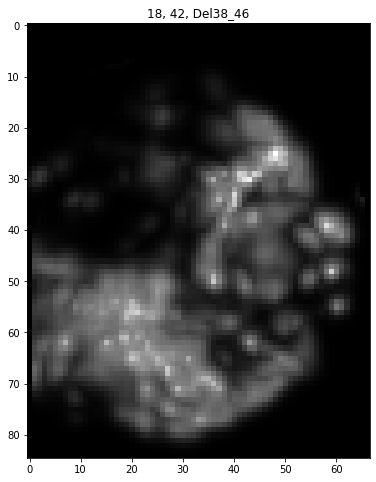

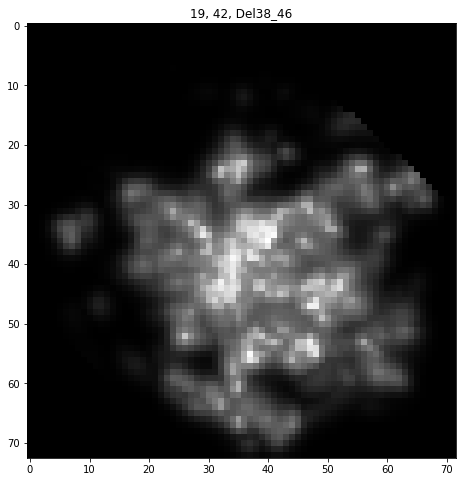

...

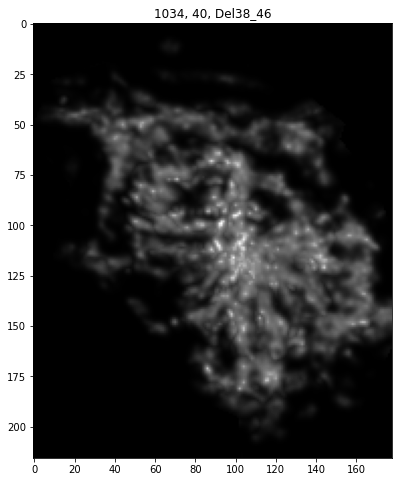

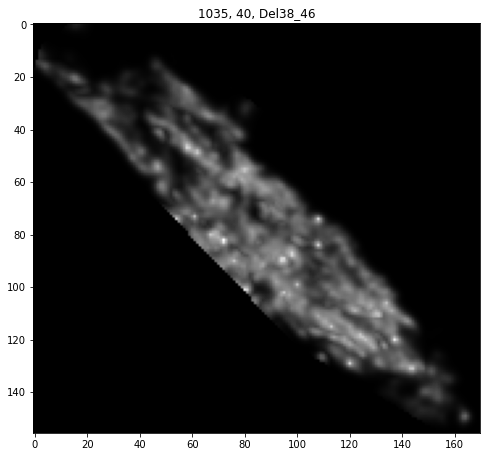

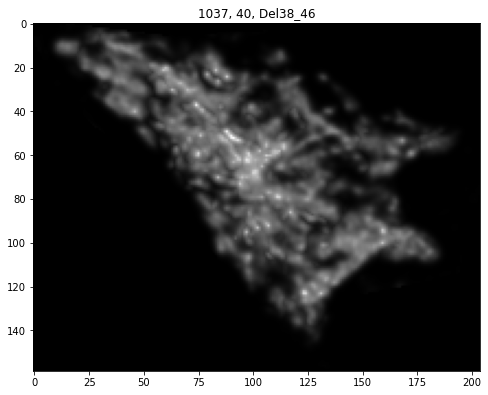

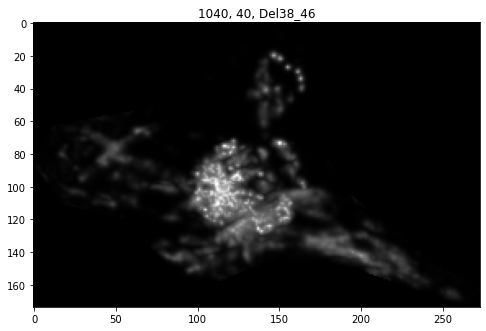

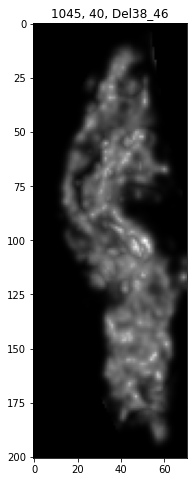

In [30]:
for index,row in ResultsDF.iterrows():
    if row['Label'] != 'No transfection' and row['Label'] != 'Mock' and row['Cell desc.'] in ['complex','round','elongated']:
        plt.figure(figsize=(8,8))
        plt.imshow(row['Patches'][1],cmap='gray')
        plt.title(str(row['Cell desc.']) + str(', ') + str(index) + str(', ') + str(row['Img Index']) + str(', ') + str(row['Label']))
        if SAVE:
            plt.savefig(".//datasetseparated//" + str(row['Cell desc.']) + str("//") + str(row['Label']) + str("//") + str(index) + ".png",format='png',transparent=True,bbox_inches='tight',dpi=200)
        plt.show()

# <font color='red'>7.4 - See number of selected cells</font>

In [7]:
labels = np.unique(ResultsDF['Cell desc.'])
for label in labels:
    dat = ResultsDF.loc[ResultsDF[ResultsDF['Cell desc.' ] == label].index]
    for sit in np.unique(ResultsDF['Label']):
        dat_ = dat.loc[dat[dat['Label'] == sit].index]
        print(label,sit,len(dat_))
    
    print(label,len(dat))

complex Del38_46 15
complex Dup41_46 11
complex Mock 19
complex Mut394 29
complex No transfection 28
complex WT 28
complex 130
elongated Del38_46 14
elongated Dup41_46 13
elongated Mock 22
elongated Mut394 15
elongated No transfection 23
elongated WT 15
elongated 102
round Del38_46 86
round Dup41_46 36
round Mock 37
round Mut394 17
round No transfection 19
round WT 36
round 231


# <font color='red'>7.5 - Perfom cell vs. cell analysis</font>

## <font color='red'>7.5.1 - Boxplots</font>

In [6]:
SAVE = False

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=4.342e-72 stat=-2.339e+01
complex v.s. elongated: t-test independent samples, P_val=6.748e-17 stat=9.037e+00
complex v.s. round: t-test independent samples, P_val=3.612e-44 stat=-1.607e+01


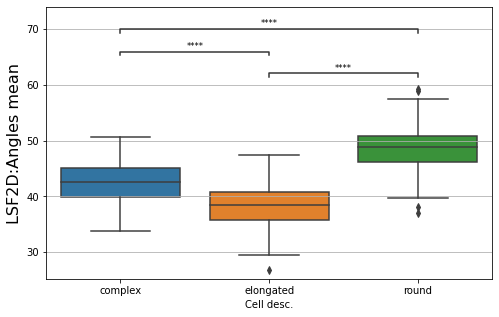

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=6.439e-69 stat=-2.256e+01
complex v.s. elongated: t-test independent samples, P_val=5.302e-16 stat=8.730e+00
complex v.s. round: t-test independent samples, P_val=1.614e-41 stat=-1.542e+01


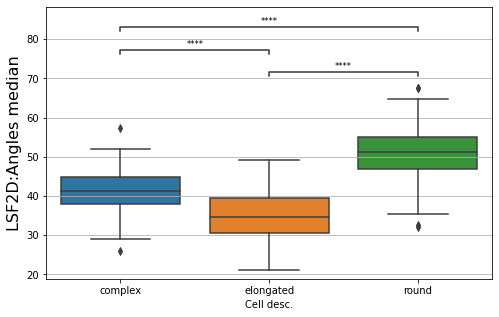

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=3.668e-08 stat=-5.639e+00
complex v.s. elongated: t-test independent samples, P_val=9.104e-01 stat=1.127e-01
complex v.s. round: t-test independent samples, P_val=1.302e-09 stat=-6.231e+00


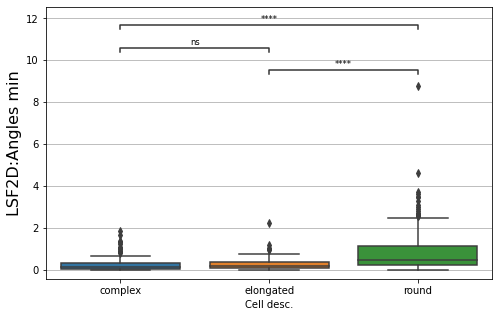

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.934e-01 stat=-1.303e+00
complex v.s. elongated: t-test independent samples, P_val=4.780e-04 stat=3.544e+00
complex v.s. round: t-test independent samples, P_val=2.850e-04 stat=3.665e+00


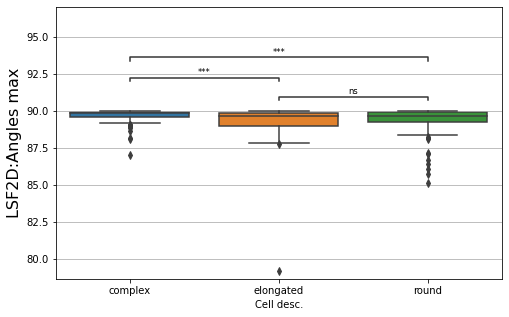

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.249e-12 stat=7.385e+00
complex v.s. elongated: t-test independent samples, P_val=1.889e-13 stat=-7.820e+00
complex v.s. round: t-test independent samples, P_val=1.047e-01 stat=-1.627e+00


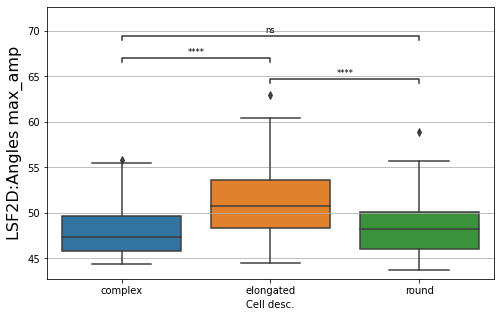

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=4.091e-07 stat=-5.168e+00
complex v.s. elongated: t-test independent samples, P_val=1.620e-03 stat=3.190e+00
complex v.s. round: t-test independent samples, P_val=6.504e-03 stat=-2.737e+00


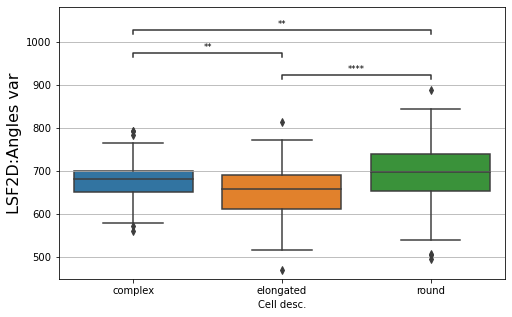

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=4.790e-07 stat=-5.136e+00
complex v.s. elongated: t-test independent samples, P_val=1.255e-03 stat=3.267e+00
complex v.s. round: t-test independent samples, P_val=9.988e-03 stat=-2.590e+00


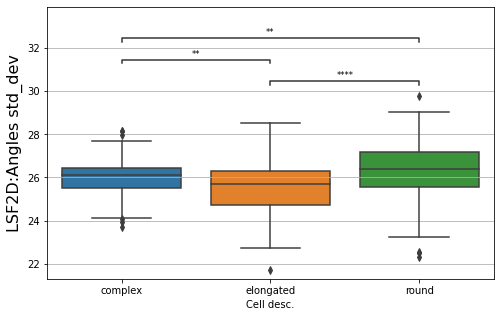

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.339e-08 stat=-5.827e+00
complex v.s. elongated: t-test independent samples, P_val=7.707e-07 stat=5.083e+00
complex v.s. round: t-test independent samples, P_val=1.647e-01 stat=-1.392e+00


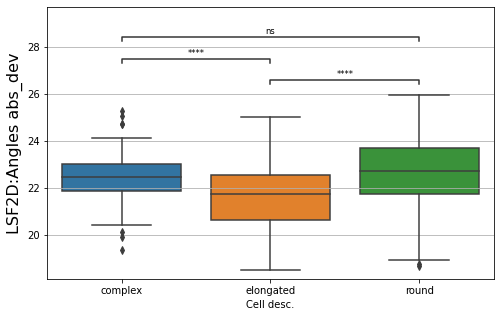

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.308e-11 stat=7.014e+00
complex v.s. elongated: t-test independent samples, P_val=8.076e-13 stat=-7.587e+00
complex v.s. round: t-test independent samples, P_val=7.241e-01 stat=-3.532e-01


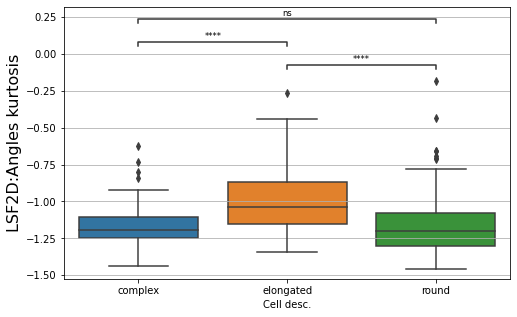

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=3.056e-67 stat=2.213e+01
complex v.s. elongated: t-test independent samples, P_val=9.281e-16 stat=-8.645e+00
complex v.s. round: t-test independent samples, P_val=2.179e-40 stat=1.514e+01


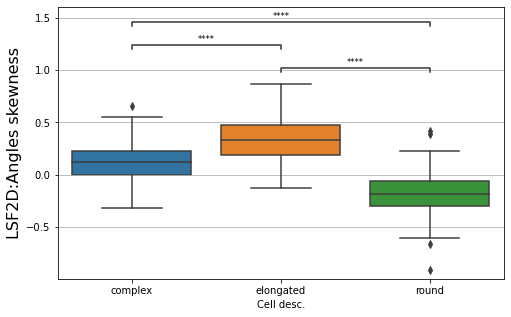

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.171e-80 stat=2.565e+01
complex v.s. elongated: t-test independent samples, P_val=7.777e-03 stat=-2.685e+00
complex v.s. round: t-test independent samples, P_val=5.644e-82 stat=2.535e+01


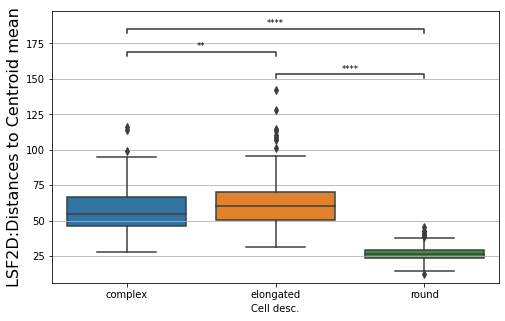

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.198e-67 stat=2.223e+01
complex v.s. elongated: t-test independent samples, P_val=7.388e-01 stat=-3.338e-01
complex v.s. round: t-test independent samples, P_val=3.408e-74 stat=2.340e+01


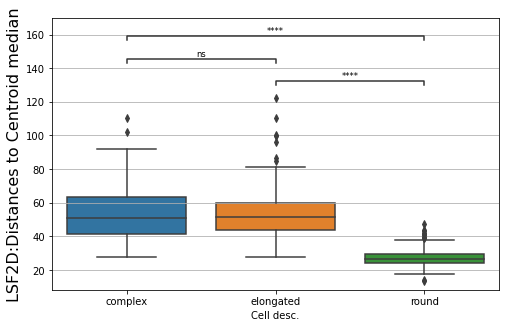

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.585e-03 stat=3.036e+00
complex v.s. elongated: t-test independent samples, P_val=2.607e-01 stat=-1.127e+00
complex v.s. round: t-test independent samples, P_val=1.386e-01 stat=1.484e+00


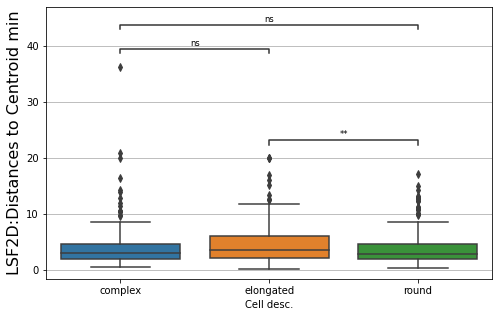

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.385e-84 stat=2.664e+01
complex v.s. elongated: t-test independent samples, P_val=1.587e-06 stat=-4.928e+00
complex v.s. round: t-test independent samples, P_val=1.121e-96 stat=2.915e+01


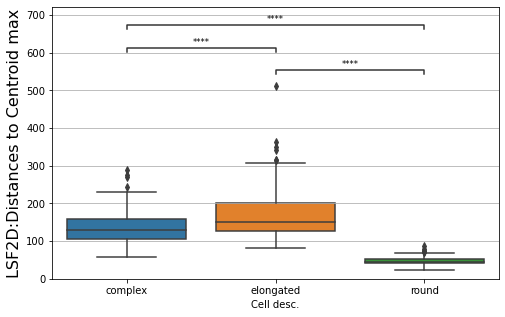

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=4.265e-74 stat=2.391e+01
complex v.s. elongated: t-test independent samples, P_val=1.062e-07 stat=-5.490e+00
complex v.s. round: t-test independent samples, P_val=1.725e-90 stat=2.753e+01


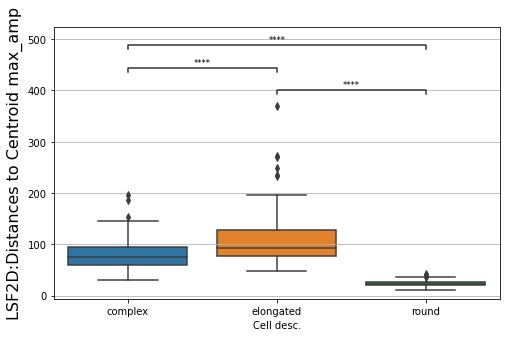

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.985e-32 stat=1.325e+01
complex v.s. elongated: t-test independent samples, P_val=9.401e-08 stat=-5.514e+00
complex v.s. round: t-test independent samples, P_val=3.713e-56 stat=1.899e+01


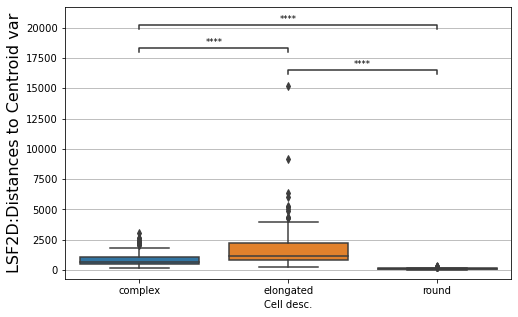

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=6.442e-80 stat=2.545e+01
complex v.s. elongated: t-test independent samples, P_val=6.825e-11 stat=-6.846e+00
complex v.s. round: t-test independent samples, P_val=1.040e-90 stat=2.758e+01


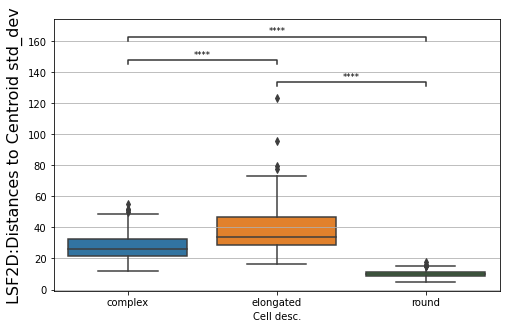

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.184e-84 stat=2.665e+01
complex v.s. elongated: t-test independent samples, P_val=1.430e-10 stat=-6.718e+00
complex v.s. round: t-test independent samples, P_val=1.983e-88 stat=2.699e+01


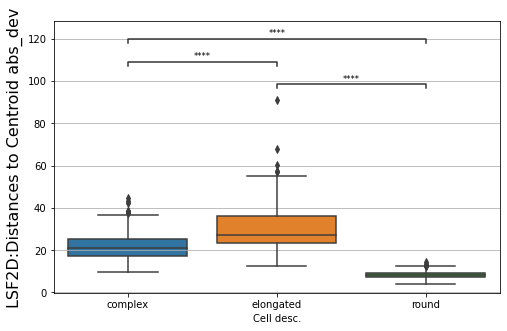

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.716e-16 stat=8.625e+00
complex v.s. elongated: t-test independent samples, P_val=1.779e-01 stat=-1.351e+00
complex v.s. round: t-test independent samples, P_val=3.301e-18 stat=9.187e+00


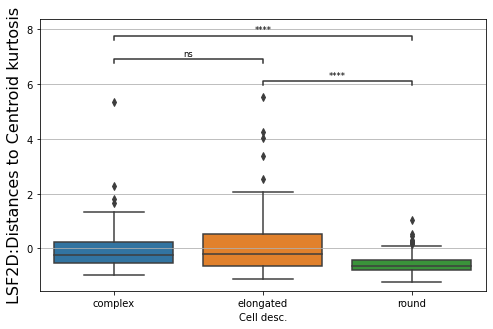

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=7.981e-85 stat=2.677e+01
complex v.s. elongated: t-test independent samples, P_val=3.246e-09 stat=-6.158e+00
complex v.s. round: t-test independent samples, P_val=1.557e-61 stat=2.029e+01


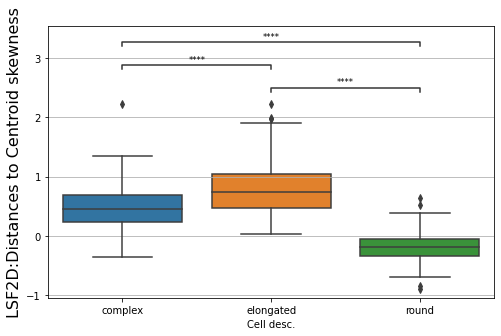

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.638e-56 stat=1.939e+01
complex v.s. elongated: t-test independent samples, P_val=4.327e-01 stat=7.860e-01
complex v.s. round: t-test independent samples, P_val=9.136e-66 stat=2.132e+01


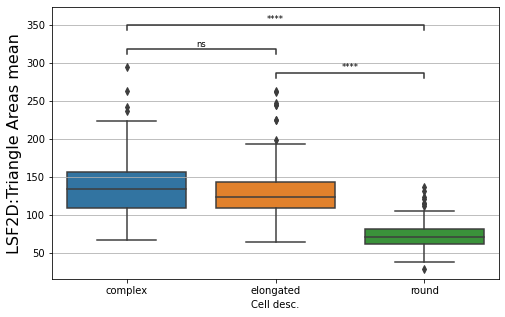

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=4.752e-49 stat=1.751e+01
complex v.s. elongated: t-test independent samples, P_val=8.046e-02 stat=1.756e+00
complex v.s. round: t-test independent samples, P_val=1.579e-57 stat=1.932e+01


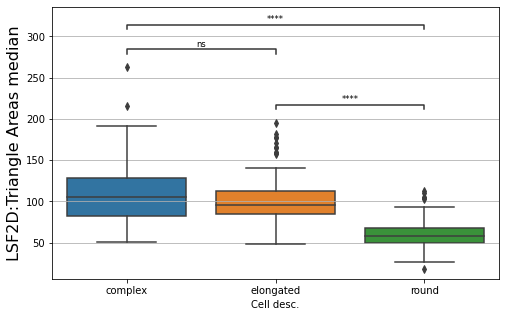

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=9.203e-01 stat=-1.002e-01
complex v.s. elongated: t-test independent samples, P_val=6.359e-03 stat=-2.754e+00
complex v.s. round: t-test independent samples, P_val=5.856e-04 stat=-3.469e+00


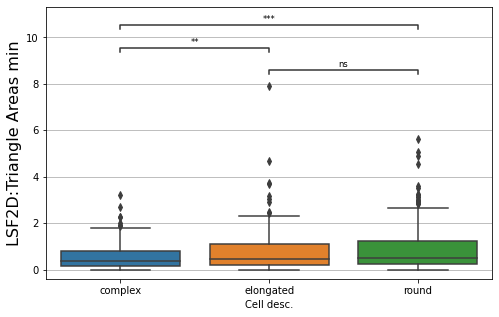

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.059e-36 stat=1.429e+01
complex v.s. elongated: t-test independent samples, P_val=9.094e-01 stat=1.139e-01
complex v.s. round: t-test independent samples, P_val=1.559e-56 stat=1.908e+01


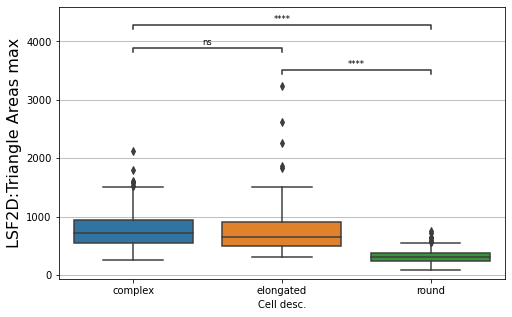

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=5.336e-33 stat=1.340e+01
complex v.s. elongated: t-test independent samples, P_val=9.699e-01 stat=3.780e-02
complex v.s. round: t-test independent samples, P_val=5.017e-53 stat=1.823e+01


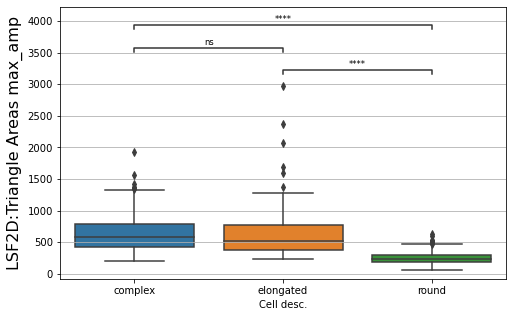

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=4.209e-28 stat=1.209e+01
complex v.s. elongated: t-test independent samples, P_val=3.593e-01 stat=-9.185e-01
complex v.s. round: t-test independent samples, P_val=9.142e-52 stat=1.792e+01


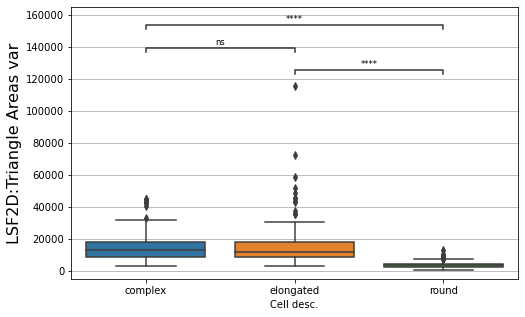

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=7.242e-51 stat=1.797e+01
complex v.s. elongated: t-test independent samples, P_val=6.437e-01 stat=-4.631e-01
complex v.s. round: t-test independent samples, P_val=1.755e-69 stat=2.223e+01


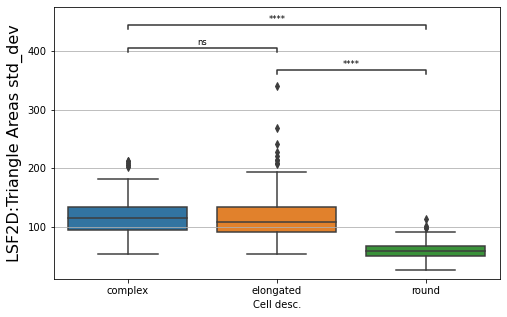

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.944e-57 stat=1.963e+01
complex v.s. elongated: t-test independent samples, P_val=8.504e-01 stat=1.888e-01
complex v.s. round: t-test independent samples, P_val=2.522e-71 stat=2.269e+01


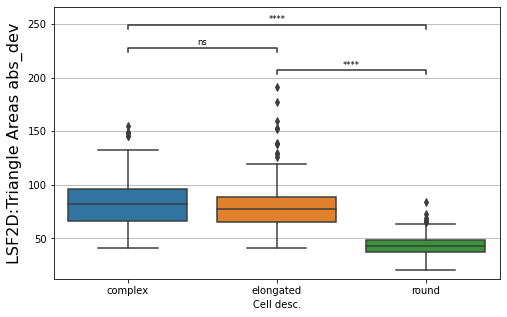

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.801e-07 stat=5.332e+00
complex v.s. elongated: t-test independent samples, P_val=3.304e-01 stat=-9.753e-01
complex v.s. round: t-test independent samples, P_val=7.529e-06 stat=4.545e+00


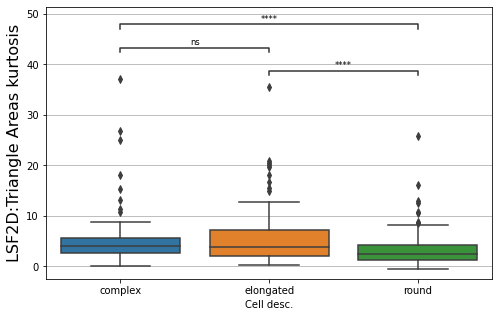

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=8.129e-08 stat=5.487e+00
complex v.s. elongated: t-test independent samples, P_val=1.600e-01 stat=-1.410e+00
complex v.s. round: t-test independent samples, P_val=7.248e-06 stat=4.553e+00


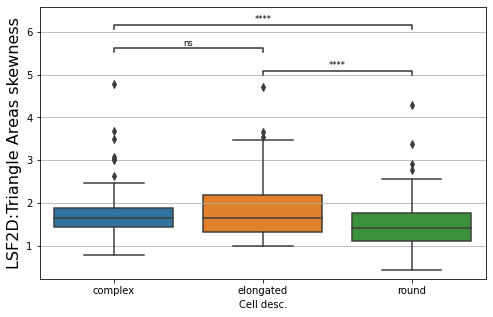

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=9.690e-57 stat=1.945e+01
complex v.s. elongated: t-test independent samples, P_val=1.852e-13 stat=-7.824e+00
complex v.s. round: t-test independent samples, P_val=6.504e-35 stat=1.377e+01


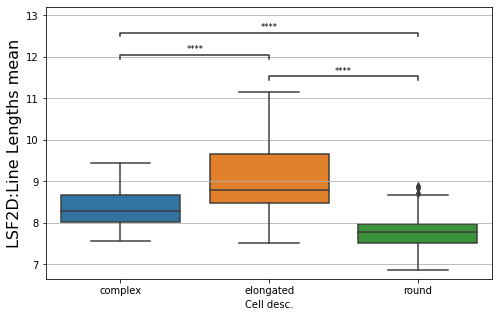

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=7.083e-42 stat=1.569e+01
complex v.s. elongated: t-test independent samples, P_val=1.641e-07 stat=-5.402e+00
complex v.s. round: t-test independent samples, P_val=7.857e-28 stat=1.192e+01


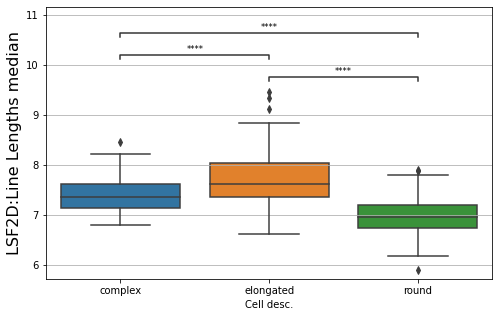

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.161e-06 stat=-4.954e+00
complex v.s. elongated: t-test independent samples, P_val=9.695e-02 stat=-1.667e+00
complex v.s. round: t-test independent samples, P_val=9.592e-13 stat=-7.402e+00


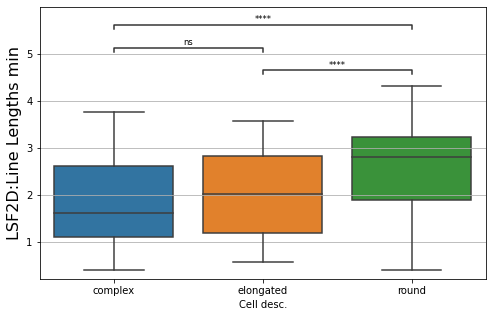

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.685e-47 stat=1.712e+01
complex v.s. elongated: t-test independent samples, P_val=2.643e-04 stat=-3.706e+00
complex v.s. round: t-test independent samples, P_val=3.071e-35 stat=1.385e+01


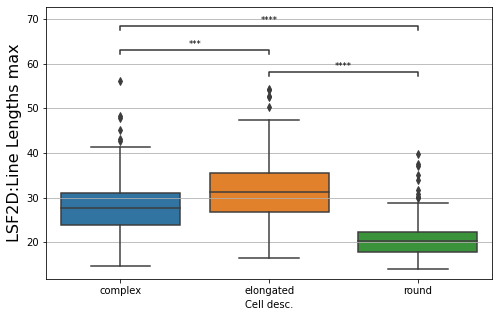

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.226e-42 stat=1.589e+01
complex v.s. elongated: t-test independent samples, P_val=1.904e-03 stat=-3.141e+00
complex v.s. round: t-test independent samples, P_val=9.855e-33 stat=1.321e+01


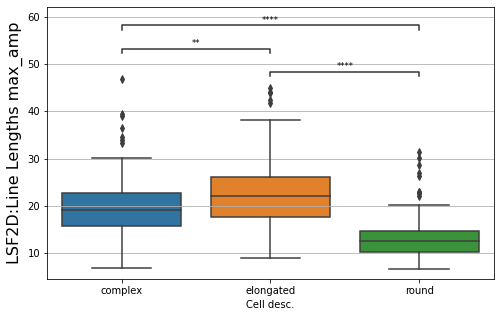

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=4.790e-48 stat=1.726e+01
complex v.s. elongated: t-test independent samples, P_val=4.977e-15 stat=-8.389e+00
complex v.s. round: t-test independent samples, P_val=5.225e-23 stat=1.060e+01


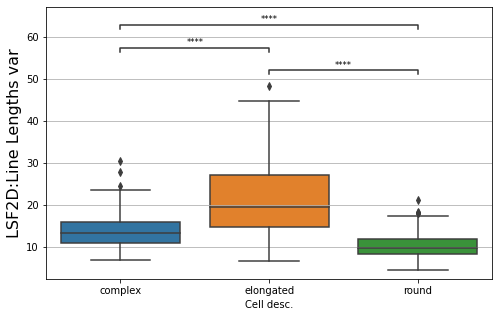

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=4.260e-52 stat=1.828e+01
complex v.s. elongated: t-test independent samples, P_val=2.764e-15 stat=-8.479e+00
complex v.s. round: t-test independent samples, P_val=8.983e-24 stat=1.081e+01


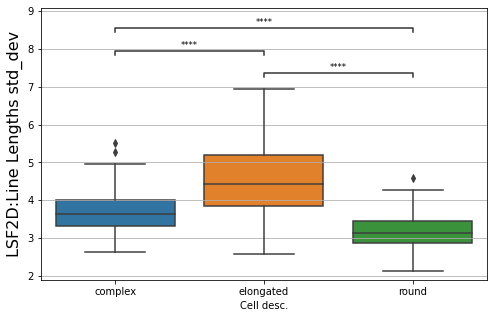

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=5.840e-48 stat=1.724e+01
complex v.s. elongated: t-test independent samples, P_val=6.092e-15 stat=-8.358e+00
complex v.s. round: t-test independent samples, P_val=6.643e-22 stat=1.028e+01


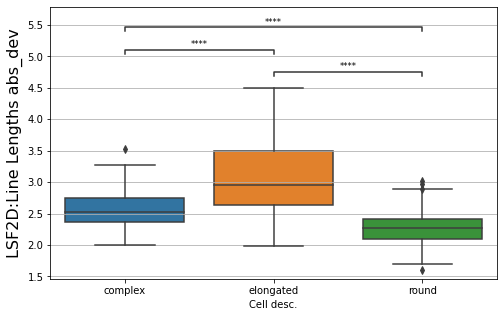

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.331e-06 stat=4.926e+00
complex v.s. elongated: t-test independent samples, P_val=5.287e-01 stat=-6.309e-01
complex v.s. round: t-test independent samples, P_val=5.824e-06 stat=4.602e+00


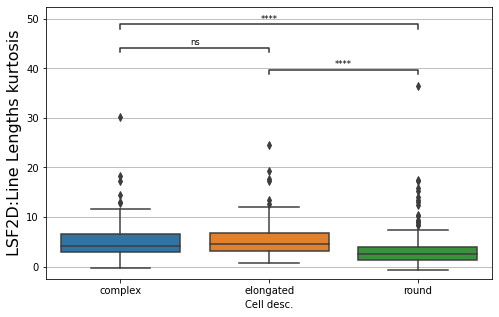

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.437e-11 stat=6.914e+00
complex v.s. elongated: t-test independent samples, P_val=3.075e-02 stat=-2.174e+00
complex v.s. round: t-test independent samples, P_val=6.977e-07 stat=5.052e+00


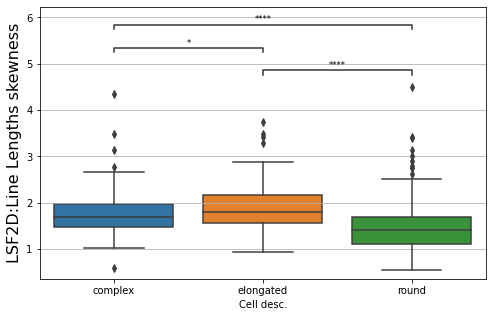

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=3.939e-04 stat=3.581e+00
complex v.s. elongated: t-test independent samples, P_val=2.808e-02 stat=-2.210e+00
complex v.s. round: t-test independent samples, P_val=3.763e-01 stat=8.859e-01


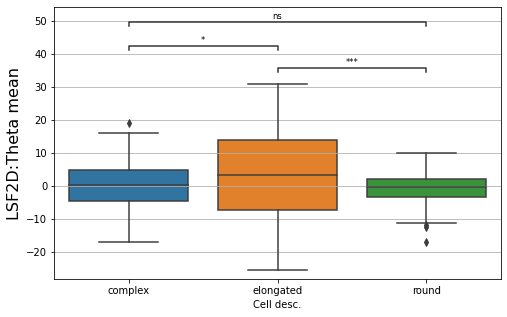

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.111e-03 stat=3.099e+00
complex v.s. elongated: t-test independent samples, P_val=6.062e-02 stat=-1.886e+00
complex v.s. round: t-test independent samples, P_val=4.466e-01 stat=7.619e-01


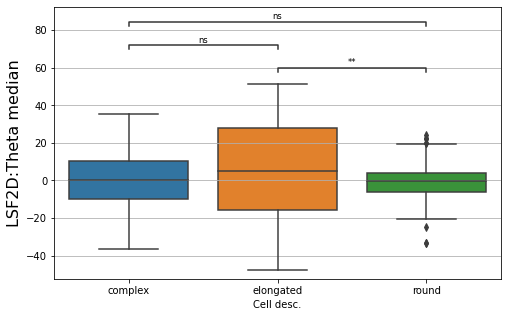

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.897e-02 stat=-2.358e+00
complex v.s. elongated: t-test independent samples, P_val=1.621e-03 stat=-3.190e+00
complex v.s. round: t-test independent samples, P_val=1.759e-07 stat=-5.328e+00


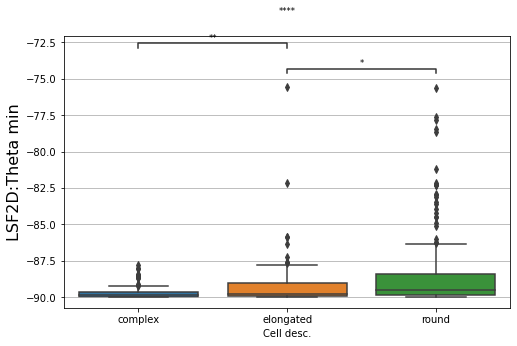

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.065e-01 stat=1.619e+00
complex v.s. elongated: t-test independent samples, P_val=7.309e-03 stat=2.707e+00
complex v.s. round: t-test independent samples, P_val=5.400e-05 stat=4.087e+00


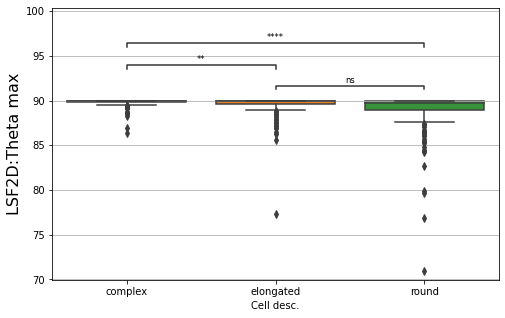

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=9.293e-34 stat=1.360e+01
complex v.s. elongated: t-test independent samples, P_val=1.430e-10 stat=-6.718e+00
complex v.s. round: t-test independent samples, P_val=4.855e-12 stat=7.151e+00


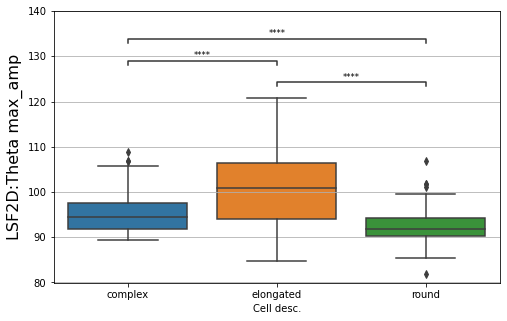

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=7.091e-04 stat=-3.418e+00
complex v.s. elongated: t-test independent samples, P_val=3.467e-01 stat=9.429e-01
complex v.s. round: t-test independent samples, P_val=5.323e-04 stat=-3.496e+00


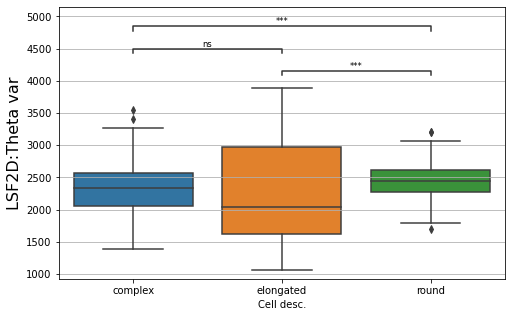

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.331e-05 stat=-4.421e+00
complex v.s. elongated: t-test independent samples, P_val=1.188e-01 stat=1.566e+00
complex v.s. round: t-test independent samples, P_val=1.919e-04 stat=-3.768e+00


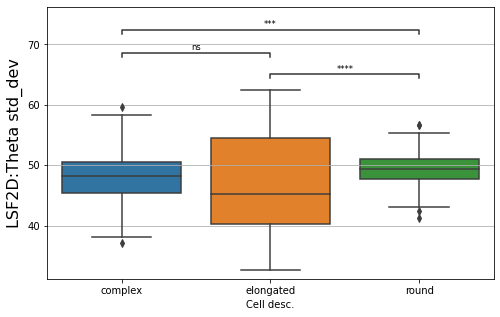

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.730e-11 stat=-6.895e+00
complex v.s. elongated: t-test independent samples, P_val=3.606e-03 stat=2.941e+00
complex v.s. round: t-test independent samples, P_val=3.263e-06 stat=-4.728e+00


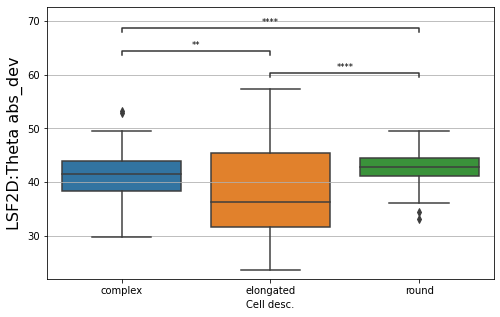

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.810e-27 stat=1.186e+01
complex v.s. elongated: t-test independent samples, P_val=1.106e-08 stat=-5.929e+00
complex v.s. round: t-test independent samples, P_val=3.210e-12 stat=7.216e+00


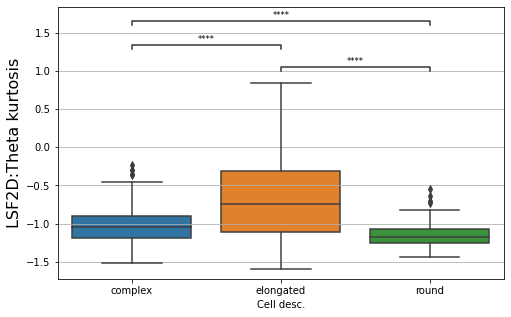

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.596e-04 stat=-3.693e+00
complex v.s. elongated: t-test independent samples, P_val=2.577e-02 stat=2.244e+00
complex v.s. round: t-test independent samples, P_val=3.353e-01 stat=-9.649e-01


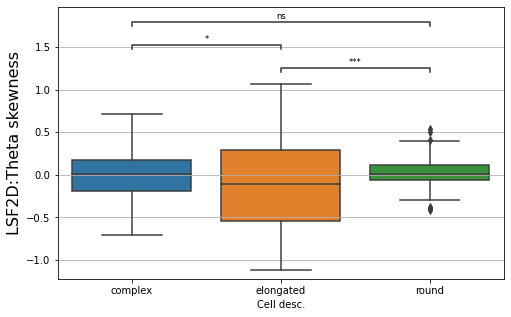

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.851e-12 stat=-7.324e+00
complex v.s. elongated: t-test independent samples, P_val=5.128e-03 stat=2.826e+00
complex v.s. round: t-test independent samples, P_val=1.174e-07 stat=-5.407e+00


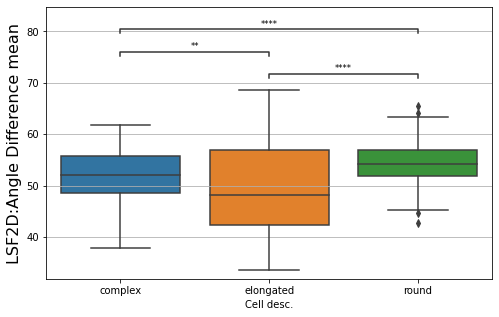

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=3.418e-11 stat=-6.859e+00
complex v.s. elongated: t-test independent samples, P_val=7.785e-03 stat=2.685e+00
complex v.s. round: t-test independent samples, P_val=8.075e-07 stat=-5.022e+00


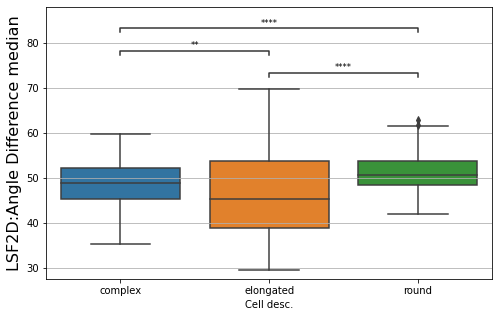

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.396e-34 stat=-1.381e+01
complex v.s. elongated: t-test independent samples, P_val=9.195e-03 stat=2.627e+00
complex v.s. round: t-test independent samples, P_val=5.316e-30 stat=-1.250e+01


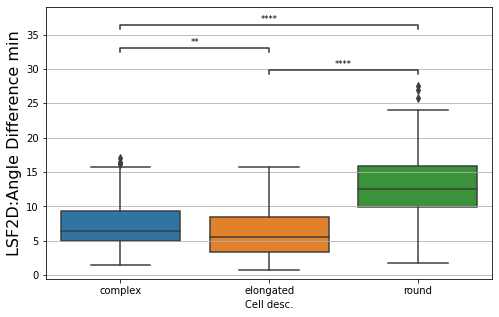

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.076e-07 stat=5.433e+00
complex v.s. elongated: t-test independent samples, P_val=1.347e-01 stat=1.501e+00
complex v.s. round: t-test independent samples, P_val=1.179e-15 stat=8.384e+00


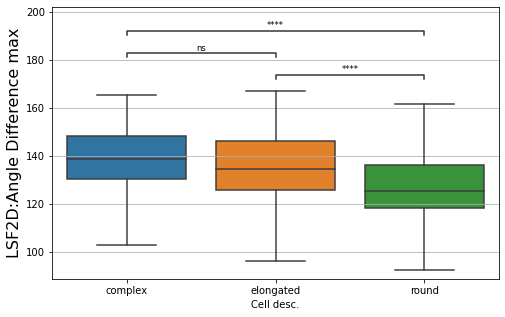

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=6.536e-19 stat=9.447e+00
complex v.s. elongated: t-test independent samples, P_val=9.228e-01 stat=9.702e-02
complex v.s. round: t-test independent samples, P_val=1.596e-24 stat=1.102e+01


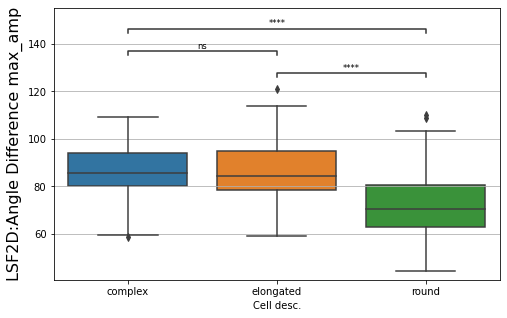

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.049e-09 stat=6.282e+00
complex v.s. elongated: t-test independent samples, P_val=1.169e-02 stat=-2.542e+00
complex v.s. round: t-test independent samples, P_val=1.260e-05 stat=4.429e+00


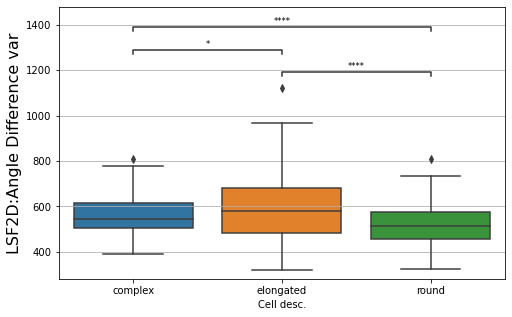

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=5.788e-09 stat=5.980e+00
complex v.s. elongated: t-test independent samples, P_val=2.549e-02 stat=-2.248e+00
complex v.s. round: t-test independent samples, P_val=1.084e-05 stat=4.463e+00


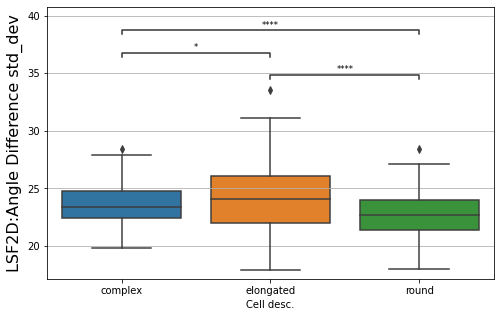

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.770e-07 stat=5.336e+00
complex v.s. elongated: t-test independent samples, P_val=1.422e-01 stat=-1.473e+00
complex v.s. round: t-test independent samples, P_val=5.415e-06 stat=4.618e+00


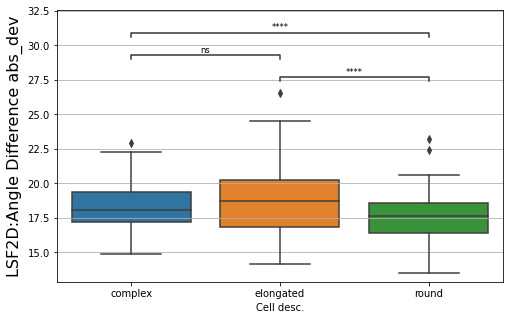

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=6.045e-02 stat=1.884e+00
complex v.s. elongated: t-test independent samples, P_val=1.848e-02 stat=-2.373e+00
complex v.s. round: t-test independent samples, P_val=8.549e-01 stat=-1.830e-01


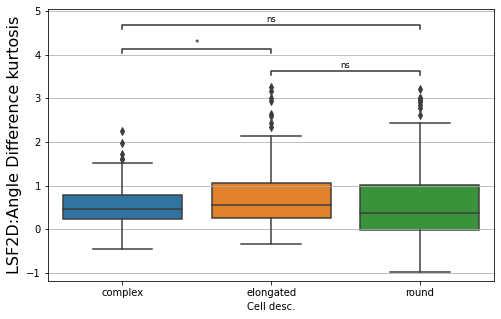

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.028e-01 stat=1.276e+00
complex v.s. elongated: t-test independent samples, P_val=9.370e-02 stat=-1.683e+00
complex v.s. round: t-test independent samples, P_val=6.878e-01 stat=-4.022e-01


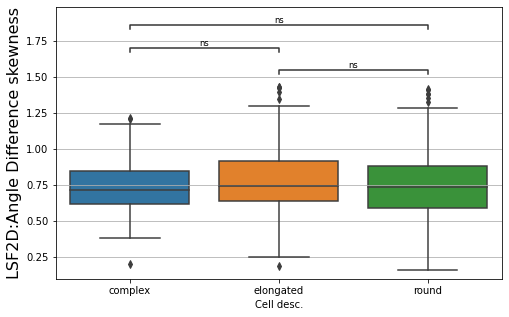

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=4.056e-05 stat=-4.160e+00
complex v.s. elongated: t-test independent samples, P_val=3.051e-01 stat=1.028e+00
complex v.s. round: t-test independent samples, P_val=1.550e-05 stat=-4.381e+00


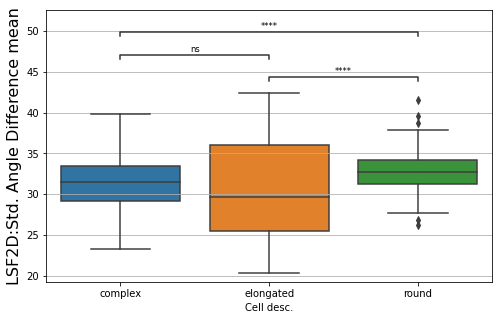

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=5.879e-04 stat=-3.471e+00
complex v.s. elongated: t-test independent samples, P_val=5.799e-01 stat=5.544e-01
complex v.s. round: t-test independent samples, P_val=4.296e-05 stat=-4.142e+00


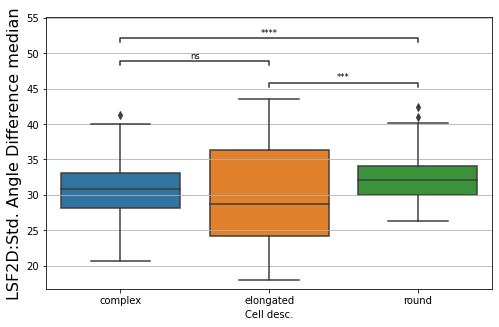

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.167e-24 stat=-1.113e+01
complex v.s. elongated: t-test independent samples, P_val=5.469e-03 stat=2.805e+00
complex v.s. round: t-test independent samples, P_val=2.489e-20 stat=-9.824e+00


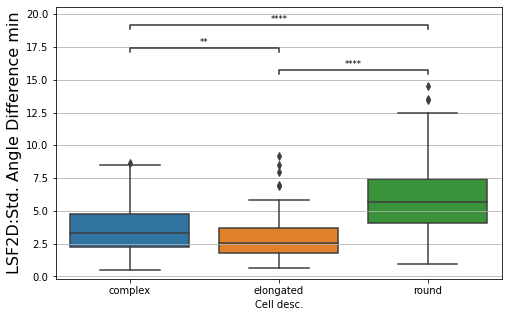

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.240e-04 stat=3.884e+00
complex v.s. elongated: t-test independent samples, P_val=3.926e-02 stat=2.073e+00
complex v.s. round: t-test independent samples, P_val=3.966e-15 stat=8.212e+00


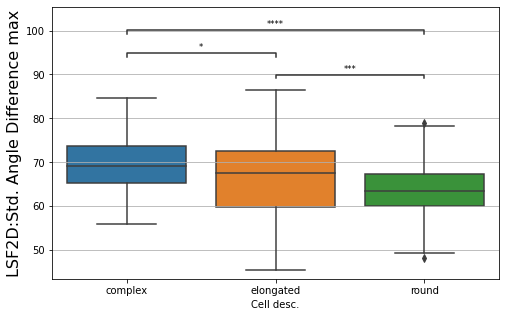

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.367e-14 stat=7.983e+00
complex v.s. elongated: t-test independent samples, P_val=4.845e-02 stat=1.984e+00
complex v.s. round: t-test independent samples, P_val=1.528e-25 stat=1.130e+01


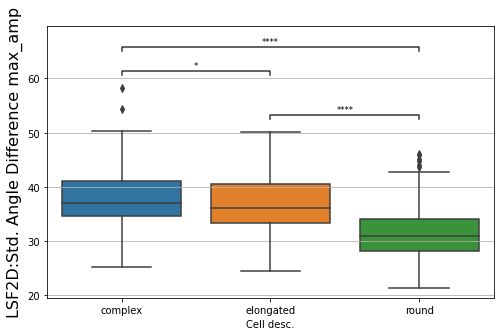

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=7.982e-12 stat=7.093e+00
complex v.s. elongated: t-test independent samples, P_val=1.986e-03 stat=-3.128e+00
complex v.s. round: t-test independent samples, P_val=1.690e-05 stat=4.362e+00


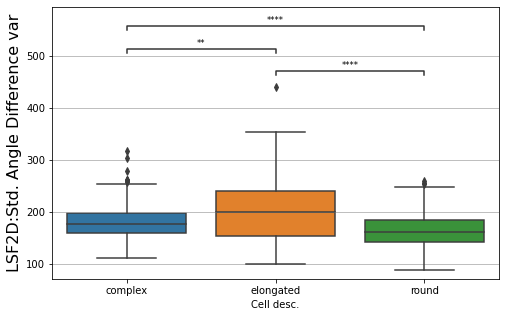

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=8.302e-11 stat=6.713e+00
complex v.s. elongated: t-test independent samples, P_val=5.327e-03 stat=-2.813e+00
complex v.s. round: t-test independent samples, P_val=1.700e-05 stat=4.360e+00


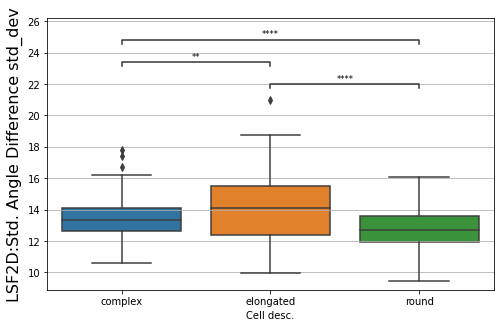

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.244e-10 stat=6.646e+00
complex v.s. elongated: t-test independent samples, P_val=8.374e-03 stat=-2.660e+00
complex v.s. round: t-test independent samples, P_val=1.305e-05 stat=4.421e+00


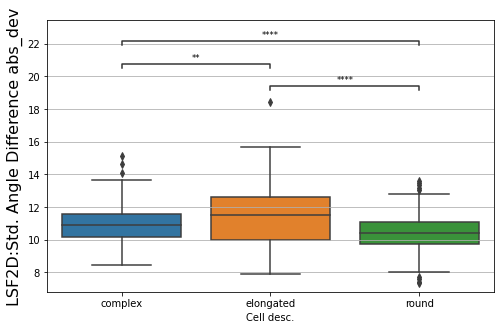

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=3.098e-01 stat=-1.017e+00
complex v.s. elongated: t-test independent samples, P_val=1.177e-01 stat=1.570e+00
complex v.s. round: t-test independent samples, P_val=3.859e-01 stat=8.682e-01


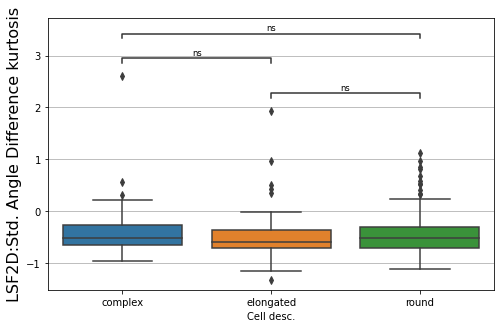

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.013e-01 stat=1.643e+00
complex v.s. elongated: t-test independent samples, P_val=2.456e-01 stat=1.164e+00
complex v.s. round: t-test independent samples, P_val=5.630e-04 stat=3.480e+00


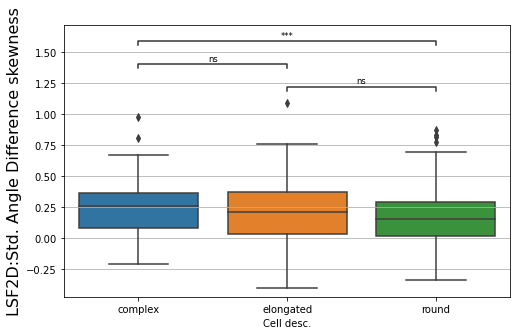

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=7.375e-42 stat=1.569e+01
complex v.s. elongated: t-test independent samples, P_val=1.166e-04 stat=-3.921e+00
complex v.s. round: t-test independent samples, P_val=1.901e-21 stat=1.015e+01


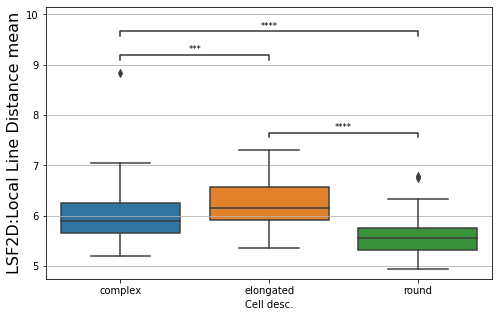

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=5.135e-42 stat=1.573e+01
complex v.s. elongated: t-test independent samples, P_val=2.209e-04 stat=-3.754e+00
complex v.s. round: t-test independent samples, P_val=3.181e-25 stat=1.121e+01


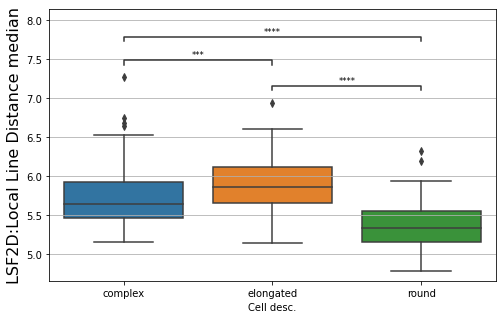

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=4.793e-02 stat=1.985e+00
complex v.s. elongated: t-test independent samples, P_val=3.607e-04 stat=-3.621e+00
complex v.s. round: t-test independent samples, P_val=2.093e-02 stat=-2.319e+00


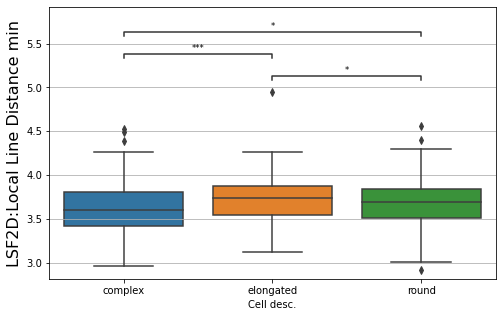

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=6.672e-27 stat=1.176e+01
complex v.s. elongated: t-test independent samples, P_val=3.692e-01 stat=-8.998e-01
complex v.s. round: t-test independent samples, P_val=1.447e-26 stat=1.158e+01


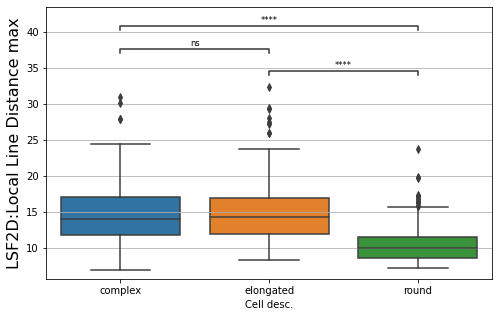

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=9.573e-23 stat=1.059e+01
complex v.s. elongated: t-test independent samples, P_val=5.925e-01 stat=-5.360e-01
complex v.s. round: t-test independent samples, P_val=1.738e-24 stat=1.101e+01


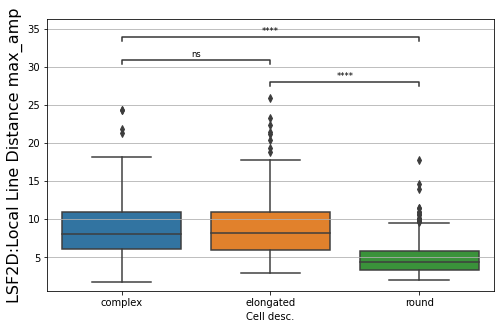

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.921e-12 stat=7.252e+00
complex v.s. elongated: t-test independent samples, P_val=3.502e-02 stat=-2.121e+00
complex v.s. round: t-test independent samples, P_val=3.342e-05 stat=4.202e+00


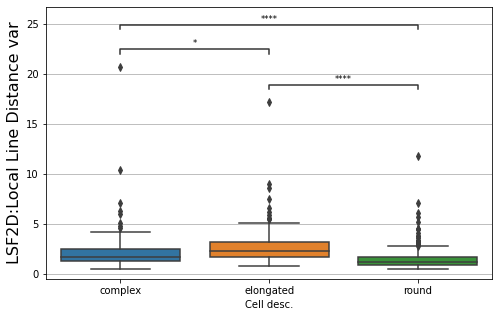

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.844e-17 stat=8.997e+00
complex v.s. elongated: t-test independent samples, P_val=3.025e-03 stat=-2.997e+00
complex v.s. round: t-test independent samples, P_val=8.005e-08 stat=5.480e+00


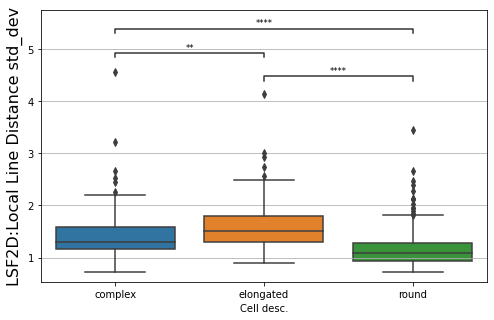

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=9.863e-26 stat=1.143e+01
complex v.s. elongated: t-test independent samples, P_val=3.354e-04 stat=-3.641e+00
complex v.s. round: t-test independent samples, P_val=1.951e-09 stat=6.160e+00


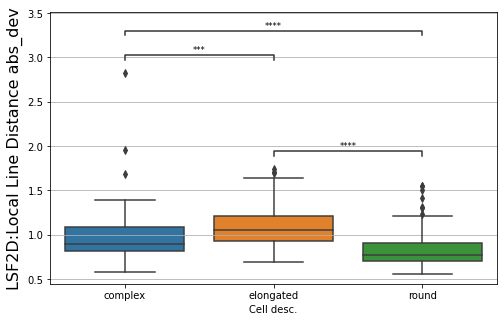

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.293e-06 stat=4.932e+00
complex v.s. elongated: t-test independent samples, P_val=6.928e-01 stat=3.955e-01
complex v.s. round: t-test independent samples, P_val=1.347e-08 stat=5.814e+00


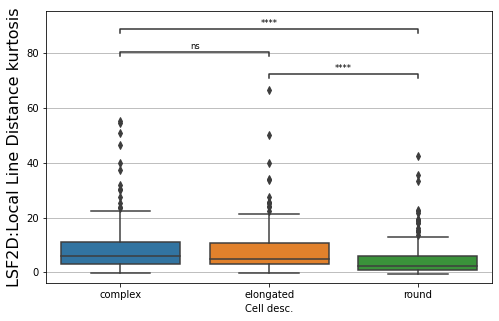

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.578e-06 stat=4.890e+00
complex v.s. elongated: t-test independent samples, P_val=9.887e-01 stat=-1.421e-02
complex v.s. round: t-test independent samples, P_val=1.487e-07 stat=5.361e+00


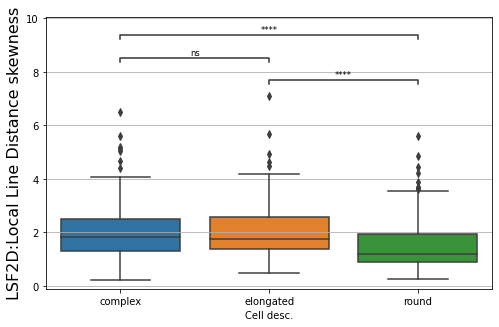

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=6.432e-25 stat=1.120e+01
complex v.s. elongated: t-test independent samples, P_val=3.819e-03 stat=-2.923e+00
complex v.s. round: t-test independent samples, P_val=2.417e-11 stat=6.896e+00


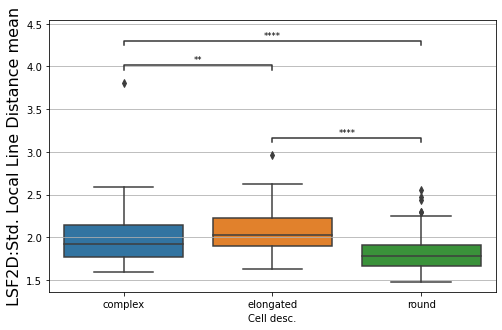

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=8.553e-22 stat=1.031e+01
complex v.s. elongated: t-test independent samples, P_val=7.519e-03 stat=-2.697e+00
complex v.s. round: t-test independent samples, P_val=9.867e-12 stat=7.039e+00


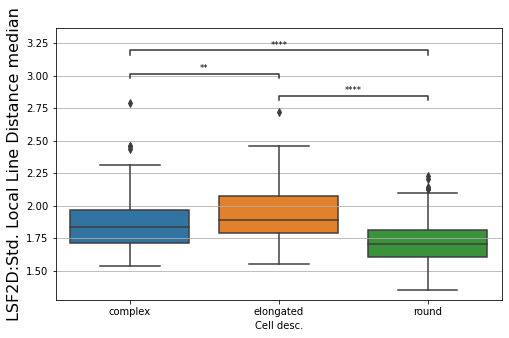

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.337e-03 stat=-3.235e+00
complex v.s. elongated: t-test independent samples, P_val=2.284e-01 stat=-1.208e+00
complex v.s. round: t-test independent samples, P_val=1.202e-06 stat=-4.940e+00


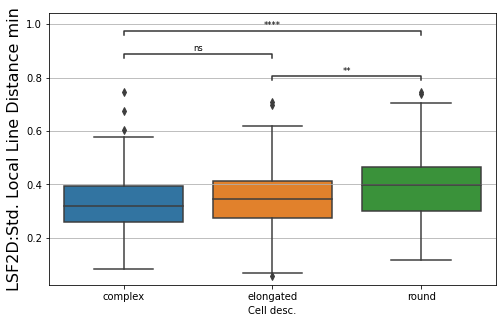

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=5.060e-29 stat=1.234e+01
complex v.s. elongated: t-test independent samples, P_val=1.729e-01 stat=-1.367e+00
complex v.s. round: t-test independent samples, P_val=3.148e-27 stat=1.176e+01


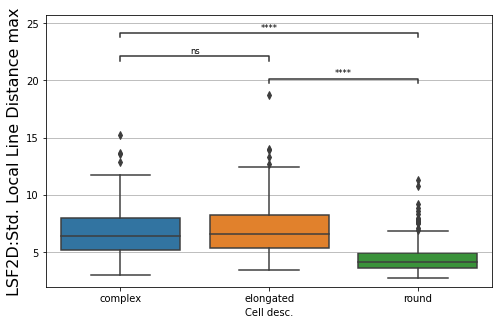

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.267e-26 stat=1.168e+01
complex v.s. elongated: t-test independent samples, P_val=2.713e-01 stat=-1.103e+00
complex v.s. round: t-test independent samples, P_val=3.042e-27 stat=1.176e+01


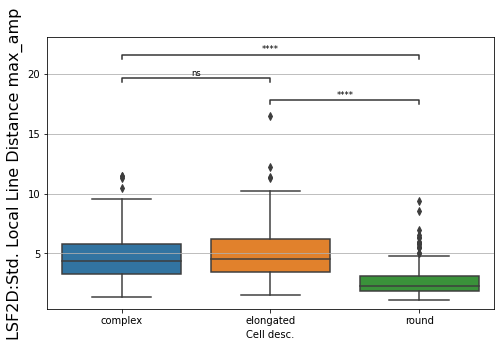

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.728e-12 stat=7.334e+00
complex v.s. elongated: t-test independent samples, P_val=7.818e-02 stat=-1.769e+00
complex v.s. round: t-test independent samples, P_val=1.233e-04 stat=3.882e+00


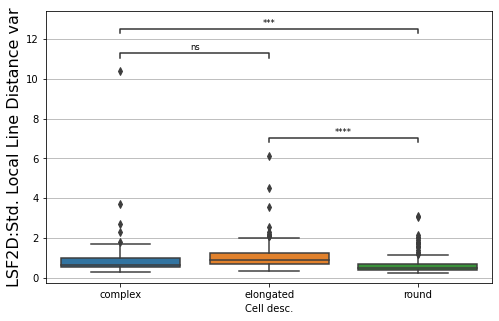

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=6.930e-17 stat=8.815e+00
complex v.s. elongated: t-test independent samples, P_val=5.913e-03 stat=-2.778e+00
complex v.s. round: t-test independent samples, P_val=2.195e-07 stat=5.284e+00


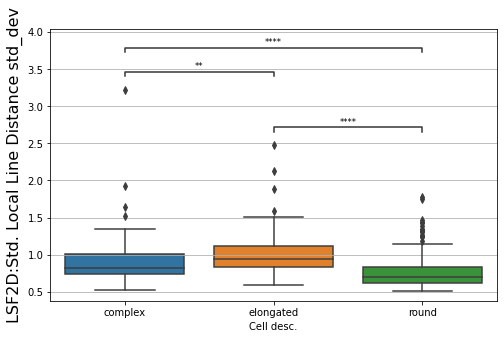

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=3.041e-19 stat=9.548e+00
complex v.s. elongated: t-test independent samples, P_val=9.877e-03 stat=-2.602e+00
complex v.s. round: t-test independent samples, P_val=9.687e-08 stat=5.444e+00


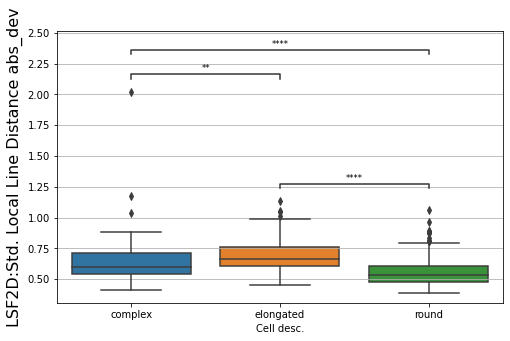

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.003e-10 stat=6.566e+00
complex v.s. elongated: t-test independent samples, P_val=3.274e-01 stat=-9.814e-01
complex v.s. round: t-test independent samples, P_val=1.719e-10 stat=6.575e+00


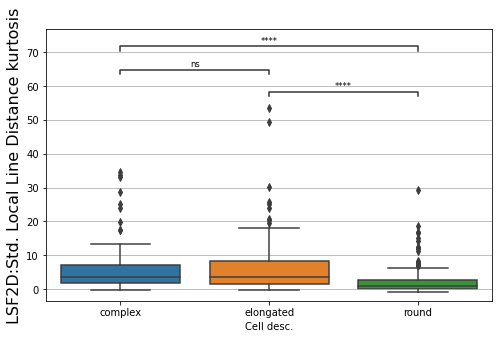

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.721e-12 stat=7.264e+00
complex v.s. elongated: t-test independent samples, P_val=1.189e-01 stat=-1.565e+00
complex v.s. round: t-test independent samples, P_val=1.523e-10 stat=6.595e+00


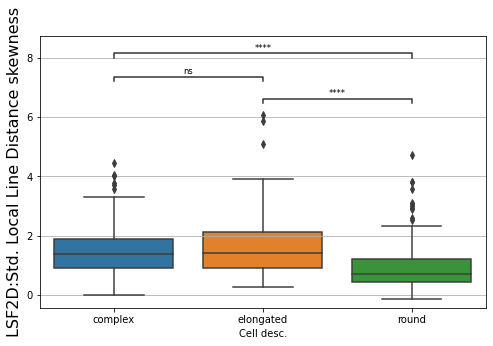

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.262e-32 stat=1.330e+01
complex v.s. elongated: t-test independent samples, P_val=1.240e-08 stat=5.908e+00
complex v.s. round: t-test independent samples, P_val=5.396e-56 stat=1.895e+01


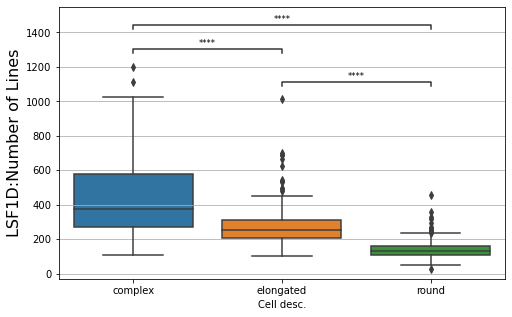

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=5.076e-03 stat=2.821e+00
complex v.s. elongated: t-test independent samples, P_val=8.271e-02 stat=-1.743e+00
complex v.s. round: t-test independent samples, P_val=4.892e-01 stat=6.922e-01


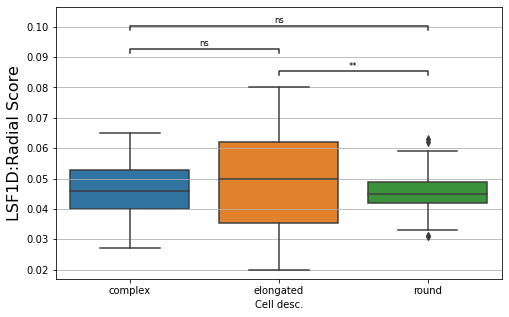

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.072e-03 stat=-3.300e+00
complex v.s. elongated: t-test independent samples, P_val=9.802e-01 stat=2.483e-02
complex v.s. round: t-test independent samples, P_val=1.201e-03 stat=-3.265e+00


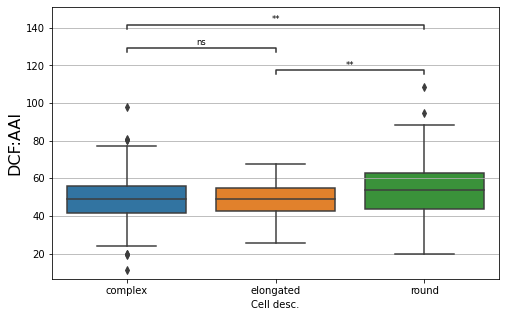

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=3.385e-02 stat=-2.131e+00
complex v.s. elongated: t-test independent samples, P_val=1.893e-18 stat=9.560e+00
complex v.s. round: t-test independent samples, P_val=5.596e-18 stat=9.117e+00


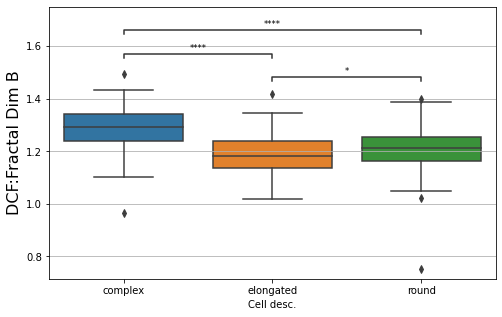

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.476e-19 stat=-9.576e+00
complex v.s. elongated: t-test independent samples, P_val=5.841e-13 stat=7.639e+00
complex v.s. round: t-test independent samples, P_val=3.979e-02 stat=-2.063e+00


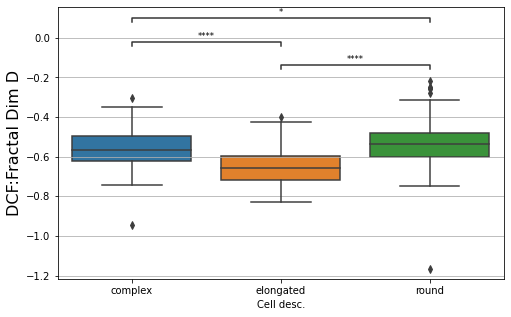

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=4.877e-32 stat=1.314e+01
complex v.s. elongated: t-test independent samples, P_val=1.550e-05 stat=4.416e+00
complex v.s. round: t-test independent samples, P_val=2.514e-56 stat=1.903e+01


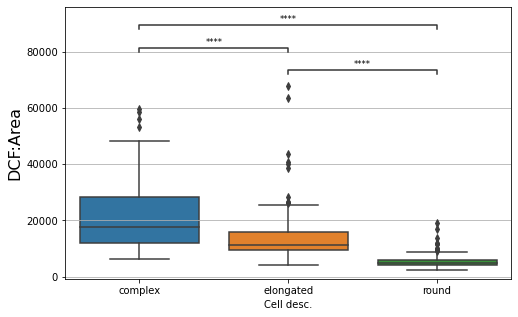

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=4.851e-41 stat=1.548e+01
complex v.s. elongated: t-test independent samples, P_val=2.379e-01 stat=-1.183e+00
complex v.s. round: t-test independent samples, P_val=1.583e-60 stat=2.005e+01


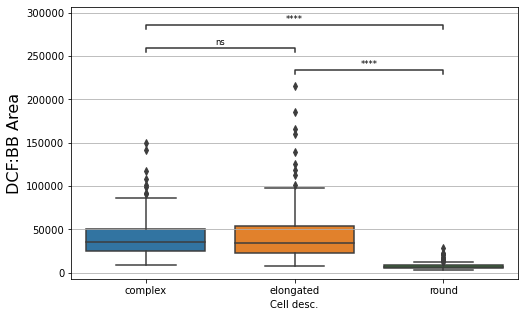

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.945e-43 stat=1.609e+01
complex v.s. elongated: t-test independent samples, P_val=3.082e-01 stat=1.021e+00
complex v.s. round: t-test independent samples, P_val=1.502e-45 stat=1.641e+01


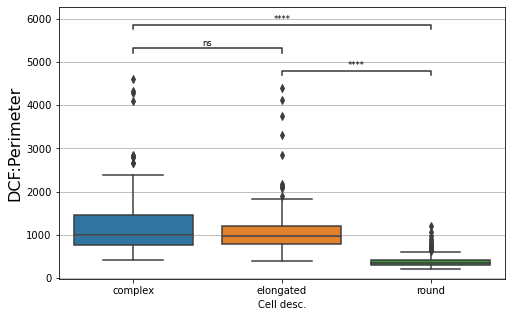

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=5.750e-17 stat=8.841e+00
complex v.s. elongated: t-test independent samples, P_val=5.416e-02 stat=-1.935e+00
complex v.s. round: t-test independent samples, P_val=3.335e-19 stat=9.489e+00


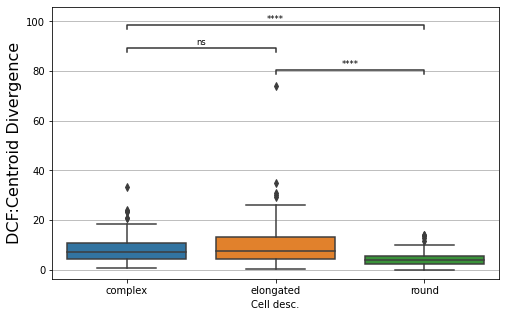

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=4.283e-48 stat=1.727e+01
complex v.s. elongated: t-test independent samples, P_val=2.340e-06 stat=4.844e+00
complex v.s. round: t-test independent samples, P_val=6.793e-75 stat=2.357e+01


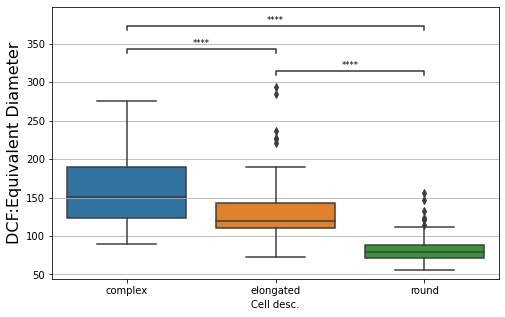

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.722e-94 stat=2.939e+01
complex v.s. elongated: t-test independent samples, P_val=5.262e-08 stat=-5.629e+00
complex v.s. round: t-test independent samples, P_val=4.310e-89 stat=2.717e+01


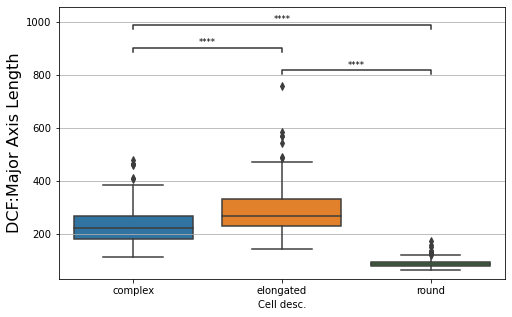

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=4.958e-02 stat=-1.971e+00
complex v.s. elongated: t-test independent samples, P_val=7.692e-24 stat=1.130e+01
complex v.s. round: t-test independent samples, P_val=2.434e-45 stat=1.636e+01


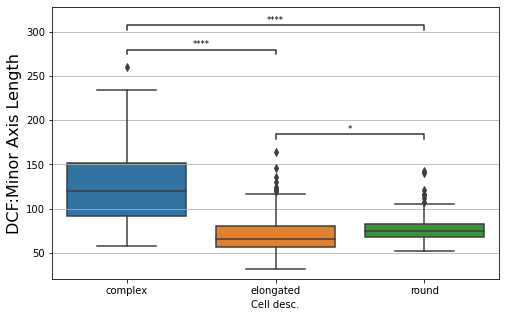

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=3.863e-118 stat=3.652e+01
complex v.s. elongated: t-test independent samples, P_val=2.747e-27 stat=-1.237e+01
complex v.s. round: t-test independent samples, P_val=3.804e-64 stat=2.093e+01


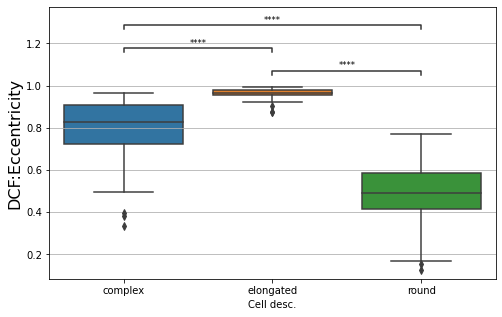

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.568e-43 stat=-1.611e+01
complex v.s. elongated: t-test independent samples, P_val=1.484e-04 stat=3.858e+00
complex v.s. round: t-test independent samples, P_val=6.257e-31 stat=-1.274e+01


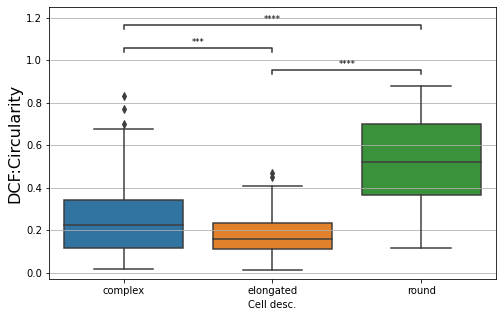

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=4.570e-186 stat=-6.285e+01
complex v.s. elongated: t-test independent samples, P_val=1.478e-40 stat=1.640e+01
complex v.s. round: t-test independent samples, P_val=4.719e-80 stat=-2.486e+01


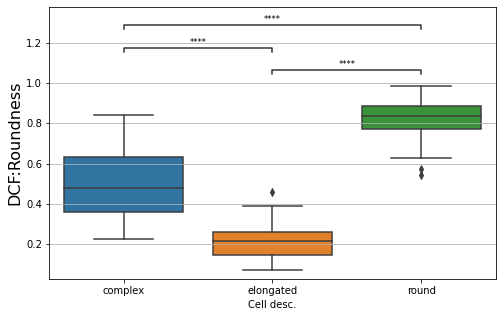

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=3.149e-01 stat=1.006e+00
complex v.s. elongated: t-test independent samples, P_val=8.185e-01 stat=-2.297e-01
complex v.s. round: t-test independent samples, P_val=4.373e-01 stat=7.776e-01


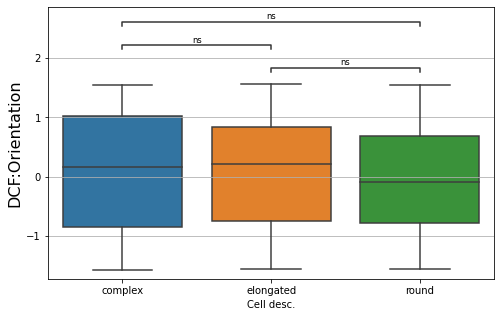

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=9.150e-43 stat=-1.592e+01
complex v.s. elongated: t-test independent samples, P_val=2.672e-06 stat=4.815e+00
complex v.s. round: t-test independent samples, P_val=3.873e-26 stat=-1.146e+01


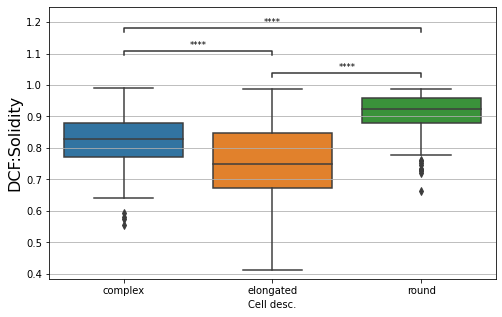

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.367e-07 stat=5.386e+00
complex v.s. elongated: t-test independent samples, P_val=6.072e-03 stat=2.770e+00
complex v.s. round: t-test independent samples, P_val=1.327e-15 stat=8.367e+00


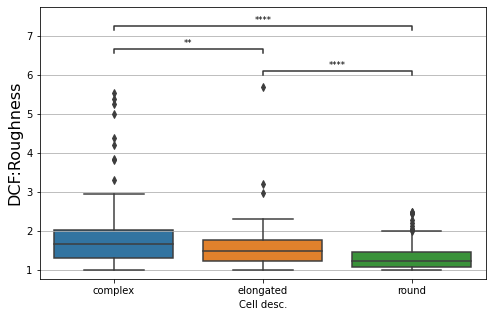

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=7.838e-04 stat=-3.390e+00
complex v.s. elongated: t-test independent samples, P_val=9.942e-01 stat=7.311e-03
complex v.s. round: t-test independent samples, P_val=8.251e-04 stat=-3.373e+00


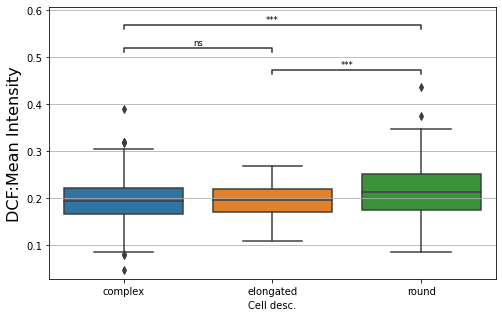

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=6.836e-05 stat=-4.033e+00
complex v.s. elongated: t-test independent samples, P_val=8.342e-01 stat=-2.096e-01
complex v.s. round: t-test independent samples, P_val=1.426e-05 stat=-4.401e+00


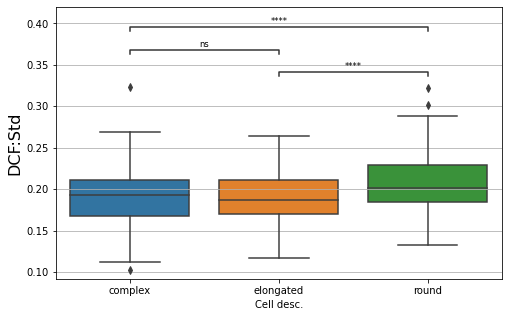

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=7.894e-05 stat=-3.998e+00
complex v.s. elongated: t-test independent samples, P_val=9.921e-01 stat=-9.901e-03
complex v.s. round: t-test independent samples, P_val=3.825e-05 stat=-4.170e+00


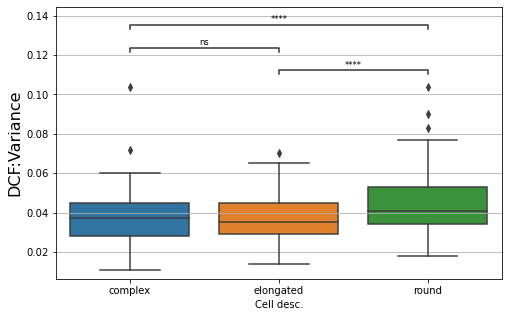

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.689e-01 stat=-1.379e+00
complex v.s. elongated: t-test independent samples, P_val=1.557e-01 stat=1.424e+00
complex v.s. round: t-test independent samples, P_val=6.808e-01 stat=4.117e-01


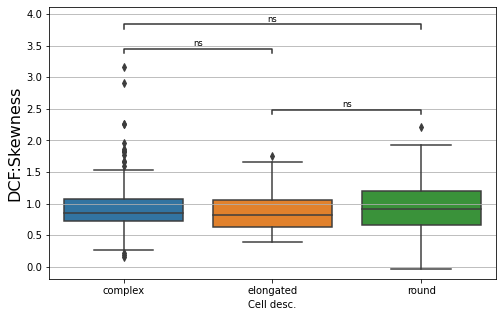

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=8.444e-02 stat=-1.731e+00
complex v.s. elongated: t-test independent samples, P_val=9.546e-02 stat=1.674e+00
complex v.s. round: t-test independent samples, P_val=3.982e-01 stat=8.458e-01


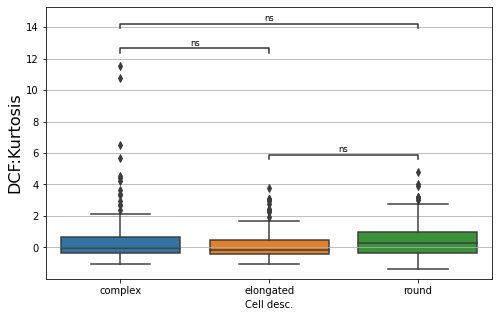

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=nan stat=nan
complex v.s. elongated: t-test independent samples, P_val=nan stat=nan
complex v.s. round: t-test independent samples, P_val=nan stat=nan


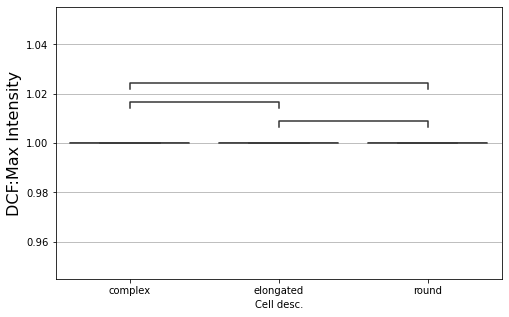

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=6.562e-04 stat=3.440e+00
complex v.s. elongated: t-test independent samples, P_val=6.958e-01 stat=-3.914e-01
complex v.s. round: t-test independent samples, P_val=2.276e-03 stat=3.074e+00


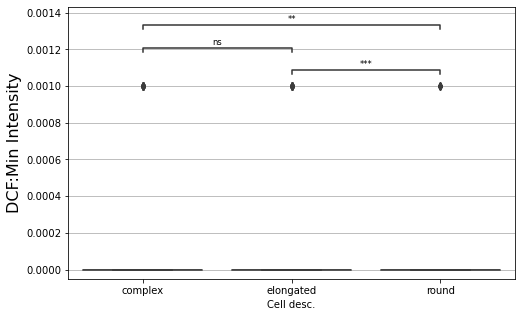

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=4.303e-79 stat=-2.523e+01
complex v.s. elongated: t-test independent samples, P_val=1.041e-17 stat=9.313e+00
complex v.s. round: t-test independent samples, P_val=1.176e-34 stat=-1.370e+01


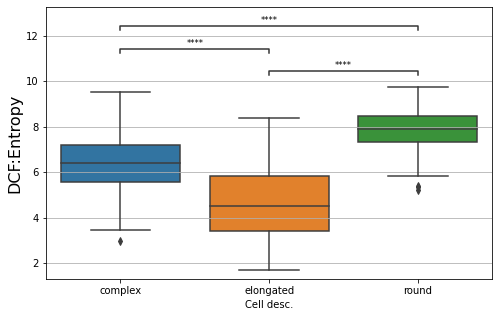

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.289e-79 stat=2.537e+01
complex v.s. elongated: t-test independent samples, P_val=1.902e-16 stat=-8.883e+00
complex v.s. round: t-test independent samples, P_val=1.252e-44 stat=1.618e+01


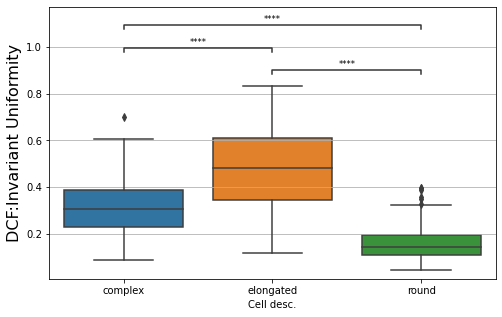

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.650e-41 stat=1.555e+01
complex v.s. elongated: t-test independent samples, P_val=1.013e-04 stat=3.957e+00
complex v.s. round: t-test independent samples, P_val=9.127e-65 stat=2.108e+01


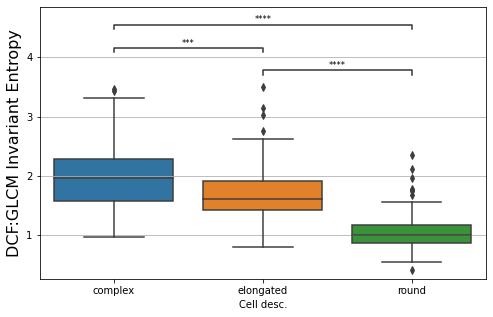

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=6.304e-04 stat=3.451e+00
complex v.s. elongated: t-test independent samples, P_val=7.065e-01 stat=-3.770e-01
complex v.s. round: t-test independent samples, P_val=2.102e-03 stat=3.098e+00


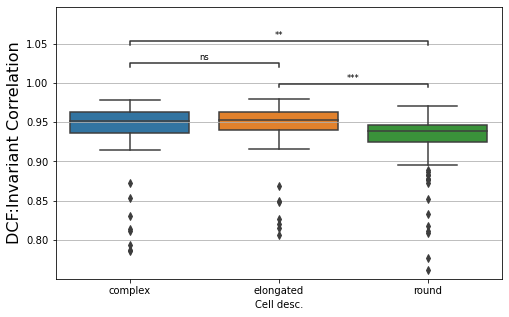

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.666e-62 stat=-2.092e+01
complex v.s. elongated: t-test independent samples, P_val=3.493e-10 stat=6.561e+00
complex v.s. round: t-test independent samples, P_val=1.039e-38 stat=-1.472e+01


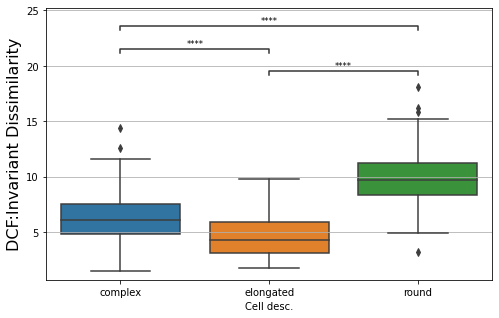

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.961e-40 stat=-1.532e+01
complex v.s. elongated: t-test independent samples, P_val=2.690e-05 stat=4.285e+00
complex v.s. round: t-test independent samples, P_val=2.107e-24 stat=-1.099e+01


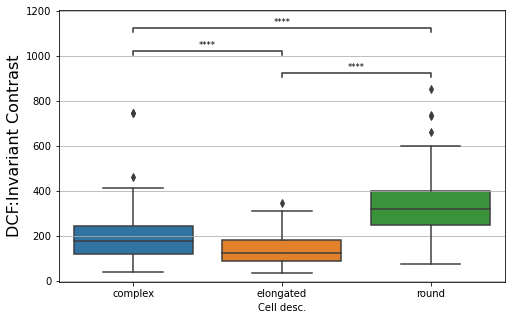

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=9.058e-78 stat=2.488e+01
complex v.s. elongated: t-test independent samples, P_val=6.730e-15 stat=-8.343e+00
complex v.s. round: t-test independent samples, P_val=7.944e-48 stat=1.697e+01


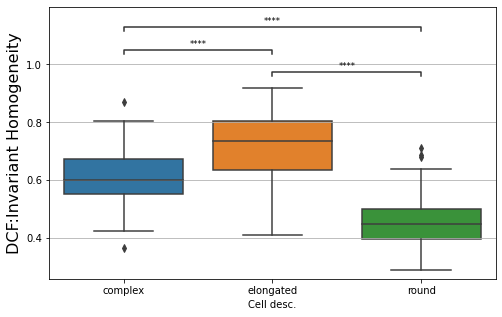

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.347e-78 stat=2.503e+01
complex v.s. elongated: t-test independent samples, P_val=2.155e-15 stat=-8.517e+00
complex v.s. round: t-test independent samples, P_val=1.566e-44 stat=1.616e+01


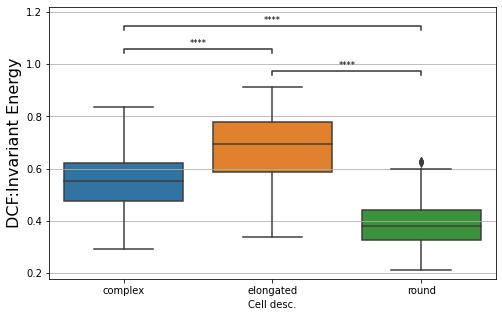

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=4.146e-35 stat=-1.395e+01
complex v.s. elongated: t-test independent samples, P_val=8.672e-06 stat=4.550e+00
complex v.s. round: t-test independent samples, P_val=2.187e-20 stat=-9.840e+00


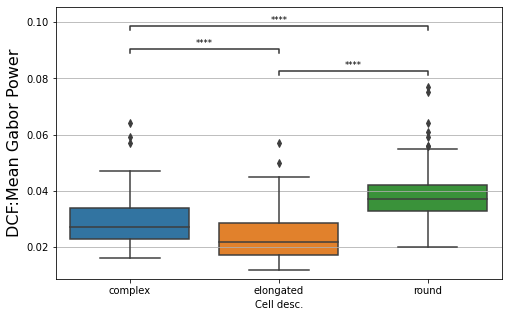

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=nan stat=nan
complex v.s. elongated: t-test independent samples, P_val=nan stat=nan
complex v.s. round: t-test independent samples, P_val=nan stat=nan


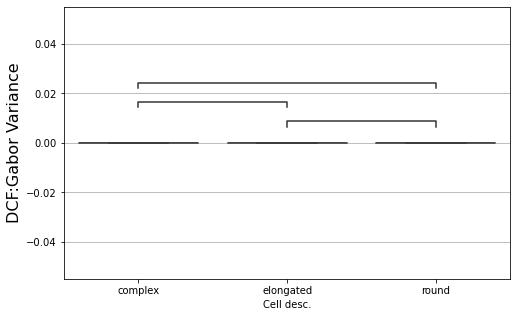

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=nan stat=nan
complex v.s. elongated: t-test independent samples, P_val=nan stat=nan
complex v.s. round: t-test independent samples, P_val=nan stat=nan


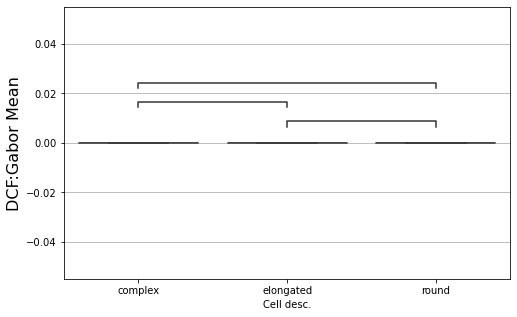

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=nan stat=nan
complex v.s. elongated: t-test independent samples, P_val=nan stat=nan
complex v.s. round: t-test independent samples, P_val=nan stat=nan


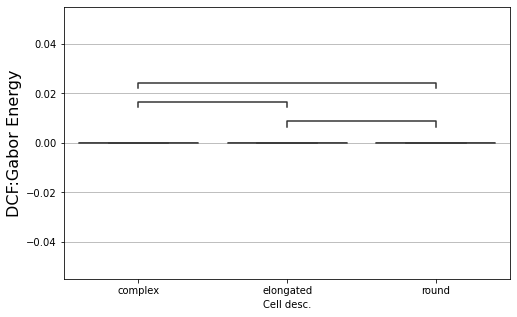

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.607e-58 stat=-1.990e+01
complex v.s. elongated: t-test independent samples, P_val=5.846e-17 stat=9.059e+00
complex v.s. round: t-test independent samples, P_val=5.227e-12 stat=-7.140e+00


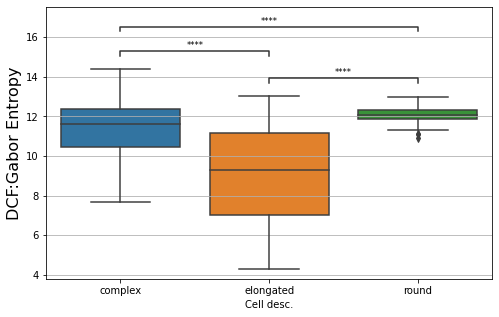

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.060e-09 stat=6.281e+00
complex v.s. elongated: t-test independent samples, P_val=1.708e-03 stat=3.174e+00
complex v.s. round: t-test independent samples, P_val=1.351e-25 stat=1.132e+01


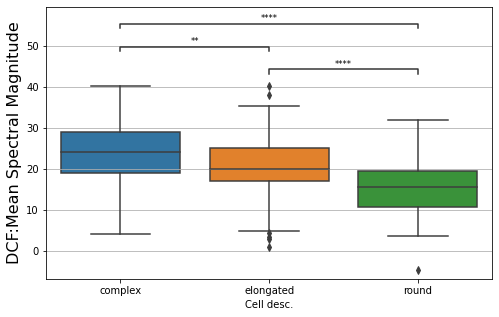

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=6.951e-16 stat=-8.492e+00
complex v.s. elongated: t-test independent samples, P_val=3.011e-01 stat=1.036e+00
complex v.s. round: t-test independent samples, P_val=2.951e-14 stat=-7.923e+00


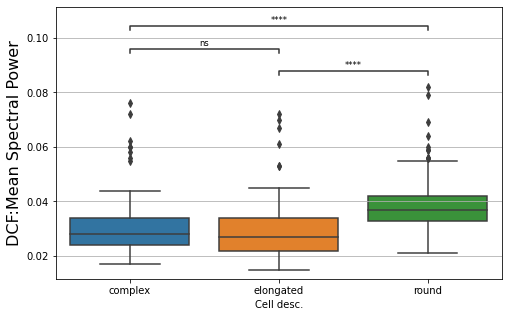

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=3.285e-02 stat=2.143e+00
complex v.s. elongated: t-test independent samples, P_val=8.073e-01 stat=-2.443e-01
complex v.s. round: t-test independent samples, P_val=5.895e-02 stat=1.895e+00


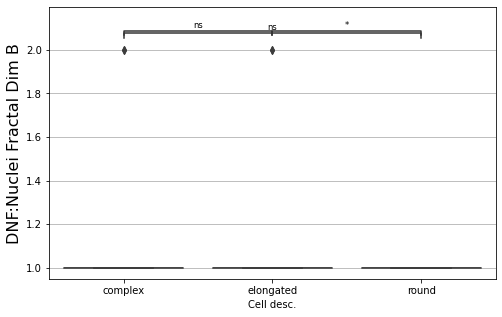

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.284e-01 stat=1.524e+00
complex v.s. elongated: t-test independent samples, P_val=1.156e-03 stat=3.291e+00
complex v.s. round: t-test independent samples, P_val=1.820e-08 stat=5.759e+00


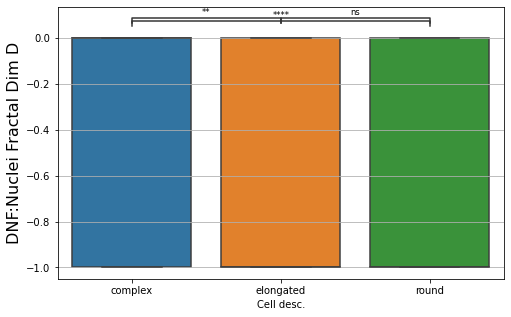

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=8.492e-22 stat=1.031e+01
complex v.s. elongated: t-test independent samples, P_val=7.547e-09 stat=6.001e+00
complex v.s. round: t-test independent samples, P_val=3.940e-57 stat=1.922e+01


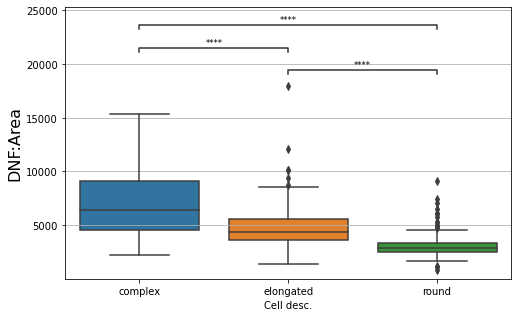

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.607e-28 stat=1.214e+01
complex v.s. elongated: t-test independent samples, P_val=2.880e-07 stat=5.288e+00
complex v.s. round: t-test independent samples, P_val=1.350e-58 stat=1.958e+01


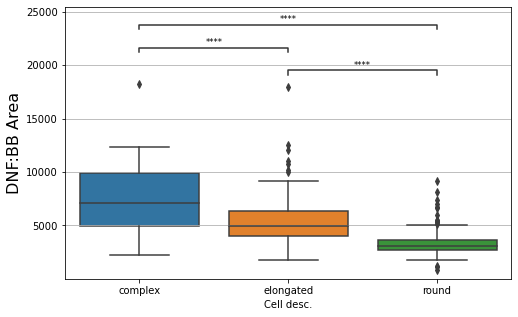

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=6.102e-28 stat=1.204e+01
complex v.s. elongated: t-test independent samples, P_val=7.259e-08 stat=5.565e+00
complex v.s. round: t-test independent samples, P_val=8.349e-53 stat=1.818e+01


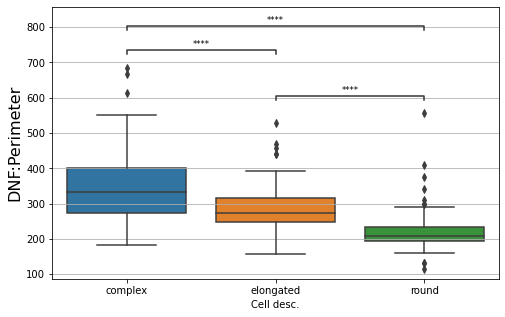

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.735e-05 stat=4.361e+00
complex v.s. elongated: t-test independent samples, P_val=9.007e-01 stat=1.250e-01
complex v.s. round: t-test independent samples, P_val=9.396e-06 stat=4.495e+00


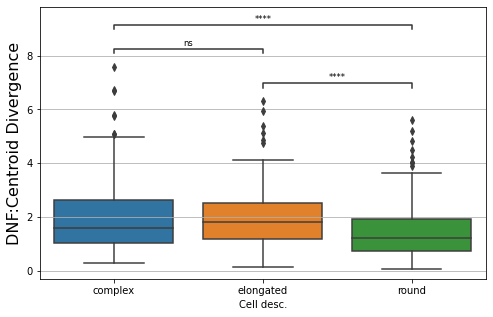

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=5.381e-25 stat=1.123e+01
complex v.s. elongated: t-test independent samples, P_val=1.438e-09 stat=6.307e+00
complex v.s. round: t-test independent samples, P_val=2.678e-62 stat=2.048e+01


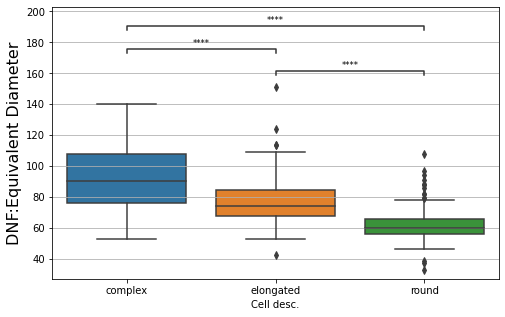

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=5.384e-49 stat=1.750e+01
complex v.s. elongated: t-test independent samples, P_val=1.192e-03 stat=3.282e+00
complex v.s. round: t-test independent samples, P_val=2.536e-66 stat=2.146e+01


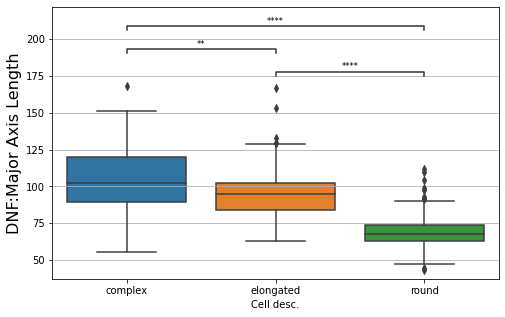

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.973e-07 stat=5.314e+00
complex v.s. elongated: t-test independent samples, P_val=1.116e-13 stat=7.904e+00
complex v.s. round: t-test independent samples, P_val=4.623e-50 stat=1.751e+01


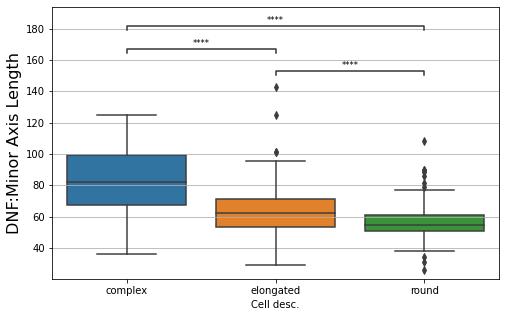

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.402e-19 stat=9.650e+00
complex v.s. elongated: t-test independent samples, P_val=6.678e-14 stat=-7.985e+00
complex v.s. round: t-test independent samples, P_val=3.457e-01 stat=9.441e-01


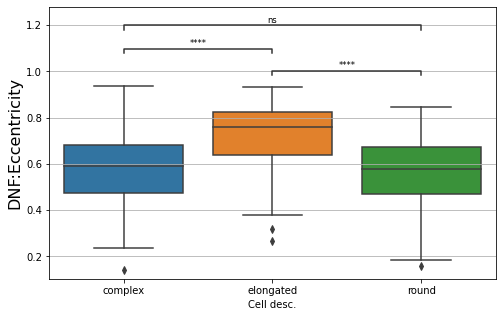

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.593e-15 stat=-8.374e+00
complex v.s. elongated: t-test independent samples, P_val=9.683e-01 stat=3.976e-02
complex v.s. round: t-test independent samples, P_val=4.763e-13 stat=-7.509e+00


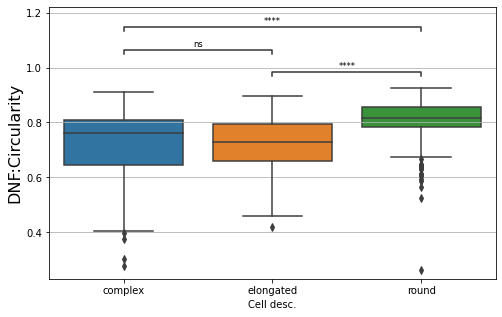

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=6.264e-25 stat=-1.121e+01
complex v.s. elongated: t-test independent samples, P_val=1.588e-14 stat=8.210e+00
complex v.s. round: t-test independent samples, P_val=1.989e-01 stat=-1.287e+00


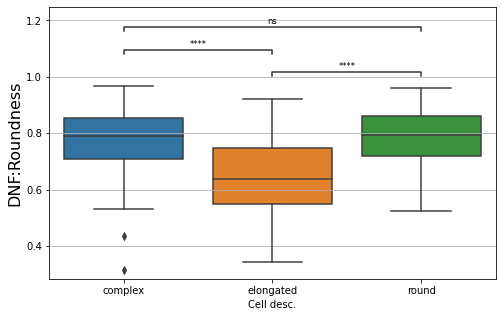

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=5.368e-01 stat=6.182e-01
complex v.s. elongated: t-test independent samples, P_val=7.735e-01 stat=2.881e-01
complex v.s. round: t-test independent samples, P_val=3.186e-01 stat=9.987e-01


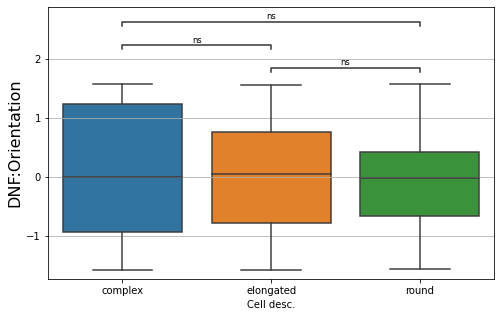

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=4.535e-07 stat=-5.148e+00
complex v.s. elongated: t-test independent samples, P_val=1.454e-01 stat=1.461e+00
complex v.s. round: t-test independent samples, P_val=3.734e-04 stat=-3.592e+00


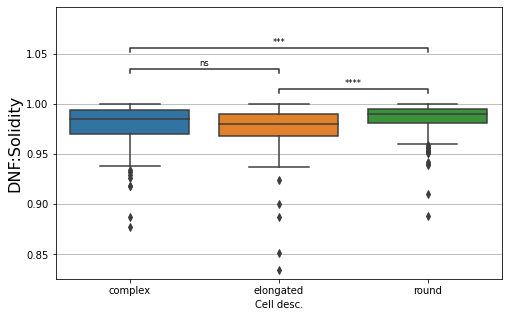

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=9.124e-04 stat=3.347e+00
complex v.s. elongated: t-test independent samples, P_val=3.797e-02 stat=2.087e+00
complex v.s. round: t-test independent samples, P_val=6.039e-08 stat=5.534e+00


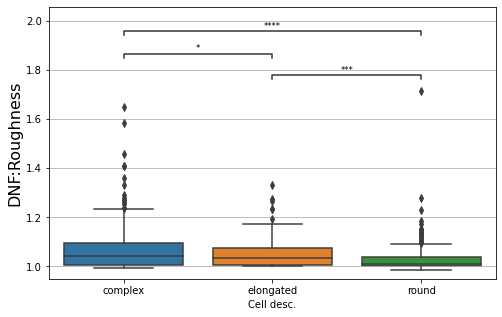

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.229e-11 stat=-6.928e+00
complex v.s. elongated: t-test independent samples, P_val=1.441e-02 stat=2.466e+00
complex v.s. round: t-test independent samples, P_val=4.272e-05 stat=-4.143e+00


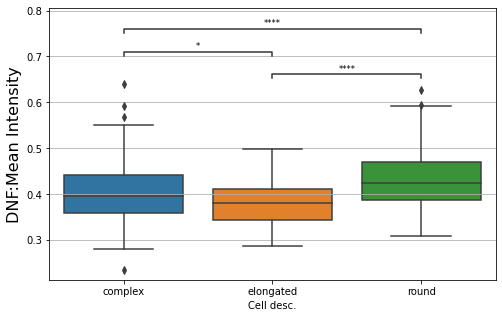

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.177e-08 stat=-5.737e+00
complex v.s. elongated: t-test independent samples, P_val=1.389e-01 stat=1.485e+00
complex v.s. round: t-test independent samples, P_val=6.019e-06 stat=-4.594e+00


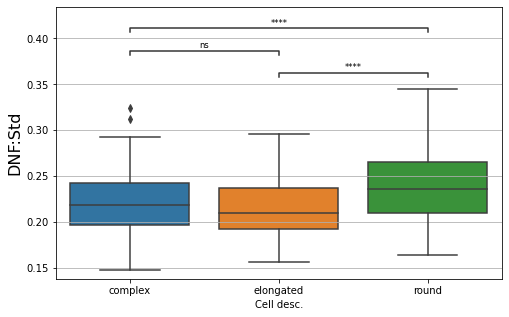

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=5.054e-08 stat=-5.578e+00
complex v.s. elongated: t-test independent samples, P_val=1.498e-01 stat=1.445e+00
complex v.s. round: t-test independent samples, P_val=7.281e-06 stat=-4.552e+00


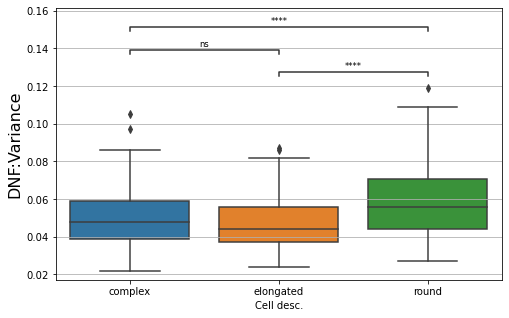

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=4.202e-01 stat=8.071e-01
complex v.s. elongated: t-test independent samples, P_val=3.108e-01 stat=-1.016e+00
complex v.s. round: t-test independent samples, P_val=5.532e-01 stat=-5.935e-01


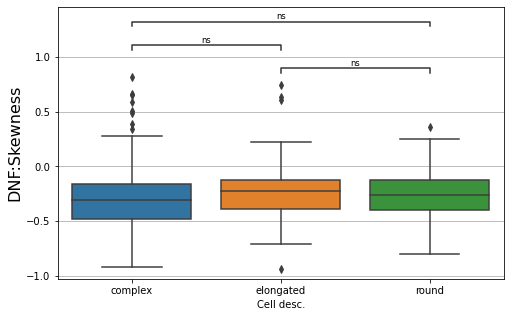

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.543e-02 stat=2.435e+00
complex v.s. elongated: t-test independent samples, P_val=8.607e-01 stat=1.757e-01
complex v.s. round: t-test independent samples, P_val=3.962e-03 stat=2.900e+00


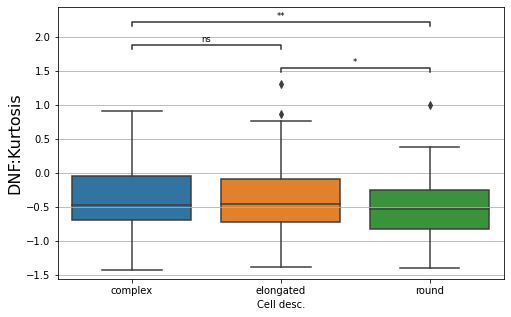

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=nan stat=nan
complex v.s. elongated: t-test independent samples, P_val=nan stat=nan
complex v.s. round: t-test independent samples, P_val=nan stat=nan


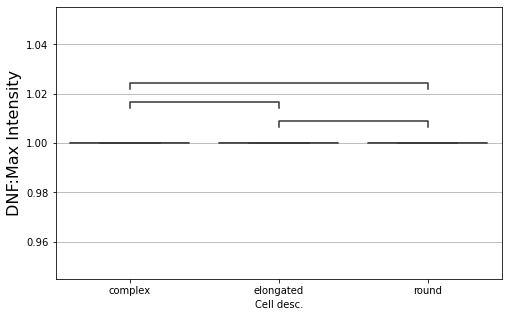

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.059e-01 stat=1.621e+00
complex v.s. elongated: t-test independent samples, P_val=3.053e-01 stat=1.027e+00
complex v.s. round: t-test independent samples, P_val=9.411e-03 stat=2.611e+00


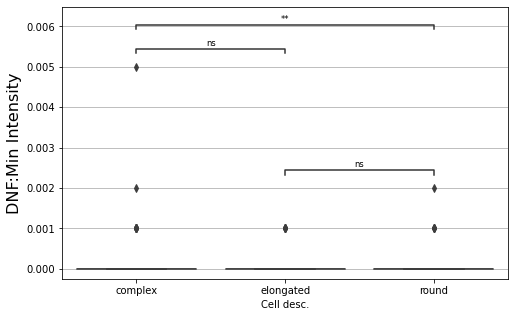

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.280e-04 stat=-3.727e+00
complex v.s. elongated: t-test independent samples, P_val=6.071e-11 stat=6.866e+00
complex v.s. round: t-test independent samples, P_val=6.983e-12 stat=7.094e+00


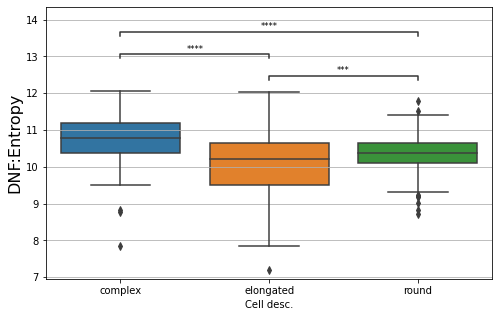

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.671e-16 stat=8.627e+00
complex v.s. elongated: t-test independent samples, P_val=1.919e-06 stat=-4.887e+00
complex v.s. round: t-test independent samples, P_val=1.879e-03 stat=3.132e+00


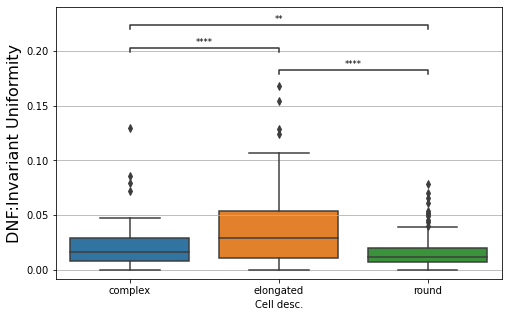

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.174e-18 stat=9.286e+00
complex v.s. elongated: t-test independent samples, P_val=3.213e-08 stat=5.725e+00
complex v.s. round: t-test independent samples, P_val=1.662e-54 stat=1.859e+01


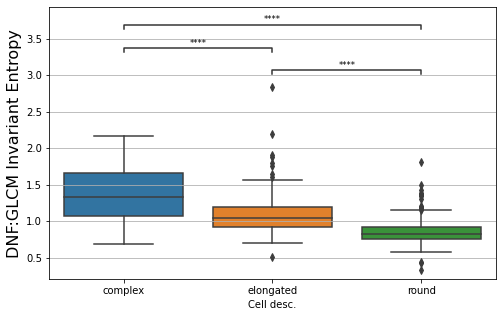

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.423e-05 stat=4.283e+00
complex v.s. elongated: t-test independent samples, P_val=4.956e-01 stat=-6.826e-01
complex v.s. round: t-test independent samples, P_val=7.271e-03 stat=2.700e+00


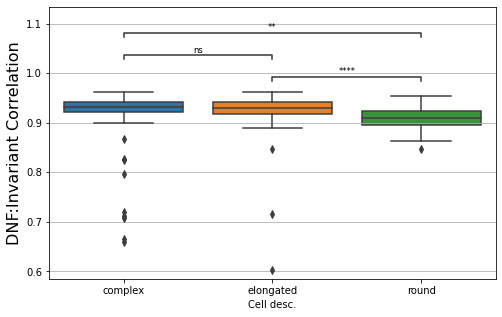

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=5.209e-21 stat=-1.008e+01
complex v.s. elongated: t-test independent samples, P_val=4.974e-02 stat=1.973e+00
complex v.s. round: t-test independent samples, P_val=3.220e-14 stat=-7.910e+00


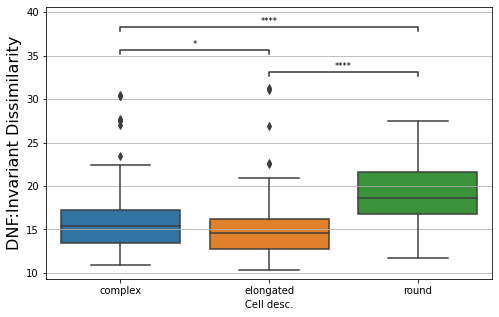

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.231e-13 stat=-7.738e+00
complex v.s. elongated: t-test independent samples, P_val=3.685e-01 stat=9.010e-01
complex v.s. round: t-test independent samples, P_val=6.789e-11 stat=-6.729e+00


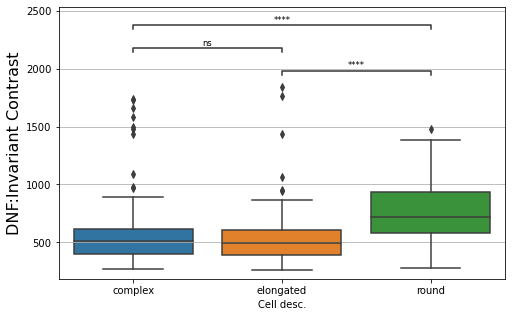

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.888e-20 stat=9.857e+00
complex v.s. elongated: t-test independent samples, P_val=2.970e-06 stat=-4.791e+00
complex v.s. round: t-test independent samples, P_val=6.829e-06 stat=4.566e+00


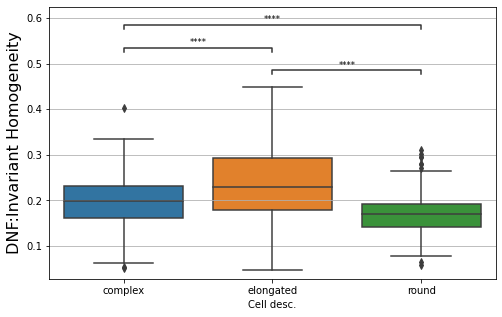

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=6.259e-15 stat=8.178e+00
complex v.s. elongated: t-test independent samples, P_val=5.467e-06 stat=-4.655e+00
complex v.s. round: t-test independent samples, P_val=8.065e-03 stat=2.664e+00


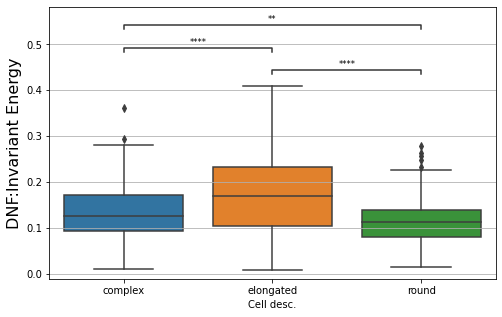

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=3.998e-13 stat=-7.560e+00
complex v.s. elongated: t-test independent samples, P_val=6.858e-01 stat=4.050e-01
complex v.s. round: t-test independent samples, P_val=4.821e-13 stat=-7.507e+00


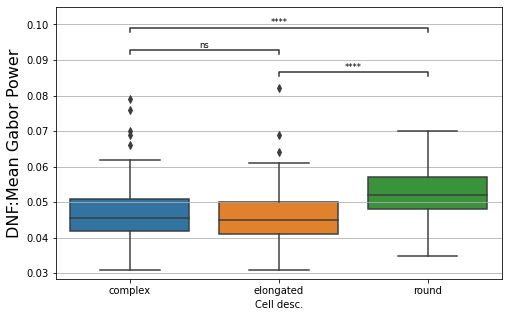

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=nan stat=nan
complex v.s. elongated: t-test independent samples, P_val=nan stat=nan
complex v.s. round: t-test independent samples, P_val=nan stat=nan


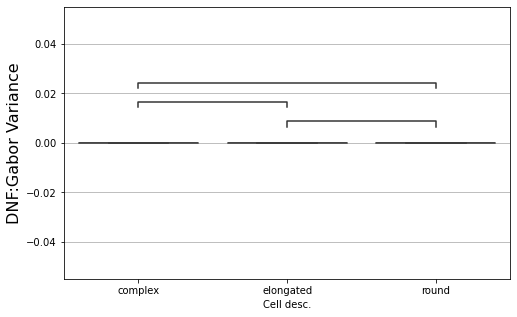

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.727e-07 stat=-5.340e+00
complex v.s. elongated: t-test independent samples, P_val=1.620e-03 stat=3.190e+00
complex v.s. round: t-test independent samples, P_val=3.832e-02 stat=-2.079e+00


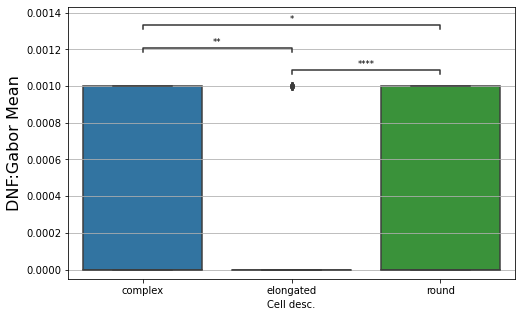

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=nan stat=nan
complex v.s. elongated: t-test independent samples, P_val=nan stat=nan
complex v.s. round: t-test independent samples, P_val=nan stat=nan


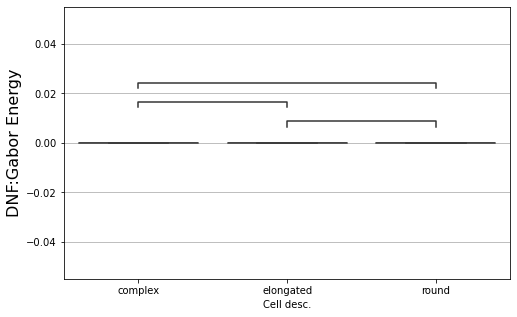

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=4.155e-27 stat=1.181e+01
complex v.s. elongated: t-test independent samples, P_val=1.312e-09 stat=6.324e+00
complex v.s. round: t-test independent samples, P_val=7.539e-64 stat=2.086e+01


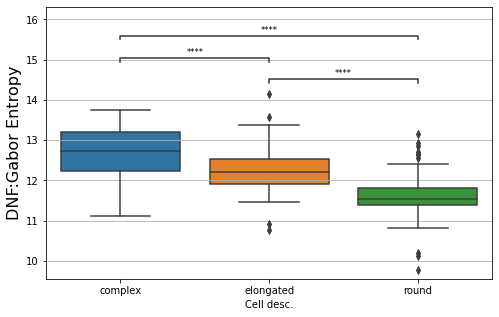

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=9.763e-01 stat=-2.970e-02
complex v.s. elongated: t-test independent samples, P_val=8.374e-05 stat=4.005e+00
complex v.s. round: t-test independent samples, P_val=8.580e-09 stat=5.896e+00


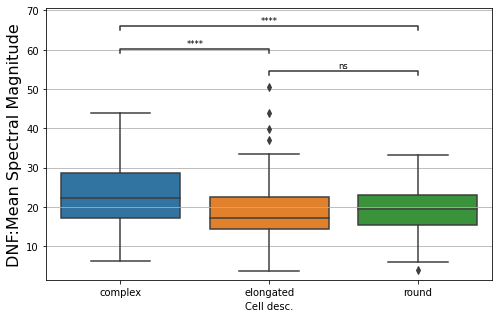

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=7.740e-05 stat=-4.002e+00
complex v.s. elongated: t-test independent samples, P_val=6.275e-01 stat=4.859e-01
complex v.s. round: t-test independent samples, P_val=1.089e-02 stat=-2.559e+00


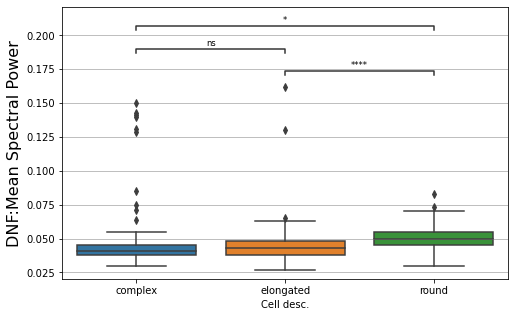

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.342e-25 stat=1.139e+01
complex v.s. elongated: t-test independent samples, P_val=9.474e-09 stat=5.959e+00
complex v.s. round: t-test independent samples, P_val=1.664e-50 stat=1.762e+01


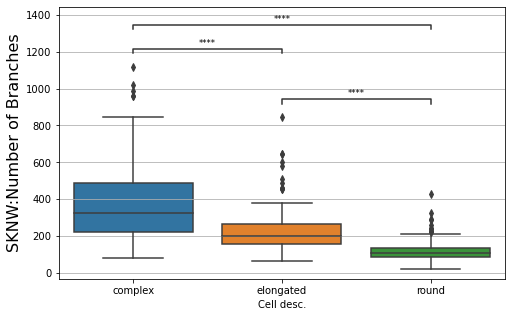

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=4.144e-39 stat=1.498e+01
complex v.s. elongated: t-test independent samples, P_val=7.344e-12 stat=-7.224e+00
complex v.s. round: t-test independent samples, P_val=5.774e-15 stat=8.159e+00


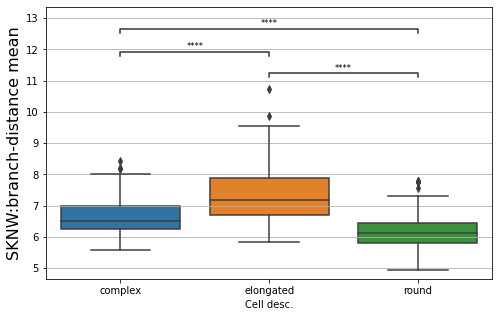

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=8.231e-05 stat=3.987e+00
complex v.s. elongated: t-test independent samples, P_val=2.709e-01 stat=-1.104e+00
complex v.s. round: t-test independent samples, P_val=1.047e-03 stat=3.305e+00


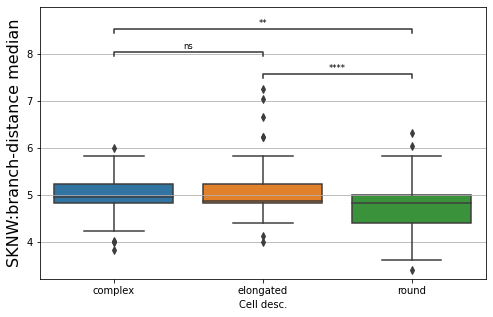

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.972e-01 stat=-1.292e+00
complex v.s. elongated: t-test independent samples, P_val=2.598e-01 stat=-1.130e+00
complex v.s. round: t-test independent samples, P_val=4.664e-02 stat=-1.996e+00


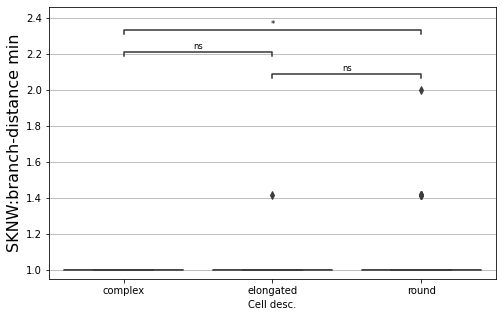

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=6.035e-32 stat=1.312e+01
complex v.s. elongated: t-test independent samples, P_val=1.589e-06 stat=-4.928e+00
complex v.s. round: t-test independent samples, P_val=1.215e-21 stat=1.021e+01


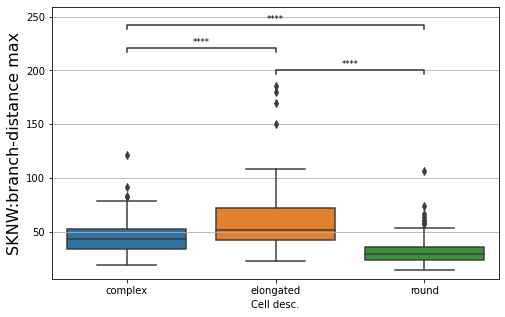

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=9.974e-31 stat=1.279e+01
complex v.s. elongated: t-test independent samples, P_val=3.371e-06 stat=-4.763e+00
complex v.s. round: t-test independent samples, P_val=3.944e-21 stat=1.006e+01


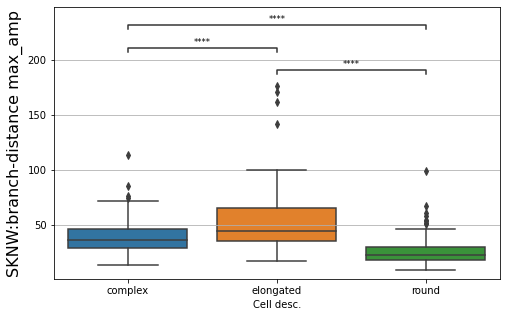

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.023e-32 stat=1.332e+01
complex v.s. elongated: t-test independent samples, P_val=1.982e-13 stat=-7.813e+00
complex v.s. round: t-test independent samples, P_val=9.503e-11 stat=6.673e+00


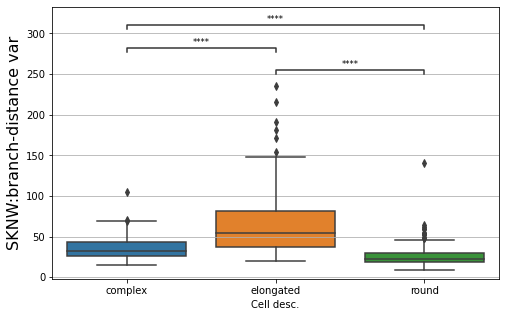

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=8.783e-41 stat=1.541e+01
complex v.s. elongated: t-test independent samples, P_val=2.220e-15 stat=-8.513e+00
complex v.s. round: t-test independent samples, P_val=4.239e-13 stat=7.527e+00


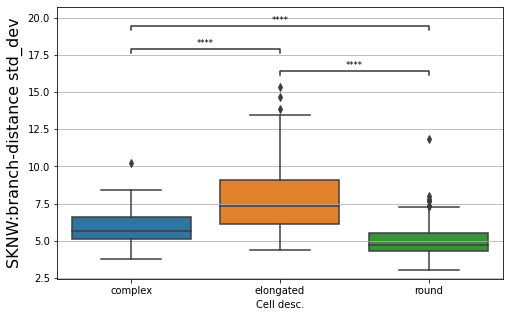

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=7.538e-44 stat=1.619e+01
complex v.s. elongated: t-test independent samples, P_val=2.609e-13 stat=-7.769e+00
complex v.s. round: t-test independent samples, P_val=4.802e-17 stat=8.827e+00


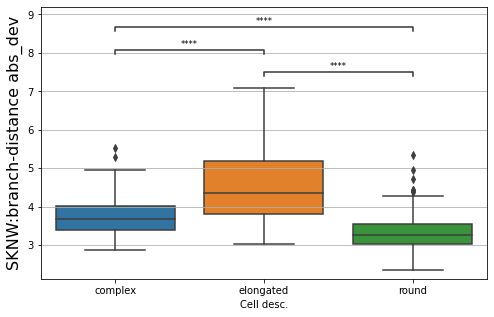

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.777e-09 stat=6.111e+00
complex v.s. elongated: t-test independent samples, P_val=2.269e-03 stat=-3.087e+00
complex v.s. round: t-test independent samples, P_val=9.745e-04 stat=3.325e+00


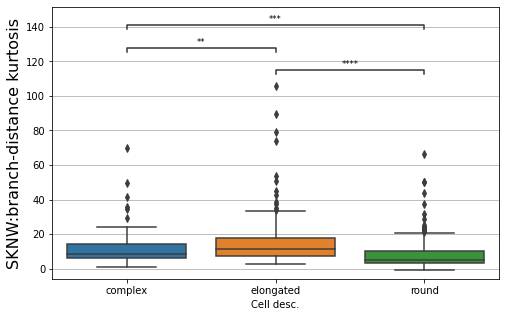

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=8.694e-14 stat=7.790e+00
complex v.s. elongated: t-test independent samples, P_val=1.387e-05 stat=-4.442e+00
complex v.s. round: t-test independent samples, P_val=2.146e-04 stat=3.739e+00


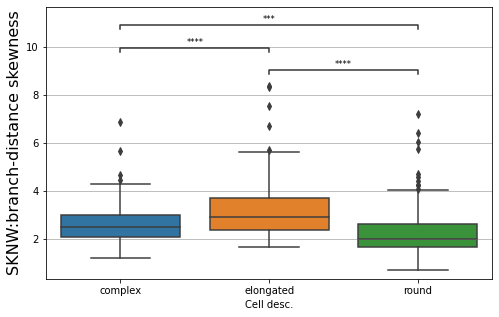

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.308e-05 stat=-4.425e+00
complex v.s. elongated: t-test independent samples, P_val=5.343e-01 stat=6.224e-01
complex v.s. round: t-test independent samples, P_val=9.013e-05 stat=-3.961e+00


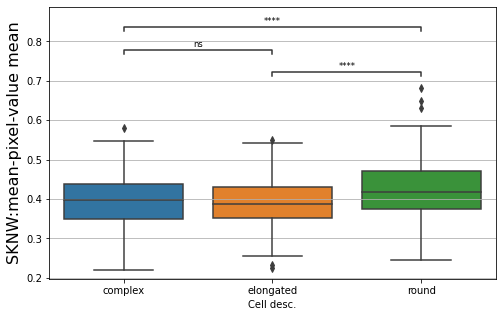

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.199e-03 stat=-3.268e+00
complex v.s. elongated: t-test independent samples, P_val=9.121e-01 stat=1.105e-01
complex v.s. round: t-test independent samples, P_val=8.694e-04 stat=-3.358e+00


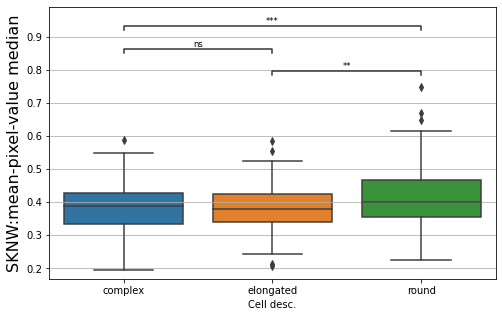

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.178e-03 stat=-3.273e+00
complex v.s. elongated: t-test independent samples, P_val=4.442e-03 stat=-2.873e+00
complex v.s. round: t-test independent samples, P_val=5.398e-11 stat=-6.766e+00


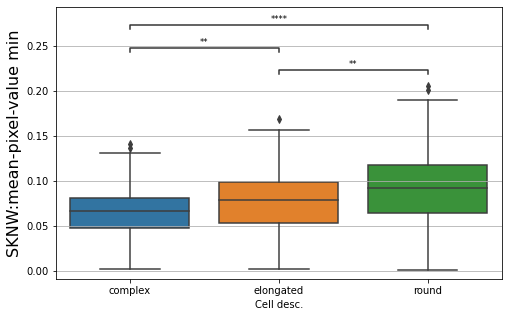

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.399e-04 stat=-3.713e+00
complex v.s. elongated: t-test independent samples, P_val=3.810e-04 stat=3.606e+00
complex v.s. round: t-test independent samples, P_val=6.875e-01 stat=4.026e-01


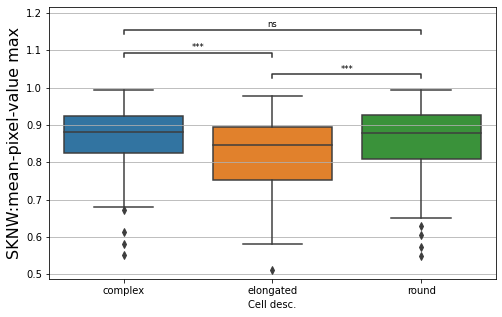

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.857e-01 stat=-1.069e+00
complex v.s. elongated: t-test independent samples, P_val=2.474e-05 stat=4.305e+00
complex v.s. round: t-test independent samples, P_val=1.602e-05 stat=4.374e+00


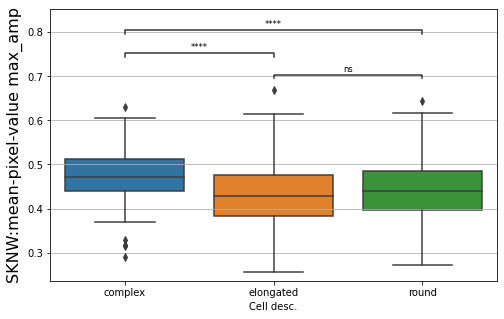

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.966e-10 stat=-6.569e+00
complex v.s. elongated: t-test independent samples, P_val=7.877e-02 stat=1.766e+00
complex v.s. round: t-test independent samples, P_val=2.028e-06 stat=-4.830e+00


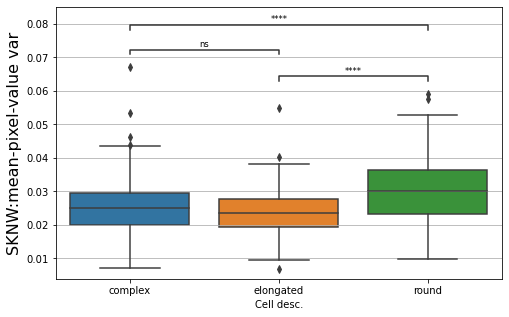

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=8.205e-11 stat=-6.715e+00
complex v.s. elongated: t-test independent samples, P_val=9.692e-02 stat=1.667e+00
complex v.s. round: t-test independent samples, P_val=7.406e-07 stat=-5.040e+00


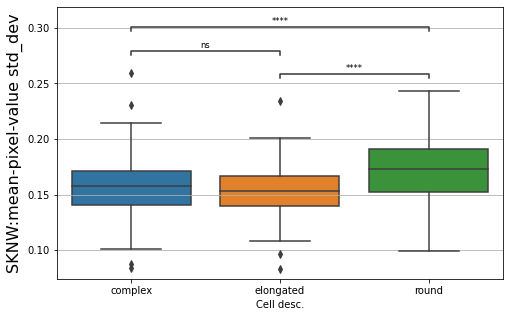

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.818e-09 stat=-6.186e+00
complex v.s. elongated: t-test independent samples, P_val=1.275e-01 stat=1.529e+00
complex v.s. round: t-test independent samples, P_val=1.082e-05 stat=-4.463e+00


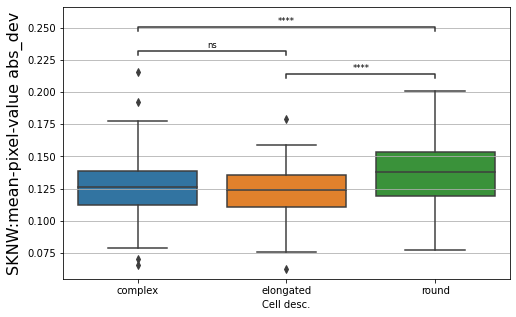

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=5.090e-02 stat=1.959e+00
complex v.s. elongated: t-test independent samples, P_val=6.375e-01 stat=4.718e-01
complex v.s. round: t-test independent samples, P_val=6.633e-03 stat=2.731e+00


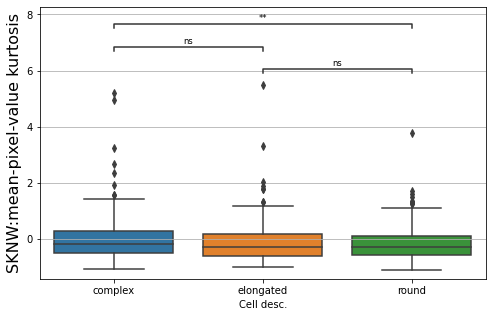

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=9.594e-01 stat=5.100e-02
complex v.s. elongated: t-test independent samples, P_val=9.576e-02 stat=1.673e+00
complex v.s. round: t-test independent samples, P_val=3.563e-02 stat=2.109e+00


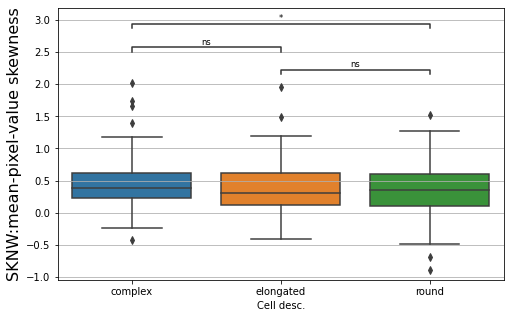

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=6.913e-23 stat=-1.063e+01
complex v.s. elongated: t-test independent samples, P_val=8.568e-01 stat=-1.807e-01
complex v.s. round: t-test independent samples, P_val=4.712e-26 stat=-1.144e+01


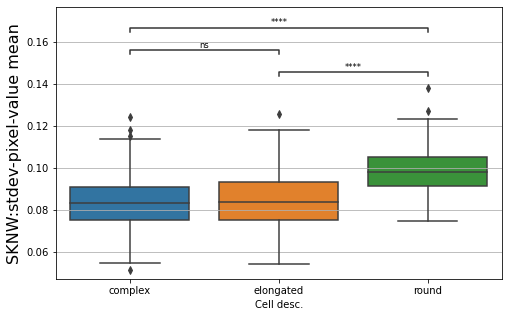

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=9.664e-18 stat=-9.085e+00
complex v.s. elongated: t-test independent samples, P_val=9.544e-01 stat=5.724e-02
complex v.s. round: t-test independent samples, P_val=1.305e-19 stat=-9.611e+00


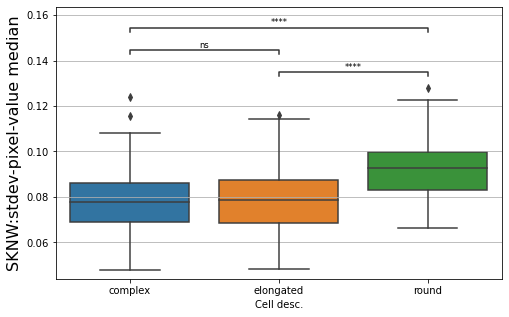

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=5.264e-10 stat=-6.402e+00
complex v.s. elongated: t-test independent samples, P_val=3.702e-02 stat=-2.098e+00
complex v.s. round: t-test independent samples, P_val=1.150e-16 stat=-8.707e+00


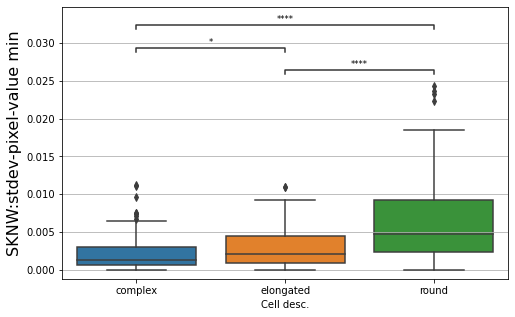

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=4.852e-02 stat=-1.980e+00
complex v.s. elongated: t-test independent samples, P_val=4.001e-01 stat=-8.431e-01
complex v.s. round: t-test independent samples, P_val=9.421e-04 stat=-3.335e+00


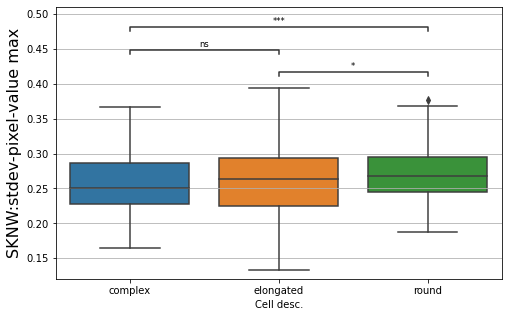

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=3.185e-01 stat=9.991e-01
complex v.s. elongated: t-test independent samples, P_val=3.450e-01 stat=-9.463e-01
complex v.s. round: t-test independent samples, P_val=9.346e-01 stat=-8.215e-02


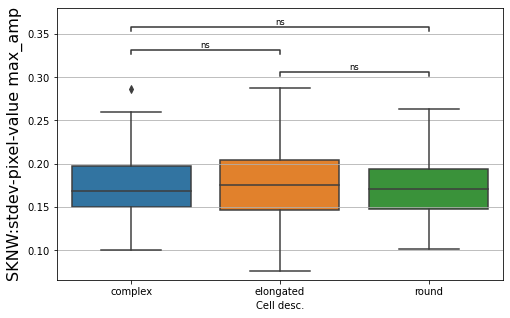

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.007e-18 stat=-9.297e+00
complex v.s. elongated: t-test independent samples, P_val=4.628e-01 stat=-7.355e-01
complex v.s. round: t-test independent samples, P_val=5.211e-23 stat=-1.060e+01


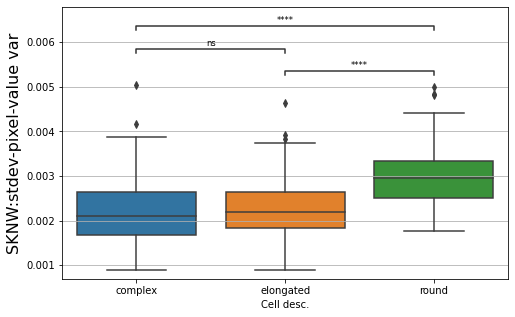

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=3.970e-20 stat=-9.815e+00
complex v.s. elongated: t-test independent samples, P_val=3.837e-01 stat=-8.728e-01
complex v.s. round: t-test independent samples, P_val=2.340e-25 stat=-1.125e+01


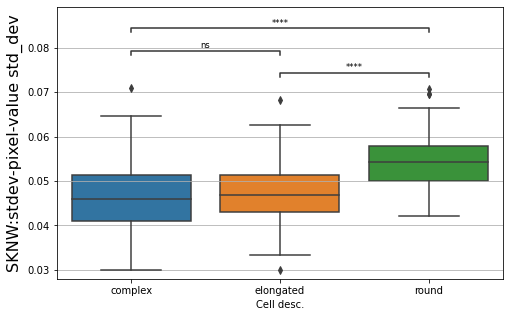

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.936e-21 stat=-1.015e+01
complex v.s. elongated: t-test independent samples, P_val=8.212e-01 stat=-2.263e-01
complex v.s. round: t-test independent samples, P_val=2.686e-23 stat=-1.068e+01


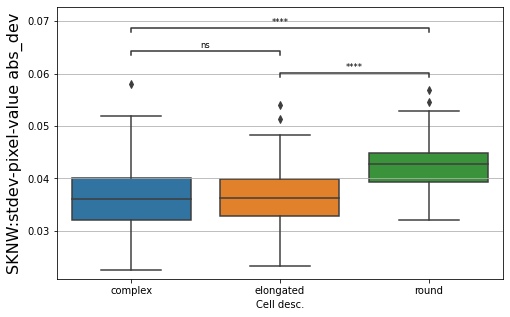

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.627e-04 stat=3.689e+00
complex v.s. elongated: t-test independent samples, P_val=6.646e-03 stat=-2.739e+00
complex v.s. round: t-test independent samples, P_val=4.469e-01 stat=7.614e-01


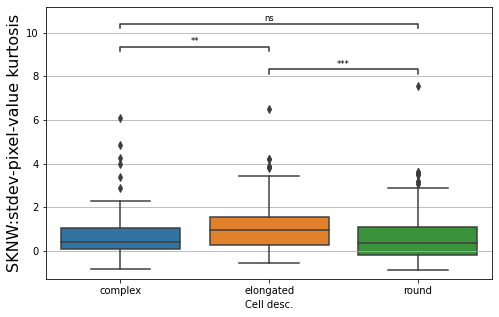

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.377e-03 stat=3.227e+00
complex v.s. elongated: t-test independent samples, P_val=3.963e-03 stat=-2.911e+00
complex v.s. round: t-test independent samples, P_val=8.390e-01 stat=2.034e-01


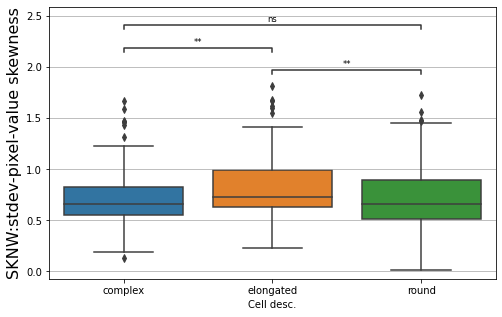

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.225e-41 stat=1.563e+01
complex v.s. elongated: t-test independent samples, P_val=4.544e-12 stat=-7.304e+00
complex v.s. round: t-test independent samples, P_val=7.658e-17 stat=8.763e+00


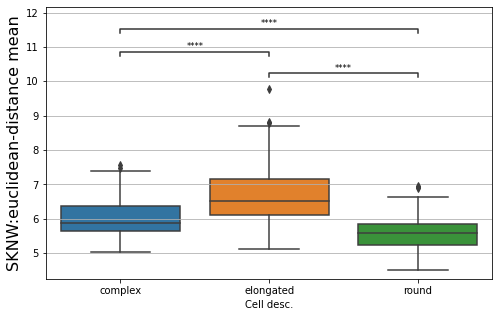

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.275e-05 stat=4.431e+00
complex v.s. elongated: t-test independent samples, P_val=4.941e-01 stat=-6.849e-01
complex v.s. round: t-test independent samples, P_val=2.065e-05 stat=4.315e+00


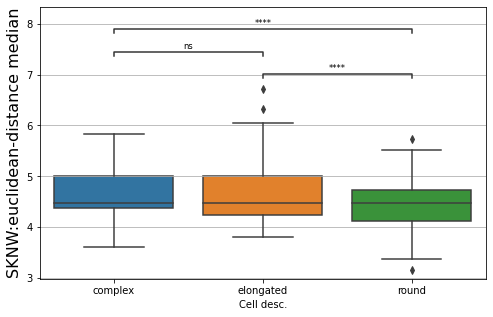

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=5.067e-02 stat=-1.961e+00
complex v.s. elongated: t-test independent samples, P_val=4.828e-02 stat=-1.985e+00
complex v.s. round: t-test independent samples, P_val=3.595e-06 stat=-4.707e+00


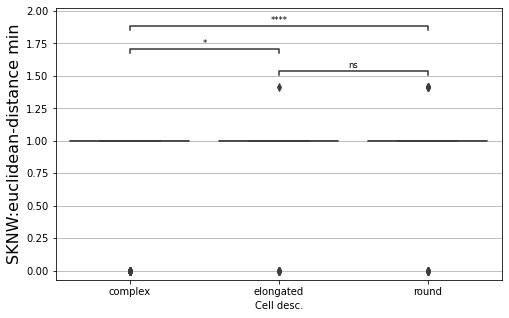

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.886e-36 stat=1.430e+01
complex v.s. elongated: t-test independent samples, P_val=2.692e-07 stat=-5.301e+00
complex v.s. round: t-test independent samples, P_val=2.936e-26 stat=1.150e+01


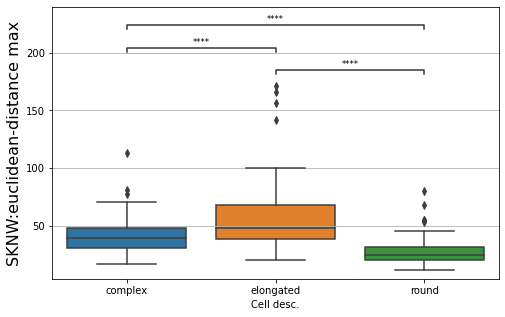

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=3.255e-35 stat=1.398e+01
complex v.s. elongated: t-test independent samples, P_val=5.783e-07 stat=-5.143e+00
complex v.s. round: t-test independent samples, P_val=1.169e-25 stat=1.133e+01


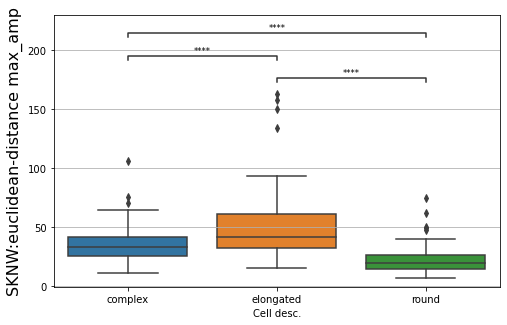

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.337e-35 stat=1.408e+01
complex v.s. elongated: t-test independent samples, P_val=9.794e-14 stat=-7.925e+00
complex v.s. round: t-test independent samples, P_val=2.862e-15 stat=8.259e+00


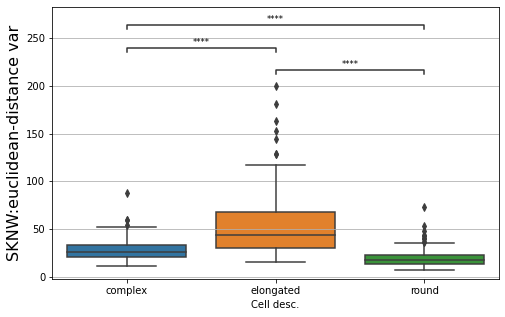

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.440e-45 stat=1.663e+01
complex v.s. elongated: t-test independent samples, P_val=5.973e-16 stat=-8.712e+00
complex v.s. round: t-test independent samples, P_val=3.988e-17 stat=8.852e+00


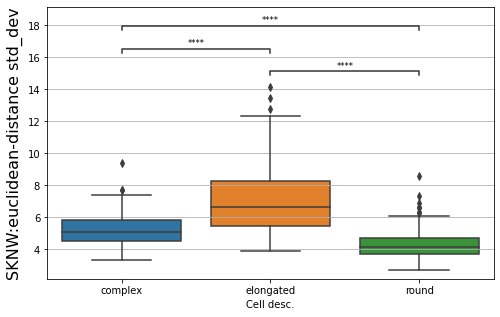

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=5.546e-47 stat=1.699e+01
complex v.s. elongated: t-test independent samples, P_val=1.079e-13 stat=-7.909e+00
complex v.s. round: t-test independent samples, P_val=1.075e-19 stat=9.636e+00


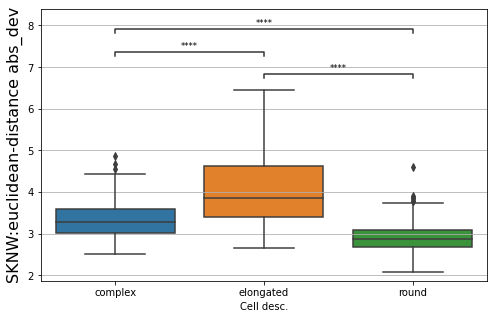

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.975e-12 stat=7.314e+00
complex v.s. elongated: t-test independent samples, P_val=1.041e-03 stat=-3.322e+00
complex v.s. round: t-test independent samples, P_val=8.906e-06 stat=4.507e+00


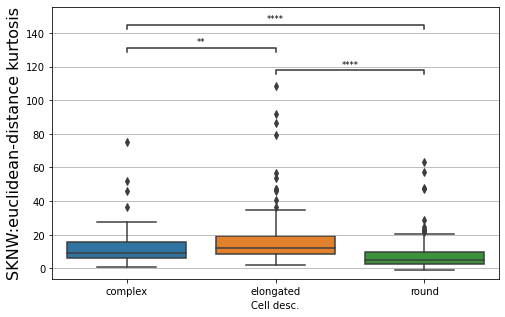

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=5.041e-19 stat=9.481e+00
complex v.s. elongated: t-test independent samples, P_val=2.523e-06 stat=-4.827e+00
complex v.s. round: t-test independent samples, P_val=6.913e-07 stat=5.054e+00


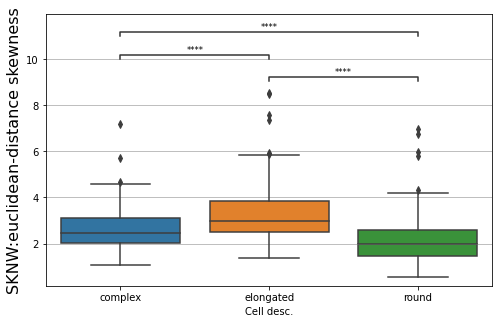

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=9.175e-18 stat=9.092e+00
complex v.s. elongated: t-test independent samples, P_val=8.396e-03 stat=2.659e+00
complex v.s. round: t-test independent samples, P_val=3.550e-35 stat=1.383e+01


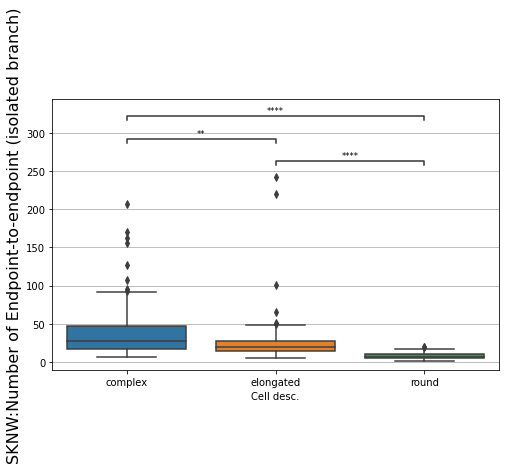

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=3.068e-15 stat=8.281e+00
complex v.s. elongated: t-test independent samples, P_val=2.896e-01 stat=-1.062e+00
complex v.s. round: t-test independent samples, P_val=1.120e-09 stat=6.257e+00


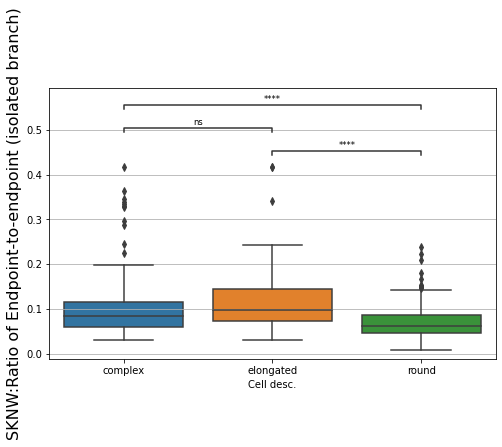

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.104e-07 stat=5.428e+00
complex v.s. elongated: t-test independent samples, P_val=2.647e-02 stat=-2.234e+00
complex v.s. round: t-test independent samples, P_val=1.678e-04 stat=3.803e+00


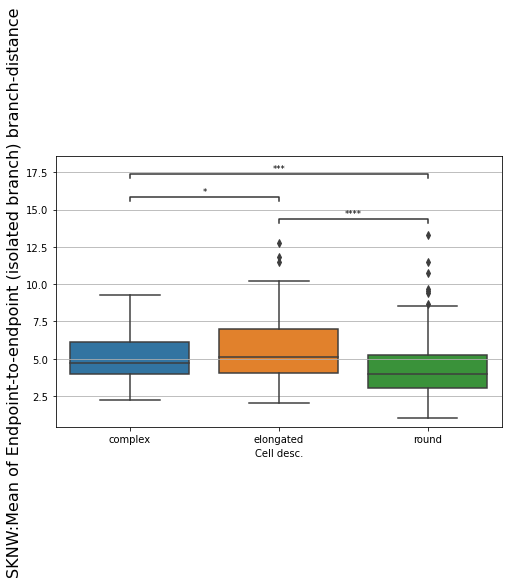

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=4.689e-18 stat=9.183e+00
complex v.s. elongated: t-test independent samples, P_val=5.369e-03 stat=-2.811e+00
complex v.s. round: t-test independent samples, P_val=5.720e-13 stat=7.481e+00


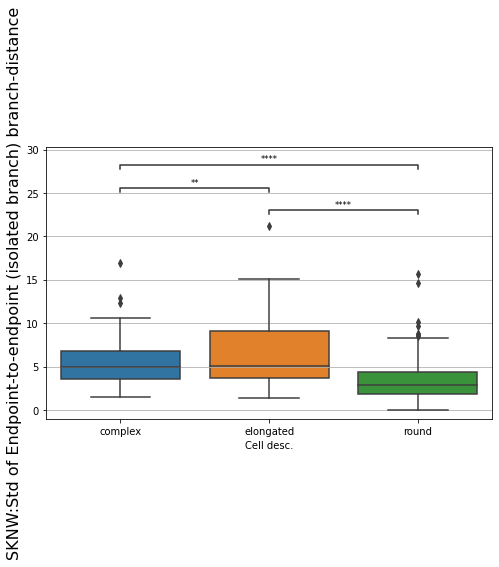

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=7.077e-01 stat=3.753e-01
complex v.s. elongated: t-test independent samples, P_val=8.454e-01 stat=1.952e-01
complex v.s. round: t-test independent samples, P_val=5.492e-01 stat=5.996e-01


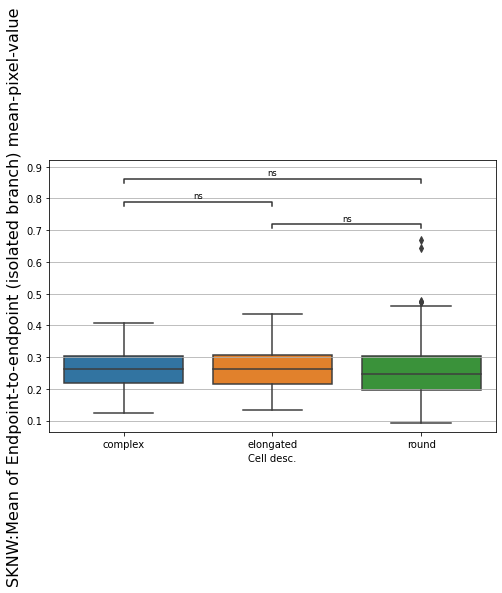

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=4.594e-01 stat=7.407e-01
complex v.s. elongated: t-test independent samples, P_val=1.156e-01 stat=1.580e+00
complex v.s. round: t-test independent samples, P_val=3.262e-02 stat=2.145e+00


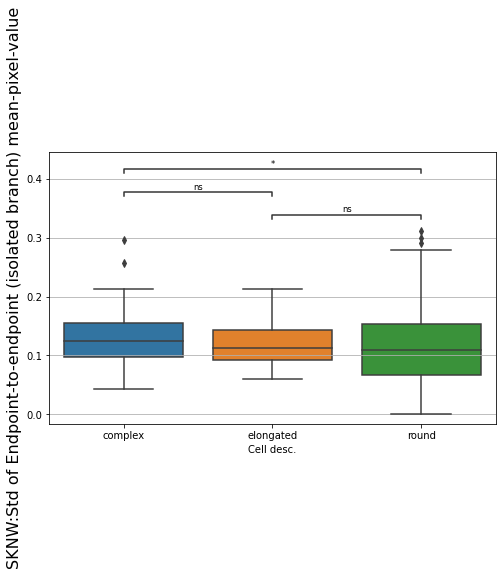

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=3.350e-02 stat=-2.135e+00
complex v.s. elongated: t-test independent samples, P_val=9.701e-01 stat=-3.749e-02
complex v.s. round: t-test independent samples, P_val=1.615e-02 stat=-2.417e+00


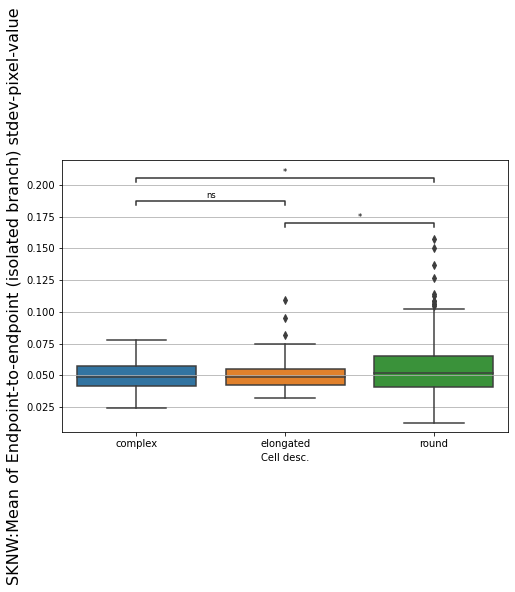

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=6.900e-01 stat=3.992e-01
complex v.s. elongated: t-test independent samples, P_val=6.531e-01 stat=4.500e-01
complex v.s. round: t-test independent samples, P_val=4.123e-01 stat=8.208e-01


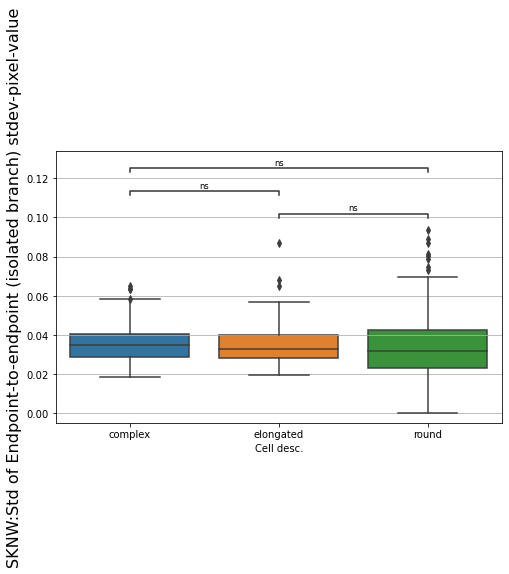

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.824e-08 stat=5.770e+00
complex v.s. elongated: t-test independent samples, P_val=1.692e-02 stat=-2.406e+00
complex v.s. round: t-test independent samples, P_val=8.136e-05 stat=3.986e+00


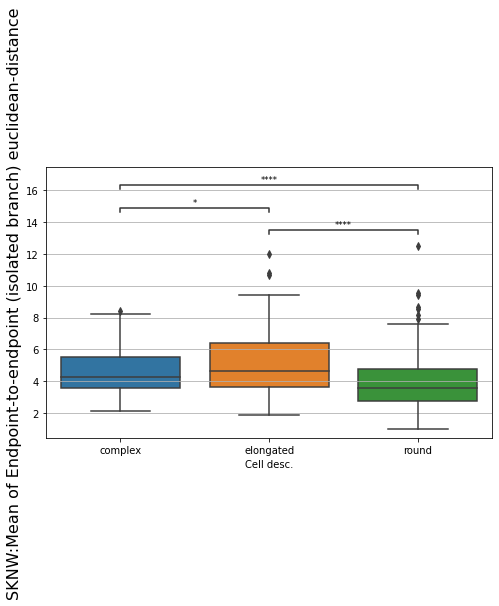

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.808e-19 stat=9.617e+00
complex v.s. elongated: t-test independent samples, P_val=3.725e-03 stat=-2.930e+00
complex v.s. round: t-test independent samples, P_val=6.366e-14 stat=7.810e+00


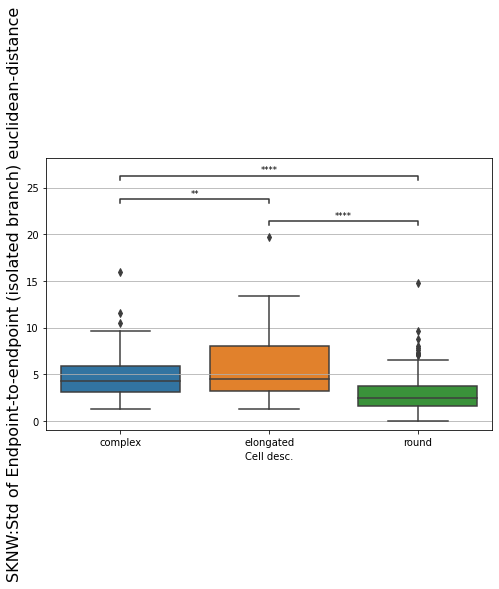

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.058e-30 stat=1.271e+01
complex v.s. elongated: t-test independent samples, P_val=1.736e-08 stat=5.844e+00
complex v.s. round: t-test independent samples, P_val=3.051e-53 stat=1.828e+01


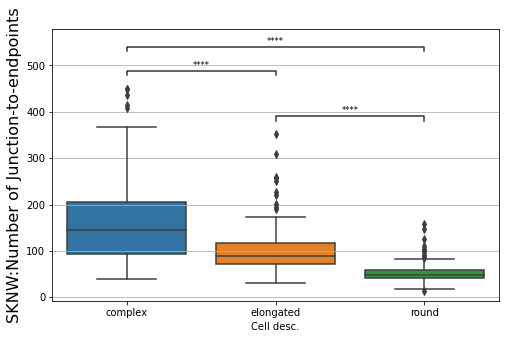

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=9.050e-02 stat=1.698e+00
complex v.s. elongated: t-test independent samples, P_val=3.444e-02 stat=-2.128e+00
complex v.s. round: t-test independent samples, P_val=6.279e-01 stat=-4.851e-01


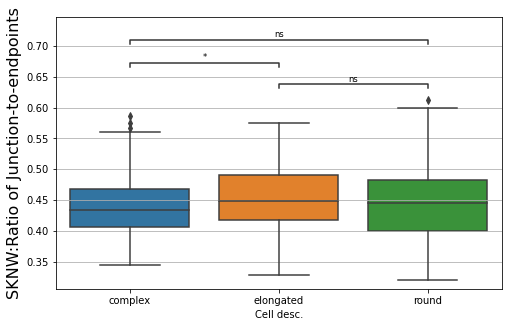

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.270e-27 stat=1.195e+01
complex v.s. elongated: t-test independent samples, P_val=5.292e-07 stat=-5.162e+00
complex v.s. round: t-test independent samples, P_val=1.561e-12 stat=7.328e+00


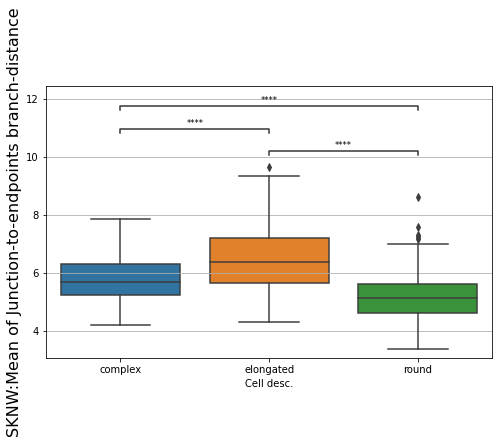

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=8.067e-33 stat=1.335e+01
complex v.s. elongated: t-test independent samples, P_val=1.837e-10 stat=-6.674e+00
complex v.s. round: t-test independent samples, P_val=7.659e-15 stat=8.118e+00


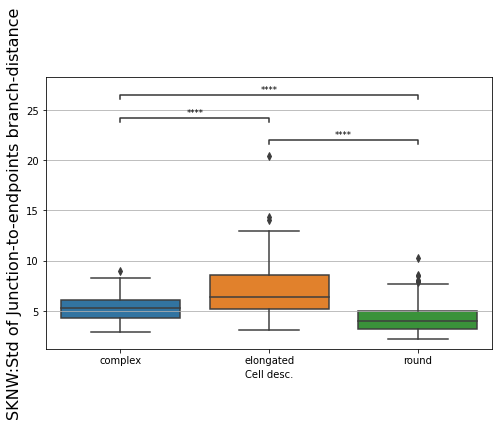

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.812e-02 stat=-2.375e+00
complex v.s. elongated: t-test independent samples, P_val=8.654e-01 stat=1.697e-01
complex v.s. round: t-test independent samples, P_val=1.873e-02 stat=-2.362e+00


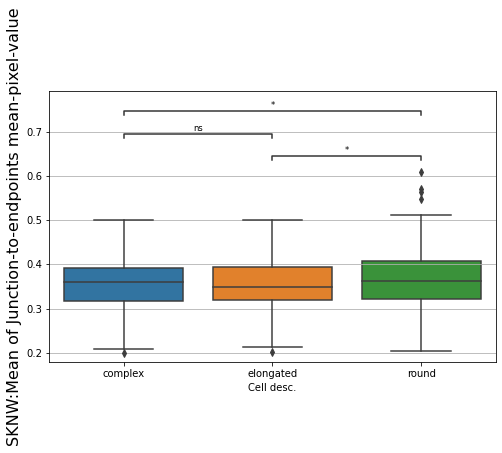

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=8.344e-05 stat=-3.984e+00
complex v.s. elongated: t-test independent samples, P_val=2.313e-01 stat=1.200e+00
complex v.s. round: t-test independent samples, P_val=6.026e-03 stat=-2.763e+00


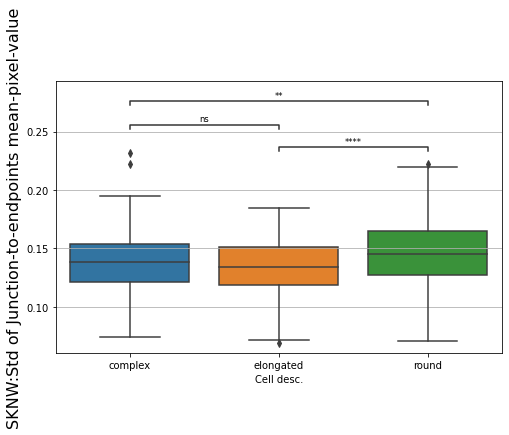

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=6.931e-18 stat=-9.130e+00
complex v.s. elongated: t-test independent samples, P_val=2.877e-01 stat=-1.066e+00
complex v.s. round: t-test independent samples, P_val=2.491e-25 stat=-1.124e+01


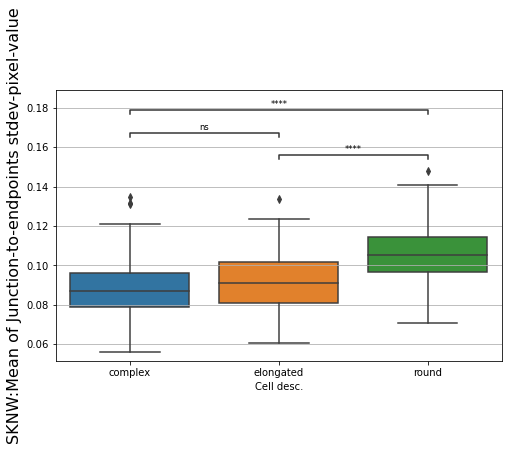

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=8.067e-16 stat=-8.471e+00
complex v.s. elongated: t-test independent samples, P_val=2.860e-01 stat=-1.069e+00
complex v.s. round: t-test independent samples, P_val=2.321e-21 stat=-1.012e+01


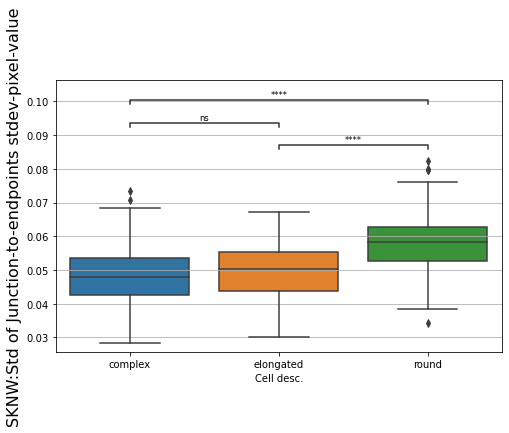

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.528e-29 stat=1.242e+01
complex v.s. elongated: t-test independent samples, P_val=2.198e-07 stat=-5.343e+00
complex v.s. round: t-test independent samples, P_val=1.810e-13 stat=7.655e+00


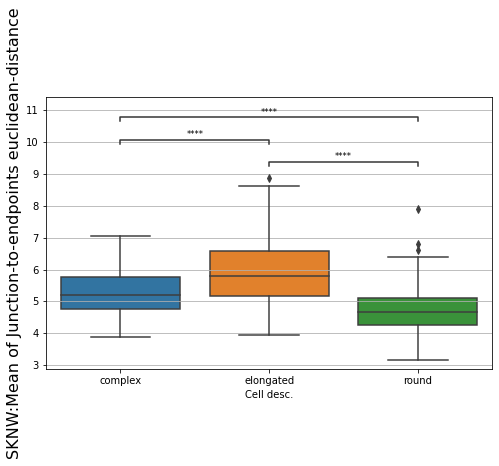

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.454e-34 stat=1.381e+01
complex v.s. elongated: t-test independent samples, P_val=5.903e-11 stat=-6.871e+00
complex v.s. round: t-test independent samples, P_val=1.385e-16 stat=8.682e+00


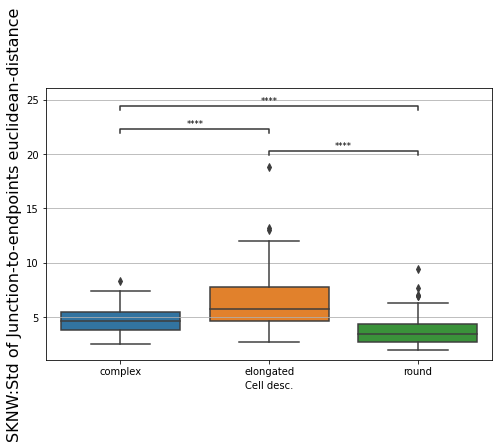

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.763e-14 stat=8.027e+00
complex v.s. elongated: t-test independent samples, P_val=3.743e-08 stat=5.695e+00
complex v.s. round: t-test independent samples, P_val=1.668e-37 stat=1.442e+01


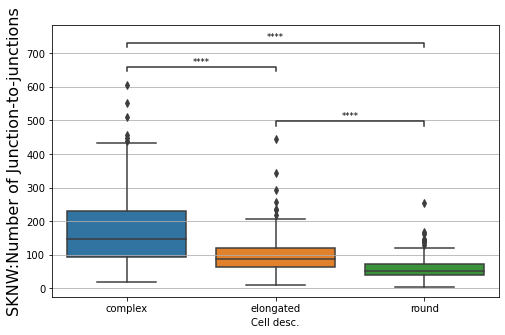

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=3.156e-09 stat=-6.089e+00
complex v.s. elongated: t-test independent samples, P_val=6.603e-02 stat=1.847e+00
complex v.s. round: t-test independent samples, P_val=4.423e-04 stat=-3.546e+00


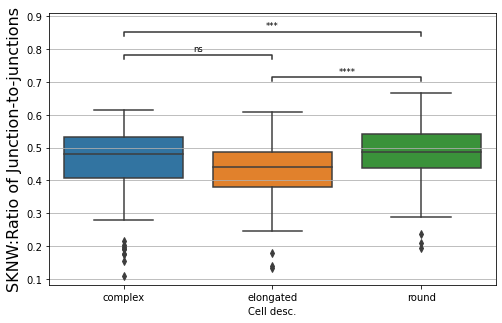

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=8.458e-29 stat=1.227e+01
complex v.s. elongated: t-test independent samples, P_val=4.738e-11 stat=-6.909e+00
complex v.s. round: t-test independent samples, P_val=1.873e-07 stat=5.315e+00


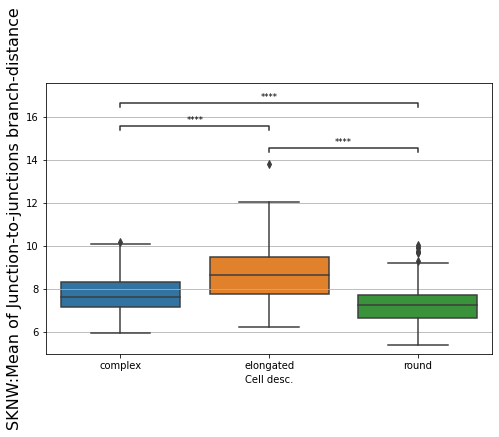

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=7.116e-25 stat=1.119e+01
complex v.s. elongated: t-test independent samples, P_val=2.376e-10 stat=-6.629e+00
complex v.s. round: t-test independent samples, P_val=5.360e-06 stat=4.620e+00


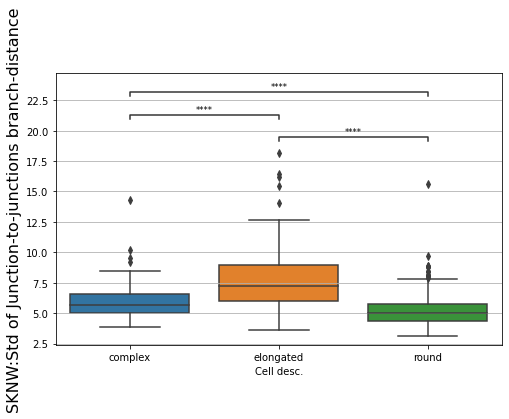

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.288e-06 stat=-4.811e+00
complex v.s. elongated: t-test independent samples, P_val=7.750e-01 stat=2.861e-01
complex v.s. round: t-test independent samples, P_val=2.868e-06 stat=-4.756e+00


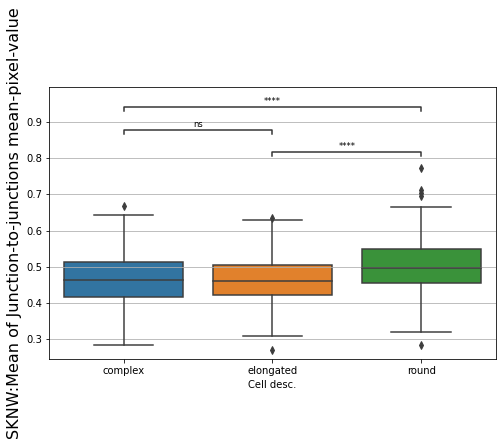

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=8.090e-08 stat=-5.488e+00
complex v.s. elongated: t-test independent samples, P_val=5.951e-03 stat=2.776e+00
complex v.s. round: t-test independent samples, P_val=2.369e-03 stat=-3.061e+00


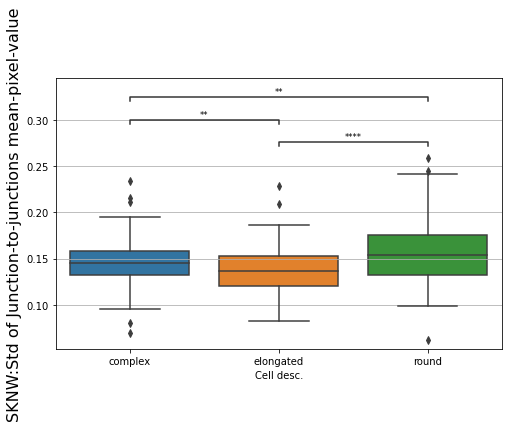

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=8.477e-19 stat=-9.412e+00
complex v.s. elongated: t-test independent samples, P_val=7.800e-01 stat=2.797e-01
complex v.s. round: t-test independent samples, P_val=5.198e-19 stat=-9.431e+00


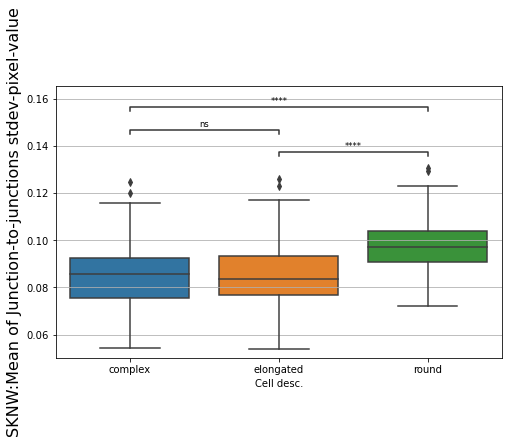

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.807e-09 stat=-6.109e+00
complex v.s. elongated: t-test independent samples, P_val=9.922e-01 stat=-9.728e-03
complex v.s. round: t-test independent samples, P_val=8.214e-11 stat=-6.697e+00


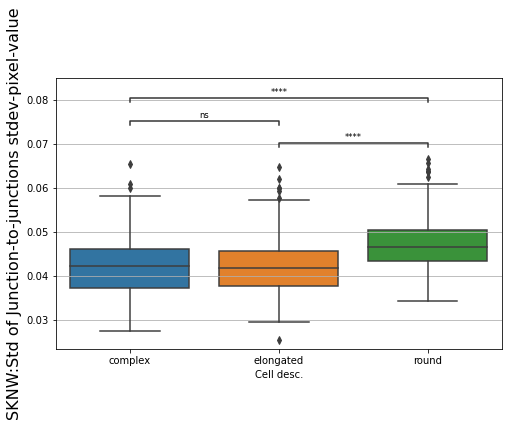

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.030e-30 stat=1.279e+01
complex v.s. elongated: t-test independent samples, P_val=3.573e-11 stat=-6.957e+00
complex v.s. round: t-test independent samples, P_val=1.678e-08 stat=5.774e+00


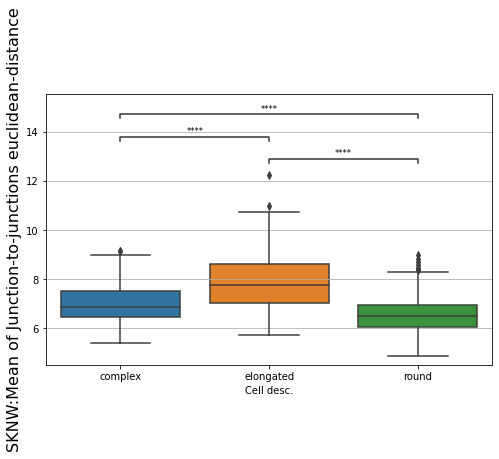

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.476e-29 stat=1.248e+01
complex v.s. elongated: t-test independent samples, P_val=8.141e-11 stat=-6.816e+00
complex v.s. round: t-test independent samples, P_val=1.367e-08 stat=5.812e+00


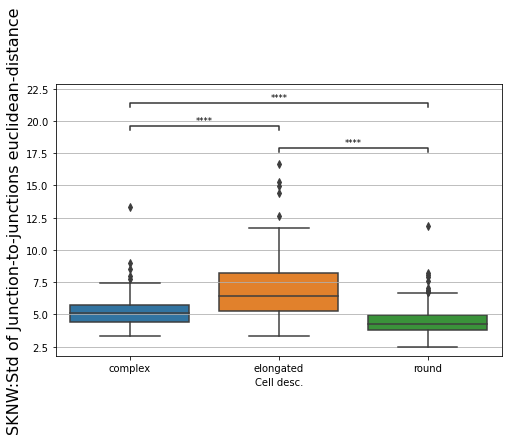

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=4.614e-02 stat=2.002e+00
complex v.s. elongated: t-test independent samples, P_val=1.407e-01 stat=1.478e+00
complex v.s. round: t-test independent samples, P_val=2.573e-05 stat=4.264e+00


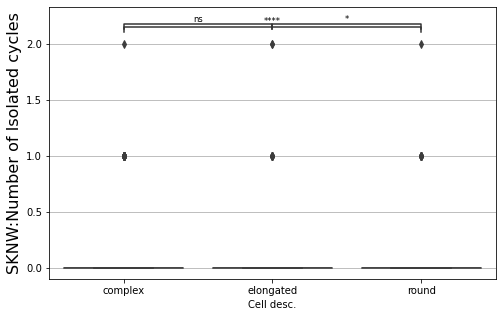

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=8.772e-01 stat=1.547e-01
complex v.s. elongated: t-test independent samples, P_val=9.211e-01 stat=-9.913e-02
complex v.s. round: t-test independent samples, P_val=9.276e-01 stat=9.099e-02


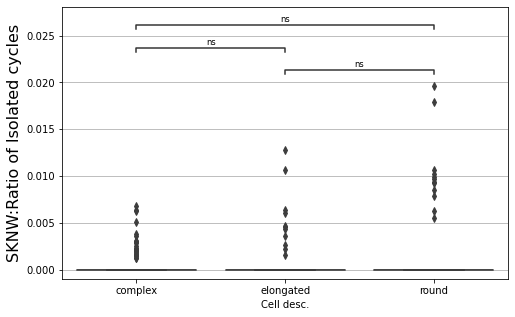

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=3.646e-01 stat=9.079e-01
complex v.s. elongated: t-test independent samples, P_val=4.843e-01 stat=7.005e-01
complex v.s. round: t-test independent samples, P_val=4.142e-02 stat=2.047e+00


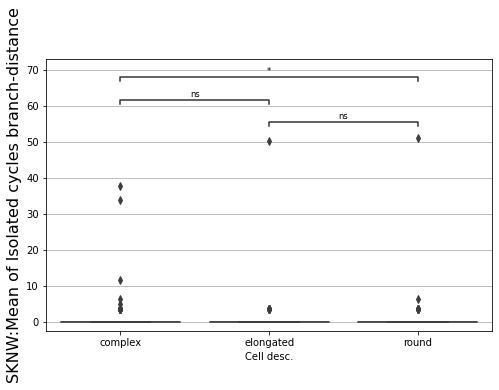

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=nan stat=nan
complex v.s. elongated: t-test independent samples, P_val=3.769e-01 stat=8.854e-01
complex v.s. round: t-test independent samples, P_val=1.829e-01 stat=1.334e+00


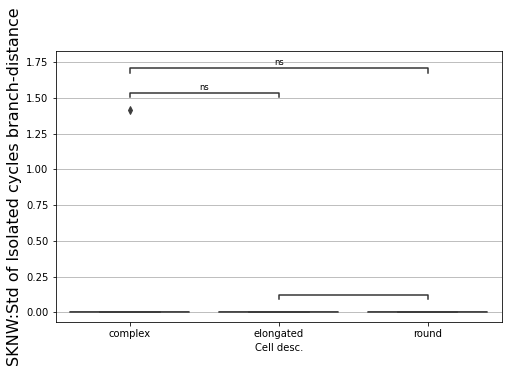

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=8.249e-02 stat=1.742e+00
complex v.s. elongated: t-test independent samples, P_val=6.412e-02 stat=1.860e+00
complex v.s. round: t-test independent samples, P_val=2.565e-05 stat=4.264e+00


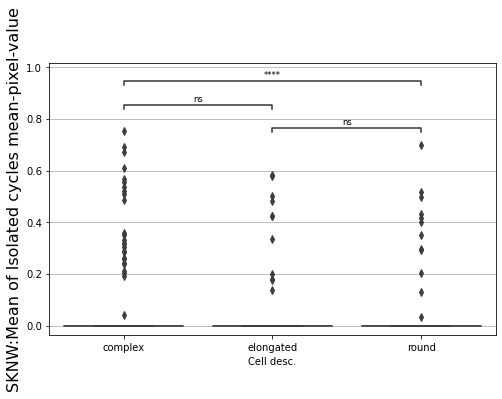

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=3.865e-01 stat=8.672e-01
complex v.s. elongated: t-test independent samples, P_val=9.752e-01 stat=-3.117e-02
complex v.s. round: t-test independent samples, P_val=4.851e-01 stat=6.988e-01


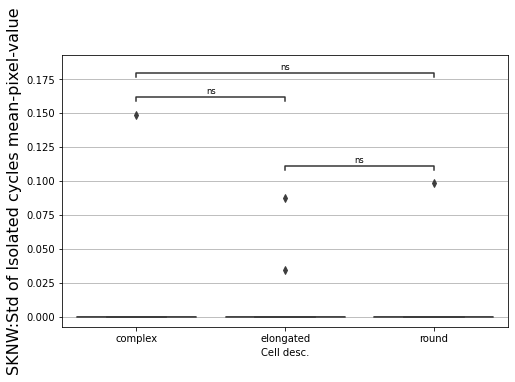

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=4.080e-01 stat=8.284e-01
complex v.s. elongated: t-test independent samples, P_val=1.401e-01 stat=1.481e+00
complex v.s. round: t-test independent samples, P_val=5.200e-03 stat=2.812e+00


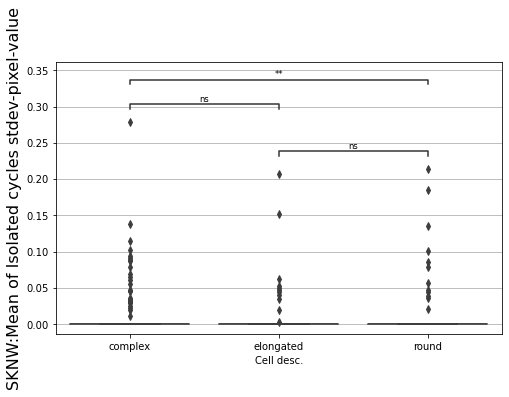

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=9.879e-01 stat=1.521e-02
complex v.s. elongated: t-test independent samples, P_val=9.566e-01 stat=5.447e-02
complex v.s. round: t-test independent samples, P_val=9.489e-01 stat=6.417e-02


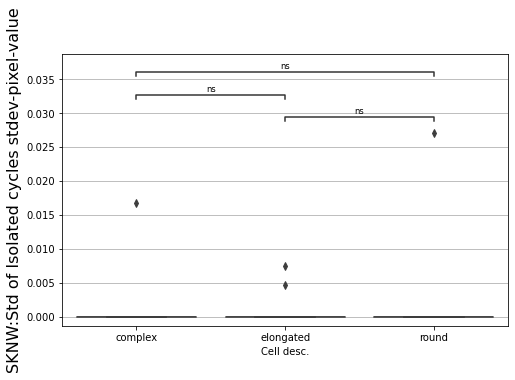

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=nan stat=nan
complex v.s. elongated: t-test independent samples, P_val=nan stat=nan
complex v.s. round: t-test independent samples, P_val=nan stat=nan


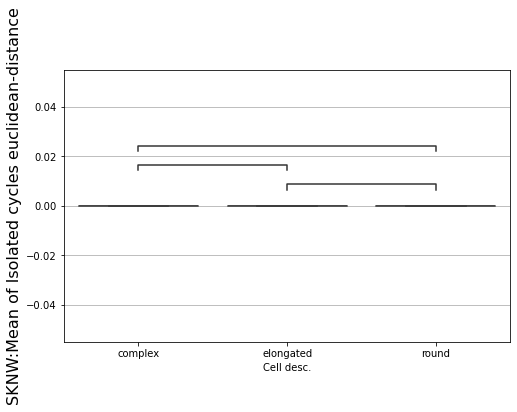

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=nan stat=nan
complex v.s. elongated: t-test independent samples, P_val=nan stat=nan
complex v.s. round: t-test independent samples, P_val=nan stat=nan


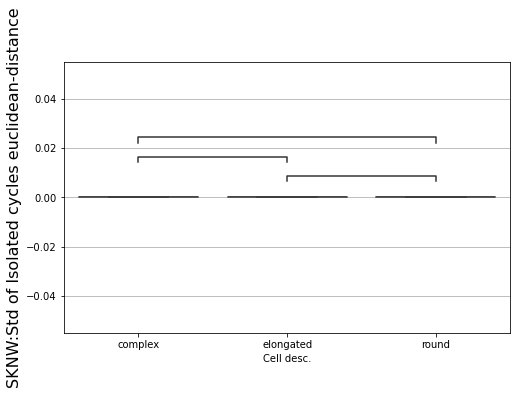

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=9.997e-01 stat=3.751e-04
complex v.s. elongated: t-test independent samples, P_val=2.636e-18 stat=9.513e+00
complex v.s. round: t-test independent samples, P_val=2.026e-33 stat=1.338e+01


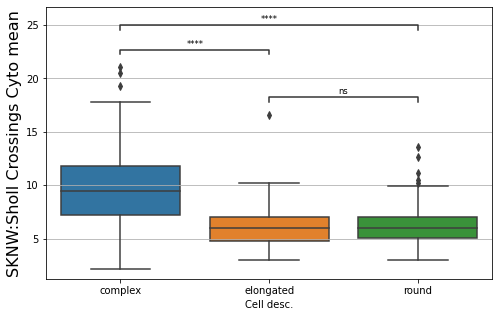

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=8.408e-15 stat=8.135e+00
complex v.s. elongated: t-test independent samples, P_val=1.874e-06 stat=4.892e+00
complex v.s. round: t-test independent samples, P_val=1.466e-36 stat=1.418e+01


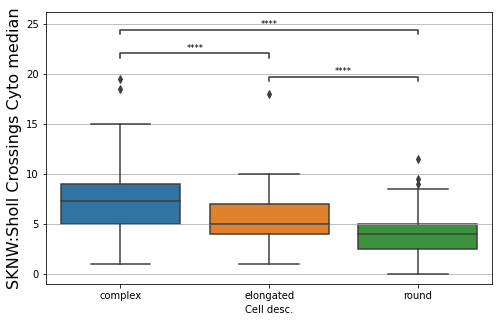

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=nan stat=nan
complex v.s. elongated: t-test independent samples, P_val=nan stat=nan
complex v.s. round: t-test independent samples, P_val=nan stat=nan


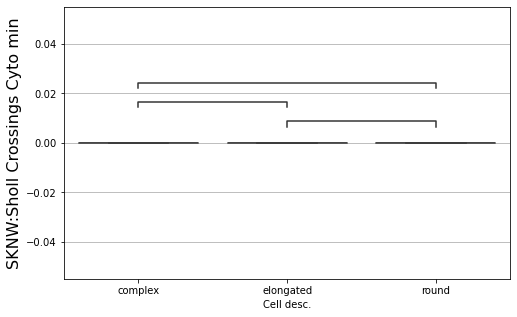

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.364e-05 stat=-4.288e+00
complex v.s. elongated: t-test independent samples, P_val=3.448e-21 stat=1.046e+01
complex v.s. round: t-test independent samples, P_val=1.181e-22 stat=1.050e+01


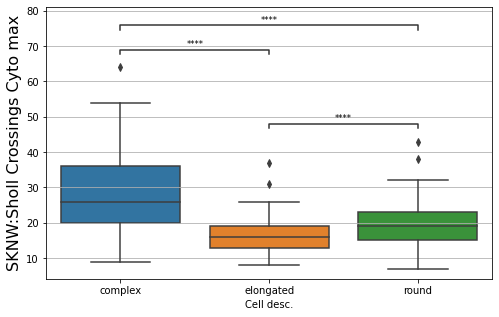

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=7.381e-08 stat=-5.506e+00
complex v.s. elongated: t-test independent samples, P_val=3.670e-20 stat=1.012e+01
complex v.s. round: t-test independent samples, P_val=1.724e-16 stat=8.652e+00


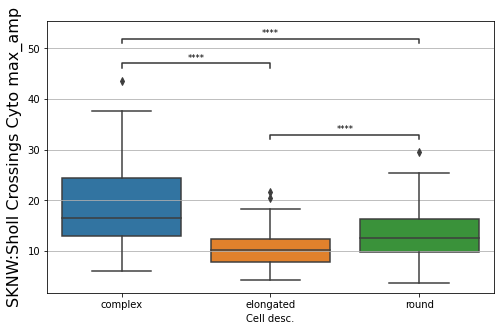

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=6.029e-18 stat=-9.149e+00
complex v.s. elongated: t-test independent samples, P_val=2.202e-17 stat=9.203e+00
complex v.s. round: t-test independent samples, P_val=2.122e-14 stat=7.971e+00


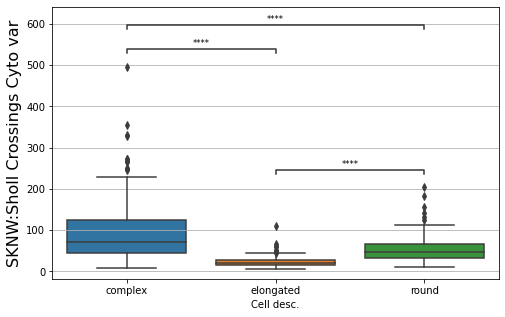

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.265e-23 stat=-1.084e+01
complex v.s. elongated: t-test independent samples, P_val=1.370e-26 stat=1.216e+01
complex v.s. round: t-test independent samples, P_val=9.359e-15 stat=8.089e+00


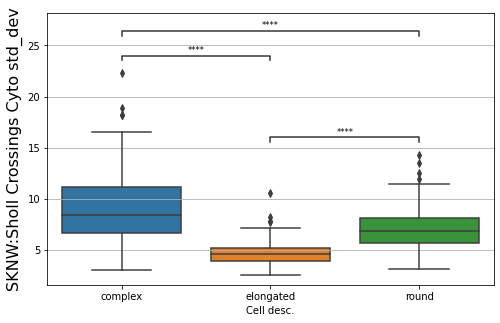

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=3.455e-22 stat=-1.042e+01
complex v.s. elongated: t-test independent samples, P_val=3.219e-27 stat=1.235e+01
complex v.s. round: t-test independent samples, P_val=4.127e-17 stat=8.848e+00


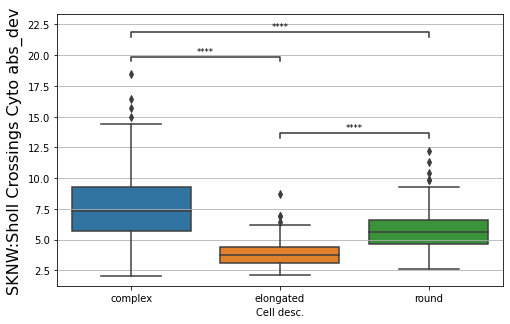

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.559e-01 stat=1.138e+00
complex v.s. elongated: t-test independent samples, P_val=1.010e-03 stat=-3.330e+00
complex v.s. round: t-test independent samples, P_val=6.617e-02 stat=-1.843e+00


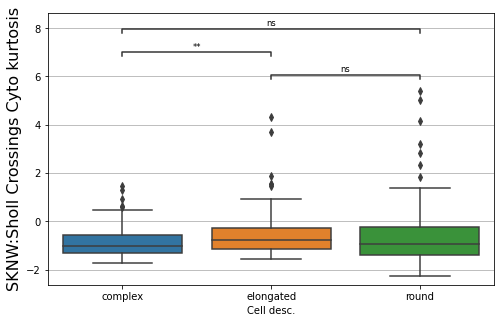

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=1.606e-14 stat=-8.040e+00
complex v.s. elongated: t-test independent samples, P_val=1.787e-03 stat=3.160e+00
complex v.s. round: t-test independent samples, P_val=2.618e-08 stat=-5.692e+00


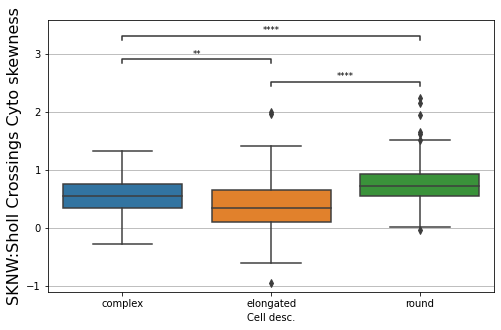

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=8.415e-01 stat=-2.001e-01
complex v.s. elongated: t-test independent samples, P_val=4.298e-18 stat=9.442e+00
complex v.s. round: t-test independent samples, P_val=4.095e-32 stat=1.305e+01


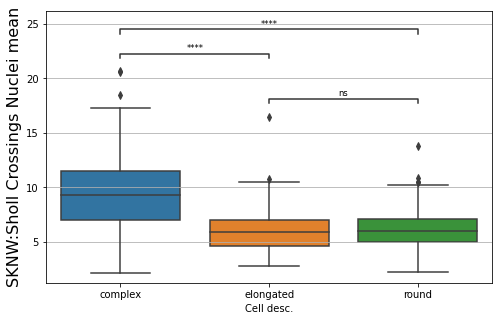

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=4.138e-02 stat=2.048e+00
complex v.s. elongated: t-test independent samples, P_val=1.947e-08 stat=5.822e+00
complex v.s. round: t-test independent samples, P_val=1.216e-19 stat=9.620e+00


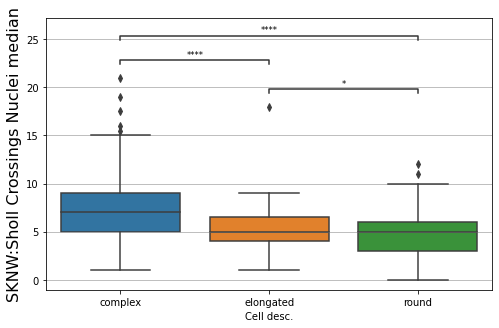

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=nan stat=nan
complex v.s. elongated: t-test independent samples, P_val=nan stat=nan
complex v.s. round: t-test independent samples, P_val=nan stat=nan


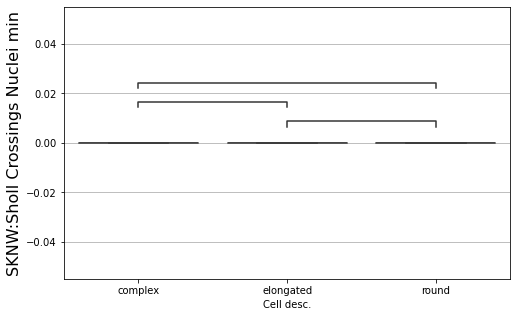

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=6.315e-01 stat=-4.801e-01
complex v.s. elongated: t-test independent samples, P_val=2.054e-17 stat=9.213e+00
complex v.s. round: t-test independent samples, P_val=5.708e-30 stat=1.249e+01


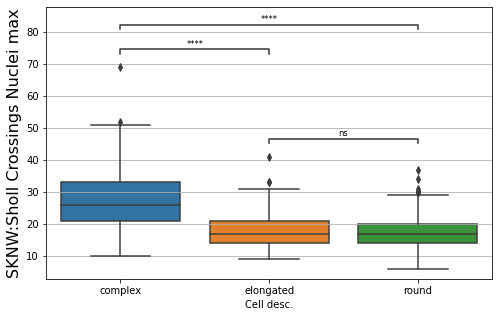

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=5.921e-01 stat=-5.364e-01
complex v.s. elongated: t-test independent samples, P_val=1.146e-14 stat=8.260e+00
complex v.s. round: t-test independent samples, P_val=8.342e-25 stat=1.110e+01


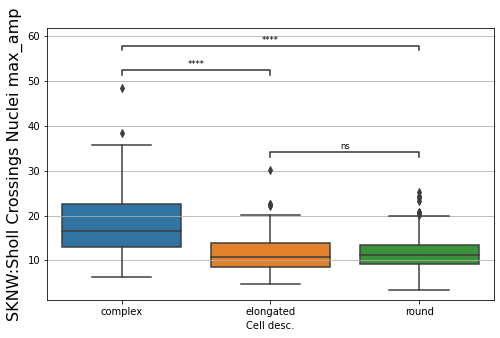

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=7.284e-11 stat=-6.735e+00
complex v.s. elongated: t-test independent samples, P_val=2.026e-16 stat=8.874e+00
complex v.s. round: t-test independent samples, P_val=2.820e-17 stat=8.899e+00


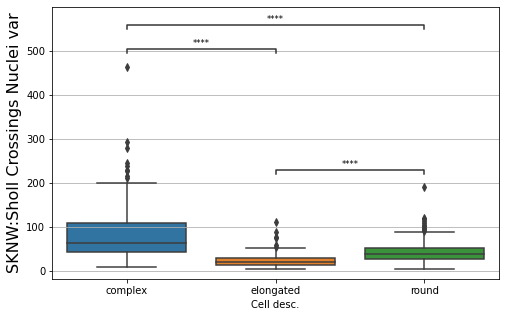

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.080e-14 stat=-8.002e+00
complex v.s. elongated: t-test independent samples, P_val=4.862e-24 stat=1.136e+01
complex v.s. round: t-test independent samples, P_val=1.104e-18 stat=9.332e+00


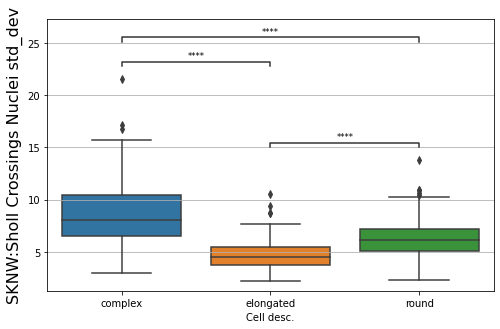

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=7.212e-17 stat=-8.809e+00
complex v.s. elongated: t-test independent samples, P_val=5.957e-25 stat=1.165e+01
complex v.s. round: t-test independent samples, P_val=6.165e-18 stat=9.104e+00


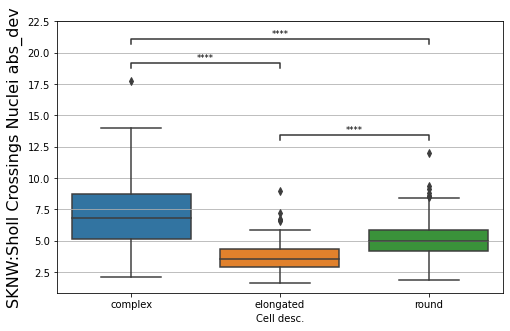

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.012e-07 stat=5.310e+00
complex v.s. elongated: t-test independent samples, P_val=8.438e-06 stat=-4.557e+00
complex v.s. round: t-test independent samples, P_val=4.484e-01 stat=7.590e-01


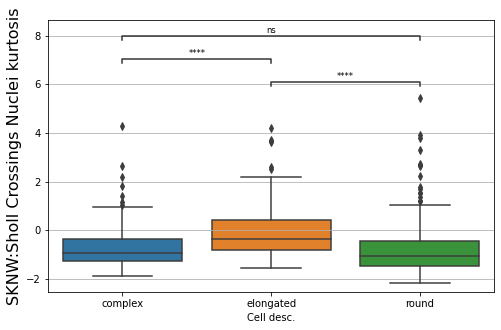

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=3.880e-01 stat=8.644e-01
complex v.s. elongated: t-test independent samples, P_val=2.788e-01 stat=-1.086e+00
complex v.s. round: t-test independent samples, P_val=6.185e-01 stat=-4.984e-01


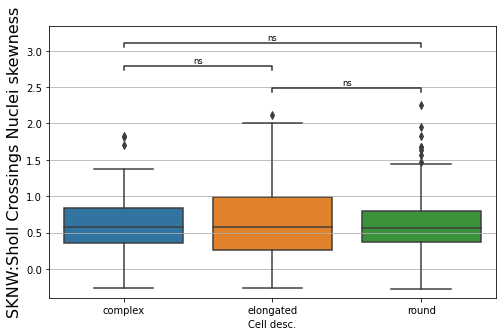

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.711e-19 stat=9.564e+00
complex v.s. elongated: t-test independent samples, P_val=2.700e-02 stat=-2.226e+00
complex v.s. round: t-test independent samples, P_val=7.341e-17 stat=8.769e+00


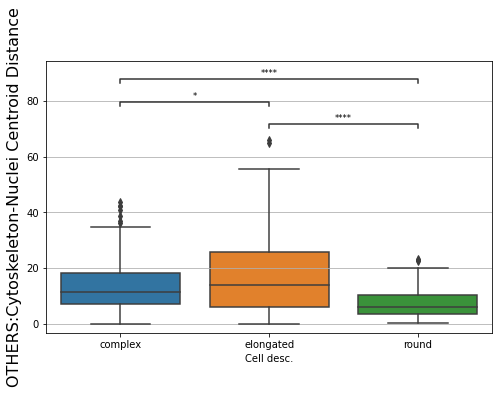

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=2.496e-20 stat=9.876e+00
complex v.s. elongated: t-test independent samples, P_val=2.649e-03 stat=-3.039e+00
complex v.s. round: t-test independent samples, P_val=6.193e-17 stat=8.792e+00


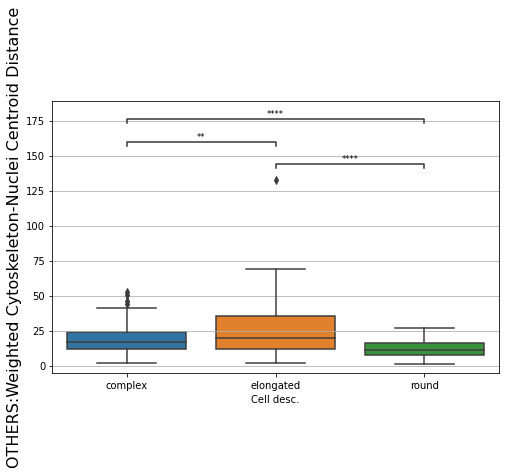

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=3.537e-04 stat=-3.610e+00
complex v.s. elongated: t-test independent samples, P_val=4.195e-01 stat=-8.087e-01
complex v.s. round: t-test independent samples, P_val=4.178e-07 stat=-5.156e+00


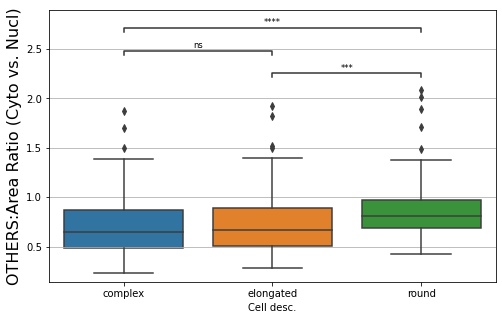

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated v.s. round: t-test independent samples, P_val=6.866e-50 stat=1.772e+01
complex v.s. elongated: t-test independent samples, P_val=6.011e-04 stat=3.479e+00
complex v.s. round: t-test independent samples, P_val=4.383e-60 stat=1.994e+01


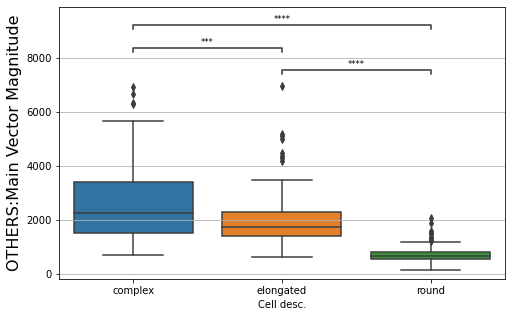

In [8]:
import statannot
labels = np.unique(ResultsDF['Cell desc.'])
colors  = ["#3498DB","#E74C3C","#95A5A6","#ABE6FF","#CA6F1E","#2ECC71"]

global LSF,DCF,DNF,FULL
LSF,DCF,DNF,SKNW,OTHERS,FULL = create_separate_DFs(ResultsDF)
df = FULL
data = pd.concat([ResultsDF[ResultsDF.columns[:7]] , FULL , ResultsDF[ResultsDF.columns[-1]]],axis=1)
COUNT = 0
for ft in [x for x in FULL.columns if x.startswith("LSF2D") or x.startswith("LSF1D") or x.startswith("DCF") or x.startswith("DNF") or x.startswith("SKNW") or x.startswith("OTHERS")]:
#     global box
#     box = []
#     for label in labels:
#         dat = df.loc[ResultsDF[ResultsDF['Cell desc.' ] == label].index]
#         box = box + [list(dat[ft].astype(np.float))]
        
    fig, ax = plt.subplots(figsize=(8, 5))
    sns.boxplot(x="Cell desc.", y=ft,  order =np.unique(data['Cell desc.']),data=data,ax=ax)
    statannot.add_stat_annotation(ax,data=data,x="Cell desc.",y=ft,box_pairs=[(('round','complex')),(('round','elongated')),(('complex','elongated'))],test='t-test_ind',text_format="star",loc="inside",fontsize='small',order =np.unique(data['Cell desc.']),comparisons_correction=None)
    plt.ylabel(ft,fontsize=16)
    ax.yaxis.grid(True)
    if SAVE:
        plt.savefig(".//CellVSCellAnalysis3Cat//boxplots//" + str(ft.split(':')[0]) + "-"  + str(ft.split(':')[1]) + ".png",format='png',transparent=True,bbox_inches='tight',dpi=200)
    plt.show()
    
    COUNT = COUNT + 1
    

## <font color='red'>7.5.2 - Boxplots 4 Categories</font>

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=5.453e-02 stat=-1.978e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.855e-01 stat=-1.449e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=7.358e-01 stat=-3.414e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.599e-02 stat=-2.063e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=6.283e-01 stat=-4.878e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.471e-02 stat=-2.519e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.206e-01 stat=6.509

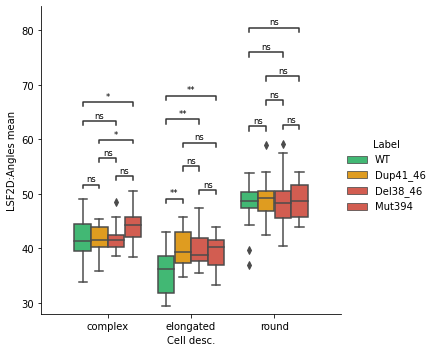

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=9.892e-02 stat=-1.687e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.198e-01 stat=2.294e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=6.442e-01 stat=-4.677e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.976e-02 stat=-1.941e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=8.443e-01 stat=-1.976e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=5.958e-02 stat=-1.924e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=6.236e-01 stat=4.964e

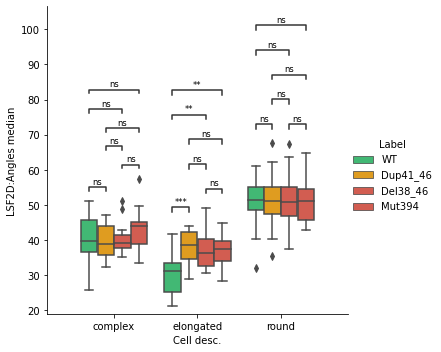

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=6.842e-01 stat=4.096e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.246e-01 stat=2.232e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=3.313e-01 stat=-9.917e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.029e-01 stat=-6.764e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=4.227e-01 stat=-8.099e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.012e-01 stat=-5.257e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.314e-01 stat=1.224e+

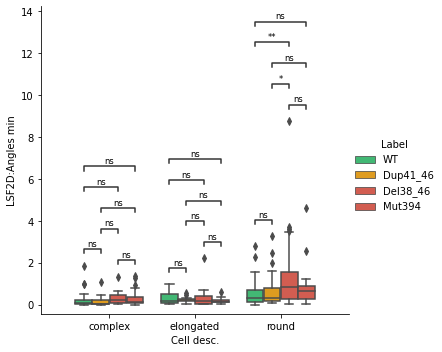

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=9.911e-01 stat=-1.121e-02
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=1.567e-01 stat=-1.446e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.916e-01 stat=1.344e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.094e-01 stat=1.030e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=4.050e-01 stat=-8.414e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.027e-01 stat=-1.040e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.674e-01 stat=-1.419e

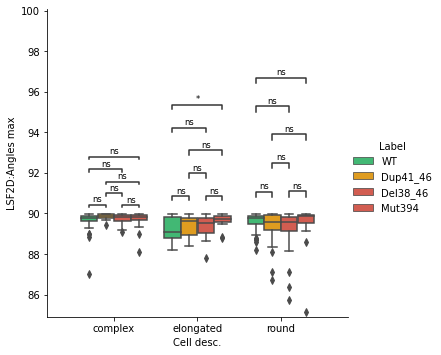

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=9.969e-02 stat=1.684e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.183e-01 stat=6.523e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.170e-01 stat=1.054e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.639e-01 stat=1.420e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.623e-01 stat=9.213e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=9.320e-03 stat=2.695e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.968e-01 stat=-5.354e-01


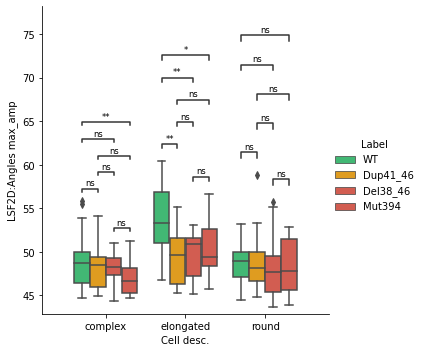

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.611e-01 stat=-1.139e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.894e-01 stat=-8.709e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=8.107e-01 stat=2.422e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.591e-01 stat=-7.480e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.070e-01 stat=-6.693e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.588e-02 stat=-2.151e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=8.912e-01 stat=-1.381

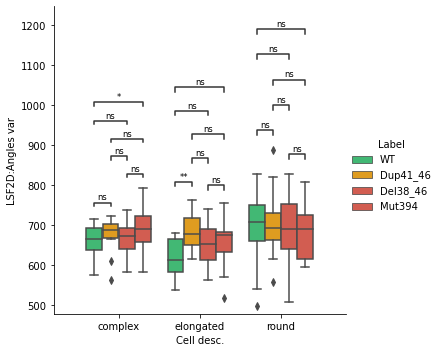

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.706e-01 stat=-1.117e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.064e-01 stat=-8.399e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=8.213e-01 stat=2.283e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.668e-01 stat=-7.351e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.144e-01 stat=-6.577e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.924e-02 stat=-2.112e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=9.043e-01 stat=-1.213

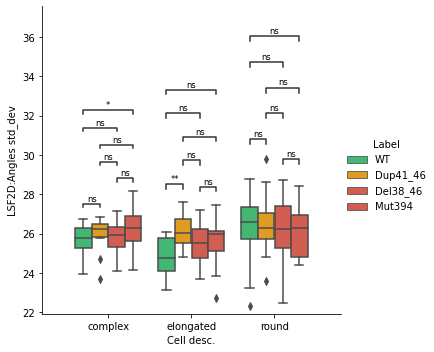

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.951e-01 stat=-1.060e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.888e-01 stat=-6.992e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=8.941e-01 stat=-1.346e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.079e-01 stat=-1.034e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.096e-01 stat=-1.029e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.674e-02 stat=-2.468e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.660e-01 stat=-3.00

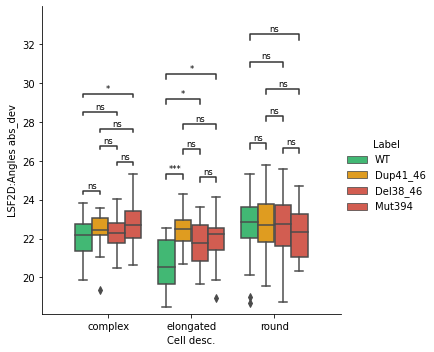

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.255e-01 stat=1.230e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=6.684e-01 stat=4.319e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=5.574e-01 stat=5.950e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.128e-01 stat=1.623e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.788e-01 stat=1.368e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.456e-03 stat=2.966e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.965e-01 stat=2.605e-01
e

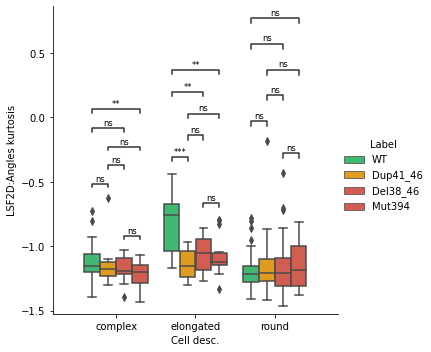

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=3.963e-02 stat=2.124e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=9.144e-01 stat=-1.082e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.279e-01 stat=9.145e-02
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=7.388e-02 stat=1.838e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=9.652e-01 stat=-4.389e-02
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.658e-02 stat=1.872e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.998e-01 stat=-5.309e-0

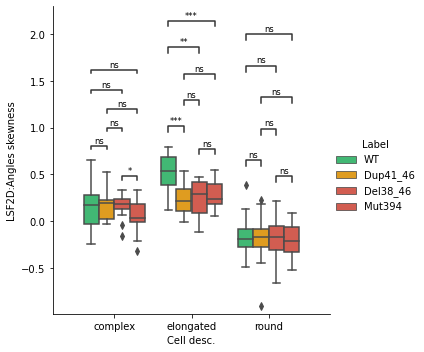

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=9.570e-02 stat=-1.704e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.279e-01 stat=-8.015e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.627e-03 stat=3.550e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.497e-01 stat=1.169e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.252e-02 stat=2.213e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.284e-01 stat=4.867e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.351e-02 stat=-2.401e+0

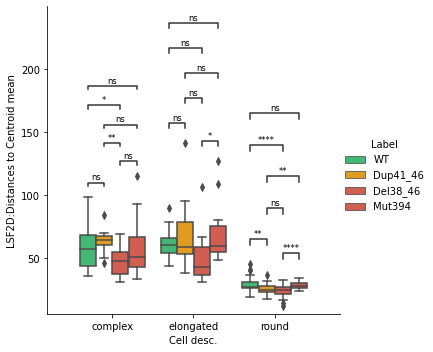

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.683e-01 stat=-1.402e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.577e-01 stat=-5.916e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.325e-03 stat=2.827e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.947e-01 stat=1.063e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=4.960e-02 stat=2.023e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=5.385e-01 stat=6.189e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.122e-03 stat=-2.912e+0

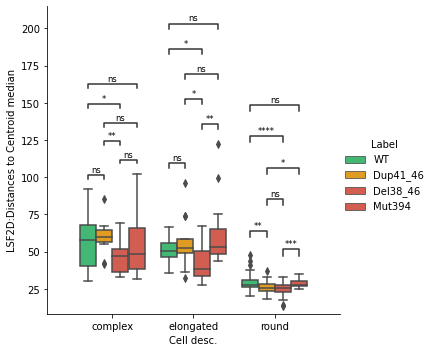

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=3.167e-01 stat=-1.013e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=6.184e-01 stat=5.023e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=7.110e-01 stat=3.750e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.471e-01 stat=-7.682e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.631e-01 stat=9.197e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.597e-01 stat=-9.237e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.147e-01 stat=-1.271e+

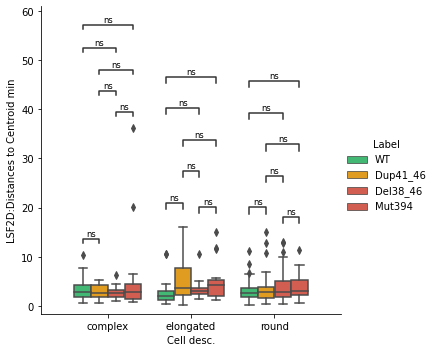

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.515e-01 stat=-1.461e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.898e-01 stat=-8.702e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=4.533e-05 stat=4.966e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=8.427e-02 stat=1.773e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.690e-02 stat=2.295e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.321e-01 stat=9.784e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.364e-01 stat=-1.535e+0

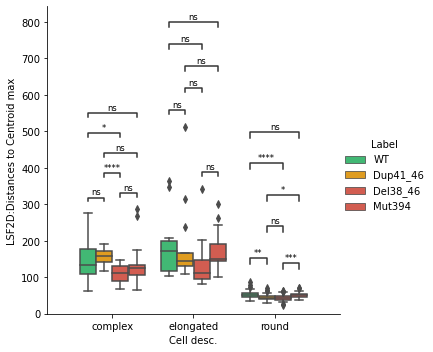

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.053e-01 stat=-1.287e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.199e-01 stat=-8.157e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.562e-05 stat=5.388e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=6.124e-02 stat=1.929e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.587e-02 stat=2.170e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.699e-01 stat=1.115e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=3.096e-01 stat=-1.036e+0

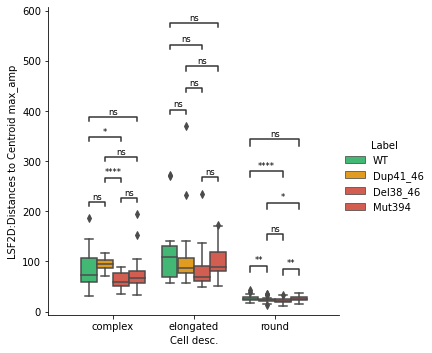

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.351e-01 stat=-1.524e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.932e-01 stat=-5.389e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=4.627e-04 stat=4.051e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.284e-01 stat=9.900e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.192e-02 stat=2.002e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.042e-01 stat=5.214e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.761e-01 stat=-5.659e-0

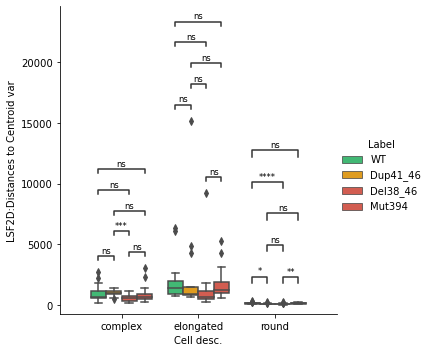

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.100e-01 stat=-1.633e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.431e-01 stat=-9.604e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=5.963e-04 stat=3.951e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.439e-01 stat=1.492e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=4.991e-02 stat=2.020e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=5.923e-01 stat=5.387e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.245e-01 stat=-1.243e+0

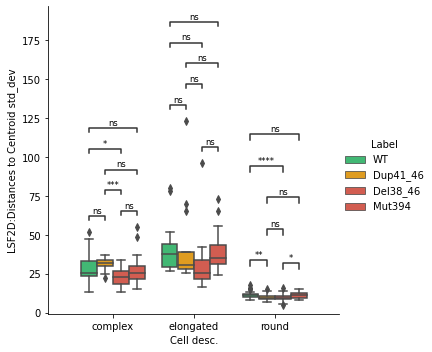

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.149e-01 stat=-1.610e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=2.891e-01 stat=-1.076e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.700e-03 stat=3.532e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.811e-01 stat=1.362e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=6.939e-02 stat=1.865e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=7.528e-01 stat=3.166e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.093e-01 stat=-1.656e+0

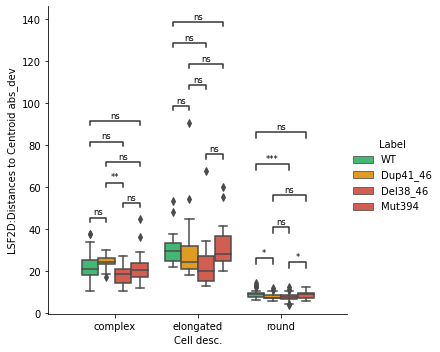

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=8.330e-01 stat=2.121e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.640e-01 stat=1.725e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.200e-01 stat=1.612e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.494e-02 stat=2.074e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.454e-01 stat=1.178e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=9.019e-02 stat=1.725e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.589e-02 stat=2.573e+00
e

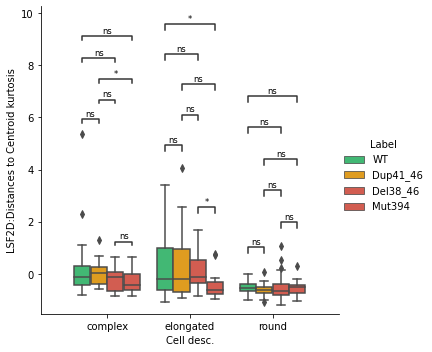

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=6.016e-01 stat=-5.261e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.494e-01 stat=-6.043e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=5.274e-02 stat=2.038e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.127e-01 stat=1.267e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.927e-01 stat=8.638e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=5.977e-01 stat=5.308e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.360e-02 stat=2.399e+00

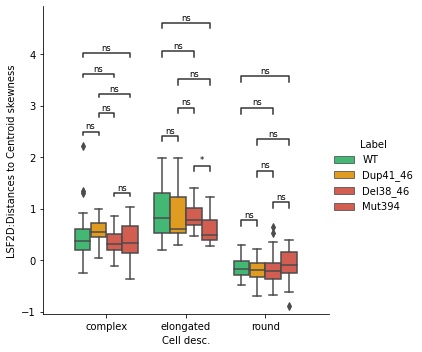

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=8.608e-02 stat=-1.758e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=6.653e-01 stat=-4.361e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.893e-02 stat=2.517e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.944e-01 stat=5.369e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.502e-02 stat=1.975e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=8.786e-01 stat=1.535e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.583e-02 stat=-2.575e+0

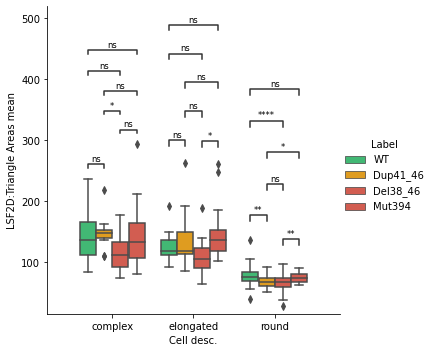

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.072e-02 stat=-2.112e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.921e-01 stat=-6.938e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=5.904e-03 stat=3.021e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=6.630e-01 stat=4.392e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.969e-02 stat=2.125e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=8.170e-01 stat=-2.325e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=6.161e-03 stat=-2.972e+

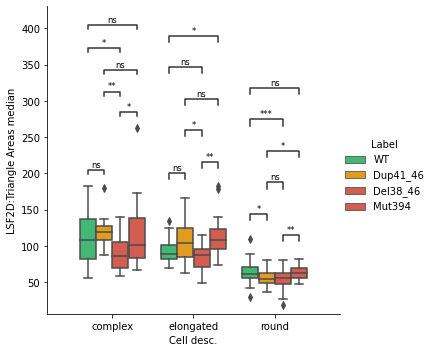

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=9.952e-01 stat=6.050e-03
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.453e-01 stat=-1.965e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.261e-01 stat=-1.242e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.783e-01 stat=-1.100e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=8.220e-02 stat=-1.782e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=8.364e-02 stat=-1.762e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.060e-01 stat=1.296e

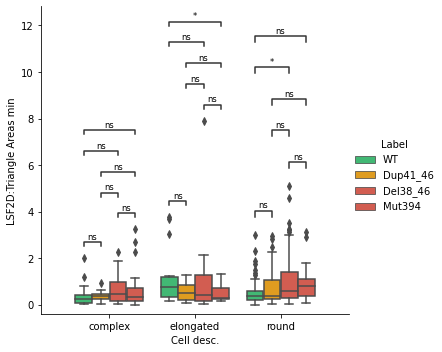

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.062e-01 stat=-1.651e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.156e-01 stat=2.349e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.004e-01 stat=1.709e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=9.170e-01 stat=-1.049e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.534e-02 stat=1.972e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=8.869e-01 stat=1.429e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=4.701e-02 stat=-2.081e+0

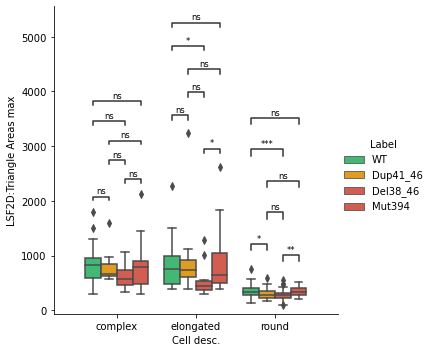

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.208e-01 stat=-1.584e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=7.524e-01 stat=3.178e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.356e-01 stat=1.544e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=8.583e-01 stat=-1.797e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=6.084e-02 stat=1.928e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=8.907e-01 stat=1.381e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.382e-02 stat=-2.016e+0

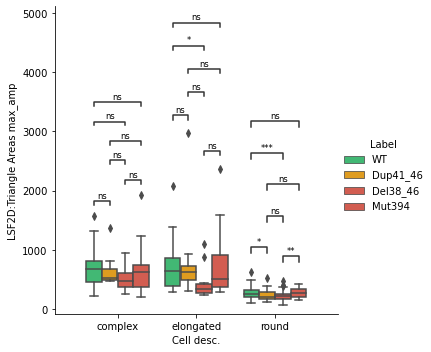

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.339e-01 stat=-1.528e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.359e-01 stat=2.086e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=7.623e-02 stat=1.853e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=8.967e-01 stat=1.307e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=7.745e-02 stat=1.811e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.745e-01 stat=4.223e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.186e-01 stat=-1.612e+00

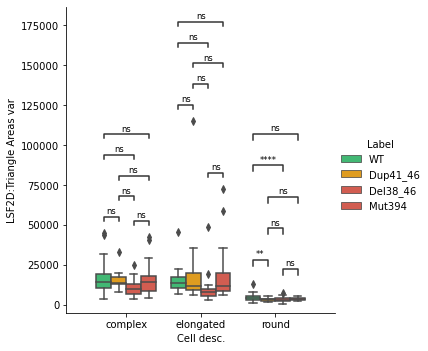

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.338e-01 stat=-1.529e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=9.649e-01 stat=-4.432e-02
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=5.271e-02 stat=2.038e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=6.882e-01 stat=4.044e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=6.941e-02 stat=1.865e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.659e-01 stat=4.342e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=6.276e-02 stat=-1.941e+0

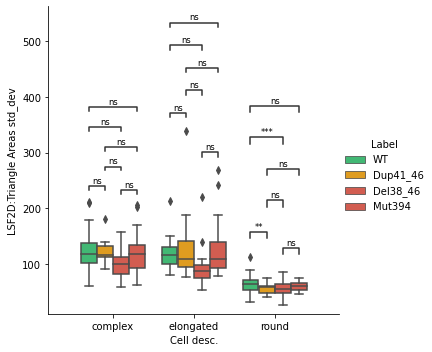

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.291e-01 stat=-1.548e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.106e-01 stat=-2.414e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=3.275e-02 stat=2.266e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.811e-01 stat=7.115e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.618e-02 stat=1.965e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=5.796e-01 stat=5.573e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.139e-02 stat=-2.039e+0

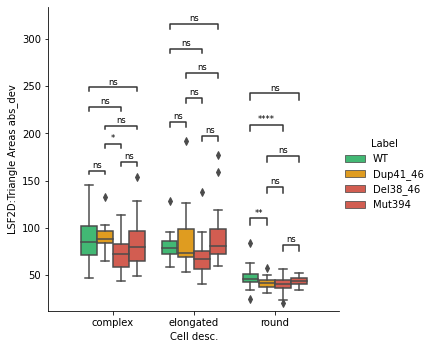

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=9.560e-01 stat=5.553e-02
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.104e-01 stat=1.028e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=4.503e-01 stat=-7.675e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.596e-01 stat=-1.144e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=7.009e-01 stat=-3.868e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.231e-01 stat=-4.943e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.377e-02 stat=-1.860e

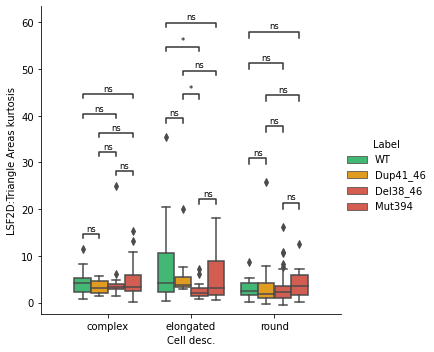

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=8.686e-01 stat=1.665e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.374e-01 stat=9.720e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.949e-01 stat=-1.071e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.988e-01 stat=-1.053e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=6.377e-01 stat=-4.744e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=7.277e-01 stat=-3.500e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.301e-01 stat=-1.561e

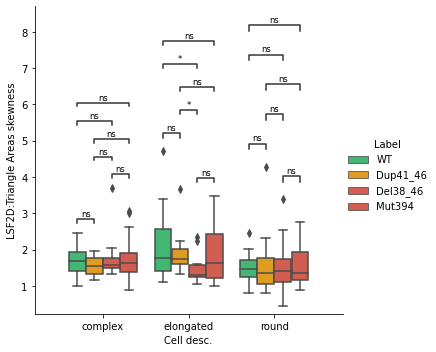

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=7.791e-01 stat=2.824e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.287e-01 stat=9.899e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.217e-01 stat=-9.937e-02
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=8.707e-01 stat=1.638e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.545e-01 stat=9.364e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.416e-01 stat=1.491e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.595e-01 stat=3.093e-01


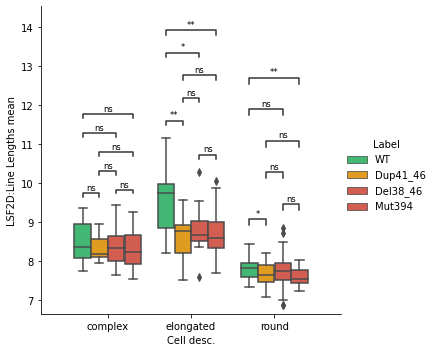

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=9.818e-01 stat=2.298e-02
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.623e-01 stat=7.428e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.636e-01 stat=-4.611e-02
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=9.785e-01 stat=-2.709e-02
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=4.800e-01 stat=7.128e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.578e-01 stat=9.273e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.796e-01 stat=2.826e-01

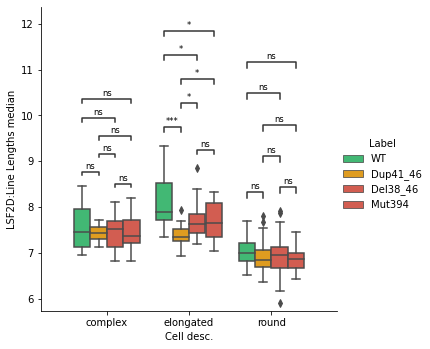

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=5.890e-01 stat=5.445e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.450e-01 stat=6.109e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=6.804e-02 stat=-1.911e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.117e-01 stat=-1.628e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=9.218e-02 stat=-1.724e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.669e-01 stat=-1.401e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=9.273e-01 stat=9.207e-

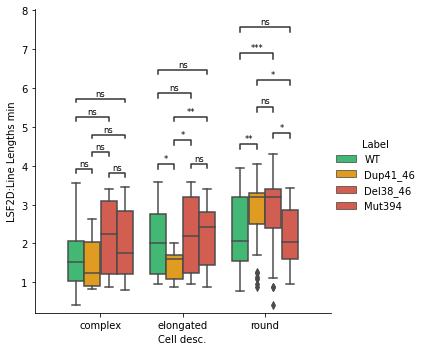

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.695e-01 stat=-1.398e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.722e-01 stat=1.619e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.262e-03 stat=2.830e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.355e-02 stat=1.992e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.596e-03 stat=3.089e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.648e-02 stat=2.474e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.832e-01 stat=2.779e-01


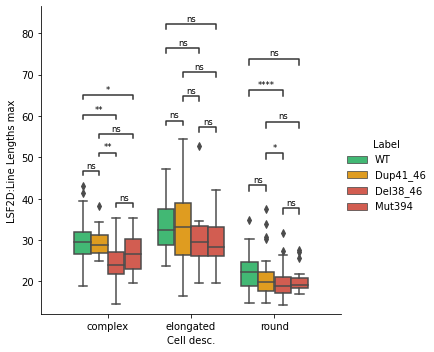

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.374e-01 stat=-1.514e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=9.406e-01 stat=7.496e-02
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=7.180e-03 stat=2.938e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.613e-02 stat=2.062e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.058e-03 stat=3.148e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.752e-02 stat=2.449e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.971e-01 stat=2.596e-01


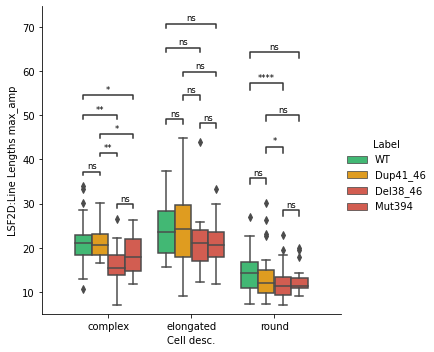

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=9.208e-01 stat=-1.000e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=1.448e-01 stat=1.490e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=4.995e-01 stat=6.856e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.581e-01 stat=5.909e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.614e-02 stat=2.308e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.159e-02 stat=2.612e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.196e-01 stat=6.525e-01


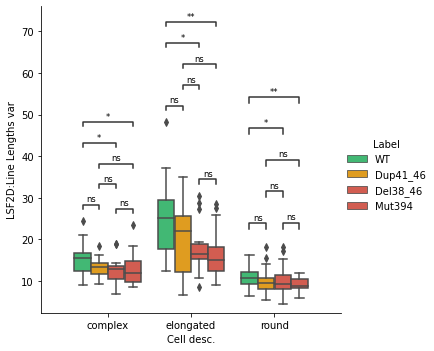

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=9.396e-01 stat=-7.623e-02
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=1.573e-01 stat=1.444e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=4.551e-01 stat=7.592e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.813e-01 stat=7.112e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.348e-02 stat=2.353e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=9.220e-03 stat=2.699e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.055e-01 stat=6.749e-01


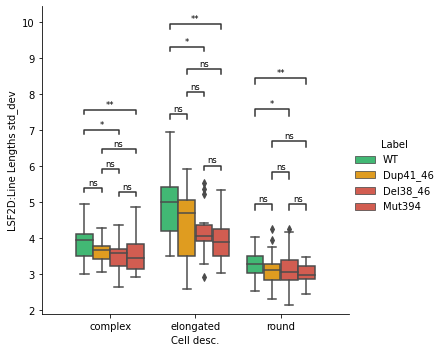

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.150e-01 stat=8.233e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=2.366e-01 stat=1.203e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.352e-01 stat=8.216e-02
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.983e-01 stat=8.543e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.708e-01 stat=1.394e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.056e-02 stat=2.648e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.897e-01 stat=5.457e-01
e

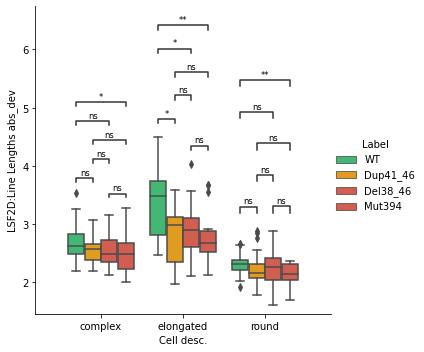

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.050e-01 stat=-1.657e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=9.992e-01 stat=-9.976e-04
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=6.051e-02 stat=1.970e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.313e-01 stat=9.841e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.116e-02 stat=2.009e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.873e-01 stat=1.075e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.043e-01 stat=6.768e-01

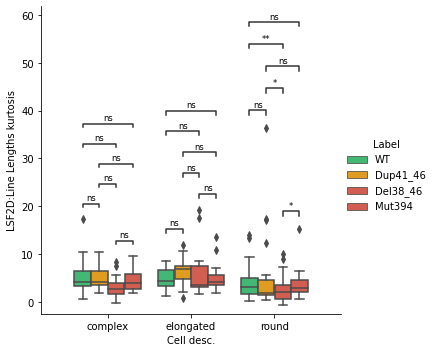

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=6.435e-02 stat=-1.900e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=7.243e-01 stat=3.554e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=7.306e-02 stat=1.875e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=6.447e-01 stat=4.648e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.091e-02 stat=2.402e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.061e-01 stat=1.033e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.646e-01 stat=5.832e-01


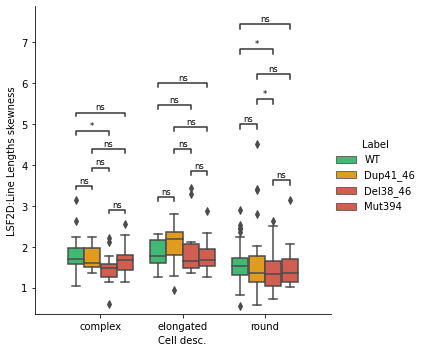

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=7.322e-01 stat=3.444e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.309e-01 stat=2.150e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=6.179e-01 stat=-5.054e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=8.275e-01 stat=-2.194e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=7.860e-01 stat=-2.733e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=9.721e-01 stat=3.511e-02
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=9.140e-01 stat=-1.090e-

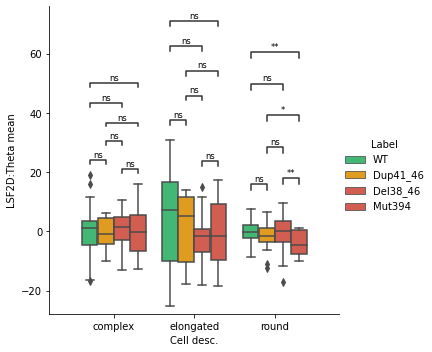

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=7.504e-01 stat=3.202e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=9.931e-01 stat=8.651e-03
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=4.837e-01 stat=-7.113e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=6.395e-01 stat=-4.722e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=4.389e-01 stat=-7.816e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=5.633e-01 stat=-5.815e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=9.199e-01 stat=1.015e-

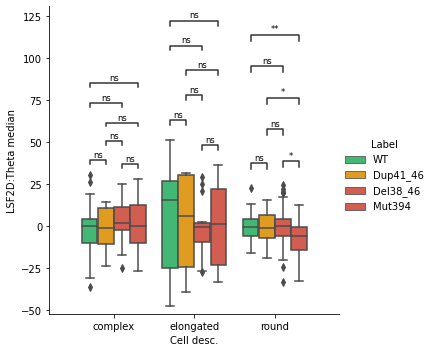

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.215e-01 stat=-1.241e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.256e-01 stat=-2.219e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=8.134e-01 stat=2.387e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.719e-01 stat=-7.266e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=9.763e-01 stat=2.989e-02
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.573e-01 stat=-1.434e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.054e-01 stat=6.750e-

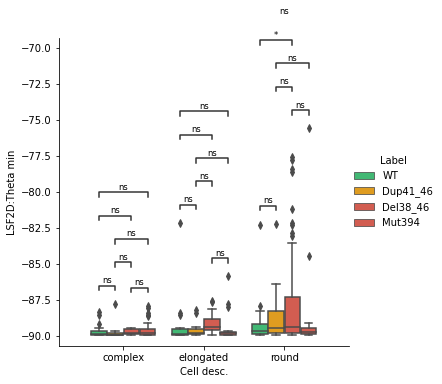

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.594e-01 stat=7.467e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.813e-01 stat=-1.503e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.020e-01 stat=-1.244e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.857e-01 stat=5.497e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=7.901e-01 stat=-2.679e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.271e-01 stat=4.885e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.208e-01 stat=-1.602e+

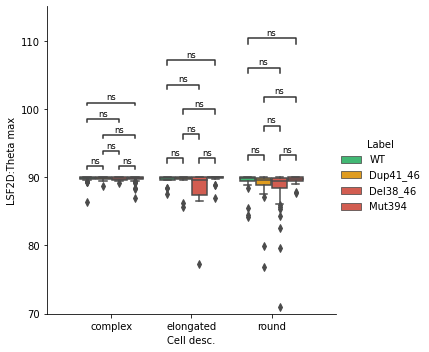

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=9.086e-01 stat=-1.155e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.673e-01 stat=7.344e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=6.912e-01 stat=-4.020e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.927e-01 stat=-5.394e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=6.617e-01 stat=4.407e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.628e-01 stat=4.385e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.731e-02 stat=-1.986e+

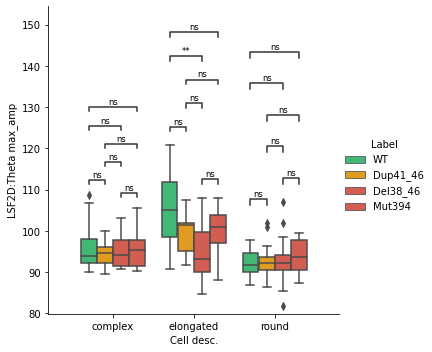

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=8.788e-01 stat=1.535e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=6.581e-01 stat=4.462e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=8.972e-01 stat=1.306e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=8.075e-01 stat=2.454e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=4.967e-01 stat=6.858e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.498e-01 stat=9.429e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.271e-02 stat=-1.868e+00


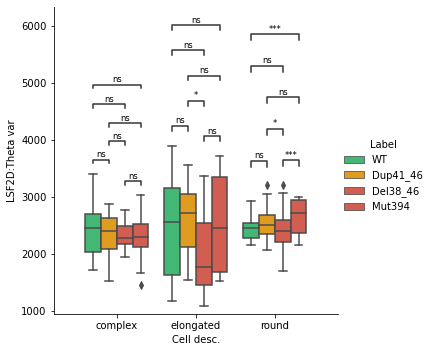

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=8.179e-01 stat=2.317e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=6.717e-01 stat=4.272e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.666e-01 stat=4.227e-02
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=8.264e-01 stat=2.208e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.641e-01 stat=5.815e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.770e-01 stat=8.907e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.090e-02 stat=-1.880e+00


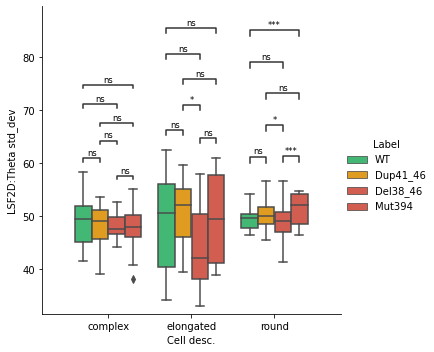

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=9.703e-01 stat=3.743e-02
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=7.821e-01 stat=2.787e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=8.774e-01 stat=1.559e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=8.539e-01 stat=1.855e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=6.203e-01 stat=4.992e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=5.335e-01 stat=6.267e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.075e-01 stat=-1.665e+00


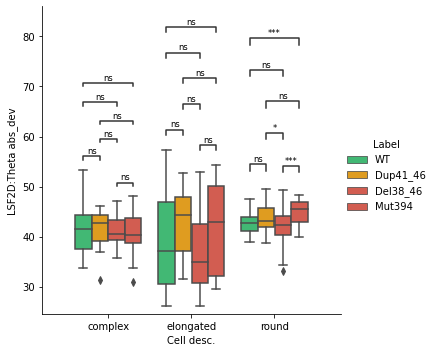

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=8.488e-01 stat=1.918e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=9.412e-01 stat=-7.432e-02
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=8.972e-01 stat=-1.305e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=9.854e-01 stat=1.845e-02
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=8.129e-01 stat=-2.383e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=9.340e-01 stat=-8.323e-02
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=3.288e-01 stat=9.945e-

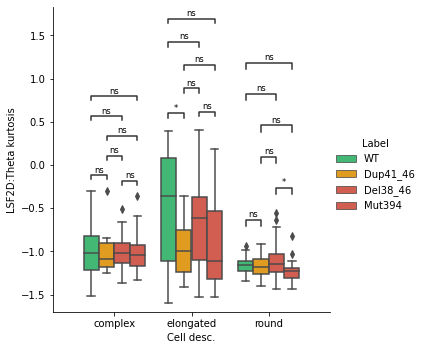

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=5.006e-01 stat=-6.794e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.268e-01 stat=2.203e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=6.707e-01 stat=4.305e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=9.028e-01 stat=-1.229e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=4.508e-01 stat=7.614e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=8.882e-01 stat=1.412e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=8.027e-01 stat=2.523e-01

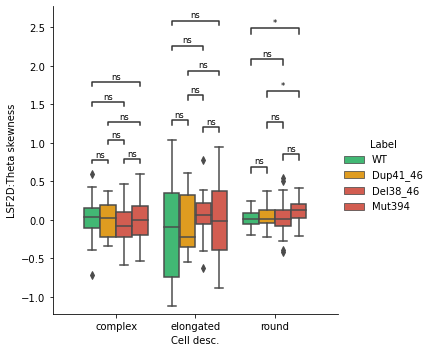

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=8.007e-01 stat=2.540e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=9.955e-01 stat=5.719e-03
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=6.848e-01 stat=4.108e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.769e-01 stat=5.628e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=6.626e-01 stat=4.395e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.597e-01 stat=7.446e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=6.602e-02 stat=-1.916e+00


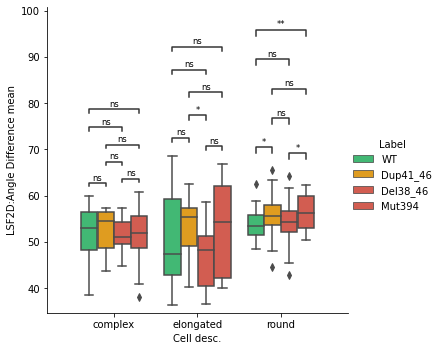

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=5.470e-01 stat=6.071e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.898e-01 stat=1.395e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=8.284e-01 stat=2.191e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.955e-01 stat=6.881e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=6.839e-01 stat=4.100e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.745e-01 stat=1.104e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=6.057e-02 stat=-1.959e+00


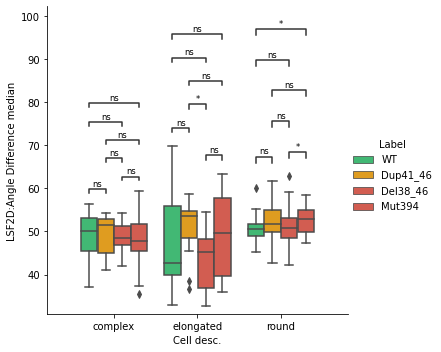

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.215e-02 stat=2.621e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=7.758e-01 stat=-2.869e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.265e-01 stat=-1.583e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.603e-01 stat=7.459e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.661e-02 stat=-2.161e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=5.650e-01 stat=5.789e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=8.813e-01 stat=1.507e-0

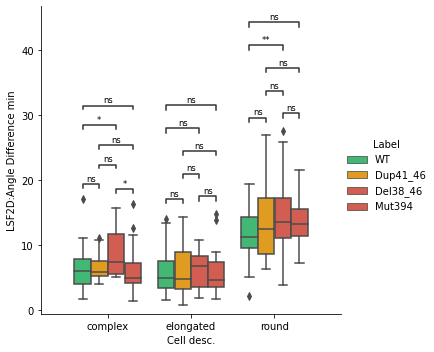

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=9.805e-02 stat=-1.692e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=6.306e-01 stat=-4.849e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.752e-02 stat=2.551e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.867e-01 stat=1.345e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.859e-02 stat=2.451e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.965e-01 stat=1.054e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=8.609e-04 stat=-3.747e+0

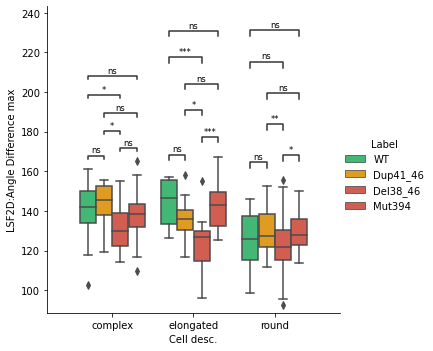

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.396e-02 stat=-2.077e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.269e-01 stat=-6.388e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.379e-02 stat=2.657e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.969e-01 stat=1.314e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=6.619e-03 stat=2.861e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.468e-01 stat=9.489e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.794e-03 stat=-3.464e+0

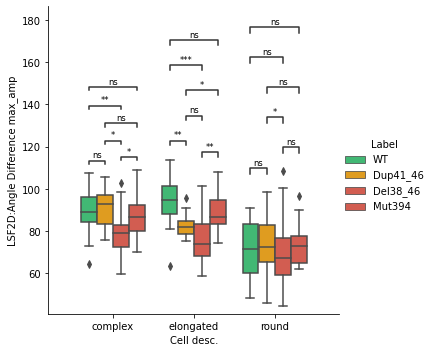

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.976e-01 stat=-1.055e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=7.458e-01 stat=3.267e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.593e-01 stat=1.156e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=6.909e-01 stat=4.007e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=6.740e-02 stat=1.879e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.099e-01 stat=1.025e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.420e-02 stat=-2.013e+00

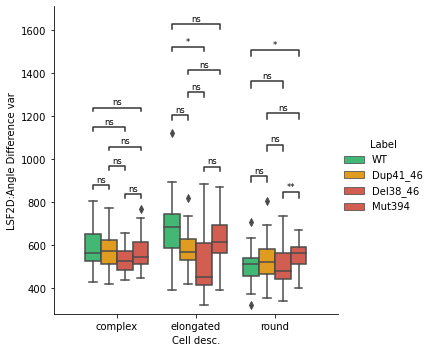

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.959e-01 stat=-1.058e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=7.214e-01 stat=3.593e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.752e-01 stat=1.117e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=7.127e-01 stat=3.709e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=6.581e-02 stat=1.890e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.052e-01 stat=1.035e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=4.144e-02 stat=-2.141e+00

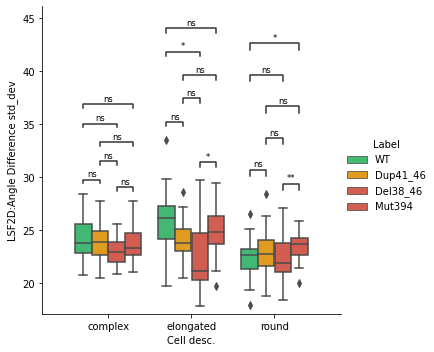

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=5.118e-01 stat=-6.616e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.469e-01 stat=7.688e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=6.607e-01 stat=4.445e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=9.868e-01 stat=-1.668e-02
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.334e-01 stat=1.531e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.619e-01 stat=1.134e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=4.017e-02 stat=-2.156e+0

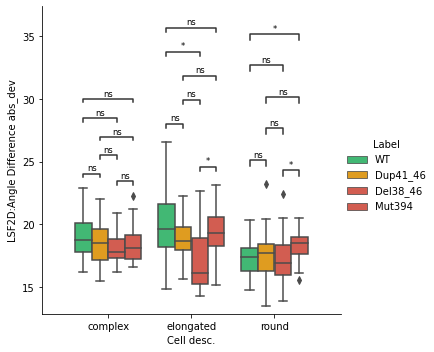

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.145e-01 stat=-8.242e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=1.225e-01 stat=-1.580e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.148e-01 stat=1.636e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.976e-01 stat=1.311e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=6.160e-01 stat=5.054e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.914e-01 stat=-3.991e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.507e-01 stat=6.042e-0

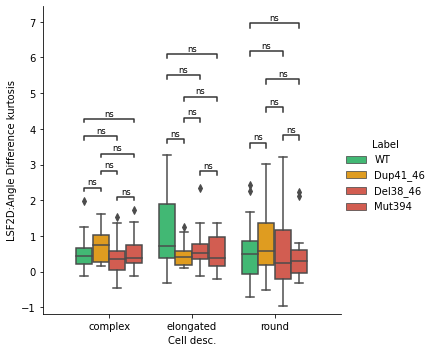

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.118e-01 stat=-1.268e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.869e-02 stat=-1.951e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=5.463e-02 stat=2.020e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.982e-01 stat=1.310e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.008e-01 stat=6.793e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.301e-01 stat=-7.949e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=4.286e-01 stat=8.037e-0

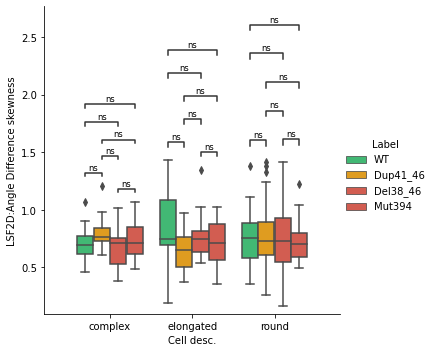

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=7.747e-01 stat=2.881e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=6.735e-01 stat=4.247e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.575e-01 stat=5.380e-02
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=7.752e-01 stat=2.876e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.786e-01 stat=5.599e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.587e-01 stat=9.255e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.881e-02 stat=-1.973e+00


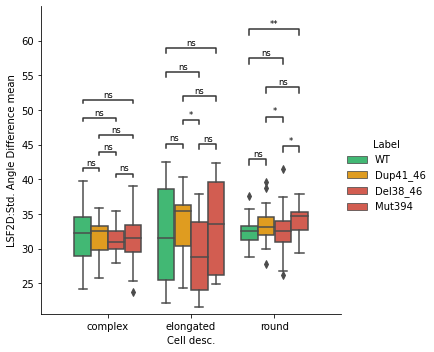

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=6.077e-01 stat=5.173e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.696e-01 stat=7.307e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=7.798e-01 stat=-2.827e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=8.574e-01 stat=1.809e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.673e-01 stat=5.767e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.332e-01 stat=1.205e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.676e-02 stat=-1.990e+00

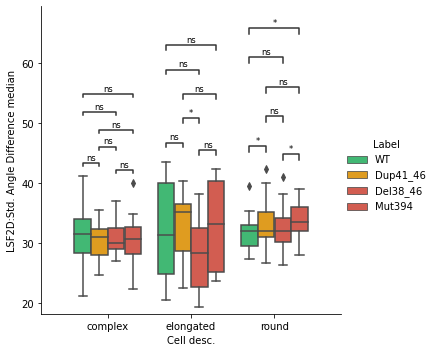

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=7.653e-02 stat=1.816e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=7.632e-01 stat=-3.035e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=5.545e-01 stat=-5.995e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.583e-01 stat=7.493e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.296e-01 stat=-1.220e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=5.418e-01 stat=6.139e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=9.186e-01 stat=-1.031e-

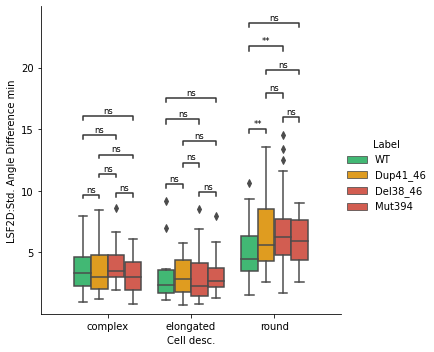

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=7.549e-01 stat=-3.142e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=6.261e-01 stat=-4.914e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.964e-01 stat=1.067e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.727e-01 stat=9.020e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.069e-01 stat=6.695e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.444e-01 stat=4.641e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=3.739e-03 stat=-3.174e+0

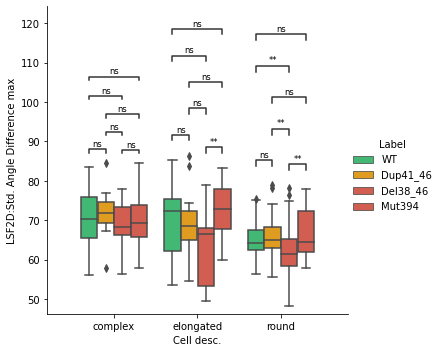

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=6.084e-01 stat=-5.162e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.132e-01 stat=-8.276e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.485e-01 stat=1.183e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.440e-01 stat=7.735e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.547e-01 stat=5.956e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=9.731e-01 stat=3.387e-02
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.007e-02 stat=-2.768e+0

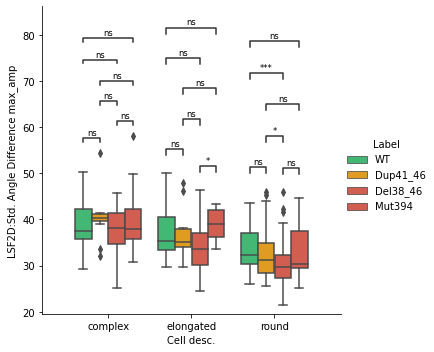

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=3.316e-01 stat=-9.822e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.684e-01 stat=5.755e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=5.993e-01 stat=5.325e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=8.098e-01 stat=-2.423e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.011e-01 stat=1.299e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.016e-01 stat=5.252e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.523e-02 stat=-2.369e+0

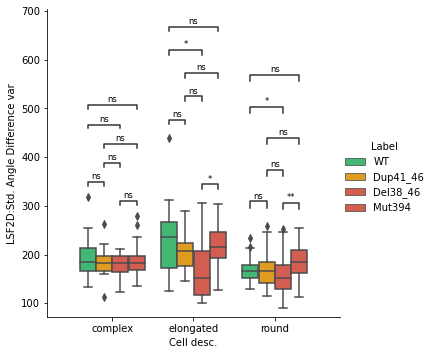

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=3.465e-01 stat=-9.521e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.532e-01 stat=5.985e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=6.609e-01 stat=4.442e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=7.734e-01 stat=-2.900e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.139e-01 stat=1.262e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.227e-01 stat=4.949e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.906e-02 stat=-2.494e+0

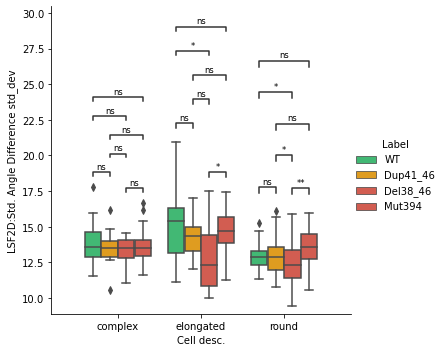

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.988e-01 stat=-1.306e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.662e-01 stat=7.363e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=5.817e-01 stat=5.585e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=6.248e-01 stat=-4.930e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.362e-01 stat=1.520e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.762e-01 stat=4.200e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.539e-02 stat=-2.587e+0

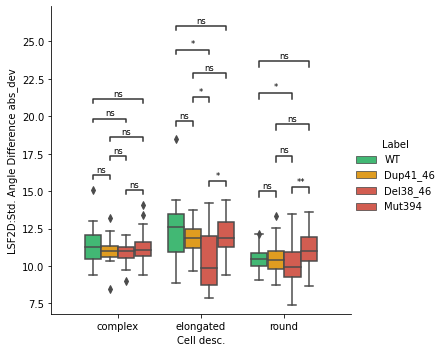

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.198e-01 stat=8.148e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.190e-01 stat=-8.173e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.265e-01 stat=-1.241e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=9.548e-01 stat=5.707e-02
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.771e-02 stat=-2.148e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.087e-01 stat=-5.148e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.961e-01 stat=1.325e+

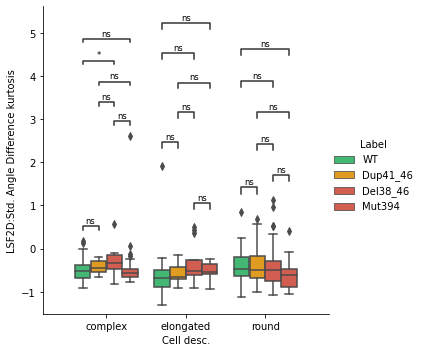

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=6.647e-01 stat=4.365e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=1.419e-01 stat=-1.501e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=7.593e-01 stat=3.100e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.829e-01 stat=7.085e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.039e-01 stat=-1.291e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.484e-01 stat=-9.457e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=4.690e-02 stat=2.083e+0

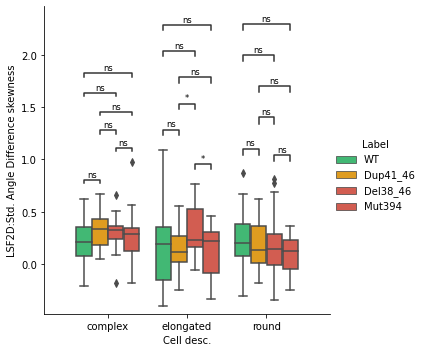

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.063e-01 stat=1.284e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.245e-01 stat=8.075e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.389e-02 stat=-1.744e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.686e-01 stat=-7.321e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=6.440e-01 stat=-4.655e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=5.995e-01 stat=5.282e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.157e-01 stat=6.586e-0

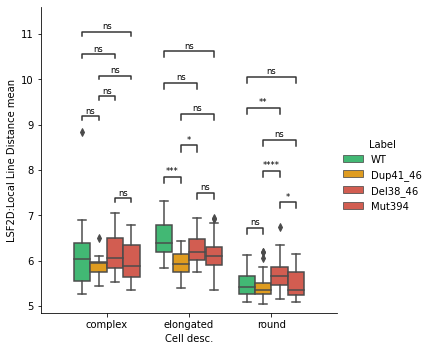

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=3.420e-01 stat=9.611e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.449e-01 stat=6.110e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.824e-01 stat=-1.373e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.540e-01 stat=-5.971e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.220e-01 stat=-6.458e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=8.457e-01 stat=1.956e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=6.372e-01 stat=4.769e-0

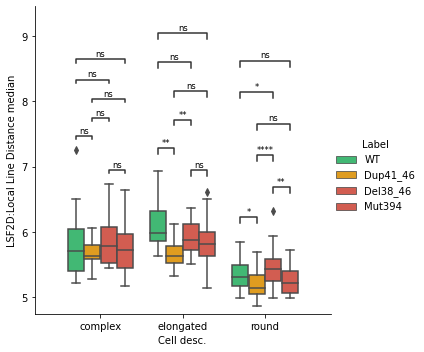

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.669e-01 stat=1.125e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.016e-02 stat=1.799e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=3.500e-02 stat=-2.235e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.460e-02 stat=-1.983e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.965e-01 stat=-1.057e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=9.962e-01 stat=-4.839e-03
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=3.035e-02 stat=2.286e+

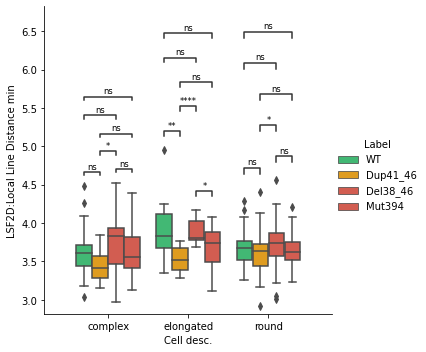

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=7.749e-01 stat=-2.878e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.902e-01 stat=-1.390e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.685e-01 stat=3.987e-02
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=8.115e-01 stat=-2.402e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=9.265e-01 stat=-9.281e-02
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.376e-01 stat=-4.737e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=3.191e-01 stat=-1.015

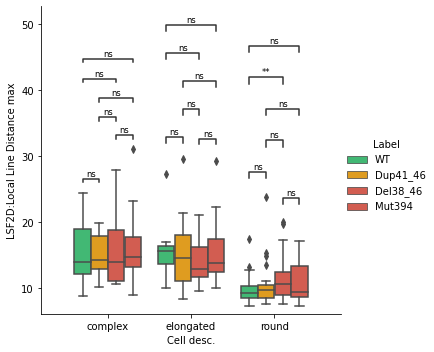

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=6.713e-01 stat=-4.274e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=7.751e-01 stat=-2.878e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=8.297e-01 stat=2.175e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=8.574e-01 stat=-1.809e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=9.770e-01 stat=-2.905e-02
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=5.648e-01 stat=-5.792e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.600e-01 stat=-1.151

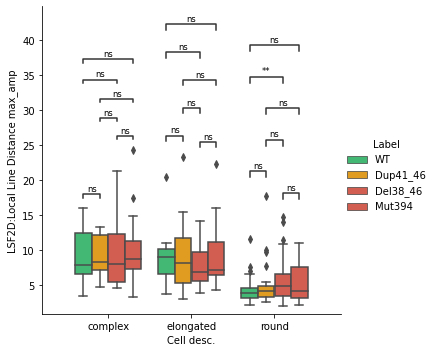

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.883e-01 stat=1.075e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.568e-01 stat=9.331e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.857e-01 stat=-1.362e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.353e-01 stat=-9.759e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=9.635e-01 stat=4.604e-02
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.818e-01 stat=8.817e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=4.676e-01 stat=7.368e-01

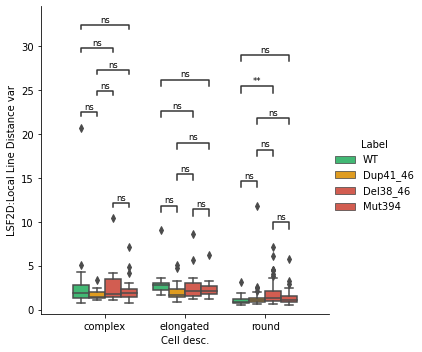

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=3.208e-01 stat=1.005e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.055e-01 stat=1.039e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.644e-01 stat=-1.434e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.522e-01 stat=-9.419e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=8.568e-01 stat=-1.816e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.733e-01 stat=7.221e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.294e-01 stat=6.371e-0

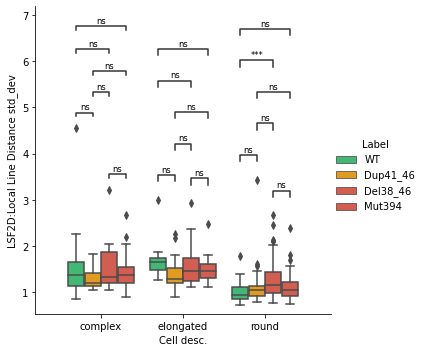

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.564e-01 stat=1.150e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=2.443e-01 stat=1.183e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.262e-01 stat=-1.584e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.469e-01 stat=-9.524e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=9.495e-01 stat=-6.367e-02
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.350e-01 stat=9.726e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=3.255e-01 stat=1.002e+0

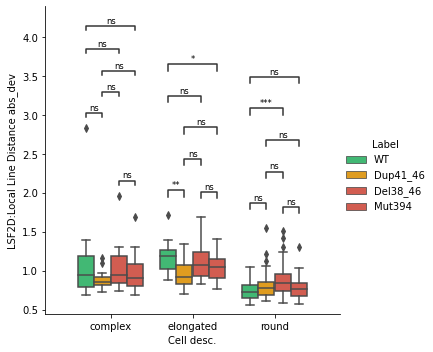

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=5.457e-01 stat=-6.092e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.763e-01 stat=-7.196e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=6.573e-01 stat=4.492e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=8.873e-01 stat=-1.426e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=7.515e-01 stat=-3.188e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.942e-01 stat=-1.059e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.502e-02 stat=-2.373

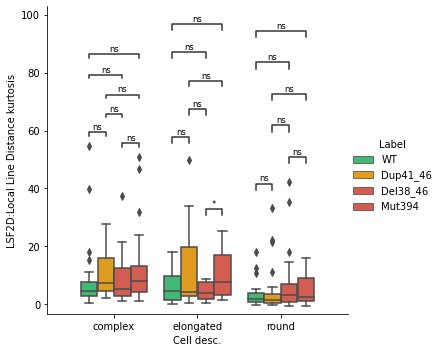

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=7.690e-01 stat=-2.955e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.793e-01 stat=-7.147e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.316e-01 stat=8.670e-02
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=8.529e-01 stat=-1.866e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.099e-01 stat=-6.648e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.689e-01 stat=-1.117e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.376e-02 stat=-1.860

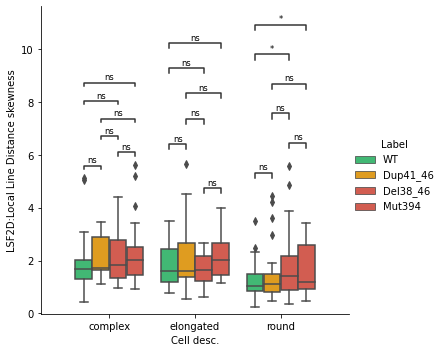

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.673e-01 stat=1.405e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.513e-01 stat=9.440e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.010e-02 stat=-2.490e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.372e-01 stat=-1.201e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=4.345e-01 stat=-7.892e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=8.094e-01 stat=2.423e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=4.466e-01 stat=7.724e-0

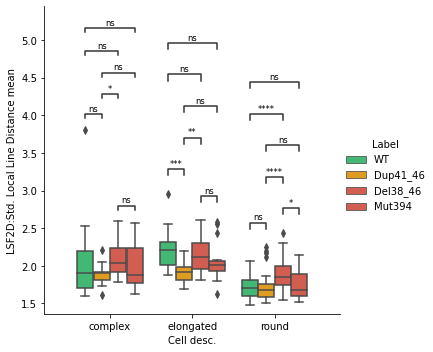

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.594e-01 stat=1.143e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.007e-01 stat=8.502e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.356e-02 stat=-2.665e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.122e-01 stat=-1.269e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.077e-01 stat=-1.280e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=7.527e-01 stat=-3.167e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.315e-01 stat=3.466e-

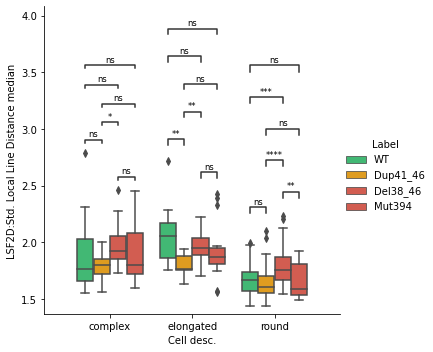

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.414e-02 stat=2.339e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=2.885e-01 stat=1.077e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.464e-02 stat=-2.398e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.708e-01 stat=-9.057e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.246e-02 stat=-1.997e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=7.588e-01 stat=3.086e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=8.768e-01 stat=-1.565e-

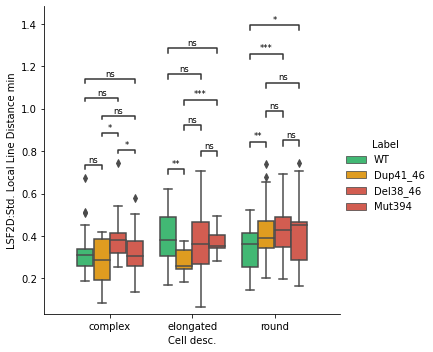

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=6.001e-01 stat=5.283e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.208e-01 stat=8.140e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=3.376e-01 stat=-9.784e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.370e-01 stat=-6.230e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=8.390e-01 stat=-2.044e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=7.248e-01 stat=3.538e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.305e-01 stat=-6.354e-

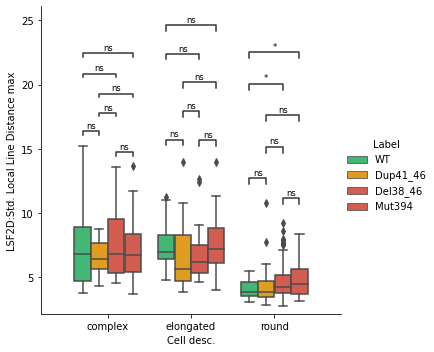

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=6.937e-01 stat=3.965e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.582e-01 stat=7.496e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=4.453e-01 stat=-7.761e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=6.121e-01 stat=-5.114e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=9.198e-01 stat=-1.013e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=7.272e-01 stat=3.506e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=4.503e-01 stat=-7.661e-

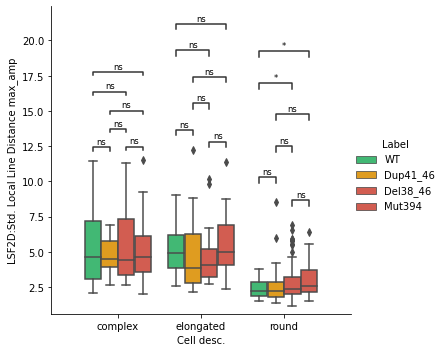

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=3.605e-01 stat=9.245e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.900e-01 stat=8.698e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.455e-01 stat=-1.504e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.202e-01 stat=-1.247e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=8.239e-01 stat=2.240e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.136e-01 stat=8.238e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.503e-01 stat=1.175e+00

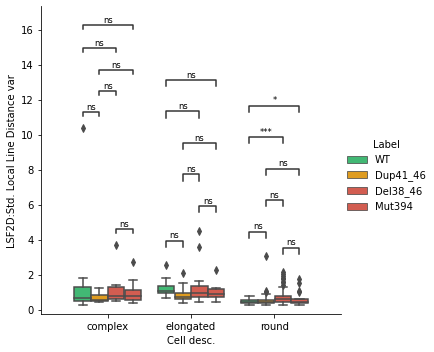

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=3.648e-01 stat=9.162e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.171e-01 stat=1.014e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.017e-01 stat=-1.702e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.120e-01 stat=-1.269e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=9.012e-01 stat=-1.249e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=5.681e-01 stat=5.743e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=3.091e-01 stat=1.037e+0

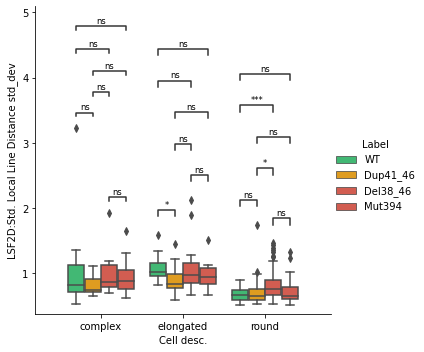

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=3.605e-01 stat=9.246e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.161e-01 stat=1.016e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=6.675e-02 stat=-1.921e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.687e-01 stat=-1.403e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=8.880e-01 stat=-1.417e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.076e-01 stat=5.165e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.130e-01 stat=1.275e+0

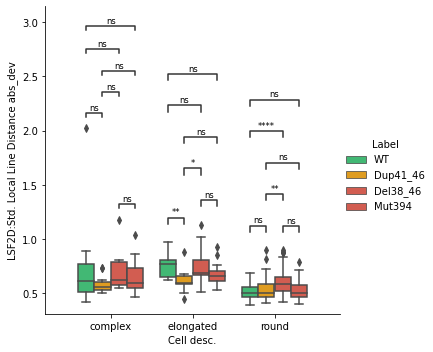

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=9.588e-01 stat=5.192e-02
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=7.022e-01 stat=3.853e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=6.042e-01 stat=-5.253e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=6.982e-01 stat=-3.907e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=9.378e-01 stat=-7.856e-02
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=9.782e-01 stat=-2.747e-02
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.610e-01 stat=-1.441e

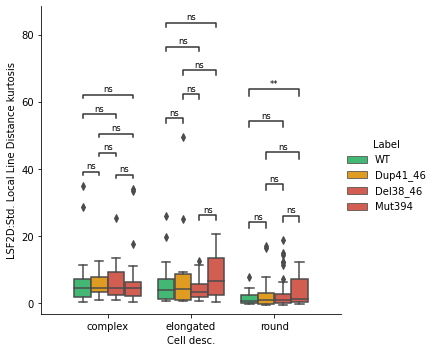

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=7.047e-01 stat=3.815e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=6.211e-01 stat=4.985e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=4.508e-01 stat=-7.665e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=7.196e-01 stat=-3.617e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=7.933e-01 stat=-2.638e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=8.832e-01 stat=1.475e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=4.581e-01 stat=-7.528e-

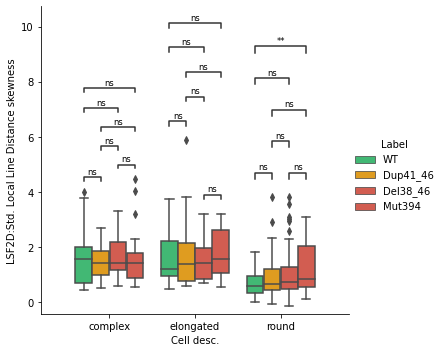

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=6.253e-02 stat=-1.913e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=7.839e-01 stat=-2.763e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=3.582e-03 stat=3.229e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.210e-01 stat=1.005e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=4.323e-03 stat=3.021e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.235e-01 stat=9.963e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.103e-02 stat=-2.451e+0

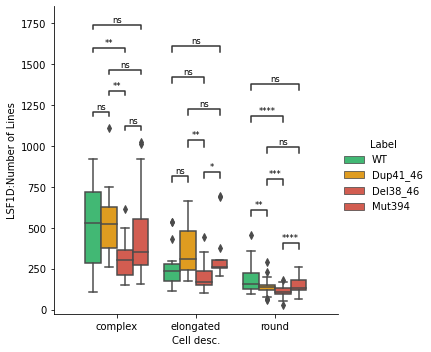

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=9.255e-01 stat=-9.405e-02
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=2.721e-01 stat=1.115e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=3.097e-01 stat=-1.038e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.254e-01 stat=-1.232e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=9.370e-01 stat=7.956e-02
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=9.933e-01 stat=-8.437e-03
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=4.261e-01 stat=8.080e-

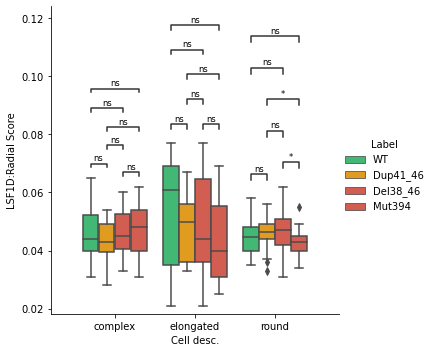

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.264e-03 stat=-3.457e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=1.409e-01 stat=-1.505e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.551e-03 stat=3.569e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=8.767e-01 stat=-1.562e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.354e-02 stat=2.580e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.889e-02 stat=-1.855e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=6.196e-01 stat=-5.022e

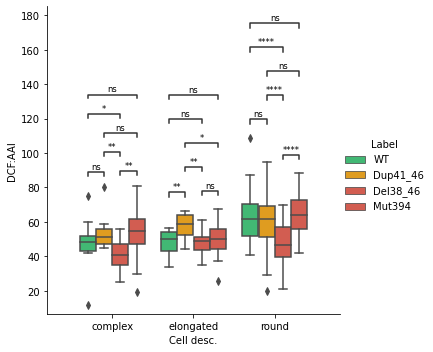

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.831e-02 stat=-2.455e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=6.545e-01 stat=4.512e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.892e-02 stat=1.717e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=8.628e-01 stat=-1.739e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.649e-02 stat=2.302e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.456e-01 stat=4.625e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.901e-01 stat=-1.344e+0

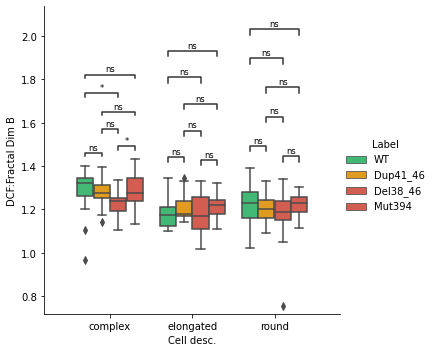

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=8.935e-02 stat=-1.739e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=7.400e-01 stat=-3.344e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.132e-01 stat=1.279e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=9.062e-01 stat=-1.186e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.957e-01 stat=1.059e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=5.298e-01 stat=-6.323e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.627e-01 stat=-5.861e

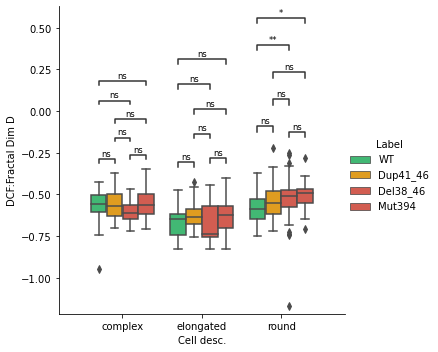

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.963e-01 stat=-6.863e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.613e-01 stat=5.862e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.565e-01 stat=1.463e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.244e-01 stat=8.075e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.953e-02 stat=2.127e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=8.733e-02 stat=1.741e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.983e-02 stat=-1.820e+00

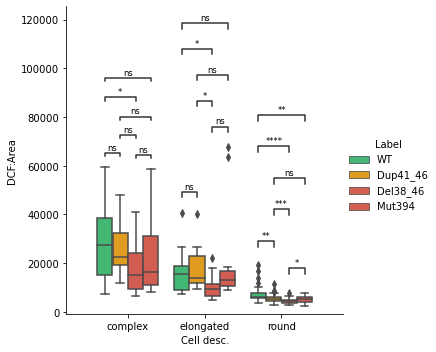

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.512e-01 stat=-1.163e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.564e-01 stat=-7.526e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=6.025e-03 stat=3.012e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.985e-01 stat=1.054e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.739e-02 stat=2.288e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=5.019e-01 stat=6.760e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.467e-02 stat=-2.009e+0

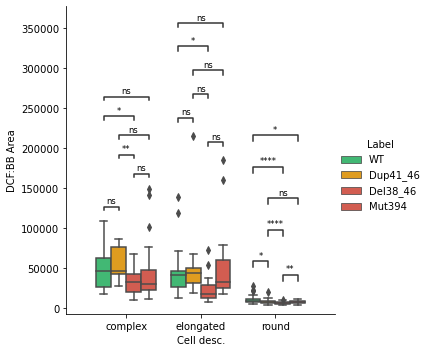

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.452e-02 stat=-2.333e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=7.539e-01 stat=3.158e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=3.793e-05 stat=5.036e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.762e-02 stat=2.291e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.919e-03 stat=3.058e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.949e-02 stat=2.407e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.876e-02 stat=-2.501e+00

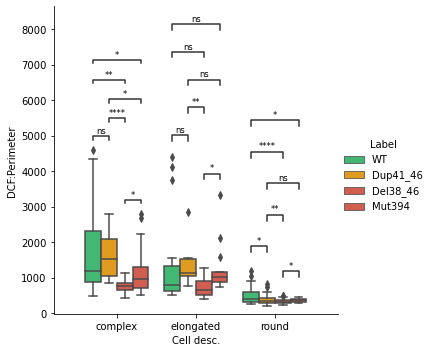

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=3.356e-01 stat=-9.741e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=2.233e-01 stat=-1.239e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=8.420e-03 stat=2.871e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.464e-02 stat=2.077e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=8.228e-02 stat=1.781e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.231e-01 stat=9.970e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=8.379e-04 stat=-3.757e+0

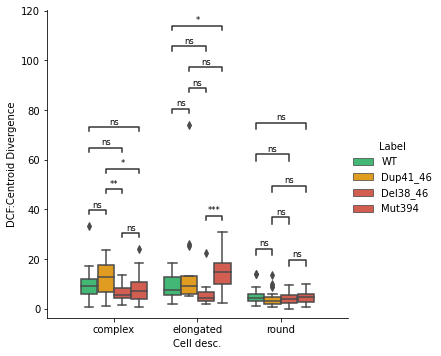

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.854e-01 stat=-7.038e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=7.048e-01 stat=3.818e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.085e-01 stat=1.667e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.927e-01 stat=1.067e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.438e-02 stat=2.189e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=7.741e-02 stat=1.800e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=4.378e-02 stat=-2.115e+00

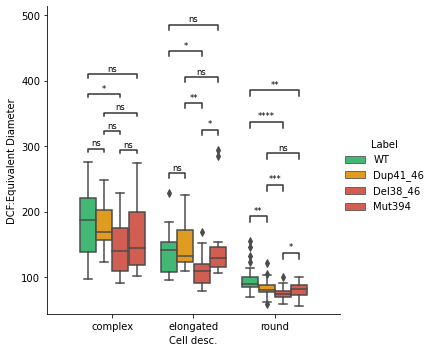

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.052e-01 stat=-1.287e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=9.724e-01 stat=-3.484e-02
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=3.779e-03 stat=3.207e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.150e-01 stat=1.261e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.163e-02 stat=2.388e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.695e-01 stat=1.392e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.011e-01 stat=-1.698e+0

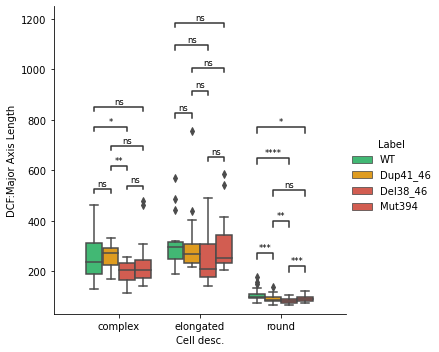

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=7.413e-01 stat=-3.323e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=9.884e-01 stat=1.465e-02
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.686e-01 stat=1.133e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.495e-01 stat=9.473e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.234e-01 stat=1.573e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.715e-01 stat=1.385e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=4.616e-02 stat=-2.090e+00

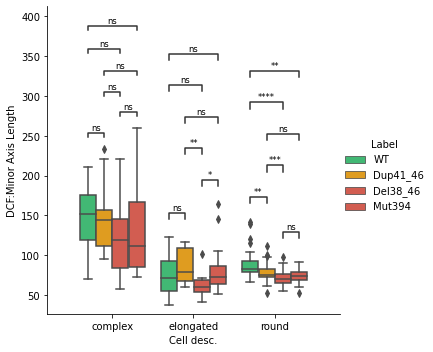

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=6.505e-01 stat=-4.563e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=9.545e-01 stat=-5.738e-02
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=7.206e-01 stat=3.619e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=9.897e-01 stat=1.301e-02
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=6.351e-01 stat=4.781e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=9.547e-01 stat=-5.712e-02
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.095e-01 stat=-3.765e-

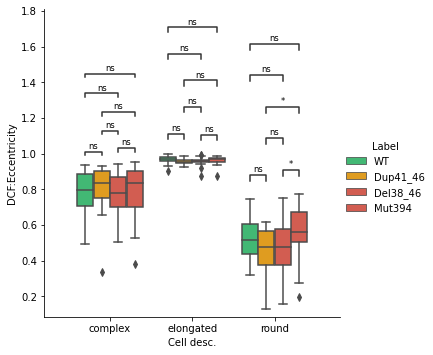

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.093e-04 stat=4.060e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=7.658e-02 stat=1.822e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=5.617e-06 stat=-5.798e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.843e-03 stat=-2.921e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.953e-01 stat=-1.316e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.696e-01 stat=9.046e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=3.678e-03 stat=3.180e+0

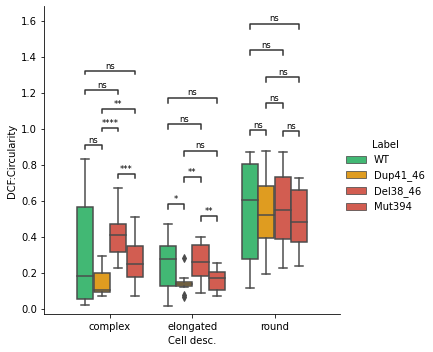

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.691e-01 stat=7.305e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.238e-01 stat=1.000e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.401e-01 stat=-1.205e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.616e-01 stat=-5.855e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=6.722e-01 stat=-4.262e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.701e-01 stat=4.283e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.140e-01 stat=3.703e-0

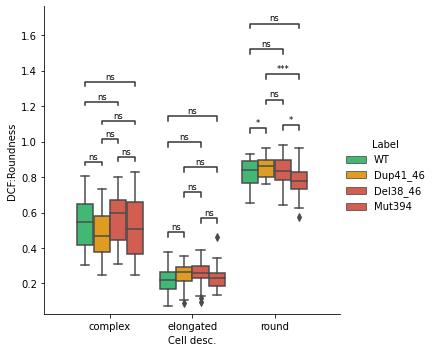

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.101e-01 stat=1.273e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.916e-01 stat=-6.947e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.796e-01 stat=-2.590e-02
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.902e-01 stat=1.073e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=4.079e-01 stat=-8.362e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=5.792e-01 stat=5.579e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=3.334e-01 stat=-9.849e-

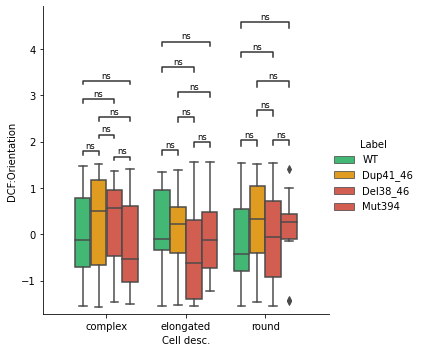

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.080e-01 stat=1.642e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.042e-03 stat=3.172e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=6.149e-03 stat=-3.004e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.948e-02 stat=-2.440e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=9.173e-01 stat=-1.045e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=9.382e-02 stat=1.705e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.074e-01 stat=3.794e-0

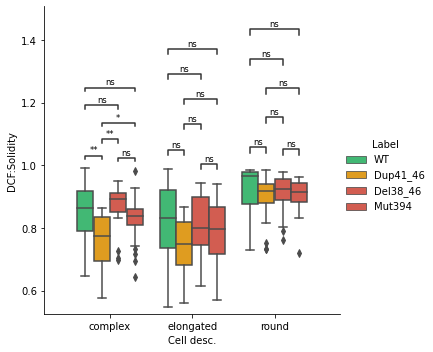

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.077e-03 stat=-3.512e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.691e-01 stat=7.315e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=8.842e-06 stat=5.615e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.461e-03 stat=3.118e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=9.990e-03 stat=2.702e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.214e-02 stat=2.594e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=6.326e-03 stat=-2.961e+00

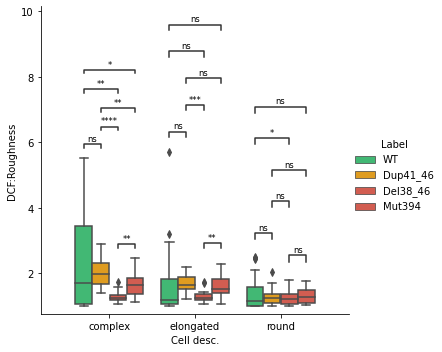

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.155e-03 stat=-3.488e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=1.381e-01 stat=-1.516e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.708e-03 stat=3.531e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=8.408e-01 stat=-2.022e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.595e-02 stat=2.514e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=5.762e-02 stat=-1.939e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.725e-01 stat=-5.714e

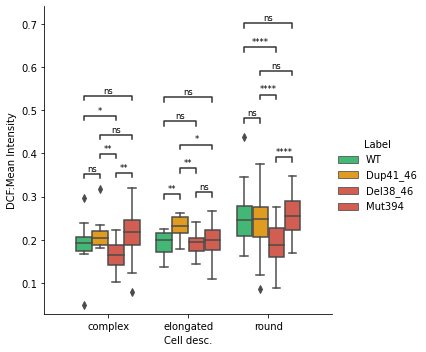

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.532e-05 stat=-4.732e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=9.965e-01 stat=-4.447e-03
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.165e-04 stat=4.594e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=7.957e-01 stat=-2.608e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=4.309e-04 stat=3.830e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=7.708e-01 stat=-2.927e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.527e-02 stat=-2.591e

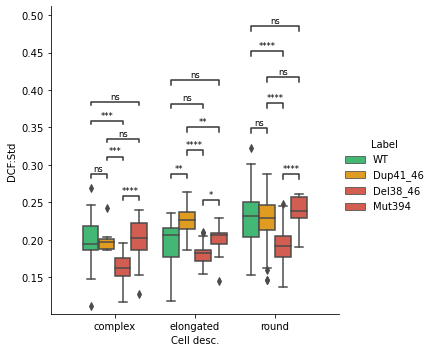

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=3.534e-05 stat=-4.627e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.573e-01 stat=1.811e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.047e-04 stat=4.636e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=6.979e-01 stat=-3.911e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=4.579e-04 stat=3.810e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=8.423e-01 stat=-2.000e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.220e-02 stat=-2.687e+

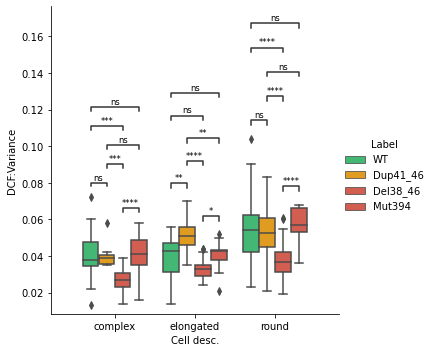

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.748e-01 stat=1.380e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=2.148e-01 stat=1.262e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.250e-02 stat=-2.700e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.999e-01 stat=-8.513e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.221e-01 stat=-1.240e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=7.538e-01 stat=3.151e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=9.398e-01 stat=-7.620e-

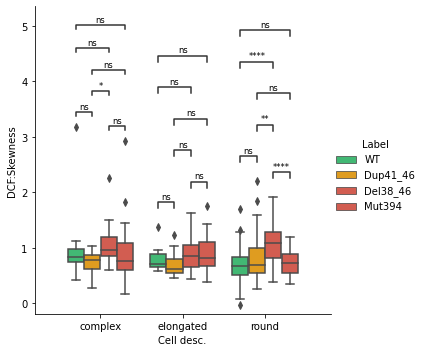

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.186e-01 stat=8.169e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.066e-01 stat=6.707e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.376e-02 stat=-2.414e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.715e-01 stat=-9.043e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.071e-01 stat=-1.034e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=8.005e-01 stat=-2.540e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.275e-01 stat=6.401e-

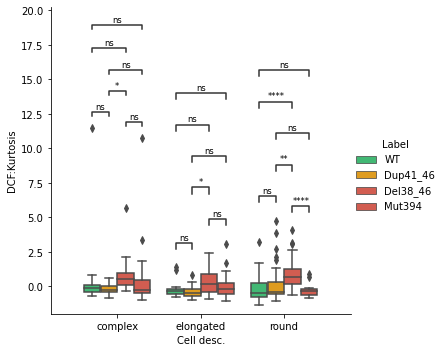

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=nan stat=nan
elongated_WT v.s. elongated_Dup41_46: t-test independent samples, P_val=nan stat=nan


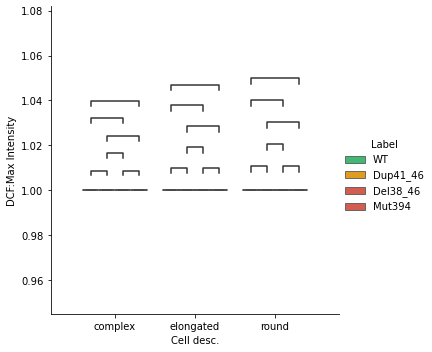

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.526e-02 stat=2.064e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=1.405e-01 stat=1.506e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.234e-01 stat=-1.250e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=7.099e-01 stat=3.746e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.679e-02 stat=2.466e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=3.092e-01 stat=1.036e+00
elongated_WT

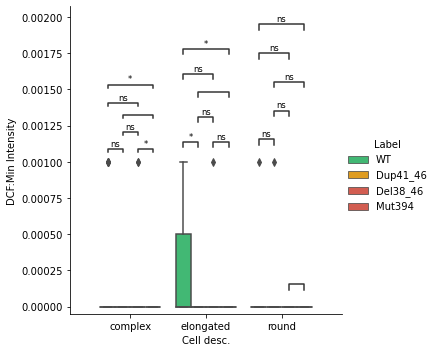

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=8.687e-01 stat=1.663e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=7.246e-02 stat=1.849e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=4.819e-02 stat=-2.082e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.560e-02 stat=-1.975e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=9.618e-01 stat=-4.818e-02
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=9.015e-01 stat=1.243e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.396e-02 stat=1.859e+0

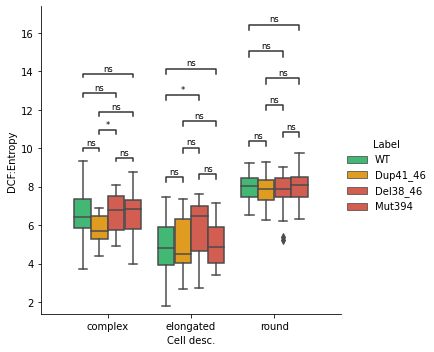

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=3.414e-01 stat=-9.622e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=1.285e-01 stat=-1.555e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=3.479e-03 stat=3.241e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.530e-02 stat=2.540e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.002e-01 stat=1.682e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.337e-01 stat=9.753e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=6.097e-02 stat=-1.955e+0

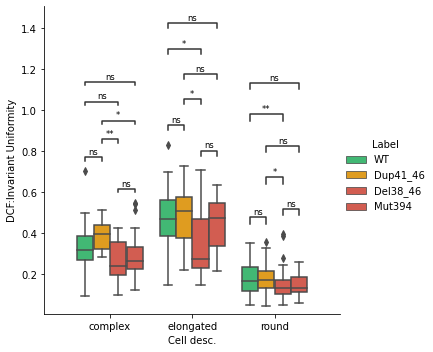

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.137e-03 stat=-3.272e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=7.365e-01 stat=-3.390e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.793e-05 stat=5.333e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.430e-01 stat=1.186e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.401e-04 stat=3.909e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.363e-01 stat=9.699e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.748e-03 stat=-3.296e+0

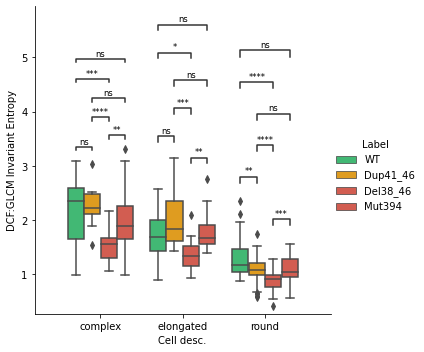

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=3.416e-01 stat=-9.619e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=7.661e-01 stat=-2.997e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.558e-01 stat=1.465e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.586e-01 stat=5.901e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.612e-01 stat=1.139e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=7.649e-01 stat=3.005e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=3.266e-01 stat=-9.991e-0

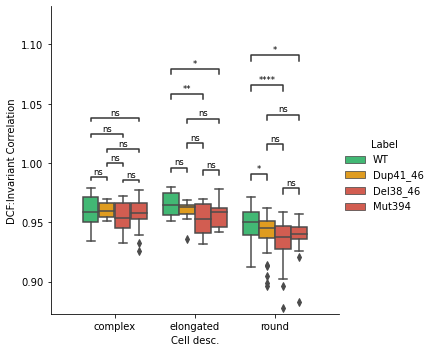

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.081e-01 stat=-1.642e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.106e-01 stat=1.028e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.645e-01 stat=-4.503e-02
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.214e-01 stat=-1.584e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.101e-01 stat=1.028e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.270e-01 stat=-8.003e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.078e-01 stat=1.291e+

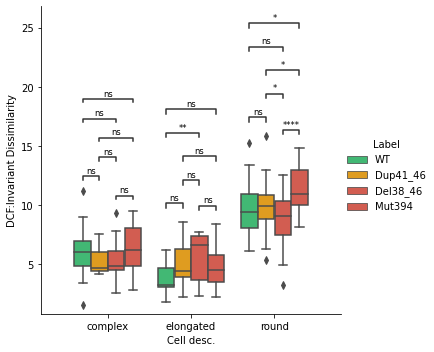

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.488e-02 stat=-2.068e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.617e-01 stat=7.438e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=4.328e-01 stat=7.978e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.218e-01 stat=-1.242e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.239e-01 stat=1.571e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.871e-01 stat=-6.996e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=6.229e-01 stat=4.975e-0

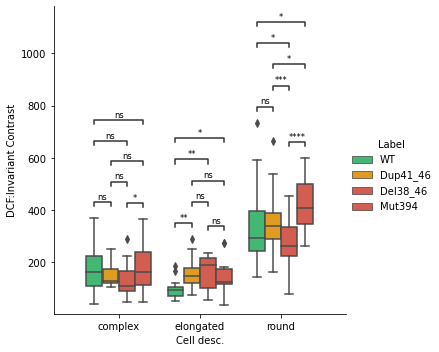

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=6.879e-01 stat=-4.045e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=1.257e-01 stat=-1.566e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.184e-02 stat=2.724e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.130e-02 stat=2.402e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.433e-01 stat=1.184e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.471e-01 stat=9.483e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=3.800e-02 stat=-2.182e+0

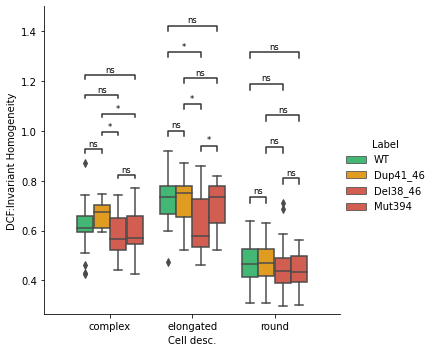

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.958e-01 stat=-1.059e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=9.846e-02 stat=-1.695e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=3.276e-03 stat=3.266e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.099e-02 stat=2.674e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=9.419e-02 stat=1.713e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.563e-01 stat=9.303e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=4.357e-02 stat=-2.117e+0

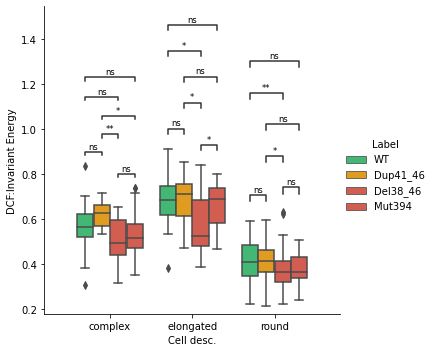

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.927e-01 stat=1.066e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.657e-01 stat=9.158e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.382e-02 stat=-2.413e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.537e-01 stat=-1.456e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.709e-02 stat=-1.958e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.757e-01 stat=-8.931e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.996e-02 stat=1.819e+

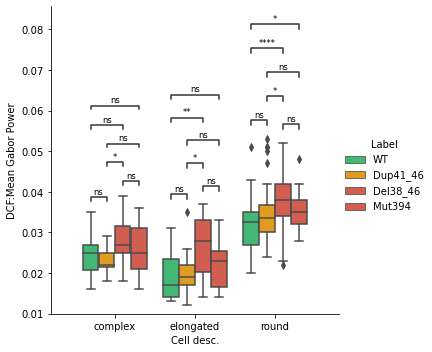

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=nan stat=nan
elongated_WT v.s. elongated_Dup41_46: t-test independent samples, P_val=nan stat=nan


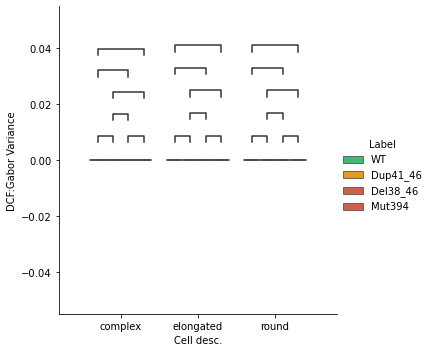

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=nan stat=nan
elongated_WT v.s. elongated_Dup41_46: t-test independent samples, P_val=nan stat=nan


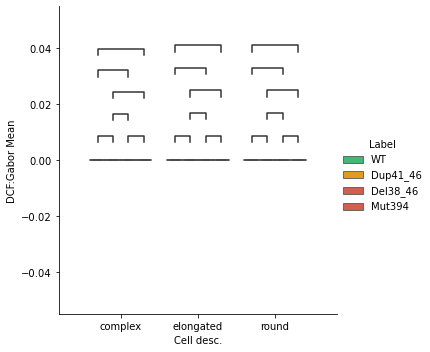

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=nan stat=nan
elongated_WT v.s. elongated_Dup41_46: t-test independent samples, P_val=nan stat=nan


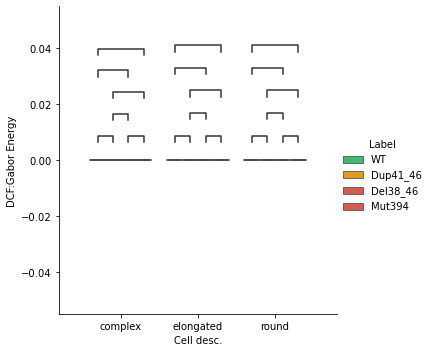

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=5.881e-01 stat=5.458e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=6.117e-03 stat=2.908e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.253e-01 stat=-1.588e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.161e-01 stat=-1.258e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.040e-01 stat=1.041e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=5.286e-02 stat=1.979e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.579e-01 stat=1.452e+00

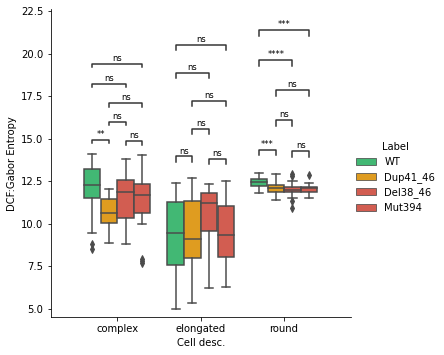

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.292e-07 stat=-6.339e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=1.703e-01 stat=-1.398e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=7.813e-07 stat=6.607e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.075e-01 stat=6.691e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=8.065e-04 stat=3.618e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.015e-01 stat=-1.293e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.060e-05 stat=-5.394e+

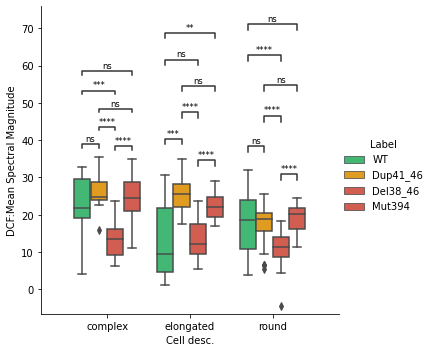

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=7.843e-02 stat=1.804e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=9.262e-01 stat=9.330e-02
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.034e-01 stat=-1.308e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=7.880e-01 stat=2.708e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.202e-01 stat=-1.245e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.509e-01 stat=4.550e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=9.805e-01 stat=-2.461e-0

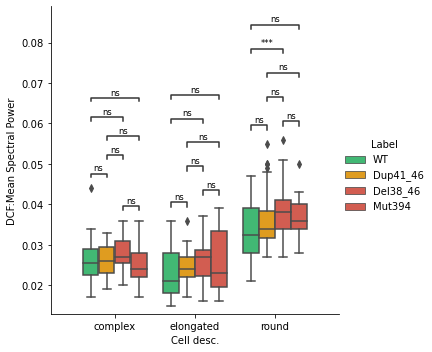

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=3.090e-01 stat=-1.030e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.845e-01 stat=-8.798e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.628e-01 stat=-1.415e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.682e-01 stat=-1.416e+00
elongated_WT v.s. elongated_Dup41

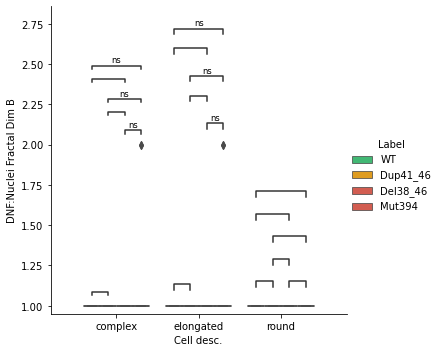

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=9.317e-01 stat=8.619e-02
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=2.115e-02 stat=-2.408e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.564e-02 stat=2.602e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=9.890e-03 stat=2.716e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=7.879e-01 stat=2.708e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.673e-01 stat=4.322e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=3.331e-01 stat=-9.856e-01

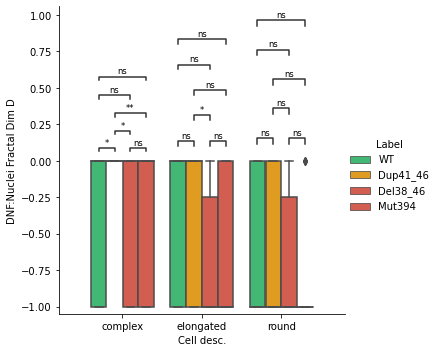

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.829e-01 stat=-7.079e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.690e-01 stat=-5.746e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.060e-02 stat=1.763e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.451e-01 stat=1.180e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.164e-01 stat=1.256e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.869e-01 stat=7.000e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.130e-02 stat=-1.877e+0

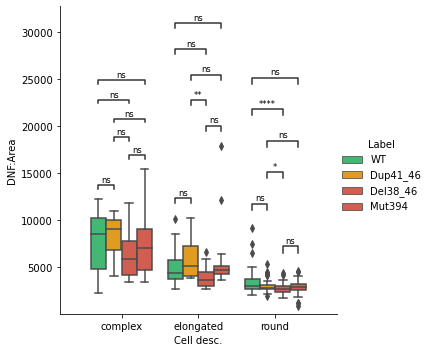

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.042e-01 stat=-8.426e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.204e-01 stat=-6.489e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=5.149e-02 stat=2.050e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.030e-01 stat=1.044e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.904e-01 stat=1.331e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.057e-01 stat=5.192e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=8.647e-02 stat=-1.779e+0

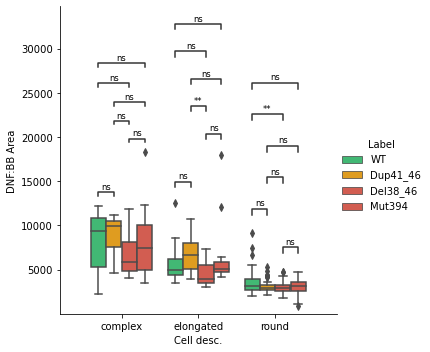

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.561e-01 stat=-7.523e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=9.470e-01 stat=6.696e-02
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.205e-02 stat=2.448e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.562e-01 stat=1.447e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.730e-02 stat=2.152e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=8.833e-02 stat=1.735e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.021e-01 stat=-1.693e+00

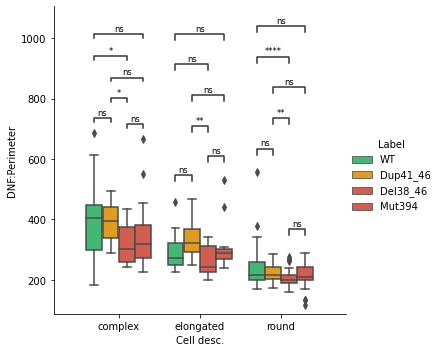

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=3.045e-02 stat=-2.240e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=6.155e-01 stat=-5.066e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.031e-02 stat=2.485e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=8.483e-01 stat=1.926e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.021e-02 stat=2.245e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=7.255e-01 stat=-3.529e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.857e-01 stat=2.746e-0

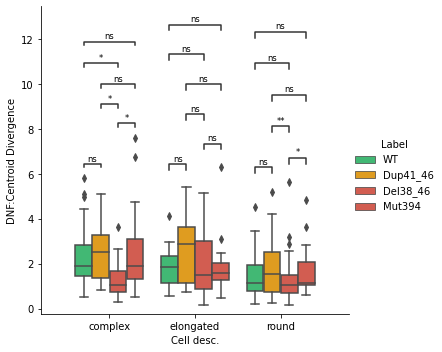

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.627e-01 stat=-7.412e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.789e-01 stat=-7.153e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=7.650e-02 stat=1.851e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.998e-01 stat=1.305e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.505e-01 stat=1.166e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=5.490e-01 stat=6.030e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=4.120e-02 stat=-2.144e+0

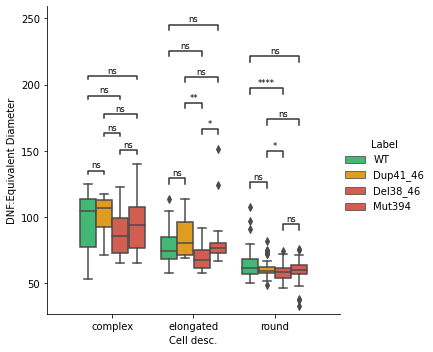

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=5.150e-01 stat=-6.567e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.286e-01 stat=-2.180e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.055e-02 stat=1.763e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.607e-01 stat=1.142e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.659e-01 stat=1.411e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.120e-01 stat=1.020e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=4.584e-02 stat=-2.093e+0

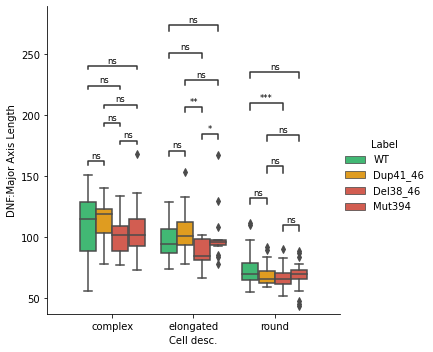

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=5.091e-01 stat=-6.659e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.135e-01 stat=-1.022e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.222e-01 stat=1.602e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.035e-01 stat=1.294e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=4.099e-01 stat=8.325e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=7.985e-01 stat=2.566e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.935e-02 stat=-1.969e+0

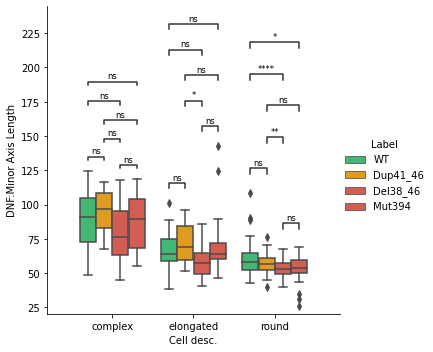

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=7.706e-01 stat=2.935e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=1.456e-01 stat=1.487e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=4.296e-01 stat=-8.034e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.623e-01 stat=-7.425e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=6.300e-01 stat=4.854e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.166e-01 stat=1.011e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.057e-01 stat=1.297e+00

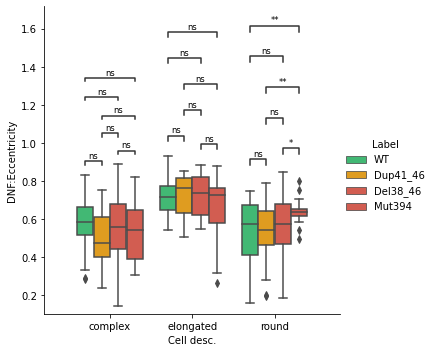

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=8.854e-01 stat=-1.450e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.685e-01 stat=-9.104e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.628e-01 stat=-1.440e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.363e-01 stat=-1.522e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=9.897e-03 stat=-2.705e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.864e-03 stat=-3.269e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=3.894e-01 stat=-8.74

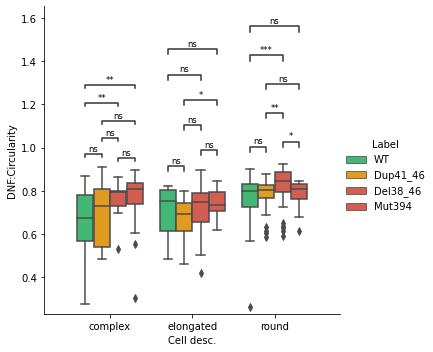

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=5.650e-01 stat=-5.800e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=1.550e-01 stat=-1.452e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=3.448e-01 stat=9.637e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.847e-01 stat=7.056e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=7.773e-01 stat=-2.847e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.722e-01 stat=-1.109e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=3.006e-01 stat=-1.056e

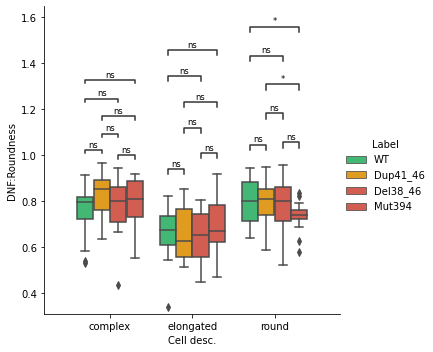

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=5.151e-01 stat=6.565e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.815e-01 stat=5.561e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=6.951e-01 stat=-3.967e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=9.077e-01 stat=1.167e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=8.793e-01 stat=1.528e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.511e-01 stat=9.405e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=4.492e-02 stat=-2.103e+00

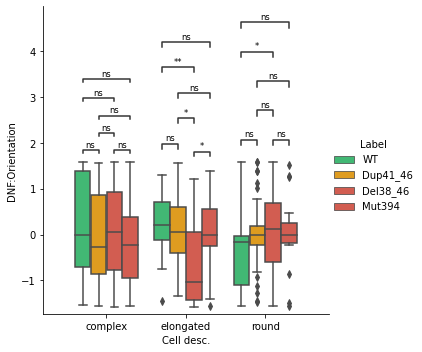

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=9.484e-01 stat=-6.513e-02
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.238e-01 stat=-8.088e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=8.478e-01 stat=-1.940e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=8.128e-01 stat=-2.385e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.430e-01 stat=-1.185e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.701e-01 stat=-1.390e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=3.077e-02 stat=-2.27

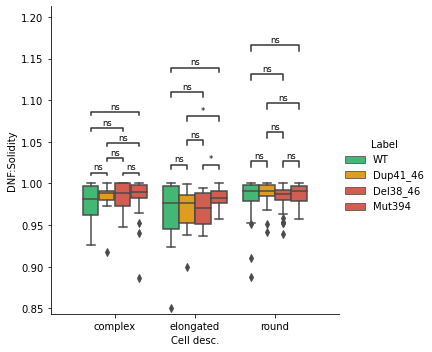

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=6.010e-01 stat=-5.270e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.352e-01 stat=6.259e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=3.502e-02 stat=2.235e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.700e-01 stat=1.399e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.370e-02 stat=2.349e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.228e-02 stat=2.352e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=3.205e-01 stat=1.012e+00


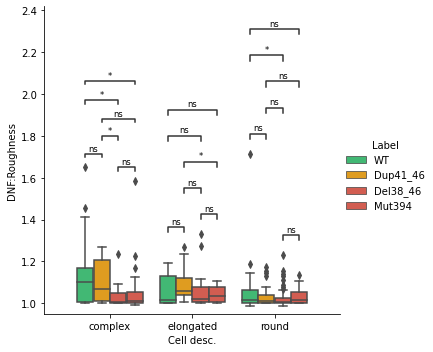

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.320e-01 stat=-1.536e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.769e-01 stat=8.944e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=4.192e-02 stat=2.149e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=9.820e-01 stat=2.271e-02
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=8.355e-03 stat=2.771e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.028e-01 stat=1.040e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.556e-02 stat=-2.364e+00

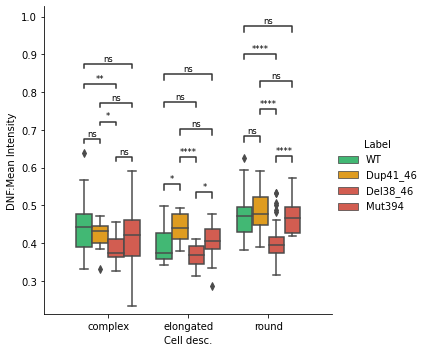

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=6.053e-02 stat=-1.929e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=7.600e-01 stat=-3.078e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.761e-04 stat=4.255e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.784e-02 stat=2.476e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=9.028e-04 stat=3.579e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.111e-02 stat=2.374e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=6.932e-02 stat=-1.892e+0

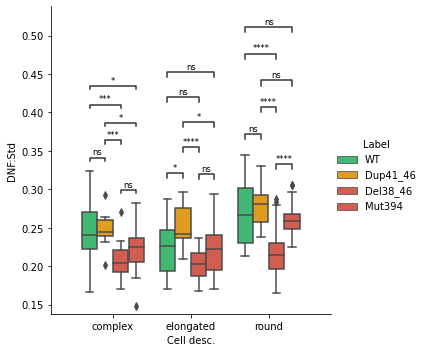

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=5.778e-02 stat=-1.951e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.612e-01 stat=-1.761e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=3.148e-04 stat=4.203e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.607e-02 stat=2.520e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.292e-03 stat=3.455e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.784e-02 stat=2.442e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=6.608e-02 stat=-1.915e+0

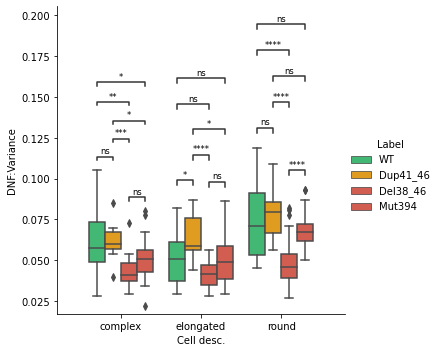

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.880e-01 stat=-1.076e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=2.005e-03 stat=-3.325e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.019e-01 stat=1.312e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=7.745e-01 stat=-2.886e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.013e-02 stat=-2.246e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.971e-03 stat=-3.007e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=6.231e-01 stat=4.972e

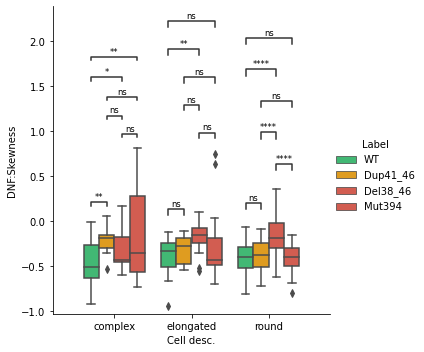

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=9.755e-01 stat=-3.087e-02
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.729e-01 stat=7.251e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.034e-03 stat=-2.841e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.843e-02 stat=-2.278e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.027e-01 stat=-1.669e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.932e-02 stat=-1.853e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=6.061e-01 stat=5.217e

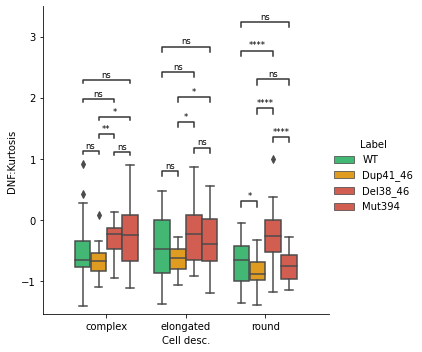

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=nan stat=nan
elongated_WT v.s. elongated_Dup41_46: t-test independent samples, P_val=nan stat=nan


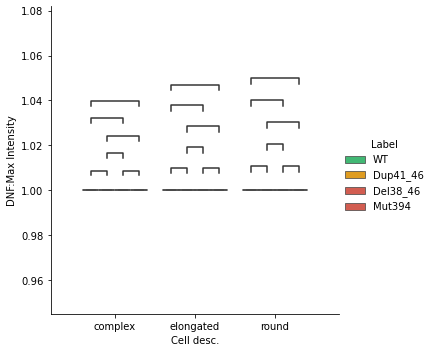

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=6.865e-01 stat=-4.064e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=1.405e-01 stat=1.506e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.242e-01 stat=-1.593e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.155e-01 stat=-1.017e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=8.673e-01 stat=-1.681e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=5.191e-01 stat=-6.489e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=9.614e-01 stat=4.880e

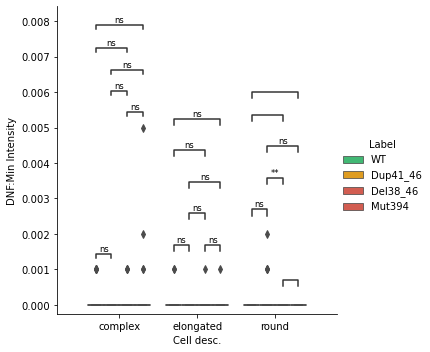

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=8.658e-02 stat=-1.755e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.557e-01 stat=-7.539e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.865e-01 stat=1.360e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=9.935e-01 stat=8.178e-03
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.228e-01 stat=1.001e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.341e-01 stat=-9.745e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=6.701e-03 stat=-2.937e+

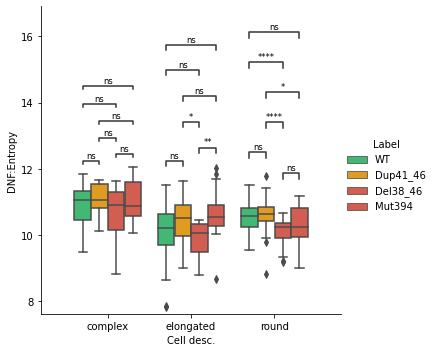

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.689e-01 stat=7.308e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=7.144e-01 stat=-3.688e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=7.487e-01 stat=3.240e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.288e-01 stat=1.223e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=9.004e-01 stat=1.259e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.161e-01 stat=1.251e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.178e-01 stat=1.616e+00


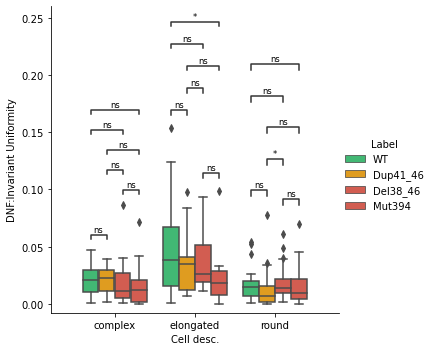

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=9.095e-02 stat=-1.730e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.231e-01 stat=-1.001e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.535e-03 stat=2.817e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.464e-01 stat=7.694e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.314e-01 stat=1.539e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=7.997e-01 stat=-2.550e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=3.672e-02 stat=-2.198e+

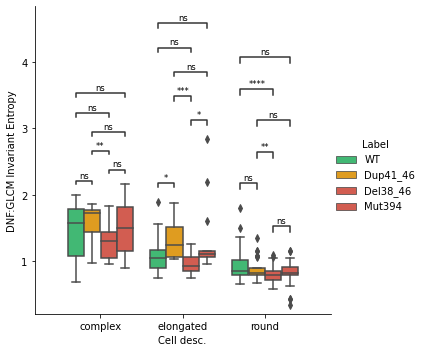

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.544e-01 stat=1.450e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=1.299e-01 stat=1.549e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.766e-01 stat=1.392e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.506e-01 stat=1.467e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.681e-03 stat=3.196e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=8.721e-03 stat=2.720e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.384e-01 stat=1.206e+00
e

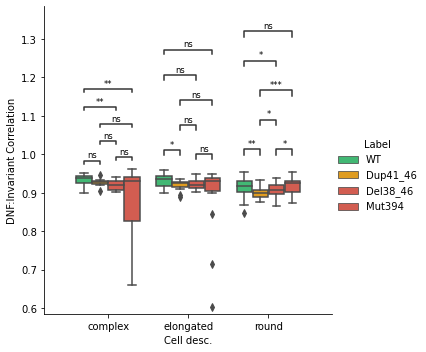

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=3.520e-02 stat=-2.176e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=1.782e-01 stat=-1.372e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=8.207e-03 stat=2.882e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.655e-01 stat=-7.373e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.443e-01 stat=1.488e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=5.133e-02 stat=-1.992e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=6.608e-02 stat=-1.915e

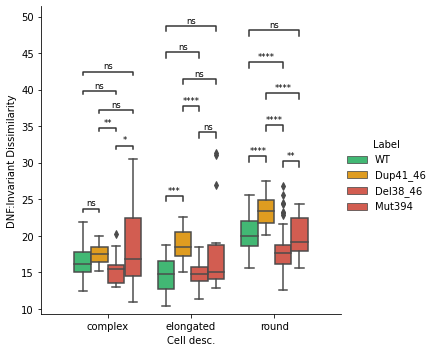

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.395e-02 stat=-2.077e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=1.283e-01 stat=-1.556e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.489e-02 stat=2.624e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.665e-01 stat=-9.140e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.708e-01 stat=1.116e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.989e-02 stat=-2.229e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=9.768e-02 stat=-1.716e

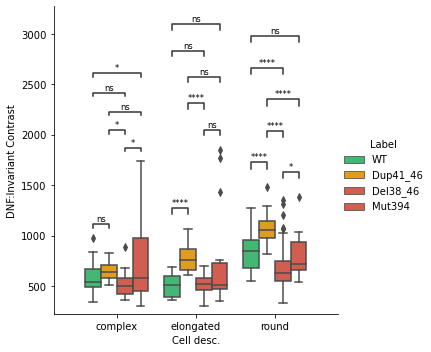

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.441e-01 stat=1.488e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.779e-01 stat=-5.614e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=6.247e-01 stat=4.956e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=7.517e-02 stat=1.830e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=9.627e-01 stat=4.702e-02
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.889e-02 stat=2.014e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=3.408e-02 stat=2.232e+00


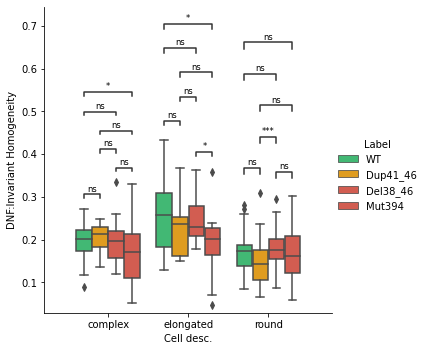

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.417e-01 stat=7.767e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.827e-01 stat=-5.543e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=4.102e-01 stat=8.381e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=9.679e-02 stat=1.703e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=6.066e-01 stat=5.189e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.026e-01 stat=1.660e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=4.330e-02 stat=2.120e+00


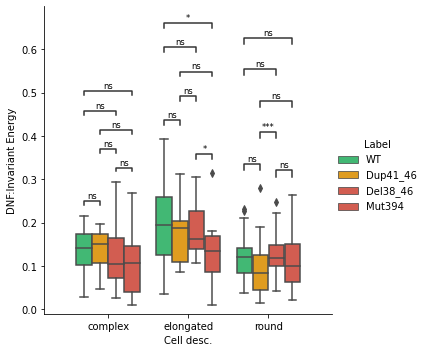

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=8.477e-01 stat=1.932e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=9.790e-01 stat=2.651e-02
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=4.149e-03 stat=-3.168e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.396e-01 stat=-1.509e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.867e-04 stat=-3.966e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.503e-02 stat=-2.304e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=9.830e-01 stat=2.151e-

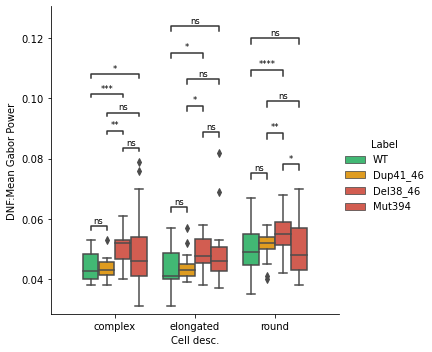

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=nan stat=nan
elongated_WT v.s. elongated_Dup41_46: t-test independent samples, P_val=nan stat=nan


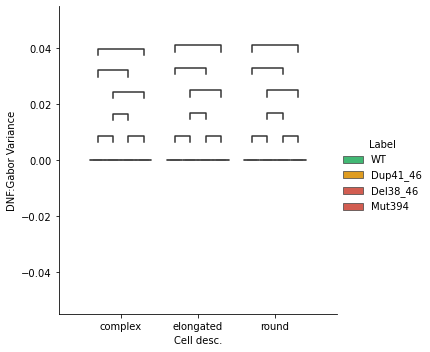

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.635e-01 stat=-1.418e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=2.056e-01 stat=1.288e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.781e-01 stat=1.387e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=8.216e-01 stat=2.271e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.102e-03 stat=3.284e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.571e-02 stat=2.044e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=3.839e-02 stat=-2.177e+00

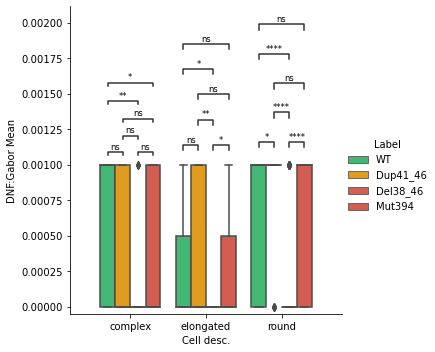

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=nan stat=nan
elongated_WT v.s. elongated_Dup41_46: t-test independent samples, P_val=nan stat=nan


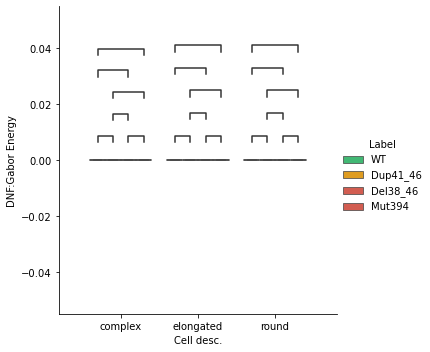

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.896e-01 stat=-6.970e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.744e-01 stat=-7.227e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=7.812e-02 stat=1.840e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.987e-01 stat=1.308e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.266e-01 stat=9.928e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.238e-01 stat=4.932e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=3.200e-02 stat=-2.261e+0

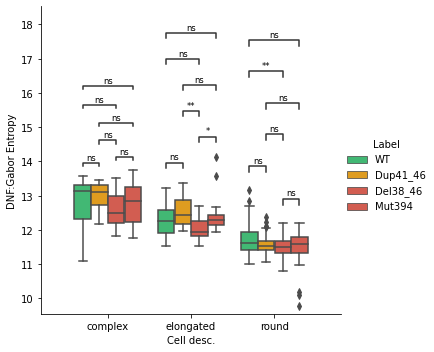

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=8.222e-02 stat=-1.781e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.387e-03 stat=-3.132e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.431e-04 stat=4.513e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.530e-01 stat=9.403e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.695e-01 stat=9.074e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.507e-01 stat=-1.457e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.647e-02 stat=-2.348e+

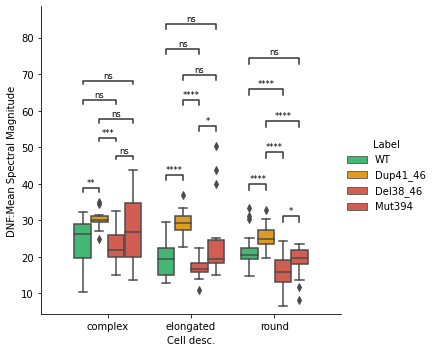

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.132e-01 stat=-1.618e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=2.796e-01 stat=-1.097e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.609e-01 stat=-1.151e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.227e-01 stat=-1.579e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.590e-02 stat=-2.312e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.508e-03 stat=-2.829e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.660e-01 stat=-1.42

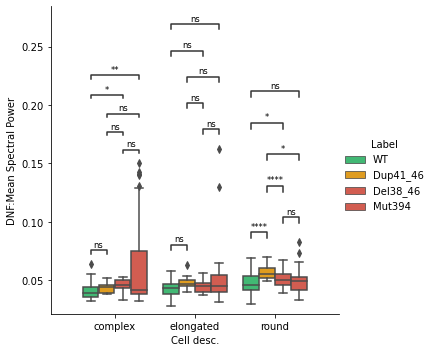

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.047e-02 stat=-2.114e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=6.818e-01 stat=-4.133e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.935e-03 stat=3.311e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.082e-01 stat=8.363e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.998e-03 stat=3.050e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=5.265e-01 stat=6.375e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.043e-02 stat=-2.753e+0

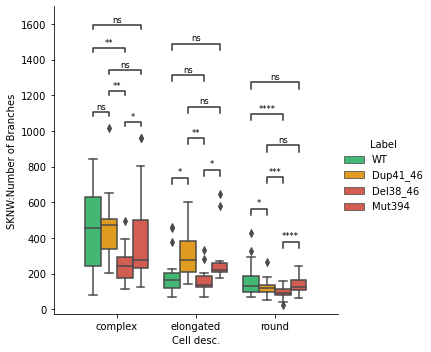

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=5.577e-02 stat=1.967e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.674e-01 stat=5.770e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.556e-01 stat=5.625e-02
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=7.553e-02 stat=1.827e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=4.783e-01 stat=7.156e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.436e-03 stat=2.833e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.758e-02 stat=1.983e+00
e

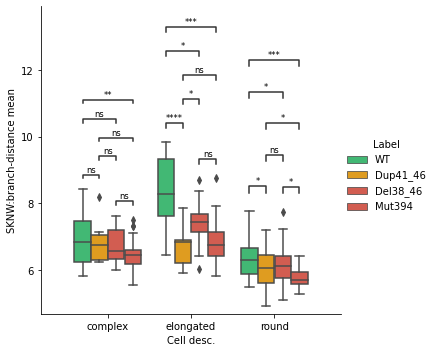

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=5.554e-04 stat=3.737e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=9.482e-01 stat=-6.542e-02
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=5.320e-01 stat=6.341e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.524e-04 stat=4.206e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=6.077e-01 stat=5.173e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.225e-05 stat=4.337e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.038e-02 stat=1.884e+00


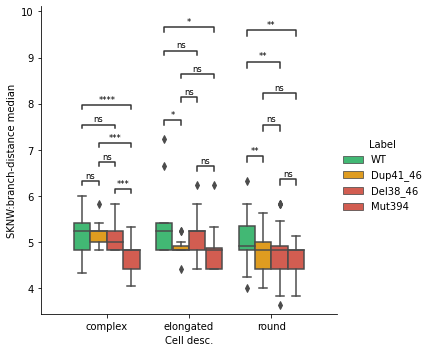

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=3.092e-01 stat=1.036e+00
elongated_WT v.s. elongated_Dup41_46: t-test independent samples, P_val=n

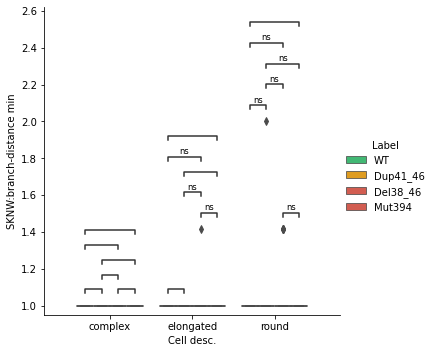

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=5.365e-01 stat=-6.232e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=2.785e-01 stat=1.100e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=7.102e-01 stat=3.760e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=8.355e-01 stat=-2.091e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.310e-01 stat=1.541e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.413e-01 stat=1.184e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.464e-01 stat=6.109e-01

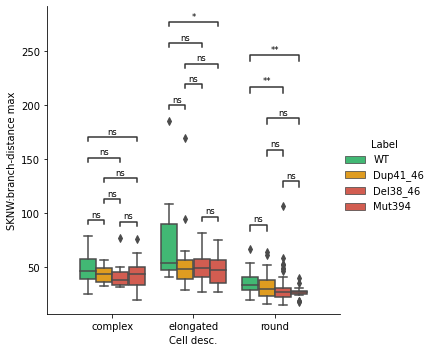

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.761e-01 stat=-7.190e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=2.796e-01 stat=1.097e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=7.024e-01 stat=3.867e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=7.693e-01 stat=-2.954e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.302e-01 stat=1.544e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.887e-01 stat=1.071e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=6.025e-01 stat=5.270e-01

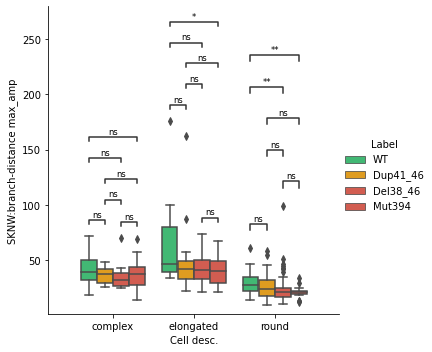

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=9.209e-01 stat=9.988e-02
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.684e-01 stat=9.106e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.176e-01 stat=-1.046e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=9.825e-01 stat=-2.214e-02
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.444e-01 stat=9.565e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.260e-01 stat=1.225e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.961e-01 stat=1.325e+00

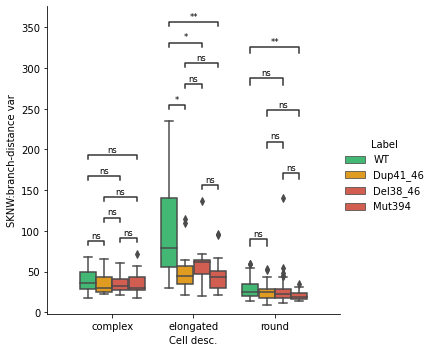

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=8.366e-01 stat=2.075e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.685e-01 stat=9.104e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=8.594e-01 stat=-1.791e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=9.969e-01 stat=-3.887e-03
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.905e-01 stat=8.679e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.234e-01 stat=1.231e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.673e-01 stat=1.419e+00

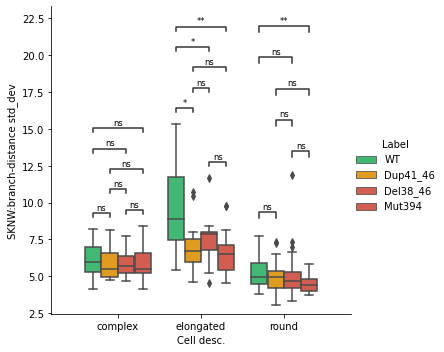

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=3.671e-01 stat=9.118e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.346e-01 stat=6.268e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=8.769e-01 stat=-1.566e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.699e-01 stat=5.732e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.545e-01 stat=5.959e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.138e-01 stat=1.607e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.655e-01 stat=1.425e+00


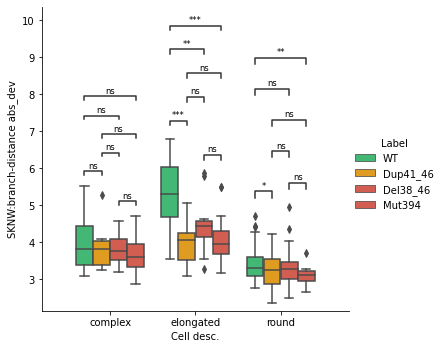

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=3.090e-01 stat=-1.030e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=1.946e-01 stat=1.321e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.002e-01 stat=-1.268e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.122e-01 stat=-1.024e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.687e-01 stat=1.401e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=5.277e-01 stat=6.356e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=4.977e-01 stat=6.874e-0

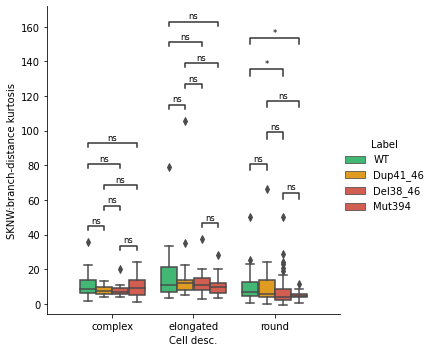

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=3.744e-01 stat=-8.979e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=2.250e-01 stat=1.234e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=8.869e-01 stat=-1.438e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.633e-01 stat=-9.201e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.091e-01 stat=1.276e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=5.855e-01 stat=5.486e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=4.347e-01 stat=7.930e-0

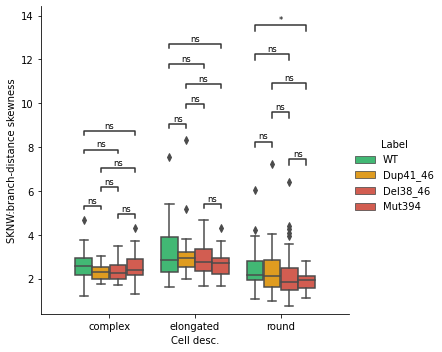

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.016e-02 stat=-2.415e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.968e-01 stat=-1.306e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=5.659e-04 stat=3.972e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.334e-01 stat=9.798e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.154e-03 stat=3.495e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.887e-01 stat=1.071e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=4.908e-01 stat=-6.986e-0

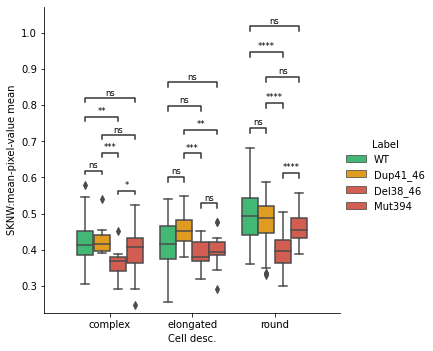

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.475e-02 stat=-2.543e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.061e-01 stat=-2.473e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.030e-04 stat=4.643e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.093e-01 stat=1.030e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=6.405e-04 stat=3.697e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.165e-01 stat=1.011e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=4.122e-01 stat=-8.330e-0

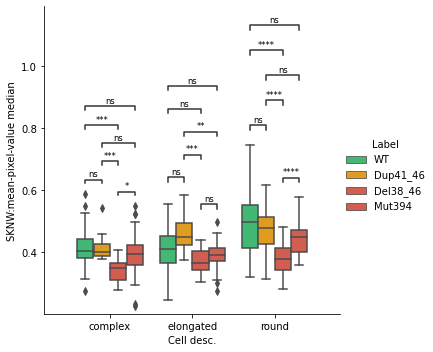

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.170e-01 stat=1.601e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.222e-01 stat=2.263e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.939e-01 stat=-1.073e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=7.755e-01 stat=2.873e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.392e-01 stat=-9.669e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.979e-01 stat=6.824e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.476e-02 stat=2.378e+00

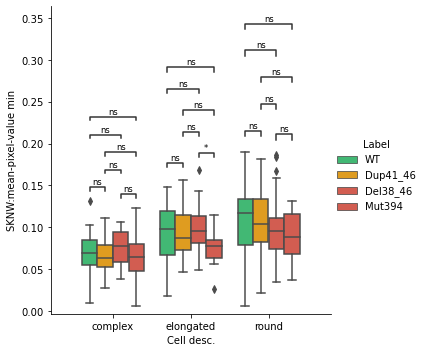

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=3.358e-03 stat=-3.110e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=9.706e-01 stat=3.709e-02
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=3.297e-02 stat=2.263e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=7.601e-01 stat=-3.076e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.351e-02 stat=2.582e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=7.799e-01 stat=-2.808e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=3.429e-01 stat=-9.654e-

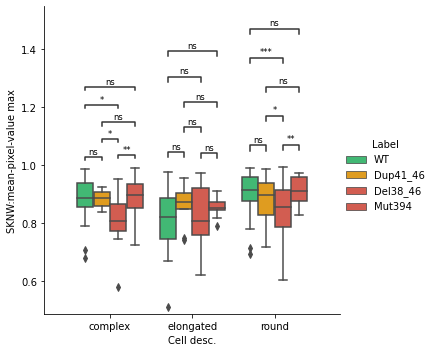

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=7.946e-02 stat=-1.797e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=9.934e-01 stat=-8.279e-03
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=7.063e-01 stat=3.813e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.433e-01 stat=-1.495e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=6.483e-01 stat=4.595e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.251e-02 stat=-1.901e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.593e-01 stat=-5.912e

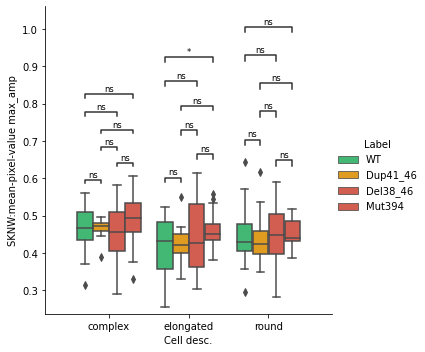

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.159e-02 stat=-2.387e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=2.667e-01 stat=1.128e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=4.566e-01 stat=7.567e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=9.951e-02 stat=-1.688e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=7.069e-02 stat=1.856e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=5.128e-01 stat=-6.588e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=4.631e-01 stat=-7.444e-

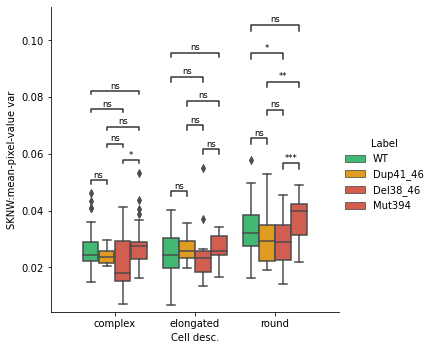

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.061e-02 stat=-2.675e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.117e-01 stat=1.026e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=3.073e-01 stat=1.043e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.054e-01 stat=-1.659e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=4.129e-02 stat=2.107e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.808e-01 stat=-7.099e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=3.202e-01 stat=-1.013e+

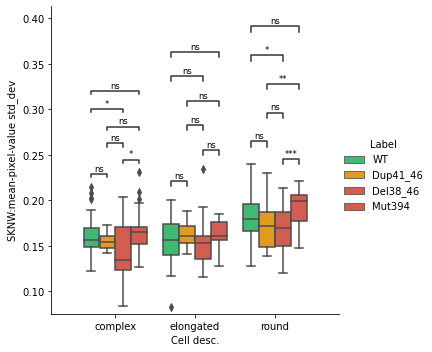

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.403e-02 stat=-2.564e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.706e-01 stat=9.063e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.998e-01 stat=1.318e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.327e-01 stat=-1.213e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.753e-02 stat=2.285e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.898e-01 stat=-4.013e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.246e-01 stat=-1.585e+

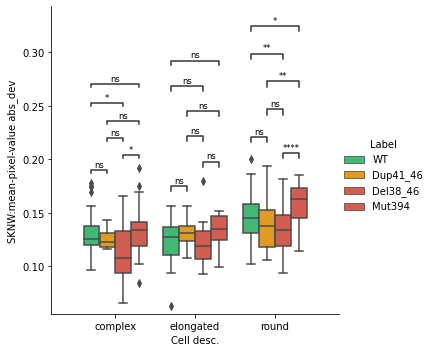

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.078e-01 stat=8.362e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.615e-01 stat=1.757e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.306e-01 stat=-1.565e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.566e-01 stat=-9.333e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.703e-02 stat=-2.156e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.149e-01 stat=-1.255e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.701e-01 stat=1.410e+

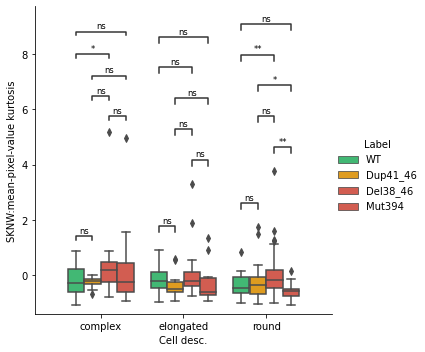

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.078e-01 stat=1.279e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=7.213e-01 stat=3.595e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.947e-02 stat=-2.504e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.043e-01 stat=-8.434e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.605e-03 stat=-2.924e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.487e-01 stat=-9.452e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.250e-01 stat=1.242e+

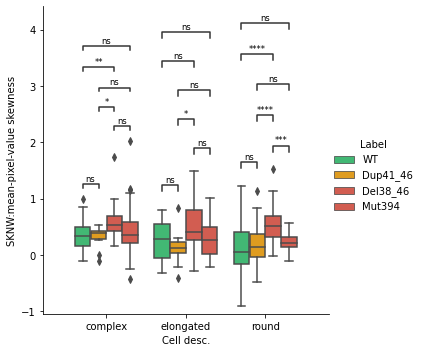

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=9.327e-01 stat=8.492e-02
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.440e-04 stat=-3.856e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.648e-01 stat=1.433e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.290e-01 stat=1.552e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=4.003e-01 stat=-8.500e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.349e-01 stat=-7.867e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.745e-01 stat=2.894e-0

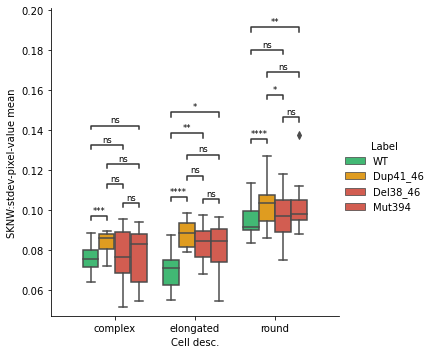

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=8.586e-01 stat=-1.793e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=1.215e-04 stat=-4.294e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=5.861e-02 stat=1.986e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=6.345e-02 stat=1.912e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=7.686e-01 stat=-2.961e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=5.509e-01 stat=-6.001e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=9.211e-01 stat=9.993e-

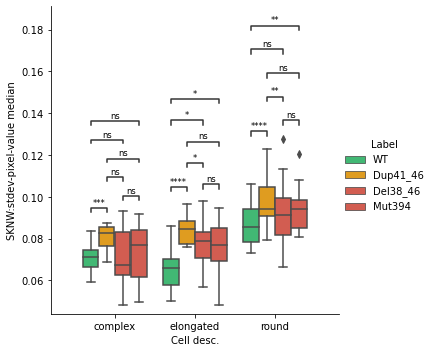

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=6.932e-01 stat=-3.972e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.057e-01 stat=-2.477e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=6.580e-01 stat=4.482e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=9.929e-01 stat=-9.017e-03
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=8.740e-01 stat=1.595e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=7.690e-01 stat=-2.951e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=3.568e-01 stat=9.375e-

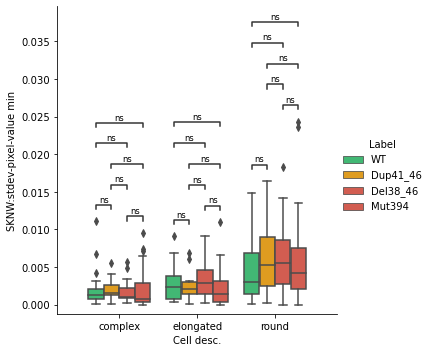

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=3.253e-01 stat=9.953e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.939e-01 stat=-6.909e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=5.765e-01 stat=5.663e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.018e-01 stat=1.299e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=7.960e-01 stat=-2.602e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.351e-01 stat=7.862e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.904e-01 stat=-5.447e-0

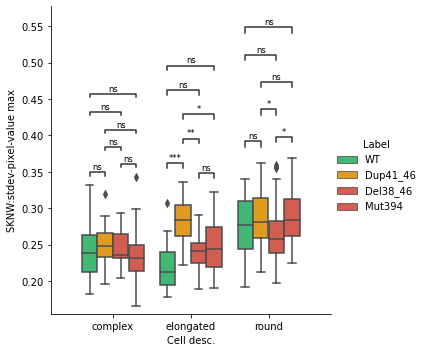

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.739e-01 stat=1.109e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=9.473e-01 stat=-6.655e-02
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.658e-01 stat=4.330e-02
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.461e-01 stat=9.541e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=9.699e-01 stat=-3.793e-02
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.748e-01 stat=1.103e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=4.751e-01 stat=-7.244e-0

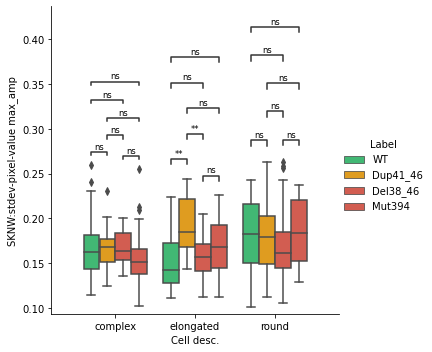

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.669e-01 stat=1.125e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=6.099e-01 stat=-5.147e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.855e-01 stat=-1.092e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=9.007e-01 stat=-1.256e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=7.124e-02 stat=-1.852e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.788e-01 stat=-7.131e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.264e-01 stat=1.238e

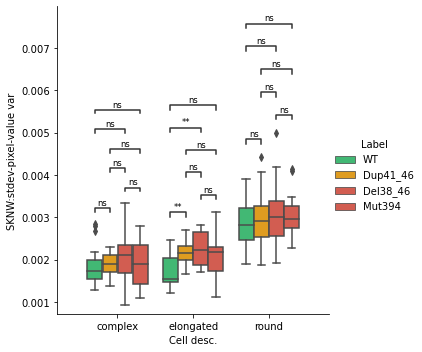

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.915e-01 stat=1.068e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.436e-01 stat=-6.130e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=3.608e-01 stat=-9.316e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=9.666e-01 stat=4.221e-02
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=9.084e-02 stat=-1.732e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=5.676e-01 stat=-5.751e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.085e-01 stat=1.288e+

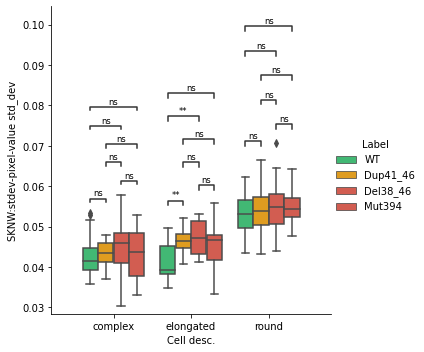

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.932e-01 stat=6.913e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.411e-01 stat=-6.169e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=6.187e-01 stat=-5.042e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=8.882e-01 stat=1.415e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.476e-01 stat=-1.173e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.548e-01 stat=-4.495e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.361e-01 stat=1.212e+

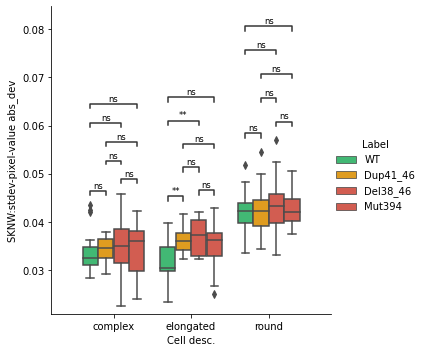

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.487e-01 stat=1.471e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.831e-01 stat=7.084e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.334e-01 stat=-1.553e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.330e-01 stat=-6.291e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.215e-01 stat=-1.581e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=9.725e-01 stat=-3.467e-02
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=4.499e-01 stat=-7.666e

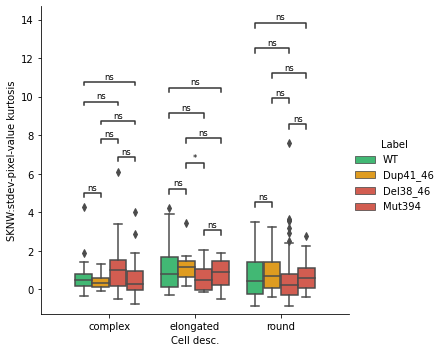

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.165e-01 stat=1.603e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=6.819e-02 stat=1.879e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.770e-02 stat=-2.547e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.688e-01 stat=-1.403e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.905e-02 stat=-2.132e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=8.179e-01 stat=-2.314e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=8.184e-01 stat=2.319e-

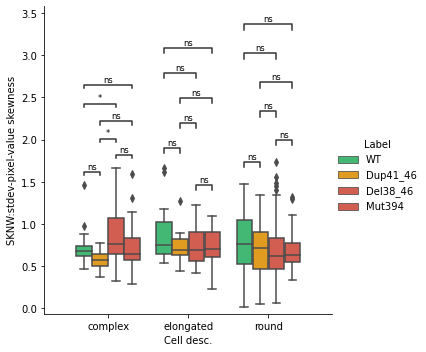

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=7.265e-02 stat=1.841e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.640e-01 stat=5.821e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=8.473e-01 stat=1.947e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=6.079e-02 stat=1.932e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=4.003e-01 stat=8.499e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.680e-03 stat=2.949e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.362e-02 stat=1.861e+00
e

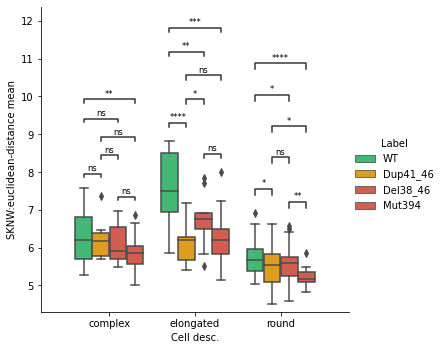

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.607e-03 stat=3.373e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.432e-01 stat=-6.137e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.633e-01 stat=1.438e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.375e-05 stat=4.616e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.865e-01 stat=5.482e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.945e-04 stat=3.994e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.061e-01 stat=1.672e+00


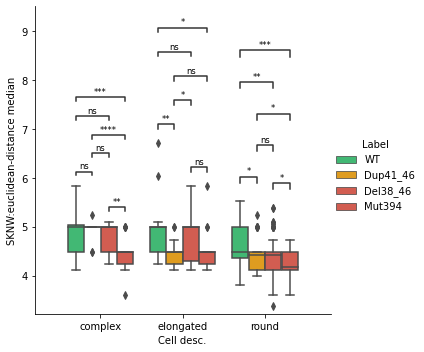

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.681e-01 stat=-1.403e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.250e-01 stat=6.418e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.739e-01 stat=-3.307e-02
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.898e-01 stat=-1.335e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.101e-01 stat=6.644e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.234e-01 stat=-8.066e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.506e-01 stat=1.174e+

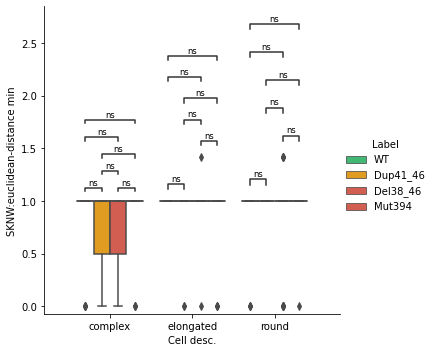

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.361e-01 stat=-1.202e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.495e-01 stat=7.644e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=3.922e-01 stat=8.713e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=7.834e-01 stat=-2.768e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=9.343e-02 stat=1.717e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=5.501e-01 stat=6.014e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.765e-01 stat=5.653e-01

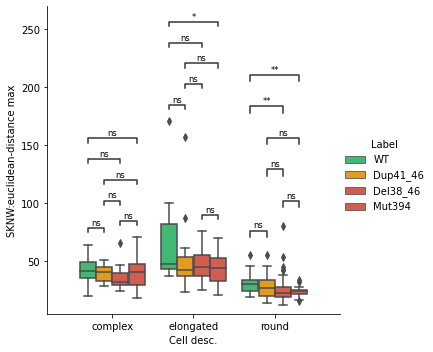

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.992e-01 stat=-1.304e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.577e-01 stat=7.505e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=3.812e-01 stat=8.922e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=7.162e-01 stat=-3.663e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=9.361e-02 stat=1.717e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.437e-01 stat=4.651e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=6.290e-01 stat=4.887e-01

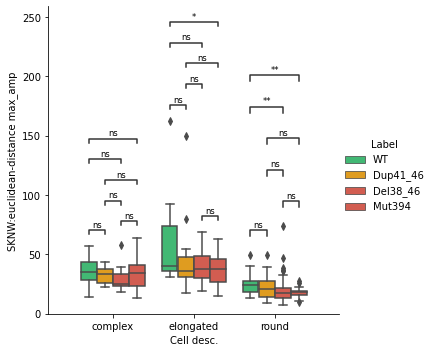

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=9.641e-01 stat=-4.529e-02
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.528e-01 stat=7.588e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=8.773e-01 stat=1.560e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=9.058e-01 stat=1.191e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.944e-01 stat=1.062e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.464e-01 stat=1.172e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.374e-01 stat=1.208e+00


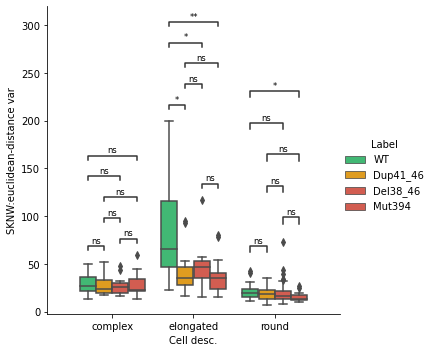

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=9.575e-01 stat=5.365e-02
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.541e-01 stat=7.566e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.033e-01 stat=1.228e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=8.661e-01 stat=1.698e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.148e-01 stat=1.018e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.256e-01 stat=1.225e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.046e-01 stat=1.300e+00
e

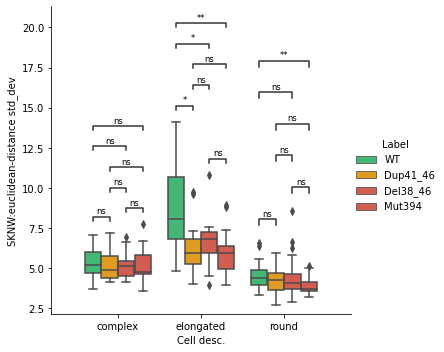

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=3.606e-01 stat=9.243e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.328e-01 stat=6.297e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.350e-01 stat=-8.241e-02
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.985e-01 stat=6.834e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.105e-01 stat=6.639e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=9.022e-02 stat=1.725e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.031e-01 stat=1.305e+00


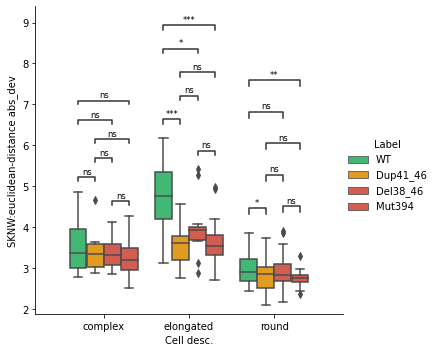

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=8.426e-02 stat=-1.768e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=2.959e-01 stat=1.060e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=4.462e-01 stat=7.744e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.096e-01 stat=-1.030e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=7.143e-02 stat=1.851e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=9.364e-01 stat=-8.018e-02
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=4.683e-01 stat=7.356e-0

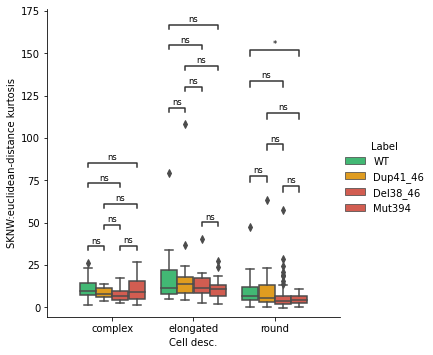

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.261e-01 stat=-1.561e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.675e-01 stat=9.124e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=5.045e-01 stat=6.776e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.248e-01 stat=-8.068e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=9.448e-02 stat=1.712e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=9.485e-01 stat=6.485e-02
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=4.391e-01 stat=7.854e-01

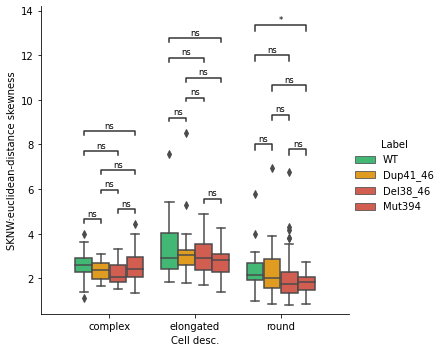

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.254e-01 stat=-1.564e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=2.580e-01 stat=1.149e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=8.668e-01 stat=-1.695e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.506e-01 stat=-1.467e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.761e-01 stat=1.104e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.342e-01 stat=-9.742e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.220e-01 stat=-1.597e

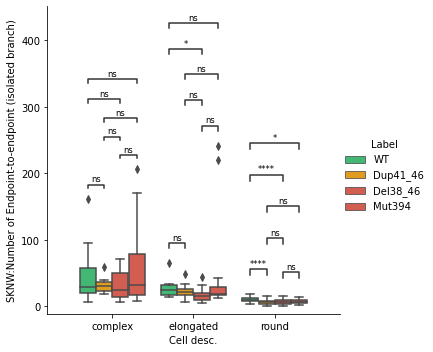

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.532e-01 stat=-7.572e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=1.055e-01 stat=1.659e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.321e-02 stat=-2.425e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.615e-02 stat=-1.970e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.584e-01 stat=-9.288e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=9.624e-02 stat=-1.692e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.614e-01 stat=-5.880

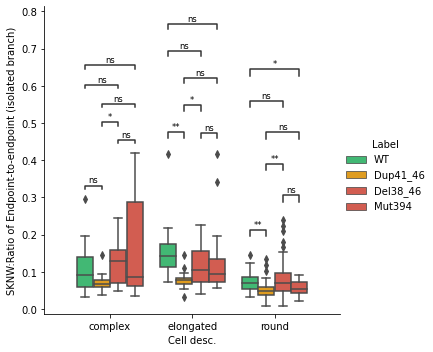

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=9.273e-01 stat=9.181e-02
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=2.571e-02 stat=2.324e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=8.965e-02 stat=-1.769e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.243e-01 stat=-1.572e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=4.414e-01 stat=7.774e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.220e-01 stat=9.993e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.538e-01 stat=3.168e-01

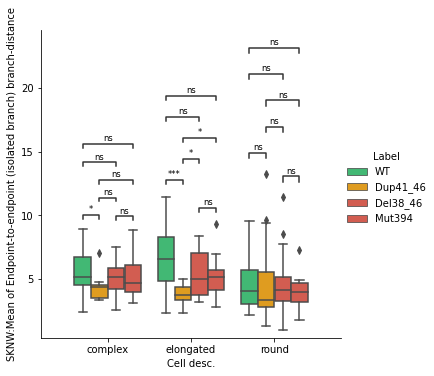

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.668e-01 stat=-1.125e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=1.562e-01 stat=1.447e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.080e-01 stat=-1.168e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.186e-01 stat=-1.011e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.032e-01 stat=1.666e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.902e-01 stat=6.946e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.010e-01 stat=-3.880e-

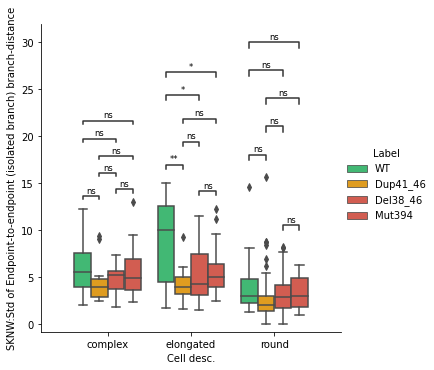

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=7.117e-04 stat=-3.654e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=9.990e-01 stat=-1.306e-03
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=6.833e-03 stat=2.959e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=6.464e-01 stat=-4.625e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.983e-04 stat=3.857e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.977e-01 stat=-6.827e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.081e-01 stat=-1.290e

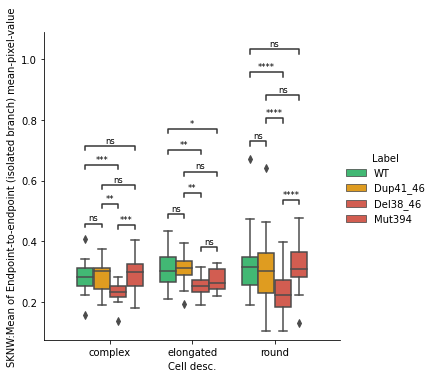

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.017e-06 stat=-5.716e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=6.335e-01 stat=4.807e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.576e-02 stat=2.599e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.034e-02 stat=-2.123e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.702e-03 stat=3.079e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=6.429e-02 stat=-1.888e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.709e-04 stat=-4.185e+

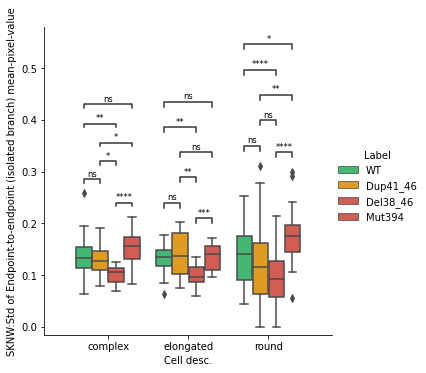

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=7.807e-02 stat=-1.806e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=7.648e-01 stat=-3.014e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.976e-01 stat=1.065e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.801e-01 stat=-7.132e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.866e-01 stat=8.751e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.197e-01 stat=-1.241e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.438e-01 stat=-6.149e

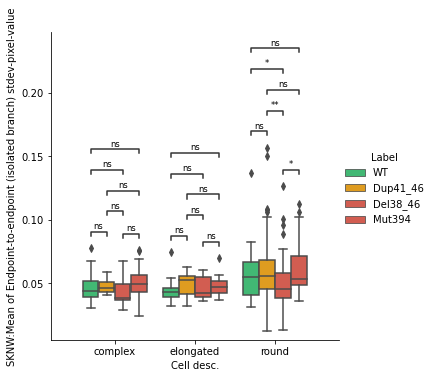

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.954e-01 stat=-1.059e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=1.504e-01 stat=1.468e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=7.378e-01 stat=-3.386e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.826e-01 stat=-1.357e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.142e-01 stat=1.019e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=8.097e-01 stat=-2.420e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=8.301e-01 stat=2.166e-

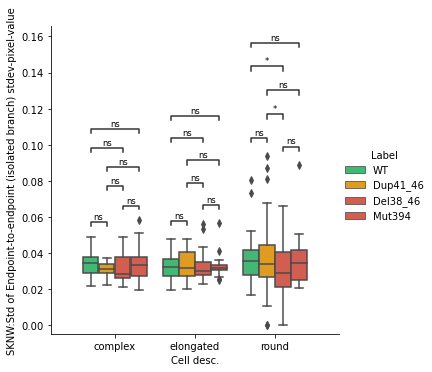

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=8.685e-01 stat=1.666e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=1.968e-02 stat=2.438e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=8.137e-02 stat=-1.819e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.345e-01 stat=-1.529e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.777e-01 stat=8.919e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.309e-01 stat=1.211e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.037e-01 stat=3.843e-01

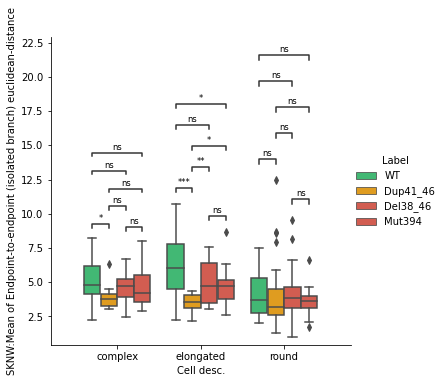

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.536e-01 stat=-1.158e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=1.133e-01 stat=1.622e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=8.755e-01 stat=-1.583e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.980e-01 stat=-1.055e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=6.807e-02 stat=1.874e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.251e-01 stat=8.036e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.851e-01 stat=-2.754e-

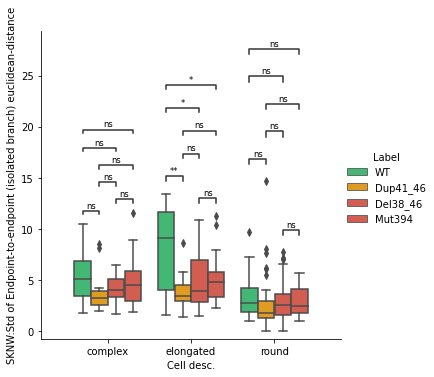

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=9.163e-02 stat=-1.726e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=6.123e-01 stat=-5.112e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.206e-02 stat=2.716e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.852e-01 stat=5.505e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.639e-02 stat=2.503e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=8.333e-01 stat=2.115e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.394e-02 stat=-2.630e+0

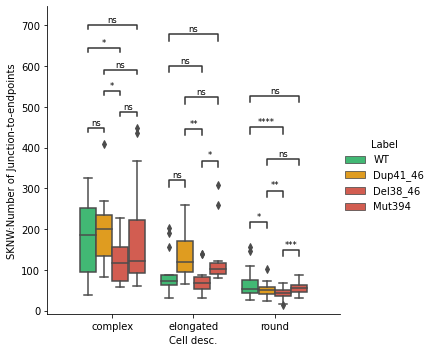

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=6.713e-03 stat=2.852e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=6.952e-01 stat=3.949e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=4.083e-03 stat=-3.175e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.675e-01 stat=-1.407e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.018e-03 stat=-2.966e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.656e-01 stat=-9.124e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.366e-01 stat=6.260e-

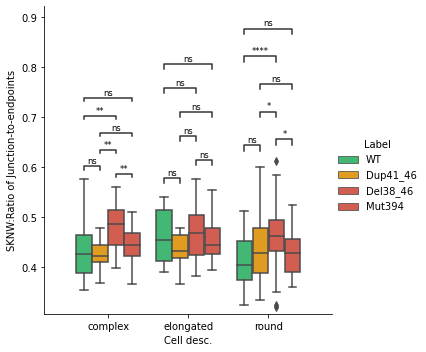

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.877e-01 stat=1.339e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.591e-02 stat=1.764e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.460e-01 stat=-1.502e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=7.491e-01 stat=-3.221e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=6.234e-01 stat=4.947e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=5.028e-02 stat=2.002e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.793e-01 stat=1.379e+00

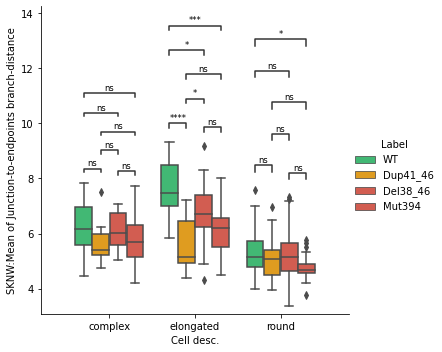

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=7.844e-01 stat=2.753e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=1.129e-01 stat=1.624e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=4.127e-01 stat=-8.336e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=6.288e-01 stat=-4.874e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.648e-01 stat=1.131e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.490e-01 stat=1.464e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.603e-01 stat=1.444e+00

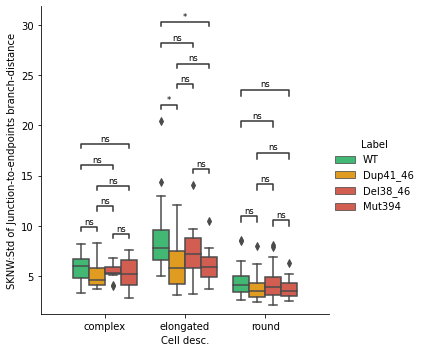

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.664e-03 stat=-3.361e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=6.934e-01 stat=3.974e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=8.069e-04 stat=3.831e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=8.093e-01 stat=2.430e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.588e-04 stat=3.743e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.169e-01 stat=8.179e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.723e-01 stat=-5.716e-01

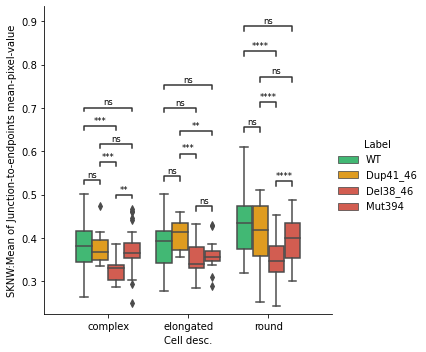

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.280e-05 stat=-4.764e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=2.907e-01 stat=1.072e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.771e-02 stat=2.344e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.565e-02 stat=-2.323e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.472e-03 stat=3.410e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.567e-01 stat=-1.436e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.318e-01 stat=-1.554e+

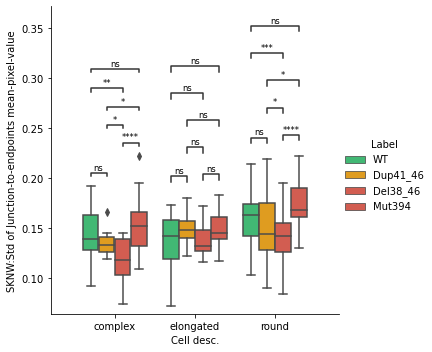

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=8.515e-01 stat=-1.883e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=1.598e-02 stat=-2.525e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.193e-01 stat=1.615e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.841e-01 stat=1.353e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=9.751e-01 stat=-3.145e-02
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=7.649e-01 stat=-3.005e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.798e-01 stat=5.604e-

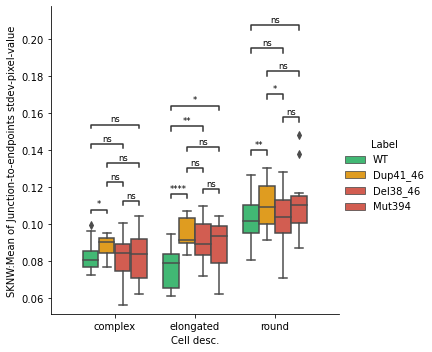

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=8.341e-01 stat=2.107e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.605e-01 stat=-9.259e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=7.257e-01 stat=3.550e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.985e-01 stat=5.309e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=6.214e-01 stat=-4.977e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=7.964e-01 stat=-2.593e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.622e-01 stat=3.057e-0

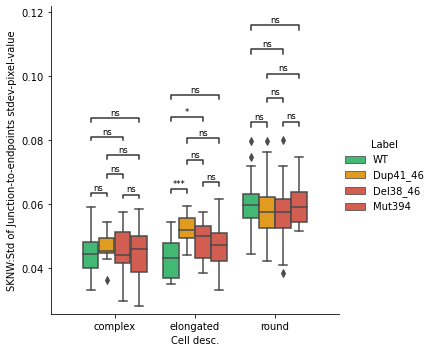

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.676e-01 stat=1.404e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=9.119e-02 stat=1.734e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.718e-01 stat=-1.409e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=8.176e-01 stat=-2.323e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=6.245e-01 stat=4.932e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.039e-02 stat=2.099e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.122e-01 stat=1.278e+00

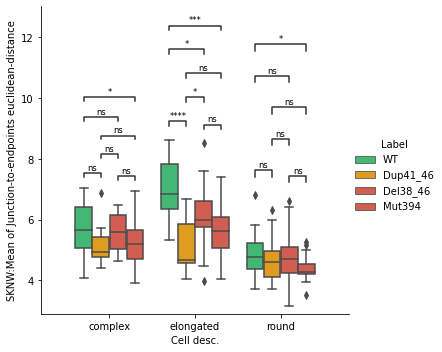

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=8.154e-01 stat=2.350e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=1.332e-01 stat=1.535e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=5.403e-01 stat=-6.213e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=7.111e-01 stat=-3.732e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.418e-01 stat=1.188e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.351e-01 stat=1.517e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.044e-01 stat=1.300e+00

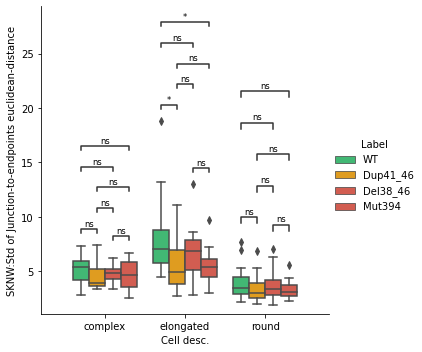

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=5.256e-02 stat=-1.995e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.195e-01 stat=-6.503e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=3.879e-04 stat=4.121e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=9.976e-02 stat=1.687e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.612e-03 stat=3.378e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.716e-01 stat=1.385e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.085e-02 stat=-2.736e+0

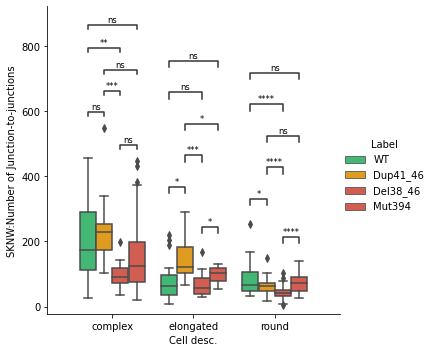

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=7.495e-01 stat=-3.214e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=2.045e-01 stat=-1.292e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.665e-03 stat=3.541e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.618e-02 stat=1.970e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.443e-02 stat=2.337e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.069e-01 stat=1.639e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=8.481e-01 stat=1.934e-01

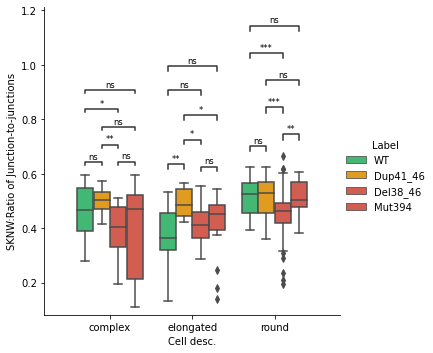

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.866e-01 stat=1.343e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.819e-01 stat=-7.104e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=7.206e-01 stat=3.619e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=7.631e-02 stat=1.822e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=7.446e-01 stat=-3.280e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.651e-01 stat=1.126e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=3.879e-01 stat=8.776e-01

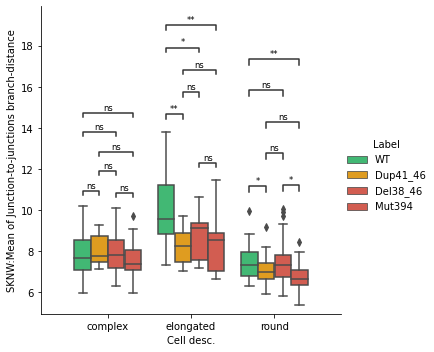

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=3.548e-01 stat=9.356e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=9.705e-01 stat=-3.719e-02
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=8.388e-01 stat=-2.056e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.670e-01 stat=7.347e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=7.725e-01 stat=-2.911e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.017e-01 stat=8.451e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.221e-01 stat=3.594e-0

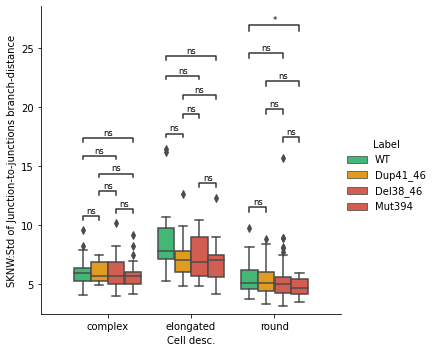

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=8.901e-02 stat=-1.741e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.043e-01 stat=2.495e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.408e-02 stat=2.408e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.040e-01 stat=8.439e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.138e-02 stat=2.650e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.968e-01 stat=1.307e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.571e-01 stat=-5.946e-01

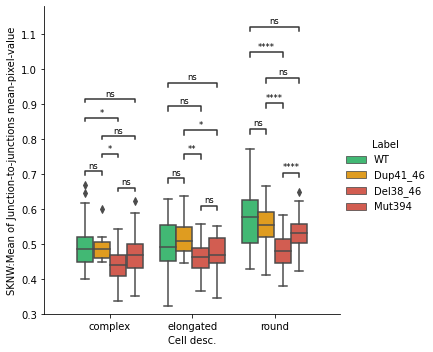

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=5.711e-02 stat=-1.956e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.621e-01 stat=9.229e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=5.676e-01 stat=5.796e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.557e-01 stat=-1.448e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.492e-01 stat=1.470e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.873e-01 stat=-8.715e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=6.759e-01 stat=-4.226e-

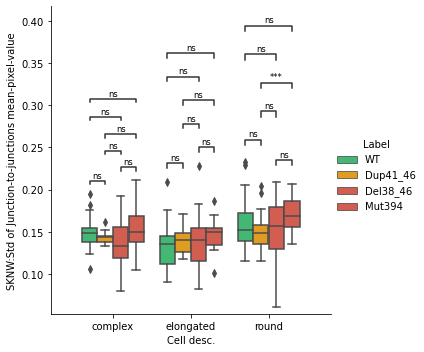

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.039e-01 stat=8.433e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=2.999e-04 stat=-3.990e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=6.026e-01 stat=5.277e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=1.230e-01 stat=1.577e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=6.438e-02 stat=-1.901e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.092e-01 stat=-1.026e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=9.005e-01 stat=1.263e-0

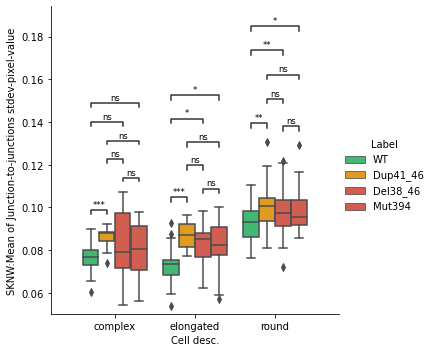

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.256e-01 stat=1.563e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=6.579e-01 stat=-4.464e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.597e-02 stat=-1.733e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.937e-01 stat=-5.380e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.366e-02 stat=-2.577e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.332e-01 stat=-1.205e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.137e-01 stat=1.635e

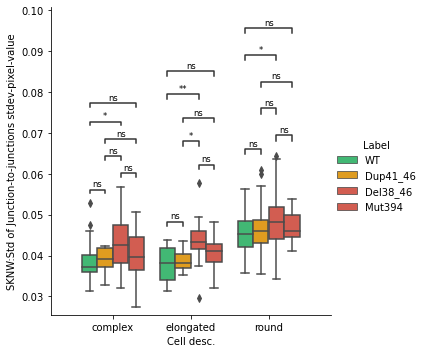

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.967e-01 stat=1.312e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.829e-01 stat=-7.087e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=6.397e-01 stat=4.741e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.796e-02 stat=1.955e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=8.442e-01 stat=-1.978e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.083e-01 stat=1.273e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=3.435e-01 stat=9.642e-01

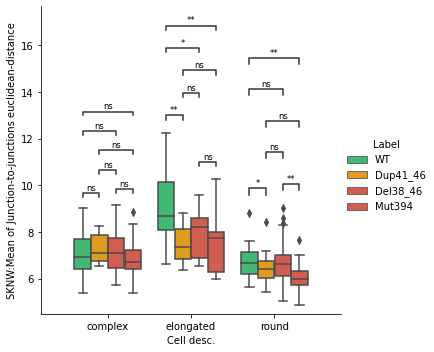

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.698e-01 stat=7.293e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.265e-01 stat=-2.208e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.727e-01 stat=3.457e-02
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.147e-01 stat=8.246e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=8.715e-01 stat=-1.628e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.513e-01 stat=7.586e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.082e-01 stat=3.782e-01

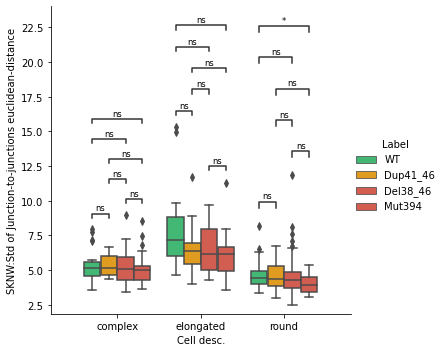

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=3.700e-01 stat=9.061e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.250e-01 stat=-6.418e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.739e-01 stat=3.307e-02
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.009e-01 stat=8.495e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.101e-01 stat=-6.644e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=7.143e-01 stat=3.680e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=3.332e-01 stat=-9.854e-0

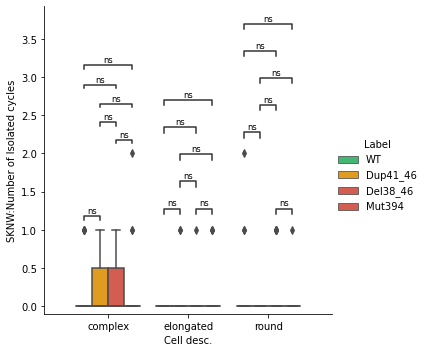

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.391e-02 stat=2.567e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.965e-01 stat=-8.578e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=3.477e-01 stat=-9.578e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=8.493e-02 stat=1.769e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=4.668e-02 stat=-2.051e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.101e-01 stat=1.025e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=6.756e-01 stat=-4.231e-

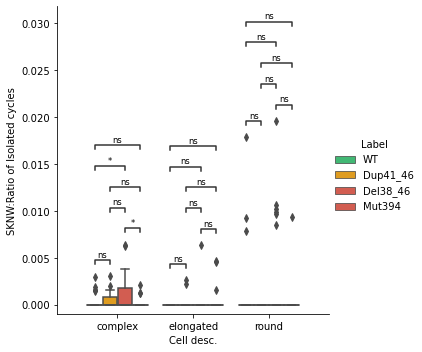

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.272e-01 stat=8.018e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=1.760e-01 stat=-1.380e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=5.839e-01 stat=-5.551e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=9.099e-01 stat=1.139e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.398e-01 stat=-1.506e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.936e-01 stat=-6.891e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=4.111e-01 stat=8.349e-

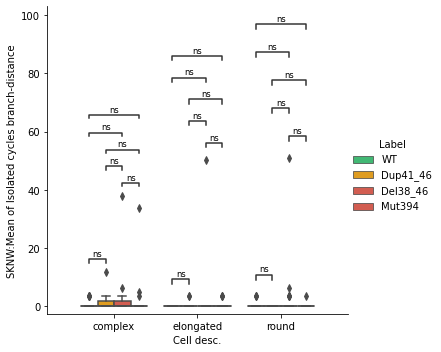

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.785e-01 stat=-7.151e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.449e-01 stat=-6.109e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.303e-01 stat=-9.823e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=nan stat=nan
elongated_WT v.s. elongated_Dup41_46: t-test i

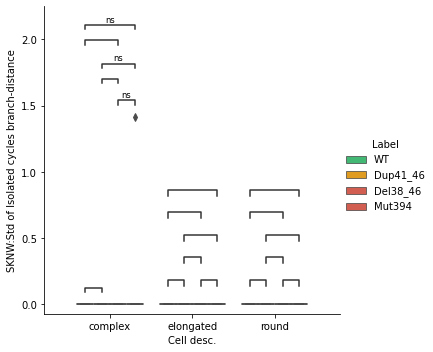

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=9.005e-02 stat=1.735e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=1.883e-01 stat=-1.341e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=7.943e-01 stat=2.636e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.760e-02 stat=2.047e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.018e-01 stat=-1.046e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.066e-01 stat=8.363e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.771e-01 stat=-5.644e-0

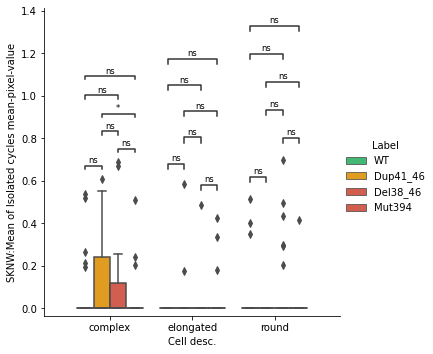

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.785e-01 stat=-7.151e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.449e-01 stat=-6.109e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.303e-01 stat=-9.823e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=nan stat=nan
elongated_WT v.s. elongated_Dup41_46: t-test i

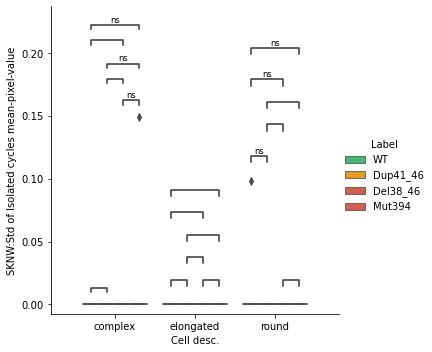

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=7.330e-02 stat=1.837e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.762e-01 stat=-8.957e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=4.284e-01 stat=-8.055e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.610e-01 stat=9.246e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=8.129e-02 stat=-1.787e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=8.613e-01 stat=1.755e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.121e-01 stat=3.730e-0

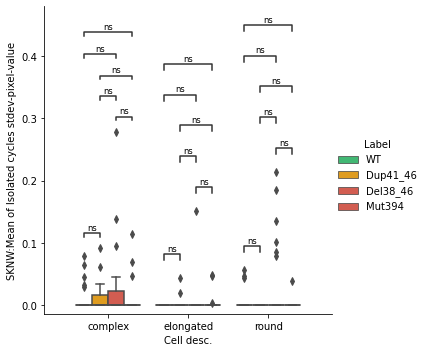

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=4.785e-01 stat=-7.151e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.449e-01 stat=-6.109e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.303e-01 stat=-9.823e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=nan stat=nan
elongated_WT v.s. elongated_Dup41_46: t-test i

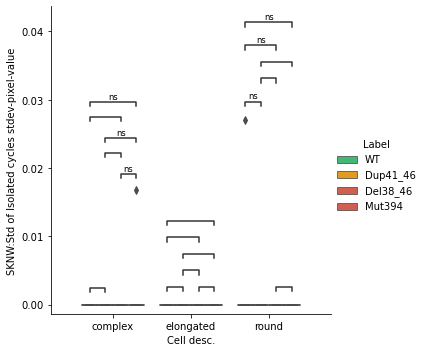

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=nan stat=nan
elongated_WT v.s. elongated_Dup41_46: t-test independent samples, P_val=nan stat=nan


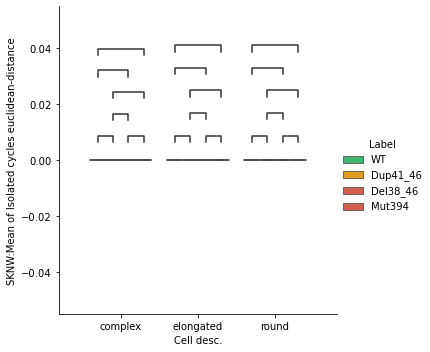

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=nan stat=nan
elongated_WT v.s. elongated_Dup41_46: t-test independent samples, P_val=nan stat=nan


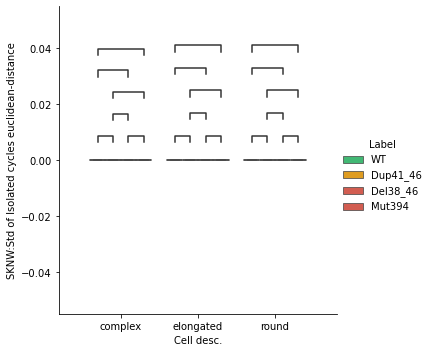

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.021e-01 stat=-1.671e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=9.141e-01 stat=1.086e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.786e-02 stat=2.543e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.652e-01 stat=7.378e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.183e-02 stat=2.635e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.832e-01 stat=1.084e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.853e-03 stat=-3.451e+00

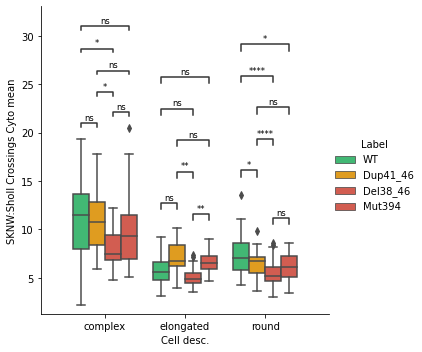

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.282e-01 stat=-1.223e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=7.118e-01 stat=-3.722e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.424e-01 stat=1.517e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=7.664e-01 stat=2.992e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.009e-01 stat=1.300e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=9.564e-01 stat=-5.495e-02
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=7.134e-05 stat=-4.683e+

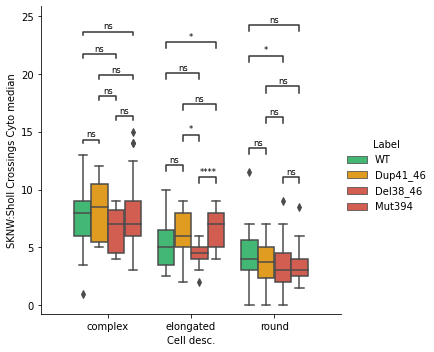

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=nan stat=nan
elongated_WT v.s. elongated_Dup41_46: t-test independent samples, P_val=nan stat=nan


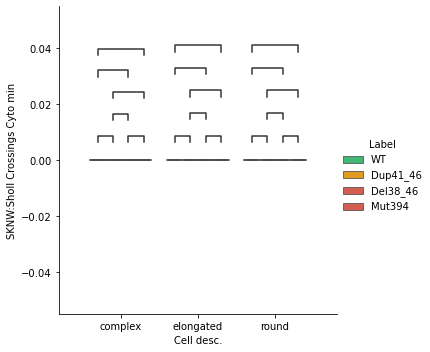

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.520e-01 stat=-1.459e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.442e-01 stat=1.979e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=4.429e-02 stat=2.123e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=6.559e-01 stat=4.491e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.119e-02 stat=2.397e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.077e-01 stat=8.344e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.817e-02 stat=-2.515e+00

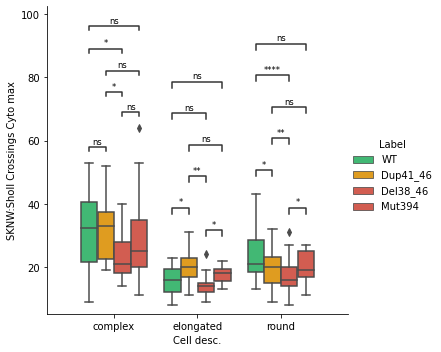

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.879e-01 stat=-1.339e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.164e-01 stat=2.338e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=7.601e-02 stat=1.854e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=7.511e-01 stat=3.195e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=3.297e-02 stat=2.207e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.840e-01 stat=7.046e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.053e-01 stat=-1.676e+00

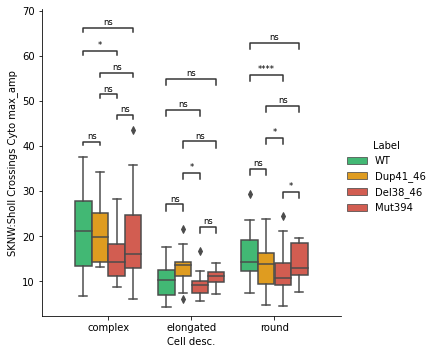

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.147e-01 stat=-1.611e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=6.124e-01 stat=5.109e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=5.966e-02 stat=1.977e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=9.581e-01 stat=5.286e-02
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.145e-02 stat=2.648e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.999e-01 stat=6.792e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=8.444e-02 stat=-1.791e+00

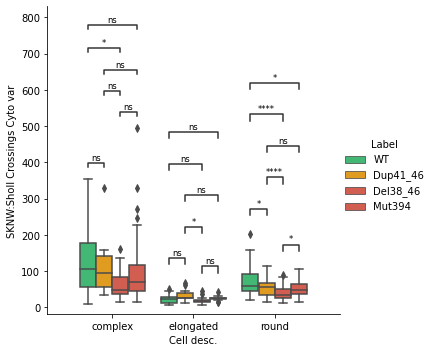

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.102e-01 stat=-1.632e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=6.870e-01 stat=4.061e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=4.846e-02 stat=2.079e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=7.639e-01 stat=3.025e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.239e-02 stat=2.616e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.676e-01 stat=9.085e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=4.495e-02 stat=-2.103e+00

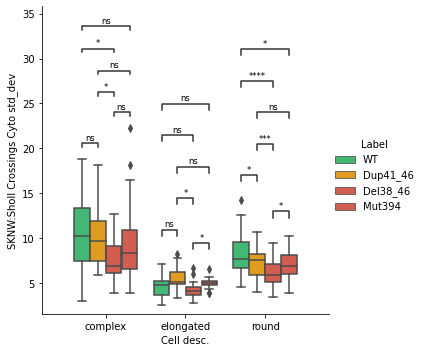

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.248e-01 stat=-1.566e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=7.051e-01 stat=3.814e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=5.460e-02 stat=2.021e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=6.887e-01 stat=4.037e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.417e-02 stat=2.562e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.113e-01 stat=1.022e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.253e-02 stat=-2.420e+00

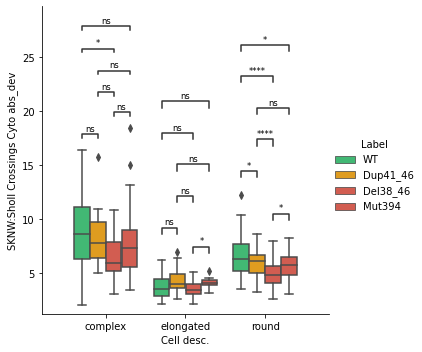

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=6.953e-01 stat=3.944e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=9.847e-01 stat=-1.936e-02
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=7.125e-01 stat=-3.729e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=8.832e-01 stat=-1.479e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=6.152e-01 stat=-5.066e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=8.382e-01 stat=-2.051e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=3.688e-01 stat=9.141e

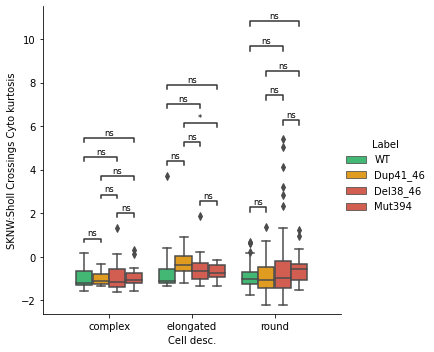

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=6.645e-01 stat=-4.368e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.722e-01 stat=5.699e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=6.804e-01 stat=4.170e-01
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=9.653e-01 stat=4.375e-02
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.986e-01 stat=1.053e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.716e-01 stat=7.248e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.586e-02 stat=2.358e+00


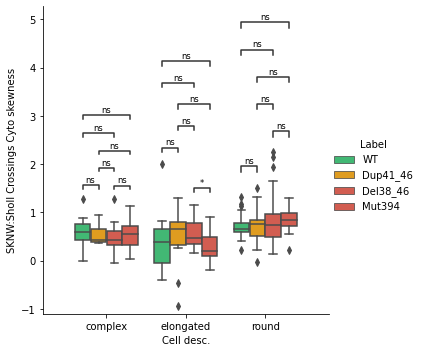

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.669e-01 stat=-1.407e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=7.630e-01 stat=3.038e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.494e-02 stat=2.392e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.572e-01 stat=7.512e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.194e-02 stat=2.631e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.850e-01 stat=1.342e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.147e-02 stat=-2.713e+00

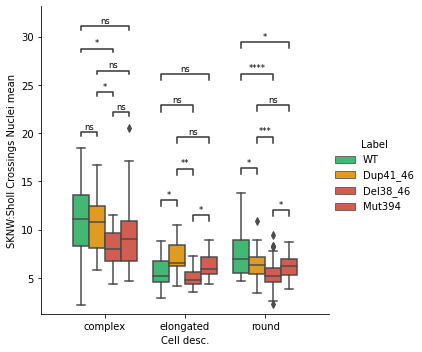

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.817e-01 stat=-1.090e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=9.239e-01 stat=9.616e-02
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.919e-01 stat=1.078e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=8.612e-01 stat=1.760e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.048e-01 stat=1.288e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=7.221e-01 stat=3.574e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.300e-02 stat=-2.660e+00

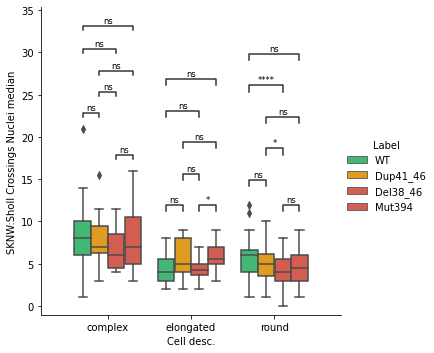

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=nan stat=nan
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=nan stat=nan
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=nan stat=nan
elongated_WT v.s. elongated_Dup41_46: t-test independent samples, P_val=nan stat=nan


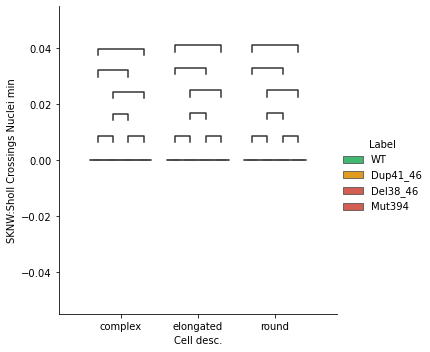

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.661e-01 stat=-1.409e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.340e-01 stat=2.111e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.444e-02 stat=2.637e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.056e-01 stat=6.720e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=8.978e-03 stat=2.743e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.598e-01 stat=1.139e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.310e-01 stat=-1.558e+00

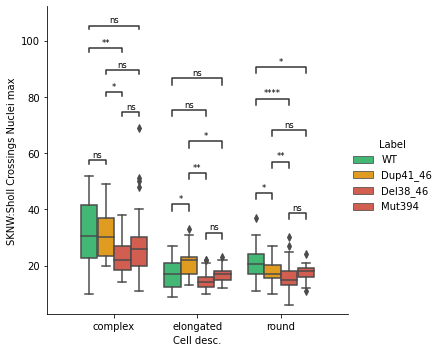

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.895e-01 stat=-1.334e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.779e-01 stat=1.547e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.827e-02 stat=2.533e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.493e-01 stat=6.042e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=1.147e-02 stat=2.647e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.248e-01 stat=9.935e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=4.505e-01 stat=-7.657e-01

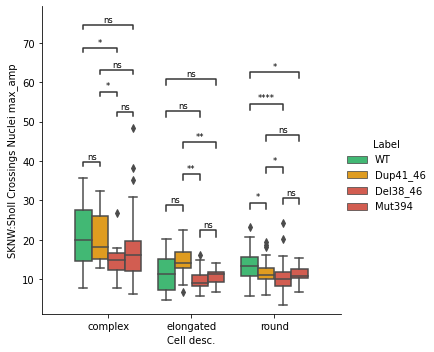

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.687e-01 stat=-1.400e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=4.899e-01 stat=6.974e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.743e-02 stat=2.348e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=7.807e-01 stat=2.804e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.191e-03 stat=2.953e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.432e-01 stat=1.180e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.975e-01 stat=-1.062e+00

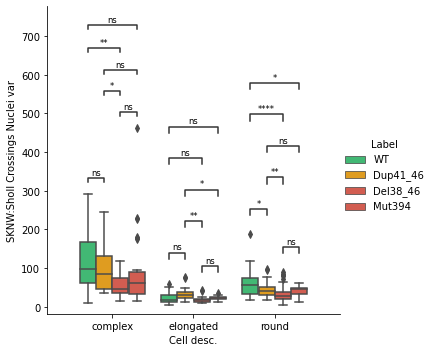

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.855e-01 stat=-1.346e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=6.001e-01 stat=5.288e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.498e-02 stat=2.391e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.142e-01 stat=6.585e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.774e-03 stat=2.913e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.376e-01 stat=1.507e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.725e-01 stat=-1.401e+00

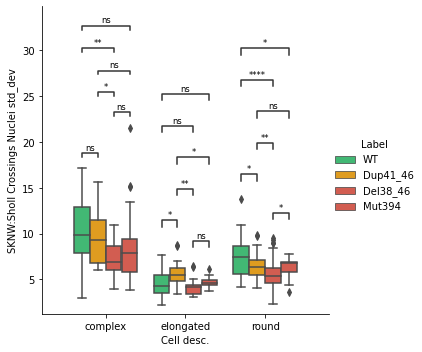

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=2.365e-01 stat=-1.201e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.472e-01 stat=6.076e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=5.998e-02 stat=1.974e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=5.716e-01 stat=5.706e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=8.875e-03 stat=2.748e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=1.366e-01 stat=1.511e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.744e-02 stat=-1.985e+00

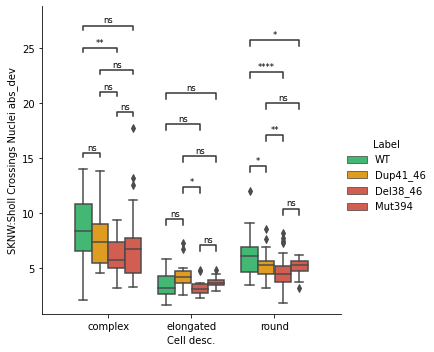

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=7.791e-01 stat=-2.823e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.032e-01 stat=-6.761e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=9.744e-01 stat=3.240e-02
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=8.153e-01 stat=-2.353e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.597e-01 stat=-5.880e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.689e-01 stat=-9.060e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.123e-01 stat=1.278e

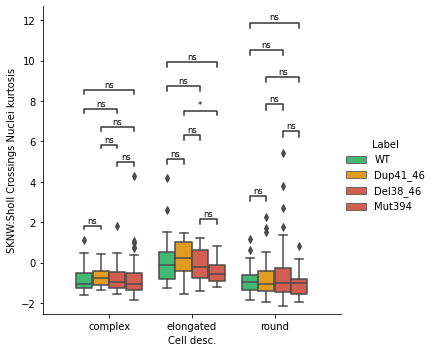

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=8.339e-01 stat=-2.111e-01
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.112e-01 stat=-6.633e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.716e-01 stat=1.125e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=4.467e-01 stat=7.690e-01
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.778e-01 stat=5.610e-01
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=7.508e-01 stat=3.192e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=5.875e-02 stat=1.974e+00

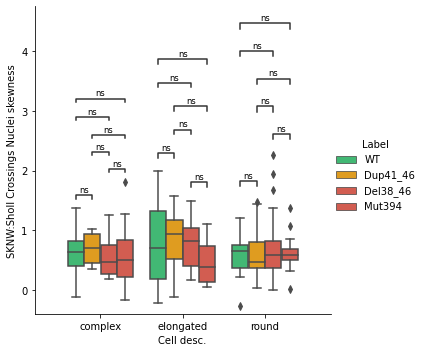

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=9.746e-03 stat=-2.708e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.940e-01 stat=-8.625e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=7.476e-03 stat=2.921e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=3.191e-01 stat=1.010e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=6.471e-02 stat=1.898e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=8.869e-01 stat=-1.428e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.798e-01 stat=-1.103e+

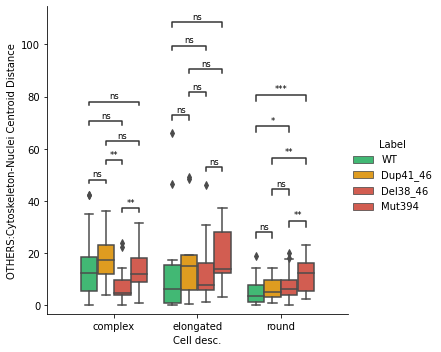

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=7.745e-02 stat=-1.810e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=3.141e-02 stat=-2.237e+00
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=1.200e-03 stat=3.672e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.172e-01 stat=1.255e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=2.957e-01 stat=1.059e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=3.248e-01 stat=-9.935e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.064e-02 stat=-2.459e+

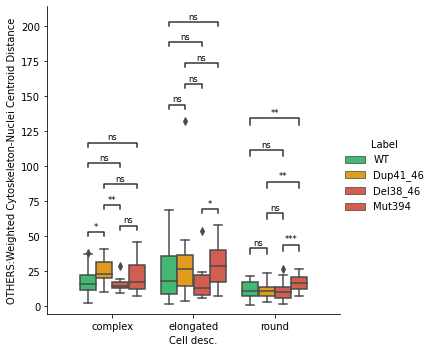

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=1.025e-03 stat=3.529e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=5.663e-01 stat=5.787e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.895e-03 stat=-3.316e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=9.782e-01 stat=2.745e-02
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=5.369e-03 stat=-2.940e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=4.353e-01 stat=7.859e-01
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=1.498e-02 stat=2.599e+00

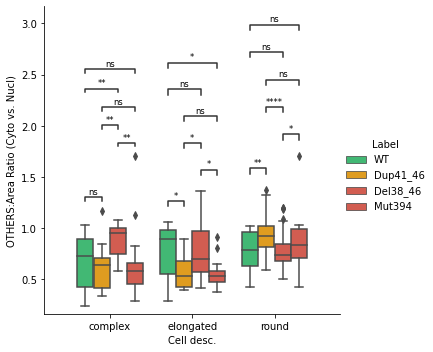

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

complex_Del38_46 v.s. complex_Mut394: t-test independent samples, P_val=6.874e-02 stat=-1.868e+00
complex_WT v.s. complex_Dup41_46: t-test independent samples, P_val=8.934e-01 stat=-1.349e-01
complex_Dup41_46 v.s. complex_Del38_46: t-test independent samples, P_val=2.695e-03 stat=3.346e+00
complex_Dup41_46 v.s. complex_Mut394: t-test independent samples, P_val=2.722e-01 stat=1.114e+00
complex_WT v.s. complex_Del38_46: t-test independent samples, P_val=4.146e-03 stat=3.037e+00
complex_WT v.s. complex_Mut394: t-test independent samples, P_val=2.168e-01 stat=1.250e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

elongated_Del38_46 v.s. elongated_Mut394: t-test independent samples, P_val=2.793e-02 stat=-2.323e+0

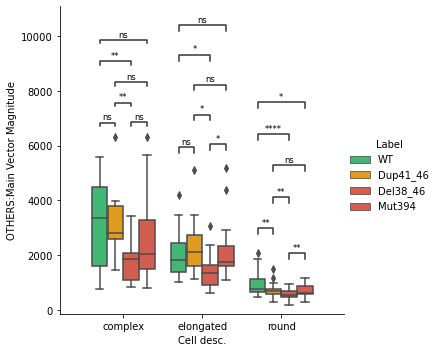

In [9]:
cols = [x for x in FULL.columns if x.startswith("LSF2D") or x.startswith("LSF1D") or x.startswith("DCF") or x.startswith("DNF") or x.startswith("SKNW") or x.startswith("OTHERS")]

colors=["#2ECC71","#FFA500","#E74C3C","#E74C3C"]
labels=['WT','Dup41_46','Del38_46','Mut394']
#labels = np.unique(ResultsDF['Cell desc.'])
#colors  = ["#3498DB","#E74C3C","#95A5A6","#ABE6FF","#CA6F1E","#2ECC71"]
import statannot
data = pd.concat([ResultsDF[ResultsDF.columns[:7]] , FULL , ResultsDF[ResultsDF.columns[-1]]],axis=1)
COUNT = 0
for ft in cols:
#     fig,ax = plt.subplots()
    sns.catplot(x="Cell desc.", y=ft, hue="Label", kind="box", palette=colors, order =np.unique(ResultsDF['Cell desc.']),hue_order=['WT','Dup41_46','Del38_46','Mut394'] ,data=pd.concat([ResultsDF[ResultsDF.columns[:7]] , FULL , ResultsDF[ResultsDF.columns[-1]]],axis=1))
    
    for celltype in np.unique(ResultsDF['Cell desc.']):
        comb = combinations(range(4), 2)
        pairs = [((celltype, labels[f[0]]), (celltype, labels[f[1]])) for f in list(comb)]
        #for f in list(comb):
        statannot.add_stat_annotation(plt.gca(),data=data,x="Cell desc.",y=ft,hue="Label",hue_order=['WT','Dup41_46','Del38_46','Mut394'],box_pairs=pairs,test='t-test_ind',text_format="star",loc="inside",fontsize='small',order =np.unique(ResultsDF['Cell desc.']),comparisons_correction=None)
    if SAVE:
        plt.savefig(".//CellVSCellAnalysis3Cat//boxplots3Cat//" + str(ft.split(':')[0]) + "-"  + str(ft.split(':')[1]) + ".png",format='png',transparent=True,bbox_inches='tight',dpi=200)
    
    COUNT = COUNT + 1
    plt.show()

---

In [ ]:
def cellvscell(CellSubsetDF):
    CellSubsetDF = CellSubsetDF.sort_values(by=['Cell desc.'])
    
    global labels, colors, markers
    labels  = np.unique(ResultsDF['Cell desc.'])
    colors,markers = get_colors_and_markers(labels)
    #colors  = ["#3498DB","#E74C3C","#95A5A6","#ABE6FF","#CA6F1E","#2ECC71"]
    #markers = ["o","v","^","p","h","s"]
    
    # LSF DATAFRAME
#     global LSF,StatsDF,c
#     LSF = CellSubsetDF[CellSubsetDF.columns[3:9]] #por 9
#     fts = tools.signal_stats(LSF.loc[LSF.index[0]]['Angles'])._names
#     res = pd.DataFrame()
#     for ft in LSF.columns: 
#         temp = np.array([list(tools.signal_stats(cell)) for cell in LSF[ft]])
#         res  = pd.concat([res, pd.DataFrame(temp,columns = [ft+str(" ")+i for i in fts])],axis=1)

#     StatsDF = pd.concat([res, pd.DataFrame(np.array(CellSubsetDF[CellSubsetDF.columns[9]]),columns=[ResultsDF.columns[9]])],axis=1)
    
    LSF,DCF,DNF,SKNW,FULL = create_separate_DFs(CellSubsetDF)
    StatsDF = LSF
    
    # Labels
    c = [colors[list(labels).index(x)] for x in CellSubsetDF['Cell desc.']]
    m = [markers[list(labels).index(y)] for y in CellSubsetDF['Cell desc.']]

    # Bar plot
#     i = 0
#     for mainft in LSF.columns:
#         pl = 1
#         fig, ax = plt.subplots(figsize=(15,5))
#         plt.suptitle(mainft)
#         for _ in range(10):
#             plt.subplot(2,5,pl)
#             plt.bar(range(len(CellSubsetDF.index)),StatsDF[StatsDF.columns[i]],color=c,label=labels)
#             plt.ylabel(StatsDF.columns[i],fontsize=8)
#             #plt.legend()
#             plt.xticks(range(len(CellSubsetDF.index)),CellSubsetDF['Cell desc.'],fontsize=7,rotation=45)
#             plt.tight_layout()
#             pl += 1
#             i  +=1
        
#         plt.legend()
#         plt.show()
        
    # 1D feats
    feats =
    for feat in ResultsDF.columns[9:-1]:
        fig, ax = plt.subplots(figsize=(15,8))
        cmap = pltc.Reds
        new_cmap = truncate_colormap(cmap, 0.3, 1, 300)
        #plt.bar(range(len(CellSubsetDF.index)),CellSubsetDF[CellSubsetDF.columns[8]],color=[new_cmap(plt.Normalize(0, max(CellSubsetDF[CellSubsetDF.columns[8]]))(c)) for c in CellSubsetDF[CellSubsetDF.columns[8]]],alpha=0.7)
        plt.bar(range(len(CellSubsetDF.index)),CellSubsetDF[feat],color=c,label=labels)
        plt.xticks(range(len(CellSubsetDF.index)), CellSubsetDF['Cell desc.'], fontsize=12,rotation=45)
        #plt.title(feat)
        plt.ylabel(feat)
        plt.tight_layout()
        #plt.savefig(".//CellVSCellAnalysis//features//" + str(index) + str("_") + str(feat) + ".png",format='png',transparent=True,bbox_inches='tight')
        plt.show()

    # Spider plot
#     global angles,values,idx,ind
#     ind = 0
#     pl_ = 1
    
#     for mainft2 in range(len(LSF.columns)):
#         fig, ax = plt.subplots(figsize=(15,8))
#         ax      = plt.subplot(2,3,pl_, polar=True )
#         plt.title(LSF.columns[mainft2])
        
#         ax.set_theta_offset(np.pi / 2)
#         ax.set_theta_direction(-1)
        
#         angles = [n / float(10) * 2 * np.pi for n in range(10)]
#         angles += angles[:1]
        
#         plt.xticks(angles[:-1], StatsDF.columns[ind:ind+10], color='grey', size=8)
        
#         ax.set_rlabel_position(0)
        
#         for idx in StatsDF.index:
#             values=StatsDF.loc[idx][ind:ind+10].values.flatten().tolist()
#             values += values[:1]
#             ax.plot(angles, values,  linewidth=2, linestyle='solid')
#         #ax.fill(angles, values, alpha=0.4)
        
#         ind = ind+10
#         pl_ += 1
    
    plt.show()
    
print('cellvscell')

In [7]:
def cellvscell(CellSubsetDF):
    CellSubsetDF = CellSubsetDF.sort_values(by=['Cell desc.'])
    
    global labels, colors, markers
    labels  = np.unique(ResultsDF['Label'])
    colors,markers = get_colors_and_markers(labels)
    #colors  = ["#3498DB","#E74C3C","#95A5A6","#ABE6FF","#CA6F1E","#2ECC71"]
    #markers = ["o","v","^","p","h","s"]
    
    # LSF DATAFRAME
#     global LSF,StatsDF,c
#     LSF = CellSubsetDF[CellSubsetDF.columns[3:9]] #por 9
#     fts = tools.signal_stats(LSF.loc[LSF.index[0]]['Angles'])._names
#     res = pd.DataFrame()
#     for ft in LSF.columns: 
#         temp = np.array([list(tools.signal_stats(cell)) for cell in LSF[ft]])
#         res  = pd.concat([res, pd.DataFrame(temp,columns = [ft+str(" ")+i for i in fts])],axis=1)

#     StatsDF = pd.concat([res, pd.DataFrame(np.array(CellSubsetDF[CellSubsetDF.columns[9]]),columns=[ResultsDF.columns[9]])],axis=1)
    
    LSF,DCF,DNF,SKNW,FULL = create_separate_DFs(CellSubsetDF)
    StatsDF = LSF
    
    # Labels
    c = [colors[list(labels).index(x)] for x in CellSubsetDF['Label']]
    m = [markers[list(labels).index(y)] for y in CellSubsetDF['Label']]

    # Bar plot
#     i = 0
#     for mainft in LSF.columns:
#         pl = 1
#         fig, ax = plt.subplots(figsize=(15,5))
#         plt.suptitle(mainft)
#         for _ in range(10):
#             plt.subplot(2,5,pl)
#             plt.bar(range(len(CellSubsetDF.index)),StatsDF[StatsDF.columns[i]],color=c,label=labels)
#             plt.ylabel(StatsDF.columns[i],fontsize=8)
#             #plt.legend()
#             plt.xticks(range(len(CellSubsetDF.index)),CellSubsetDF['Cell desc.'],fontsize=7,rotation=45)
#             plt.tight_layout()
#             pl += 1
#             i  +=1
        
#         plt.legend()
#         plt.show()
        
    # 1D feats
    for feat in ResultsDF.columns[9:-1]:
        fig, ax = plt.subplots(figsize=(15,8))
        cmap = pltc.Reds
        new_cmap = truncate_colormap(cmap, 0.3, 1, 300)
        #plt.bar(range(len(CellSubsetDF.index)),CellSubsetDF[CellSubsetDF.columns[8]],color=[new_cmap(plt.Normalize(0, max(CellSubsetDF[CellSubsetDF.columns[8]]))(c)) for c in CellSubsetDF[CellSubsetDF.columns[8]]],alpha=0.7)
        plt.bar(range(len(CellSubsetDF.index)),CellSubsetDF[feat],color=c,label=labels)
        plt.xticks(range(len(CellSubsetDF.index)), CellSubsetDF['Cell desc.'], fontsize=12,rotation=45)
        #plt.title(feat)
        plt.ylabel(feat)
        plt.tight_layout()
        #plt.savefig(".//CellVSCellAnalysis//features//" + str(index) + str("_") + str(feat) + ".png",format='png',transparent=True,bbox_inches='tight')
        plt.show()

    # Spider plot
#     global angles,values,idx,ind
#     ind = 0
#     pl_ = 1
    
#     for mainft2 in range(len(LSF.columns)):
#         fig, ax = plt.subplots(figsize=(15,8))
#         ax      = plt.subplot(2,3,pl_, polar=True )
#         plt.title(LSF.columns[mainft2])
        
#         ax.set_theta_offset(np.pi / 2)
#         ax.set_theta_direction(-1)
        
#         angles = [n / float(10) * 2 * np.pi for n in range(10)]
#         angles += angles[:1]
        
#         plt.xticks(angles[:-1], StatsDF.columns[ind:ind+10], color='grey', size=8)
        
#         ax.set_rlabel_position(0)
        
#         for idx in StatsDF.index:
#             values=StatsDF.loc[idx][ind:ind+10].values.flatten().tolist()
#             values += values[:1]
#             ax.plot(angles, values,  linewidth=2, linestyle='solid')
#         #ax.fill(angles, values, alpha=0.4)
        
#         ind = ind+10
#         pl_ += 1
    
    plt.show()
    
print('cellvscell')

cellvscell


In [105]:
cellvscell(ResultsDF)

ipykernel_launcher.py (57): Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 


KeyboardInterrupt: 

In [85]:
def plot_pie_2(ResultsDF,feat,Max):
    cmap = pltc.Reds
    global new_cmap
    new_cmap = truncate_colormap(cmap, 0.3, 1, 300)
    
    #global data
    #data = ImageLinesDF.tail(1)
    for index,row in ResultsDF.iterrows():
        print(row['Label'])
        # Pie chart
        labels = [feat, '-']
        if feat == 'LSF1D:Number of Lines':
            sizes = [row[feat], Max-row[feat]]

        colors = [new_cmap(plt.Normalize(0, Max)(row[feat]), alpha = 0.7),'w']

        fig1, ax1 = plt.subplots()
        ax1.pie(sizes, colors = colors, labels=[sizes[0],'-'], startangle=90)
        #draw circle
        centre_circle = plt.Circle((0,0),0.70,fc='white',ec='black')
        plt.gcf().gca().add_artist(centre_circle)
        # Equal aspect ratio ensures that pie is drawn as a circle
        ax1.axis('equal')  
        plt.tight_layout()
        plt.show()

Del38_46


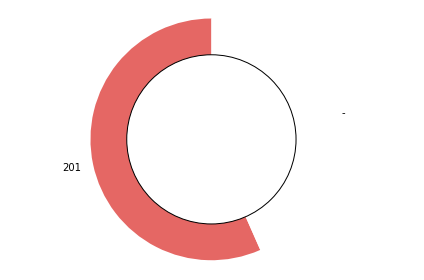

Del38_46


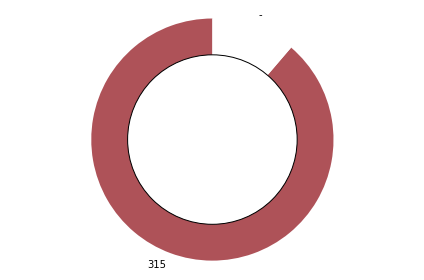

Del38_46


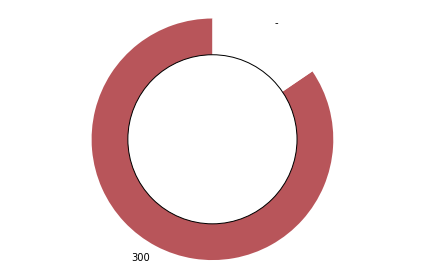

Del38_46


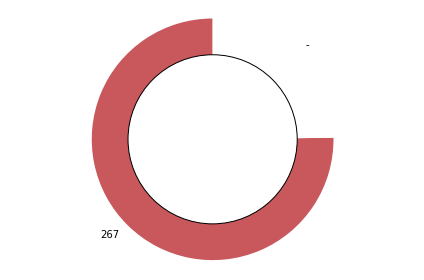

Dup41_46


ValueError: Wedge sizes 'x' must be non negative values

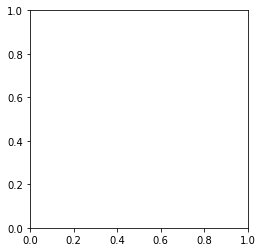

In [87]:
plot_pie_2(ResultsDF,'LSF1D:Number of Lines',355)

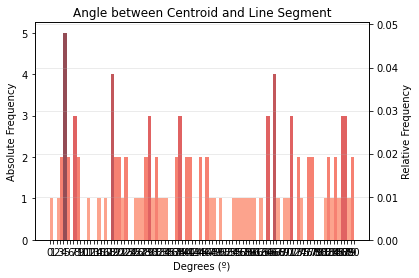

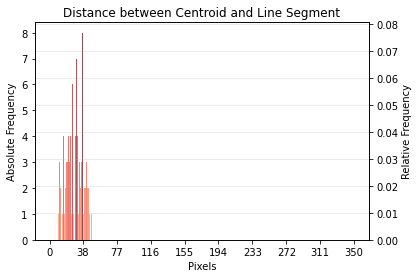

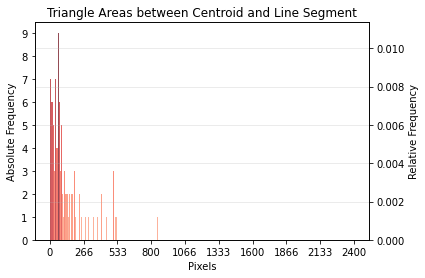

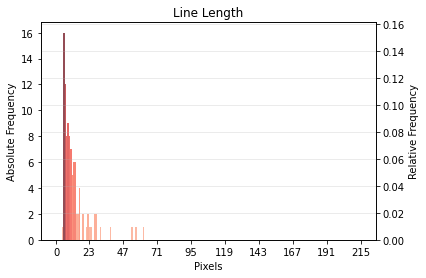

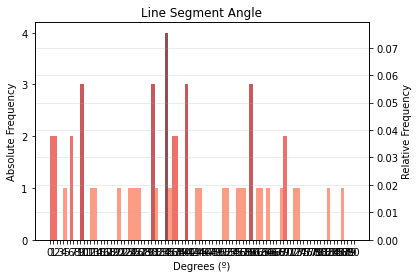

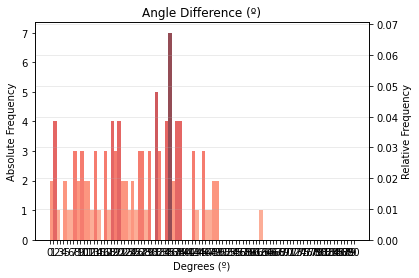

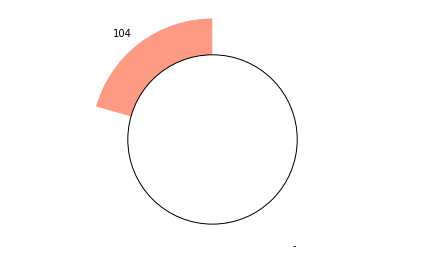

Fractal Dim: 1.3432651181442523
Area: 6994
BB Area: 12432
Perimeter: 600.7716446627535
Centroid Divergence: 3.0325192150580293
Equivalent Diameter: 94.3665055826363
Major Axis Length: 100.23007103588549
Minor Axis Length: 91.54990361925273
Eccentricity: 0.4070686351918513
Circularity: 0.2435099092672517
Roundness: 0.8864202530108736
Orientation: 0.03893524836148728
Solidity: 0.727556433995631
Roughness: 1.629093303142446
Mean Intensity: 20277.531169573922
Std: 14385.578218170604
Variance: 206944860.67110452
Skewness: 0.07151540970685452
Kurtosis: -0.9342696904606744
Contrast: 27.03155256333559
Max Intensity: 62563
Min Intensity: 22
Entropy: 7.190596161799384
Invariant Uniformity: 0.24080592978177184
GLCM Invariant Entropy: 1.4837095621384233
Invariant Correlation: 0.9432071384818181
Invariant Dissimilarity: 10.761330402335474
Invariant Contrast: 410.2560654464795
Invariant Homogeneity: 0.5234237272385721
Invariant Energy: 0.4907198078147775
Mean Gabor Power: 0.03193197380978882
Gabor V

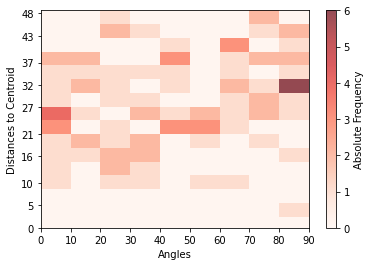

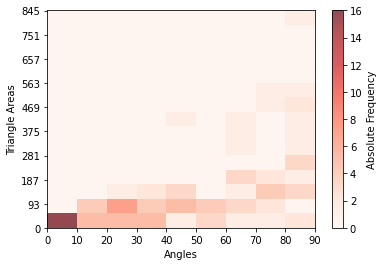

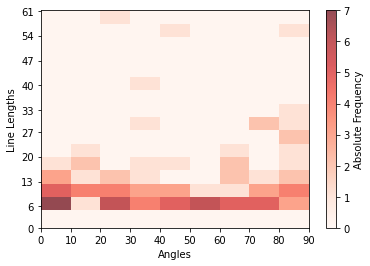

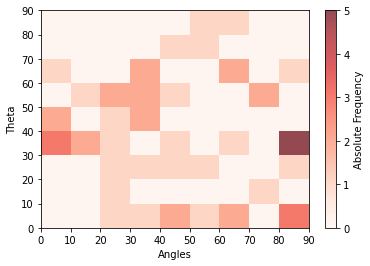

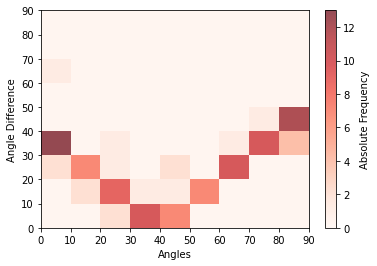

...

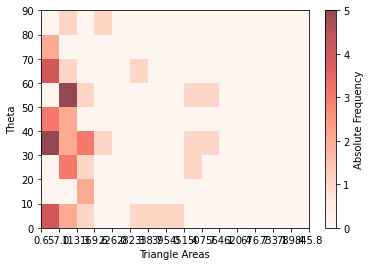

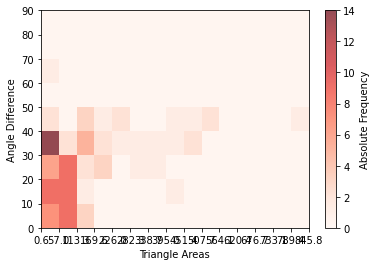

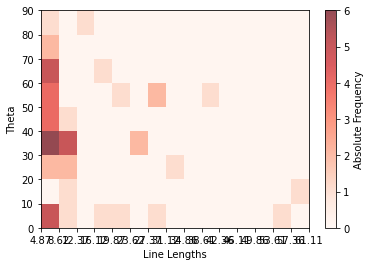

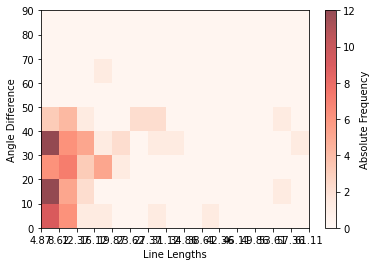

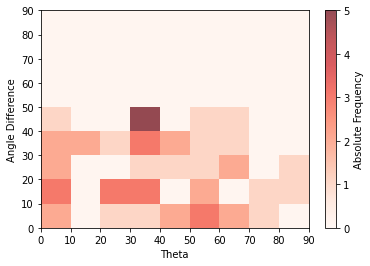

In [21]:
quantitative_analysis(ResultsDF)

In [61]:
def generate_hists(CellSubsetDF):
    global maximos,feat
    maximos = []
    feats = list(CellSubsetDF.columns[6:])
    cmap = pltc.Reds
    global new_cmap
    new_cmap = truncate_colormap(cmap, 0.3, 1, 300)

    global row,index
   
    for index,row in CellSubsetDF.iterrows():
        m = []
        print(index)
        for feat in feats[:6]:

            #plot_hist(ImageLinesDF=row,feat=feat,bins=hist_bin(feat))
        

#             global data
#             data = ImageLinesDF.tail(1)
            global histog,bin_edges


            #histo = np.histogram(row[feat],bins=hist_bin(feat))

            # AX1
            plt.figure()
            ax1 = plt.subplot(1,1,1)
            ax1.set_ylabel('Absolute Frequency',color=pltc.Reds_r(0))
            ax1.yaxis.set_major_locator(MaxNLocator(integer=True))
            ax1.tick_params(axis='y', colors=pltc.Reds_r(0))

            global colours
            #colours = pltc.Reds(plt.Normalize(0, max(histog[0]))(histog[0]),alpha=0.7)
            #colours = new_cmap(plt.Normalize(0, max(histo[0]))(histo[0]),alpha=0.7)

            #ax1.bar(histog[1][:-1],histog[0],color=colours,zorder=5)
            histog, bin_edges, patches = ax1.hist(eval(row[feat]), bins=hist_bin(feat)[0],color='k',alpha=0.7,edgecolor = "white")
            
            #ax1.color = new_cmap(plt.Normalize(0, max(histog))(histog),alpha=0.7)
            for c, p in zip(histog, patches):
                plt.setp(p, 'facecolor', new_cmap(plt.Normalize(0, max(histog))(c), alpha = 0.7))

            # AX2
            global histog_den,bin_edges_den
            ax2 = ax1.twinx() 
            ax2.set_ylabel('Relative Frequency')  
            histog_den, bin_edges_den, patches_den = ax2.hist(eval(row[feat]), bins=hist_bin(feat)[0], density=True,color='k',alpha=0.7,fill=False,histtype='step',ls='dashed')
            #ax2.plot(bin_edges_den[:-1], histog_den, color='k',linewidth = 2,alpha=0.7)
            m = m+[np.max(histog_den)]
            #ax2.plot(histog[1][:-1],(histog[0]/np.trapz(histog[0],x=histog[1][:-1])),'--',alpha=0,zorder=1)
            plt.grid(alpha=0.3)

            if feat == 'Angles':
                ax1.set_xlabel('Degrees (º)')
                ax1.set_title('Angle between Centroid and Line Segment',fontsize=12)
                ax1.set_ylim([0, 35])
                ax2.set_ylim([0, 0.055])
            if feat == 'Distances to Centroid':
                ax1.set_xlabel('Pixels')
                ax1.set_title('Distance between Centroid and Line Segment',fontsize=12)
                ax1.set_ylim([0, 40])
                ax2.set_ylim([0, 0.040])
            if feat == 'Triangle Areas':
                ax1.set_xlabel('Pixels')
                ax1.set_title('Triangle Areas between Centroid and Line Segment',fontsize=12)
                ax1.set_ylim([0, 30])
                ax2.set_ylim([0, 0.012])
            if feat == 'Line Lengths':
                ax1.set_xlabel('Pixels')
                ax1.set_title('Line Length',fontsize=12)
                ax1.set_ylim([0, 85])
                ax2.set_ylim([0, 0.135])
            if feat == 'Theta':
                ax1.set_xlabel('Degrees (º)')
                ax1.set_title('Line Segment Angle',fontsize=12)
                ax1.set_ylim([0, 25])
                ax2.set_ylim([0, 0.04])
            if feat == 'Angle Difference':
                ax1.set_xlabel('Degrees (º)')
                ax1.set_title('Angle Difference (º)',fontsize=12)
                ax1.set_ylim([0, 55])
                ax2.set_ylim([0, 0.055])
            
            ax1.set_xticks(hist_bin(feat)[1])
            ax1.set_xticklabels(hist_bin(feat)[1],rotation=45, ha='right', rotation_mode='anchor')
            


            #plt.savefig(".//CellVSCellAnalysis//hists//" + str(index) + str("_") + str(feat) + ".png",format='png',transparent=True,bbox_inches='tight')
            plt.show()
        
        maximos = maximos + [m]



0


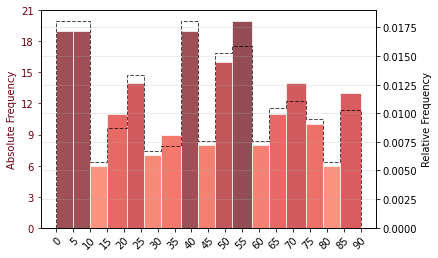

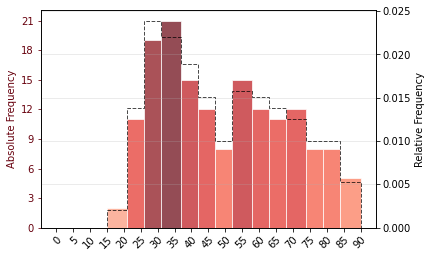

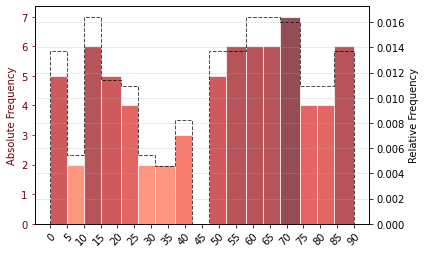

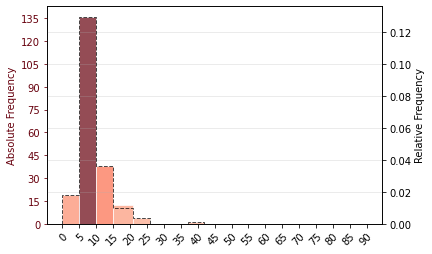

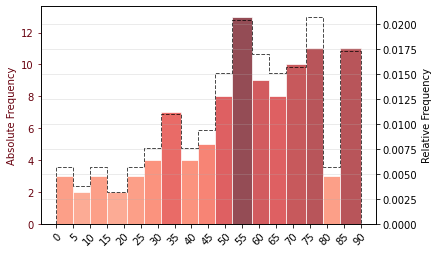

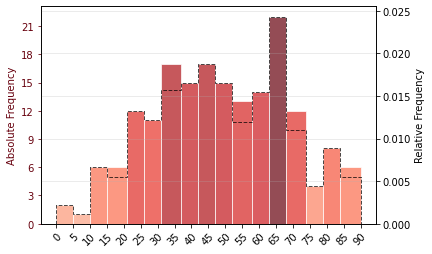

1


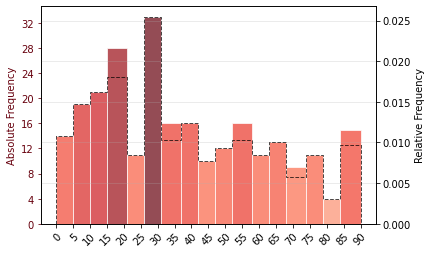

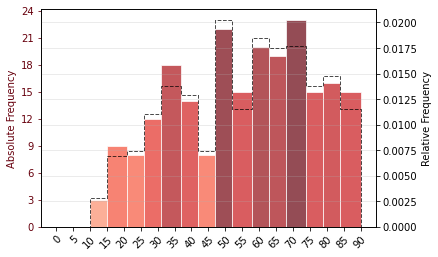

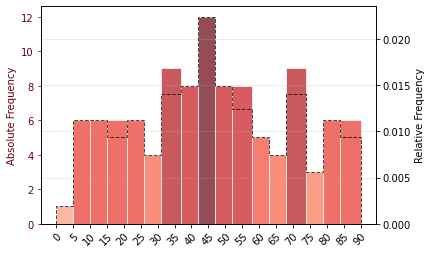

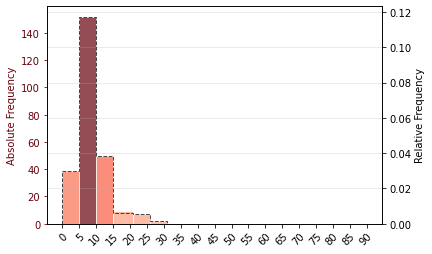

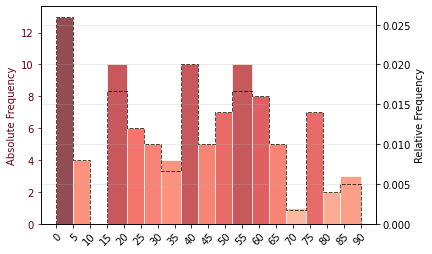

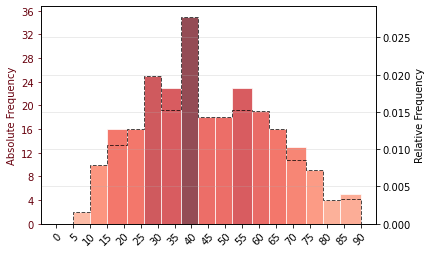

2


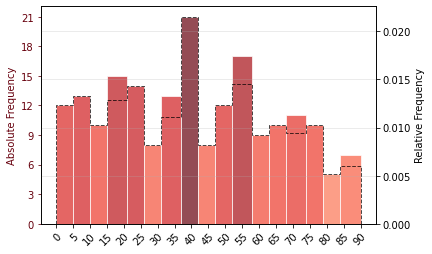

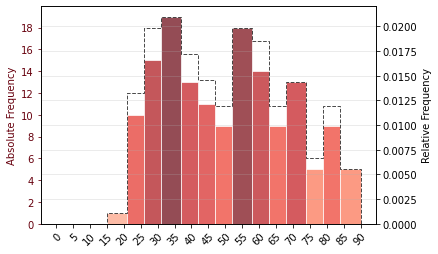

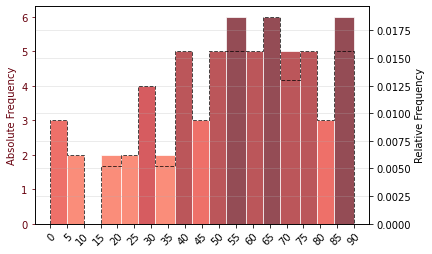

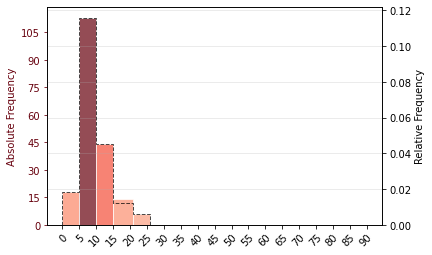

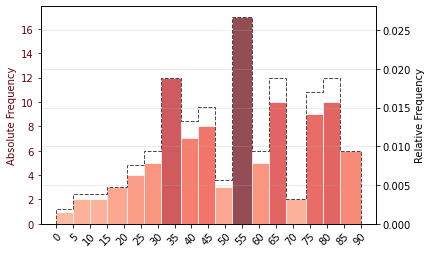

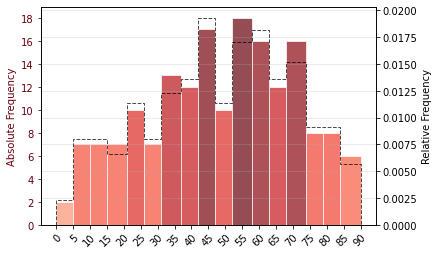

3


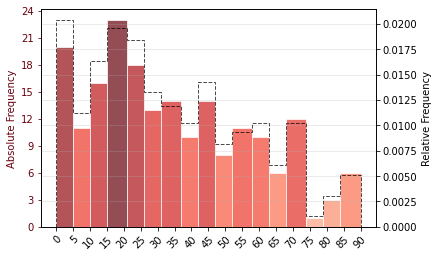

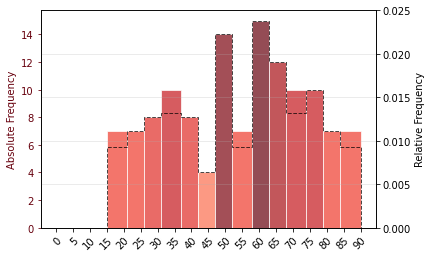

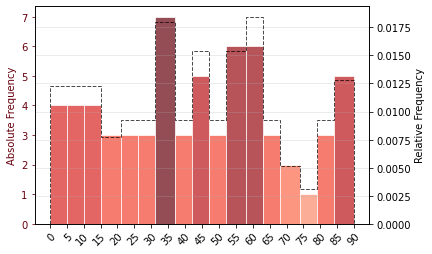

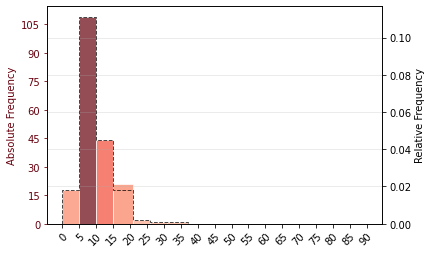

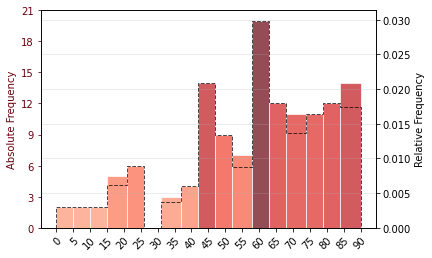

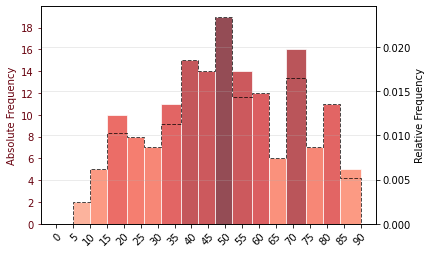

4


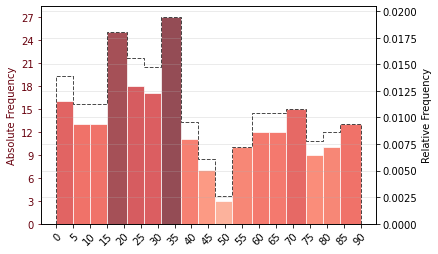

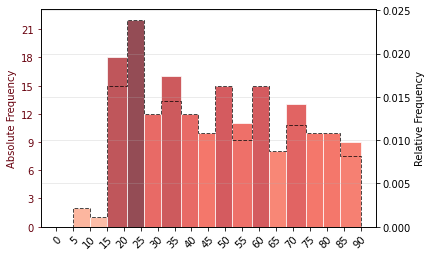

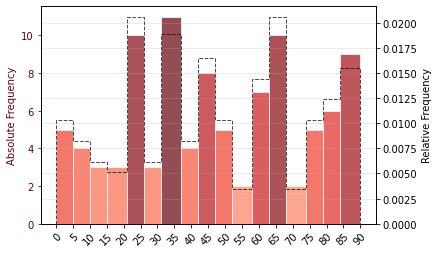

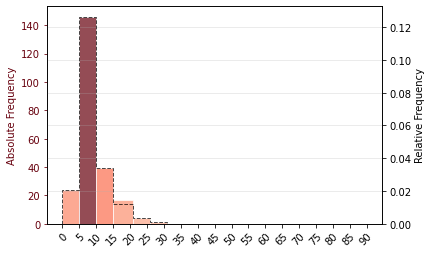

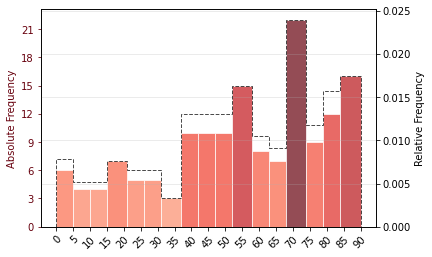

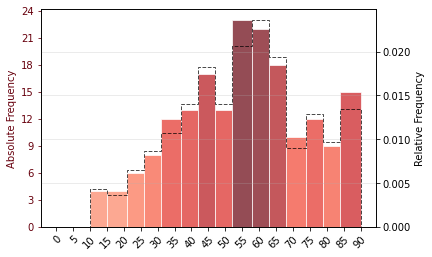

5


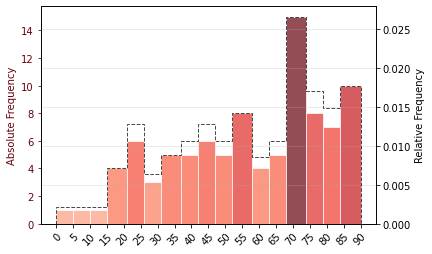

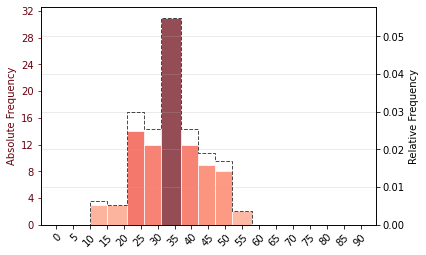

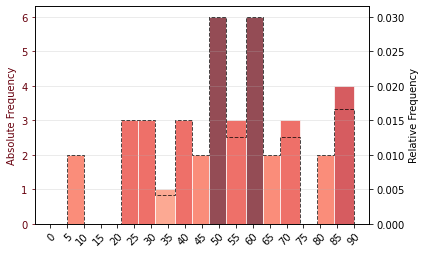

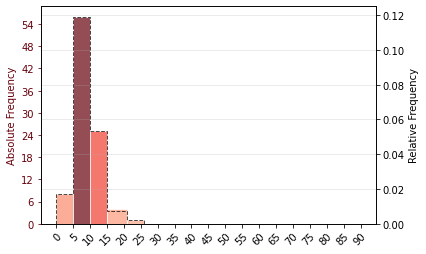

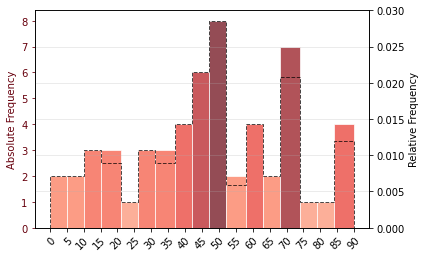

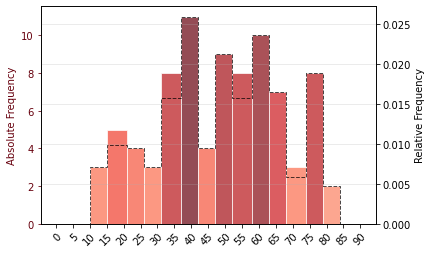

6


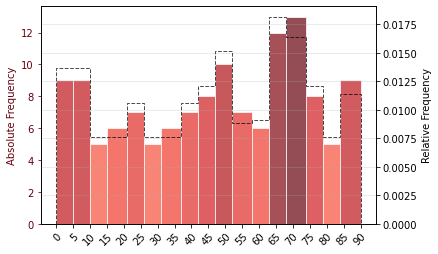

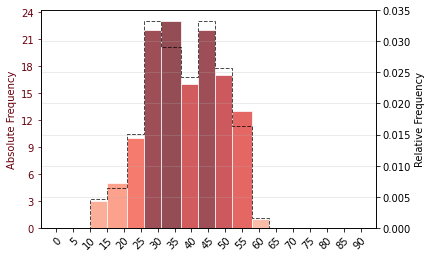

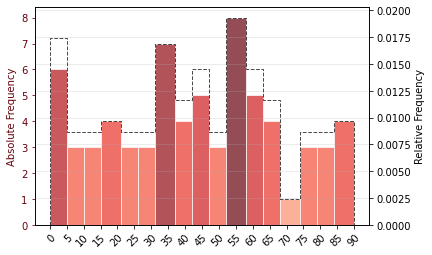

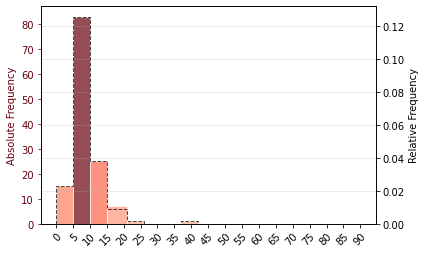

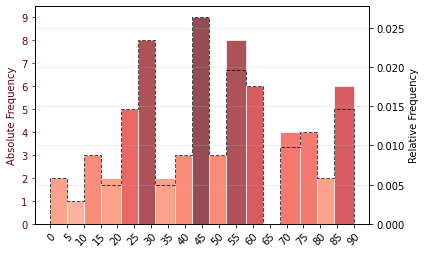

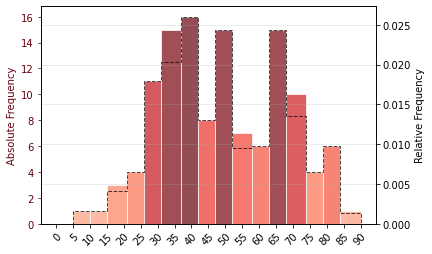

7


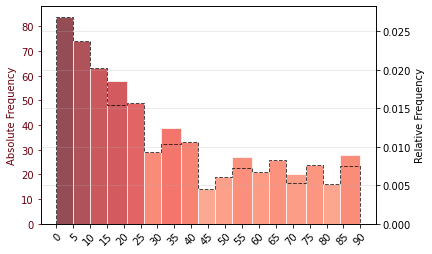

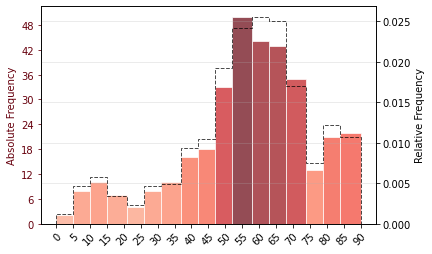

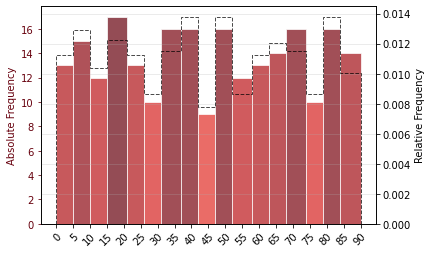

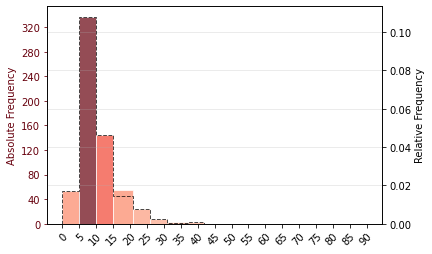

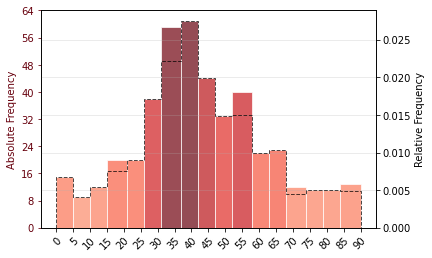

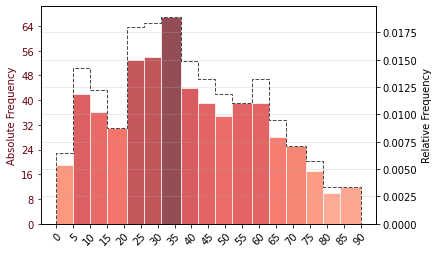

9


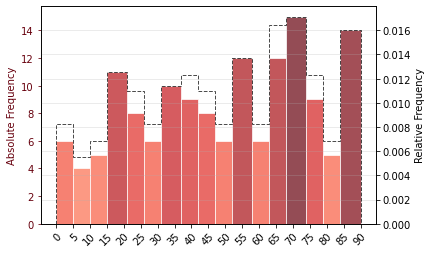

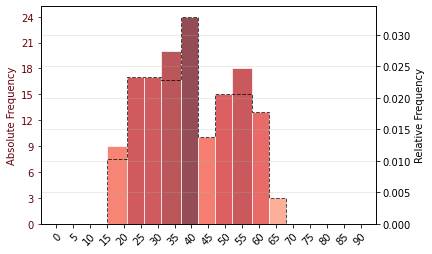

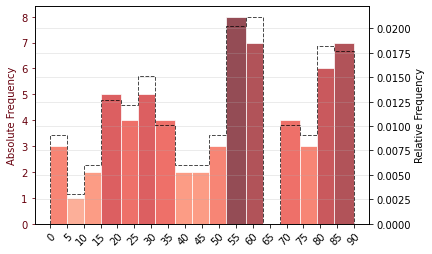

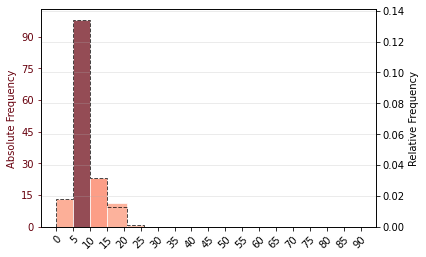

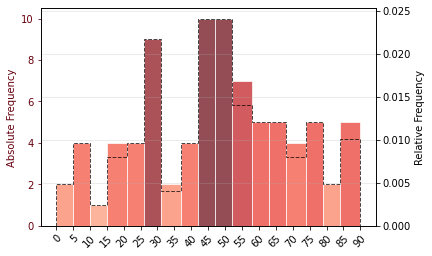

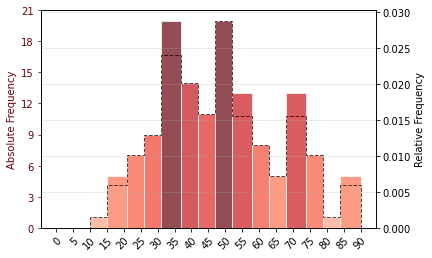

14


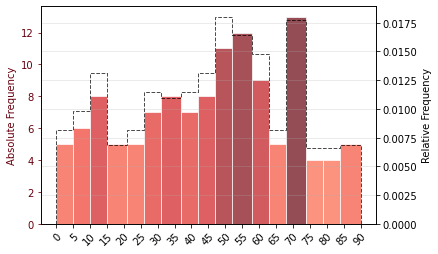

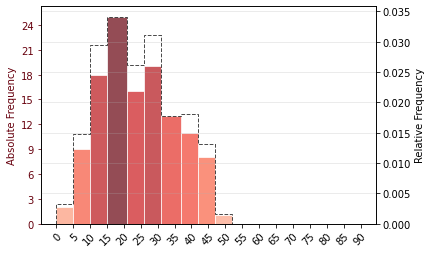

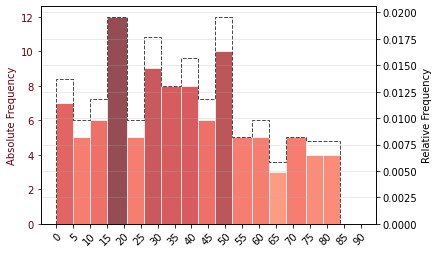

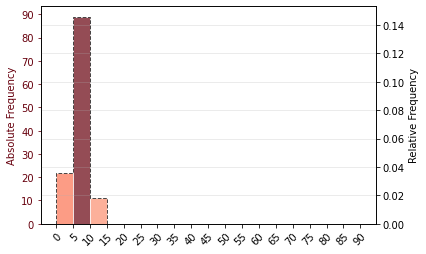

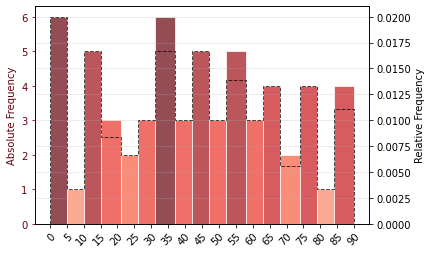

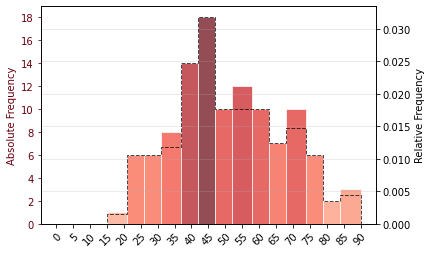

15


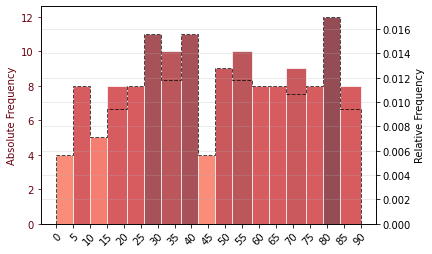

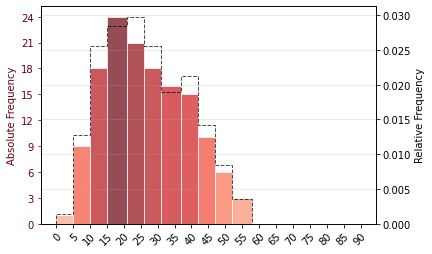

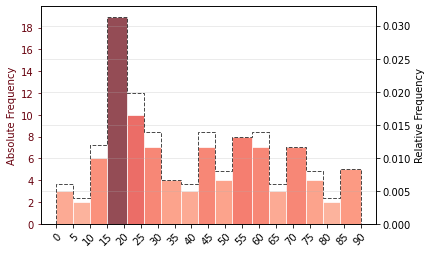

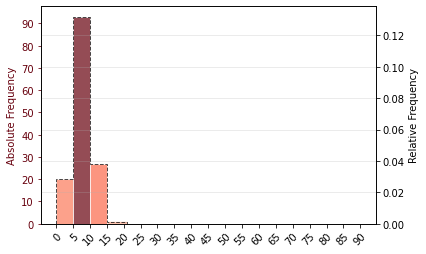

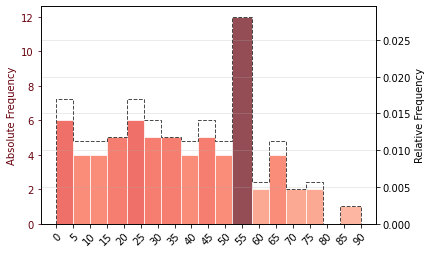

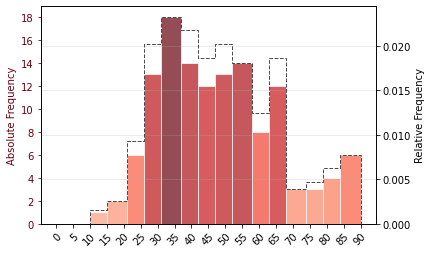

16


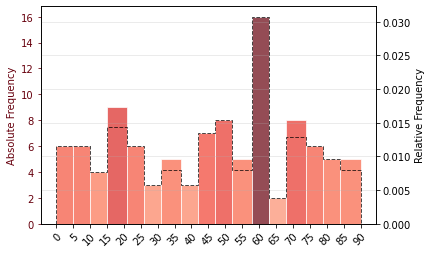

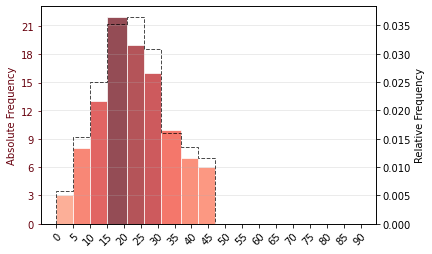

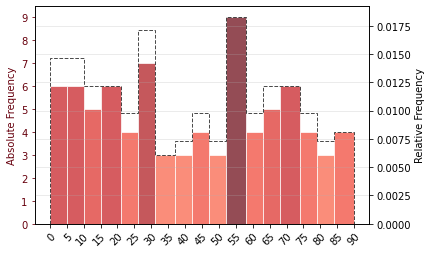

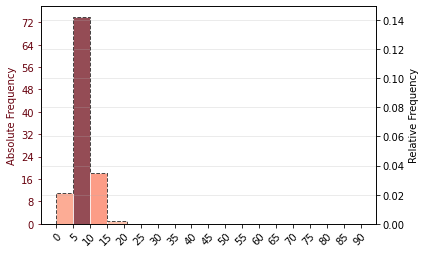

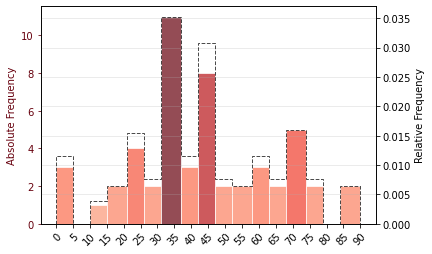

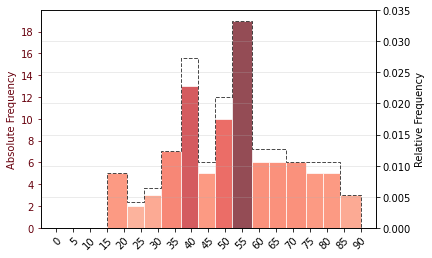

26


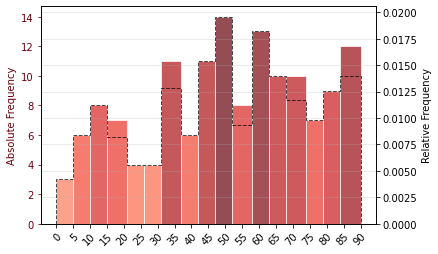

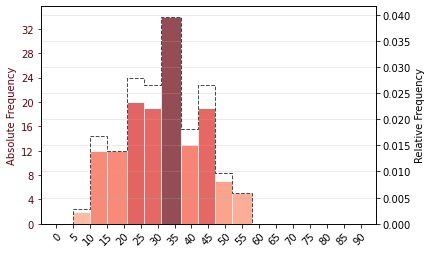

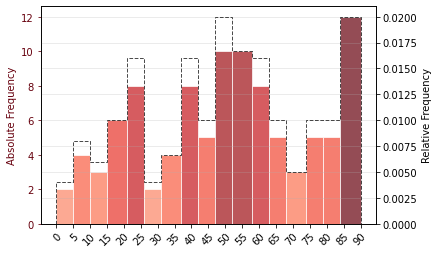

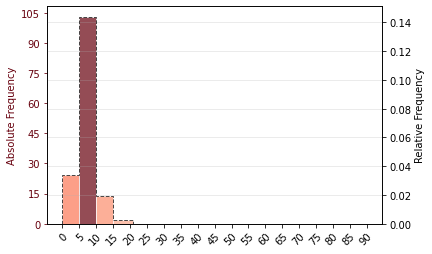

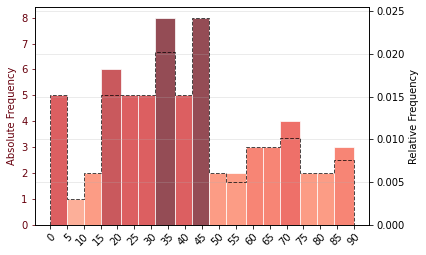

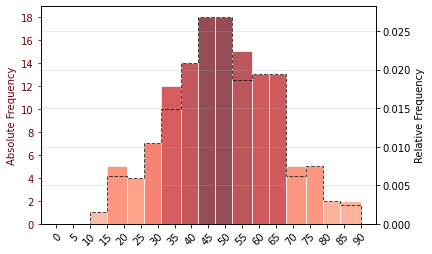

30


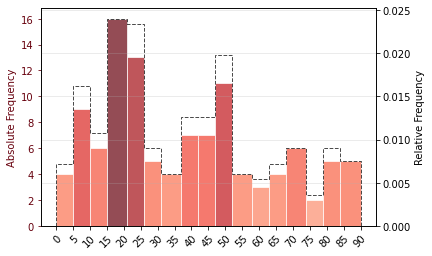

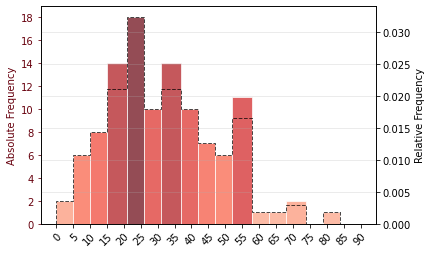

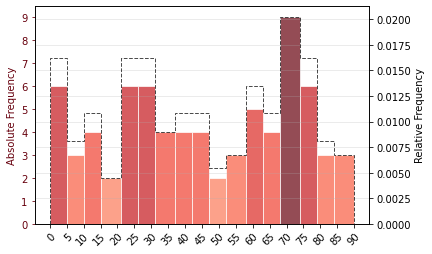

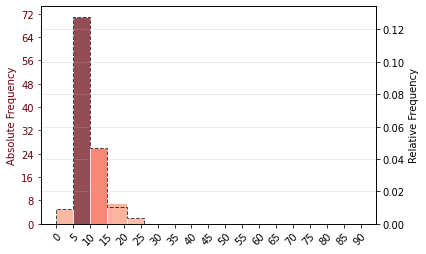

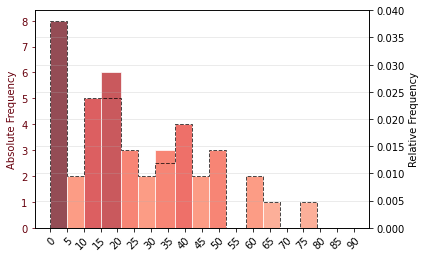

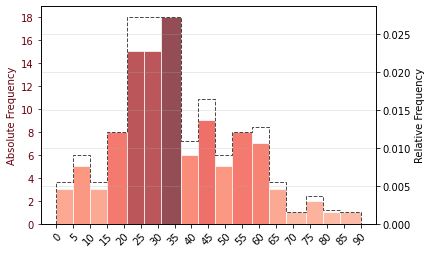

31


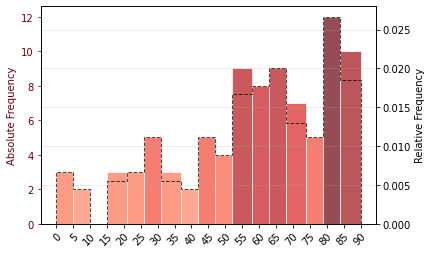

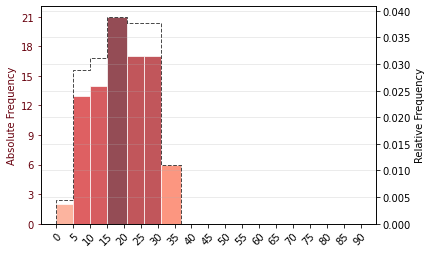

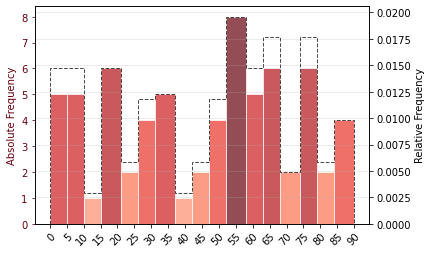

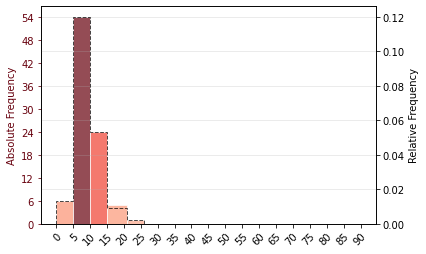

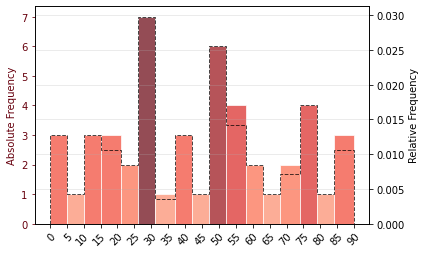

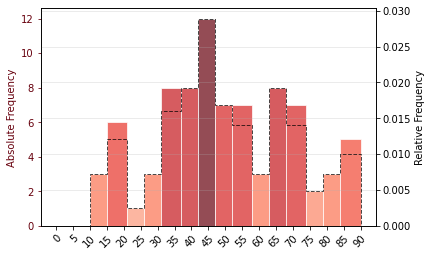

37


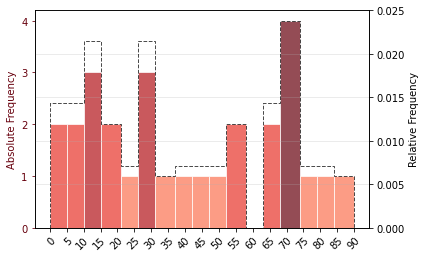

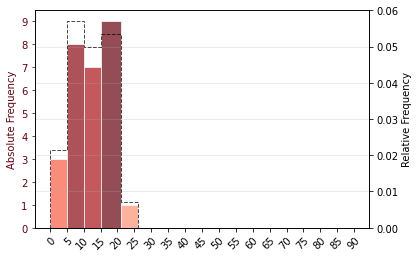

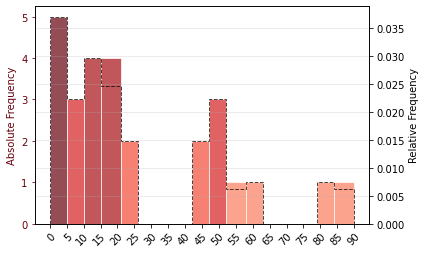

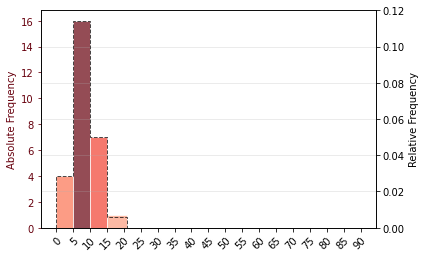

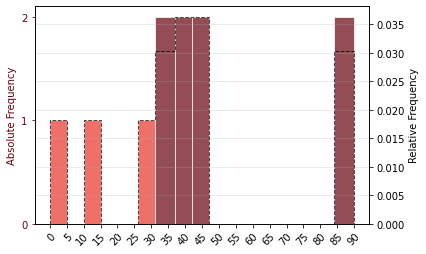

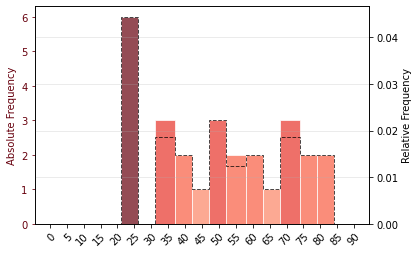

41


KeyboardInterrupt: 

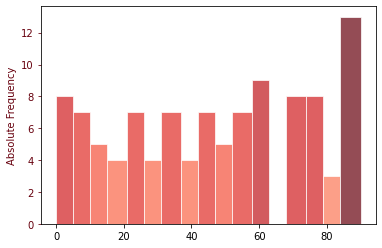

In [62]:
generate_hists(ResultsDF)

## Catplot

In [69]:
cols = [x for x in FULL.columns if x.startswith("LSF2D") or x.startswith("LSF1D") or x.startswith("DCF") or x.startswith("DNF") or x.startswith("SKNW") or x.startswith("OTHERS")]

#import pingouin as pg
import scipy.stats as stats

#for ft in cols[1:3]:
#     for cond in np.unique(ResultsDF['Label']):
#         plt.figure()
#         stats.probplot(FULL[ResultsDF['Label'] == cond][ft], dist="norm", plot=plt)
#         plt.title(str(ft) + str(" , ") + str(cond))
#         plt.show()

comb = combinations(range(4), 2)
labels = ['WT','Dup41_46','Del38_46','Mut394']
f_p = []
res = pd.DataFrame(columns=['celltype','ft','label1','label2','s','p'])
n = 1
for celltype in np.unique(ResultsDF['Cell desc.']):
    data = FULL[ResultsDF['Cell desc.'] == celltype]
    datal = ResultsDF[ResultsDF['Cell desc.'] == celltype]
    
    for ft in cols:
        #F,p = stats.f_oneway(data[ft][datal['Label'] == 'WT'],  data[ft][datal['Label'] == 'Dup41_46'],  data[ft][datal['Label'] == 'Del38_46'], data[ft][datal['Label'] == 'Mut394'])
        #pg.anova(data=data, dv='Scores', between='Group', detailed=True)
        #f_p = f_p + [[celltype,ft,F,p]]
        comb = combinations(range(4), 2)
        for f in list(comb):
            s,p = stats.ttest_ind(data[ft][datal['Label'] == labels[f[0]]],data[ft][datal['Label'] == labels[f[1]]],equal_var=False,nan_policy='omit',alternative='two-sided')
            res_ = pd.Series([celltype,ft,labels[f[0]],labels[f[1]],s,p],index= res.columns)
            res  = res.append(res_,ignore_index=True)
            n +=1

# Student t Statistics

In [57]:
res

,celltype,ft,label1,label2,s,p
3929,round,DCF:Variance,Del38_46,Mut394,-8.677385,7.257916e-14
4161,round,DNF:Kurtosis,Dup41_46,Del38_46,-8.335410,1.480992e-13
4037,round,DCF:Mean Spectral Magnitude,Del38_46,Mut394,-8.048375,1.693367e-12
3923,round,DCF:Std,Del38_46,Mut394,-8.015343,1.995733e-12
4151,round,DNF:Variance,Del38_46,Mut394,-7.731834,8.128709e-12
...,...,...,...,...,...,...
4825,round,SKNW:Sholl Crossings Nuclei min,WT,Del38_46,NaN,NaN
4826,round,SKNW:Sholl Crossings Nuclei min,WT,Mut394,NaN,NaN
4827,round,SKNW:Sholl Crossings Nuclei min,Dup41_46,Del38_46,NaN,NaN
4828,round,SKNW:Sholl Crossings Nuclei min,Dup41_46,Mut394,NaN,NaN


In [31]:
cols = [x for x in FULL.columns if x.startswith("LSF2D") or x.startswith("LSF1D") or x.startswith("DCF") or x.startswith("DNF") or x.startswith("SKNW") or x.startswith("OTHERS")]

for i in ["LSF2D","LSF1D","DCF","DNF","SKNW","OTHERS"]:
    data = res[[x.startswith(i) for x in res['ft']]]
    print(list(zip(data['ft'][:5].values,data['celltype'][:5].values,data['label1'][:5].values,data['label2'][:5].values,data['p'][:5].values)))
    

[('LSF2D:Distances to Centroid max', 'round', 'WT', 'Del38_46', 9.580767309201919e-07), ('LSF2D:Local Line Distance median', 'round', 'Dup41_46', 'Del38_46', 1.328925310391456e-06), ('LSF2D:Local Line Distance min', 'elongated', 'Dup41_46', 'Del38_46', 6.610980864819778e-06), ('LSF2D:Distances to Centroid mean', 'round', 'WT', 'Del38_46', 6.824018707050873e-06), ('LSF2D:Line Lengths max_amp', 'round', 'WT', 'Del38_46', 8.493862057426436e-06)]
[('LSF1D:Number of Lines', 'round', 'WT', 'Del38_46', 1.3520273548188447e-10), ('LSF1D:Number of Lines', 'round', 'Del38_46', 'Mut394', 5.922162660712892e-05), ('LSF1D:Number of Lines', 'round', 'Dup41_46', 'Del38_46', 0.0001043304025295125), ('LSF1D:Number of Lines', 'complex', 'Dup41_46', 'Del38_46', 0.0035820081050154423), ('LSF1D:Number of Lines', 'complex', 'WT', 'Del38_46', 0.004323396122635229)]
[('DCF:Equivalent Diameter', 'round', 'WT', 'Del38_46', 6.454274128388918e-14), ('DCF:Variance', 'round', 'Del38_46', 'Mut394', 7.257916247982767e-

In [23]:
data['ft'][:5].values

array(['OTHERS:Main Vector Magnitude',
       'OTHERS:Area Ratio (Cyto vs. Nucl)',
       'OTHERS:Area Ratio (Cyto vs. Nucl)',
       'OTHERS:Weighted Cytoskeleton-Nuclei Centroid Distance',
       'OTHERS:Main Vector Magnitude'], dtype=object)

In [10]:
def convert_pvalue_to_asterisks(pvalue):
    if pvalue <= 0.0001:
        return "****"
    elif pvalue <= 0.001:
        return "***"
    elif pvalue <= 0.01:
        return "**"
    elif pvalue <= 0.05:
        return "*"
    return "ns"

In [8]:
f_p

[['complex', 'LSF2D:Angles mean', 2.7861275793274745, 0.046120927018038584],
 ['complex', 'LSF2D:Angles median', 1.8730069228687518, 0.14091914577286188],
 ['complex', 'LSF2D:Angles min', 0.37682653574488917, 0.7699515861078488],
 ['complex', 'LSF2D:Angles max', 1.1034646290389103, 0.35278889866172075],
 ['complex', 'LSF2D:Angles max_amp', 2.6492919442344576, 0.054546382347130974],
 ['complex', 'LSF2D:Angles var', 1.6279209101337497, 0.18956004540122845],
 ['complex', 'LSF2D:Angles std_dev', 1.5539052779866651, 0.2071978362899235],
 ['complex', 'LSF2D:Angles abs_dev', 1.9843674071937958, 0.12306454347292213],
 ['complex', 'LSF2D:Angles kurtosis', 2.7917019118068946, 0.04580679632217064],
 ['complex', 'LSF2D:Angles skewness', 1.8540111789213882, 0.14420789624130853],
 ['complex',
  'LSF2D:Distances to Centroid mean',
  2.364254752090086,
  0.07735800176422504],
 ['complex',
  'LSF2D:Distances to Centroid median',
  1.832941609980549,
  0.14794332253808865],
 ['complex',
  'LSF2D:Distanc

In [7]:
d = pd.DataFrame(f_p,columns=['celltype','feat','F','p']).sort_values(by=['p'])
d




,celltype,feat,F,p
690,round,DNF:Std,60.840170,8.143948e-27
691,round,DNF:Variance,56.951610,1.412276e-25
709,round,DNF:Mean Spectral Magnitude,52.160075,5.439185e-24
701,round,DNF:Invariant Contrast,41.061375,4.886189e-20
700,round,DNF:Invariant Dissimilarity,40.218233,1.016385e-19
...,...,...,...,...
785,round,SKNW:Std of Isolated cycles branch-distance,NaN,NaN
790,round,SKNW:Mean of Isolated cycles euclidean-distance,NaN,NaN
791,round,SKNW:Std of Isolated cycles euclidean-distance,NaN,NaN
794,round,SKNW:Sholl Crossings Cyto min,NaN,NaN
